##### Copyright 2020 The TensorFlow Authors.

In [1]:
import tensorflow as tf
from tensorflow import keras

import pandas as pd
import numpy as np
import os
import glob
import datetime

from tensorflow.compat.v1 import ConfigProto
from tensorflow.compat.v1 import InteractiveSession

config = ConfigProto()
config.gpu_options.allow_growth = True
session = InteractiveSession(config=config)
import tensorflow

# from tensorflow.compat.v1.keras.backend import get_session
# tensorflow.compat.v1.disable_v2_behavior()
# import shap

import numpy as np
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Conv2D, Flatten, Dropout
from sklearn import preprocessing

import tensorflow as tf

import numpy as np
import os
import pandas as pd
#import seaborn as sns
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()
import datetime
from os.path import isfile, join
from sys import getsizeof
import glob

from random import *

import matplotlib.pyplot as plt
#plt.ion()
%matplotlib notebook

#import mpld3
#mpld3.enable_notebook()
import numpy as np

from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import OneHotEncoder

# os.system('source /home/jackalak/heartbeat/cdf38_0-dist/bin/definitions.B')
# os.environ["CDF_LIB"] = '/home/jackalak/heartbeat/cdf38_0-dist/lib'
# from ovationpyme.ovation_prime import FluxEstimator,AverageEnergyEstimator,BinCorrector
# from ovationpyme.ovation_utilities import calc_avg_solarwind
# from ovationpyme.ovation_plotting import latlt2polar,polar2dial,pcolor_flux
 
import tensorflow.keras.backend as K

In [2]:
file_load_df_cumulative = '/home/jackalak/heartbeat_work/HEARTBEAT/ParticlePrecipitation/ML_DB_subsamp_ext_full_dfCumulative_complexHemisphereCombine.csv'
DMSP_DATA_DIR=''
df_cumulative = pd.read_csv(os.path.join(DMSP_DATA_DIR,file_load_df_cumulative))
df_cumulative = df_cumulative.sort_values(by=['ID_SC', 'Datetimes'])
df_cumulative = df_cumulative.set_index('Datetimes')
df_cumulative.index = pd.to_datetime(df_cumulative.index)
print(df_cumulative.columns.tolist())

['SC_AACGM_LAT', 'SC_AACGM_LTIME', 'ELE_TOTAL_ENERGY_FLUX', 'ELE_TOTAL_ENERGY_FLUX_STD', 'ELE_AVG_ENERGY', 'ELE_AVG_ENERGY_STD', 'ID_SC', 'sin_ut', 'cos_ut', 'sin_doy', 'cos_doy', 'sin_SC_AACGM_LTIME', 'cos_SC_AACGM_LTIME', 'F107', 'Bz', 'By', 'Bx', 'AE', 'AL', 'AU', 'SymH', 'PC', 'vsw', 'vx', 'psw', 'borovsky', 'newell', 'F107_6hr', 'Bz_6hr', 'By_6hr', 'Bx_6hr', 'AE_6hr', 'AL_6hr', 'AU_6hr', 'SymH_6hr', 'PC_6hr', 'vsw_6hr', 'vx_6hr', 'psw_6hr', 'borovsky_6hr', 'newell_6hr', 'F107_5hr', 'Bz_5hr', 'By_5hr', 'Bx_5hr', 'AE_5hr', 'AL_5hr', 'AU_5hr', 'SymH_5hr', 'PC_5hr', 'vsw_5hr', 'vx_5hr', 'psw_5hr', 'borovsky_5hr', 'newell_5hr', 'F107_3hr', 'Bz_3hr', 'By_3hr', 'Bx_3hr', 'AE_3hr', 'AL_3hr', 'AU_3hr', 'SymH_3hr', 'PC_3hr', 'vsw_3hr', 'vx_3hr', 'psw_3hr', 'borovsky_3hr', 'newell_3hr', 'F107_1hr', 'Bz_1hr', 'By_1hr', 'Bx_1hr', 'AE_1hr', 'AL_1hr', 'AU_1hr', 'SymH_1hr', 'PC_1hr', 'vsw_1hr', 'vx_1hr', 'psw_1hr', 'borovsky_1hr', 'newell_1hr', 'F107_45min', 'Bz_45min', 'By_45min', 'Bx_45min', 'A

In [3]:
# subset = df_cumulative[(df_cumulative.index.year ==2010 )]
# subset = subset[(subset['ID_SC'] ==16) ] 
# subset = subset[(subset.index.day ==10) ] 
# subset = subset[(subset.index.month ==10) ] 

In [4]:
# import pickle
# pickle_file = open("../Downloads/all_sc_df.pkl", "rb") 
# test =pickle.load(pickle_file) 

In [5]:
# test

In [6]:
# subset = test[(test.index.year ==2010 )]
# subset = subset[(subset['ID_SC'] ==16) ] 
# subset = subset[(subset.index.day ==10) ] 
# subset = subset[(subset.index.month ==10) ]
# del test

In [7]:
# import numpy as np
# fig= plt.figure(figsize=(8,8))

# ax4 = plt.subplot(polar=True,)

# ax4.scatter(( subset['SC_AACGM_LTIME'] ),test
#            (90.-(abs(subset['SC_AACGM_LAT']))))

# polar2dial(ax4)
# ax4.set_rlim([0.,90])
# r_label_values = 90.-np.array([80.,60.,40.,20.])
# r_labels = [r'$%d^{o}$' % (int(90.-rv)) for rv in r_label_values.flatten().tolist()]
# ax4.set_rgrids(r_label_values,labels=r_labels,fontsize='x-large')
# ax4.set_rlim([0.,90.])
# ax4.set_title('Satellite Position in Northern Hemisphere (top down Earth view)',fontweight="bold")
# fig.savefig('/home/jackalak/Pictures/combinedNS_polar',dpi=200)


# fig= plt.figure(figsize=(8,8))

# ax4 = plt.subplot(polar=True,)

# ax4.scatter(( subset['SC_AACGM_LTIME'] ),
#            (90.-(abs(subset['SC_AACGM_LAT']))))

# polar2dial(ax4)
# ax4.set_rlim([0,45])
# r_label_values = 90.-np.array([80.,70.,60.,50.])
# r_labels = [r'$%d^{o}$' % (int(90.-rv)) for rv in r_label_values.flatten().tolist()]
# ax4.set_rgrids(r_label_values,labels=r_labels,fontsize='x-large')
# ax4.set_title('Satellite Position in Northern Hemisphere (top down Earth view)',fontweight="bold")
# fig.savefig('/home/jackalak/Pictures/combinedNS_polar2',dpi=200)

In [8]:
# plt.figure()
# plt.hist(df_cumulative['SC_AACGM_LAT'].values,bins=200)
# plt.title('MLat histogram')
# plt.show()

# plt.figure()
# plt.hist(df_cumulative['SC_AACGM_LTIME'].values,bins=200)
# plt.title('MLong histogram')
# plt.show()

# plt.figure()
# plt.scatter(df_cumulative['SC_AACGM_LAT'].values,df_cumulative['SC_AACGM_LTIME'].values)
# plt.title('MLat vs MLong')
# plt.show()

# subset = df_cumulative[(df_cumulative.index.year ==2010 )]
# subset = subset[(subset['ID_SC'] ==16) ] 
# subset = subset[(subset.index.day ==10) ] 
# subset = subset[(subset.index.month ==10) ] 

# plt.figure()
# plt.hist(subset['SC_AACGM_LAT'].values,bins=200)
# plt.title('MLat histogram')
# plt.show()

# plt.figure()
# plt.hist(subset['SC_AACGM_LTIME'].values,bins=200)
# plt.title('MLong histogram')
# plt.show()

# plt.figure()
# plt.scatter(subset['SC_AACGM_LAT'].values,subset['SC_AACGM_LTIME'].values)
# plt.title('MLat vs MLong')
plt.show()

In [9]:
# import scipy
# def create_kerneldensity_fxn(y_val_plot,
#                             y_val_pred_plot,):
#     '''
#         all y_val variables must be in units of log10[eV/cm2/s]
#         file_save_base = desired location to save the plot
#         Produces two plots: one for the full time series and one for a subset to see the dynamics more clearly
#     '''
#     # Handle NaNs and Infs - ADDED RMM 8.3.2020 to handle NaNs and Infs

#     fig = plt.figure(figsize=(12,12))
#     ax2 = fig.add_subplot()
#     xy = np.vstack([y_val_plot.values,y_val_pred_plot])
#     z = scipy.stats.gaussian_kde(xy)(xy)
#     # Sort the points by density, so that the densest points are plotted last
#     idx = z.argsort()
#     x, y, z2 = y_val_plot.values[idx], y_val_pred_plot[idx], z[idx]
#     ax2.scatter(x,
#                 y,
#                 c = z2,
#                 alpha = 0.5,
#                 s=20,
# #                 edgecolor=''
#                )
#     ax2.set_aspect('equal', 'box')
#     ax2.grid(True)
#     plt.title('Validation vs. NN prediction')

# create_kerneldensity_fxn(df_cumulative['SC_AACGM_LAT'],df_cumulative['SC_AACGM_LTIME'])

In [10]:
cols_to_drop_validation = [c for c in df_cumulative.columns if ('STD' in c) | ('AVG' in c) | ('SC_AACGM_LTIME'==c)]
# cols_to_drop_validation = [c for c in df.columns if ('1min' in c) | ('3min' in c) | ('4min' in c) | ('5min' in c) | ('15min' in c) | ('newell' in c) | ('STD' in c) | ('AVG' in c) | ('SC_AACGM_LTIME'==c)]

df_cumulative = df_cumulative.drop(columns=cols_to_drop_validation)

# high_mask = np.log10(df_cumulative['ELE_TOTAL_ENERGY_FLUX']) >= 7.4
# df_cumulative = df_cumulative[high_mask]

In [11]:
print(df_cumulative.columns.to_list() )

['SC_AACGM_LAT', 'ELE_TOTAL_ENERGY_FLUX', 'ID_SC', 'sin_ut', 'cos_ut', 'sin_doy', 'cos_doy', 'sin_SC_AACGM_LTIME', 'cos_SC_AACGM_LTIME', 'F107', 'Bz', 'By', 'Bx', 'AE', 'AL', 'AU', 'SymH', 'PC', 'vsw', 'vx', 'psw', 'borovsky', 'newell', 'F107_6hr', 'Bz_6hr', 'By_6hr', 'Bx_6hr', 'AE_6hr', 'AL_6hr', 'AU_6hr', 'SymH_6hr', 'PC_6hr', 'vsw_6hr', 'vx_6hr', 'psw_6hr', 'borovsky_6hr', 'newell_6hr', 'F107_5hr', 'Bz_5hr', 'By_5hr', 'Bx_5hr', 'AE_5hr', 'AL_5hr', 'AU_5hr', 'SymH_5hr', 'PC_5hr', 'vsw_5hr', 'vx_5hr', 'psw_5hr', 'borovsky_5hr', 'newell_5hr', 'F107_3hr', 'Bz_3hr', 'By_3hr', 'Bx_3hr', 'AE_3hr', 'AL_3hr', 'AU_3hr', 'SymH_3hr', 'PC_3hr', 'vsw_3hr', 'vx_3hr', 'psw_3hr', 'borovsky_3hr', 'newell_3hr', 'F107_1hr', 'Bz_1hr', 'By_1hr', 'Bx_1hr', 'AE_1hr', 'AL_1hr', 'AU_1hr', 'SymH_1hr', 'PC_1hr', 'vsw_1hr', 'vx_1hr', 'psw_1hr', 'borovsky_1hr', 'newell_1hr', 'F107_45min', 'Bz_45min', 'By_45min', 'Bx_45min', 'AE_45min', 'AL_45min', 'AU_45min', 'SymH_45min', 'PC_45min', 'vsw_45min', 'vx_45min', 'p

In [12]:

# Separate training and testing data
mask_val = [(df_cumulative.index.year == 2010) & (df_cumulative['ID_SC'].values==16)]
df_val = df_cumulative[mask_val[0]].copy(deep=True)
df_train = df_cumulative.copy(deep=True).drop( df_cumulative.index[mask_val[0]])

# mask_for_2010_to_2014 = [(df_train.index.year == 2010) | (df_train.index.year == 2011)
#                          | (df_train.index.year == 2012) |(df_train.index.year == 2013)
#                          | (df_train.index.year == 2014)]
# df_train = df_train[mask_for_2010_to_2014[0]]
df_train = df_train.sort_values(by=['ID_SC', 'Datetimes'])
df_val = df_val.sort_values(by=['ID_SC', 'Datetimes'])


In [13]:
print(df_cumulative.columns.tolist())

['SC_AACGM_LAT', 'ELE_TOTAL_ENERGY_FLUX', 'ID_SC', 'sin_ut', 'cos_ut', 'sin_doy', 'cos_doy', 'sin_SC_AACGM_LTIME', 'cos_SC_AACGM_LTIME', 'F107', 'Bz', 'By', 'Bx', 'AE', 'AL', 'AU', 'SymH', 'PC', 'vsw', 'vx', 'psw', 'borovsky', 'newell', 'F107_6hr', 'Bz_6hr', 'By_6hr', 'Bx_6hr', 'AE_6hr', 'AL_6hr', 'AU_6hr', 'SymH_6hr', 'PC_6hr', 'vsw_6hr', 'vx_6hr', 'psw_6hr', 'borovsky_6hr', 'newell_6hr', 'F107_5hr', 'Bz_5hr', 'By_5hr', 'Bx_5hr', 'AE_5hr', 'AL_5hr', 'AU_5hr', 'SymH_5hr', 'PC_5hr', 'vsw_5hr', 'vx_5hr', 'psw_5hr', 'borovsky_5hr', 'newell_5hr', 'F107_3hr', 'Bz_3hr', 'By_3hr', 'Bx_3hr', 'AE_3hr', 'AL_3hr', 'AU_3hr', 'SymH_3hr', 'PC_3hr', 'vsw_3hr', 'vx_3hr', 'psw_3hr', 'borovsky_3hr', 'newell_3hr', 'F107_1hr', 'Bz_1hr', 'By_1hr', 'Bx_1hr', 'AE_1hr', 'AL_1hr', 'AU_1hr', 'SymH_1hr', 'PC_1hr', 'vsw_1hr', 'vx_1hr', 'psw_1hr', 'borovsky_1hr', 'newell_1hr', 'F107_45min', 'Bz_45min', 'By_45min', 'Bx_45min', 'AE_45min', 'AL_45min', 'AU_45min', 'SymH_45min', 'PC_45min', 'vsw_45min', 'vx_45min', 'p

In [14]:

# Construct X and y
feature_cols = [c for c in df_train.columns if not 'ELE' in c]
#print( (feature_cols))
#print(df_cumulative.columns)
X_val = df_val[feature_cols].copy(deep=True)
y_val = df_val['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
X_train = df_train[feature_cols].copy(deep=True)
y_train = df_train['ELE_TOTAL_ENERGY_FLUX'].copy(deep=True)
scaler_X = preprocessing.RobustScaler()
scaler_X = scaler_X.fit(X_train.values)
X_val_scaled = scaler_X.transform(X_val.values)
X_train_scaled = scaler_X.transform(X_train.values)

numFeatures = len(X_train.columns.to_list())
feature_labels = X_train.columns.to_list()
y_train_erg = y_train.copy(deep=True) * (1.60218e-12)
y_val_erg = y_val.copy(deep=True) * (1.60218e-12)

y_train[y_train == 0] = 0.0001
y_val[y_val == 0] = 0.0001
y_train_log = np.log10(y_train.copy(deep=True))
y_val_log = np.log10(y_val.copy(deep=True))
X = np.array(X_train_scaled, dtype=np.float32)
X_test = np.array(X_val_scaled, dtype=np.float32)

In [44]:
i=0
y_val_log_precentile=[]
X_val_precentile = []
percentile = []
for percent in [.05,.1,.15,.2,.25,.3,.35,.4,.45,.5,.55,.6,.65,.7,.75,.8,.85,.9,.95]:
    temp= pd.DataFrame(data=y_val_log.values, index = y_val_log.index, columns = ['energy'])
    percentile.append(str(percent))
    y_val_log_precentile.append(temp.nlargest(int((1.-percent)*temp.shape[0]),columns=['energy']))
    temp2 = pd.DataFrame(data=X_test, index = y_val_log.index)
    X_val_precentile.append( temp2.loc[y_val_log_precentile[i].index,:])
    print((percentile[i]+' percentile'), np.min(y_val_log_precentile[i].values),np.max(y_val_log_precentile[i].values))
    i = i+ 1
    
i=0
y_val_log_precentile_left=[]
X_val_precentile_left = []
percentile_left = []
for percent in [.05,.1,.15,.2,.25,.3,.35,.4,.45,.5,.55,.6,.65,.7,.75,.8,.85,.9,.95]:
    temp= pd.DataFrame(data=y_val_log.values, index = y_val_log.index, columns = ['energy'])
    percentile_left.append(str(percent))
    y_val_log_precentile_left.append((1./temp).nlargest
                                     (int((percent)*temp.shape[0]),columns=['energy']))
    temp2 = pd.DataFrame(data=X_test, index = y_val_log.index)
    X_val_precentile_left.append( temp2.loc[y_val_log_precentile_left[i].index,:])
    y_val_log_precentile_left[i] = 1./y_val_log_precentile_left[i]
    print((percentile_left[i]+' percentile from left'), np.min(y_val_log_precentile_left[i].values),np.max(y_val_log_precentile_left[i].values))
    i = i+ 1

y_val_log_90= pd.DataFrame(data=y_val_log.values, index = y_val_log.index, columns = ['energy'])
y_val_log_90 = y_val_log_90.nlargest(int(0.1*y_val_log_90.shape[0]),columns=['energy'])
X_val_90 = pd.DataFrame(data=X_test, index = y_val_log.index)
X_val_90 = X_val_90.loc[y_val_log_90.index,:]
print('90% percentile', np.min(y_val_log_90.values),np.max(y_val_log_90.values))

y_val_log_95= pd.DataFrame(data=y_val_log.values, index = y_val_log.index, columns = ['energy'])
y_val_log_95 = y_val_log_95.nlargest(int(0.05*y_val_log_95.shape[0]),columns=['energy'])
X_val_95 = pd.DataFrame(data=X_test, index = y_val_log.index)
X_val_95 = X_val_95.loc[y_val_log_95.index,:]
print('95% percentile', np.min(y_val_log_95.values),np.max(y_val_log_95.values))

y_val_log_99= pd.DataFrame(data=y_val_log.values, index = y_val_log.index, columns = ['energy'])
y_val_log_99 = y_val_log_99.nlargest(int(0.01*y_val_log_99.shape[0]),columns=['energy'])
X_val_99 = pd.DataFrame(data=X_test, index = y_val_log.index)
X_val_99 = X_val_99.loc[y_val_log_99.index,:]
print('99% percentile', np.min(y_val_log_99.values),np.max(y_val_log_99.values))


0.05 percentile 7.00039893334706 13.201022212839035
0.1 percentile 7.164534864368128 13.201022212839035
0.15 percentile 7.290397040306319 13.201022212839035
0.2 percentile 7.376963635410883 13.201022212839035
0.25 percentile 7.465564860032109 13.201022212839035
0.3 percentile 7.549491629968991 13.201022212839035
0.35 percentile 7.642971033556274 13.201022212839035
0.4 percentile 7.751471182907377 13.201022212839035
0.45 percentile 7.914464118528352 13.201022212839035
0.5 percentile 8.318267906289773 13.201022212839035
0.55 percentile 8.846842813967578 13.201022212839035
0.6 percentile 9.290206290781745 13.201022212839035
0.65 percentile 9.654347914752897 13.201022212839035
0.7 percentile 9.97239332131116 13.201022212839035
0.75 percentile 10.25692834937135 13.201022212839035
0.8 percentile 10.51516701066242 13.201022212839035
0.85 percentile 10.764910672002928 13.201022212839035
0.9 percentile 11.024546004990425 13.201022212839035
0.95 percentile 11.350574198319405 13.201022212839035
0

In [15]:
import matplotlib as matplotlib

font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 16}
matplotlib.rc('xtick', labelsize=12) 
matplotlib.rc('ytick', labelsize=12) 
matplotlib.rc('font', **font)

def plot_model(df_results):
    
    plt.figure(figsize=(12,8))
    plt.plot(y_val_log[:],alpha = 0.5)
    plt.plot(df_results[:],alpha = 0.5)
    plt.legend(['val', 'result'], loc='upper left')
    plt.title('Electron Flux log10 [eV/cm^2/ster/s]')

    plt.show()
    plt.savefig('1.png',dpi=200)


    plt.figure(figsize=(12,8))
    plt.plot(10**y_val_log[:]*1.6e-6,alpha = 0.5)
    plt.plot(10**df_results[:]*1.6e-6,alpha = 0.5)
    plt.title('Electron Flux [eV/cm^2/ster/s]')
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()
    plt.savefig('2.png',dpi=200)

    plt.figure(figsize=(12,8))
    plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True,alpha = 0.5)
    plt.hist(10**df_results.values*1.6e-6,bins=100, log=True,alpha = 0.5)
    plt.title('Histogram of Electron Flux [eV/cm^2/ster/s]')

    plt.legend(['val', 'result'], loc='upper left')
    plt.show()
    plt.savefig('3.png',dpi=200)


    plt.figure(figsize=(12,8))
    plt.hist(df_results.values,bins=200,range=(6,14),alpha = 0.5)
    plt.hist(y_val_log.values,bins=200,range=(6,14),alpha = 0.5)
    plt.legend(['result','val'], loc='upper left')
    plt.title('Histogram of Electron Flux log10 [eV/cm^2/ster/s]')
    plt.show()
    plt.savefig('4.png',dpi=200)

    plt.figure(figsize=(12,8))
    plt.hist(y_val_log.values,bins=200,range=(6,14),alpha = 0.5)
    plt.hist(df_results.values,bins=200,range=(6,14),alpha = 0.5)
    plt.legend(['val', 'result'], loc='upper left')
    plt.title('Histogram of Electron Flux log10 [eV/cm^2/ster/s]')
    plt.show()
    plt.savefig('5.png',dpi=200)

    plt.figure(figsize=(12,8))
    plt.hist(df_results.values,bins=200,range=(6,14),alpha = 0.5)
    plt.hist(y_val_log.values,bins=200,range=(6,14),alpha = 0.5)
    plt.legend(['result','val'], loc='upper left')
    plt.title('Histogram of Electron Flux log10 [eV/cm^2/ster/s]')

    plt.ylim([0,2000])
    plt.show()
    plt.savefig('6.png',dpi=200)

    plt.figure()
    plt.hist(y_val_log.values,bins=200,range=(6,14),alpha = 0.5)
    plt.hist(df_results.values,bins=200,range=(6,14),alpha = 0.5)
    plt.legend(['val', 'result'], loc='upper left')
    plt.title('Histogram of Electron Flux log10 [eV/cm^2/ster/s]')

    plt.ylim([0,2000])

    plt.show()
    plt.savefig('7.png',dpi=200)


    errors= y_val_log.values-df_results.values[:,0]
    plt.figure(figsize=(12,8));
    plt.scatter(df_val['SC_AACGM_LAT'].values,errors,s=1)
    plt.title('Errors over SC_AACGM_LAT Bins')
    plt.savefig('8.png',dpi=200)


    bin_total = np.zeros((200))
    bin_error_total = np.zeros((200))
    for j in range(0,y_val_log.values.shape[0]):
        i = int((df_val['SC_AACGM_LAT'].values[j]-45)/((90-45)/200))
        if i < 200:
            bin_total[i] = bin_total[i]+1
            bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])

    avg_error_over_hist = bin_error_total/bin_total
    plt.figure(figsize=(12,8))
    plt.scatter(np.linspace(45,90,num=200),avg_error_over_hist)
    plt.title('Average Validation Error over SC_AACGM_LAT Bins')
    plt.ylim([0,1.2])
    plt.show()
    
    errors= y_val_log.values-df_results.values[:,0]
    plt.figure(figsize=(12,8));
    plt.scatter(y_val_log.values,errors,s=1)
    plt.title('Errors over target Bins')

    bin_total = np.zeros((200))
    bin_error_total = np.zeros((200))
    for j in range(0,y_val_log.values.shape[0]):
        i = int((y_val_log[j]-6)/((14-6)/200))
        if i < 200:
            bin_total[i] = bin_total[i]+1
            bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])

    avg_error_over_hist = bin_error_total/(bin_total+.00001)
    plt.figure(figsize=(12,8))
    plt.scatter(np.linspace(6,14,num=200),avg_error_over_hist)
    plt.title('Average Validation Error over target Bins ')    
    plt.ylim([0,2.6])
    plt.show()


In [16]:

def plot_model2(df_results):
    
    plt.figure()
    plt.plot(y_val_log[:])
    plt.plot(df_results[:])
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()


    plt.figure()
    plt.plot(10**y_val_log[:]*1.6e-6)
    plt.plot(10**df_results[:]*1.6e-6)
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()

    plt.figure()
    plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True)
    plt.hist(10**df_results.values*1.6e-6,bins=100, log=True)
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()


    plt.figure()
    plt.hist(df_results.values,bins=200,range=(6,14))
    plt.hist(y_val_log.values,bins=200,range=(6,14))
    plt.legend(['result','val'], loc='upper left')
    plt.show()

    plt.figure()
    plt.hist(y_val_log.values,bins=200,range=(6,14))
    plt.hist(df_results.values,bins=200,range=(6,14))
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()

    plt.figure()
    plt.hist(df_results.values,bins=200,range=(6,14))
    plt.hist(y_val_log.values,bins=200,range=(6,14))
    plt.legend(['result','val'], loc='upper left')
    plt.ylim([0,2000])
    plt.show()

    plt.figure()
    plt.hist(y_val_log.values,bins=200,range=(6,14))
    plt.hist(df_results.values,bins=200,range=(6,14))
    plt.legend(['val', 'result'], loc='upper left')
    plt.ylim([0,2000])

    plt.show()


    
    errors= y_val_log.values-df_results.values[:,0]
    plt.figure();
    plt.scatter(y_val_log.values,errors,s=1)
    plt.title('Errors over target Bins')

    bin_total = np.zeros((200))
    bin_error_total = np.zeros((200))
    for j in range(0,y_val_log.values.shape[0]):
        i = int((y_val_log[j]-6)/((14-6)/200))
        if i < 200:
            bin_total[i] = bin_total[i]+1
            bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])

    avg_error_over_hist = bin_error_total/(bin_total+.00001)
    plt.figure()
    plt.scatter(np.linspace(6,14,num=200),avg_error_over_hist)
    plt.title('Average Validation Error over target Bins')    
    plt.ylim([0,2.6])
    plt.show()


<IPython.core.display.Javascript object>


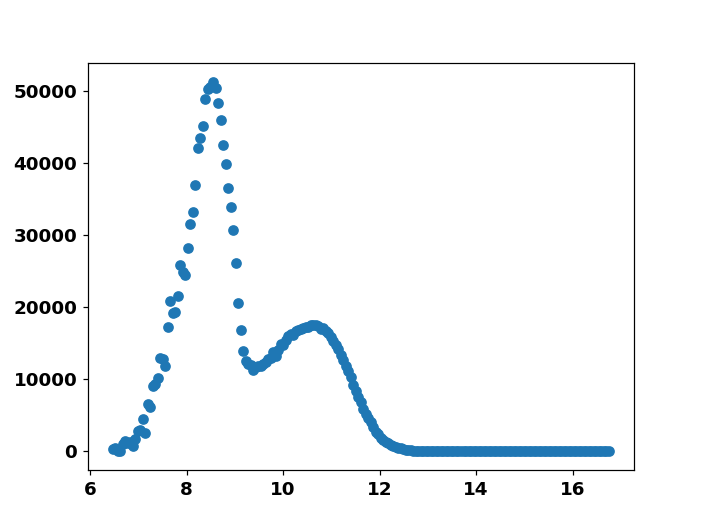

<IPython.core.display.Javascript object>


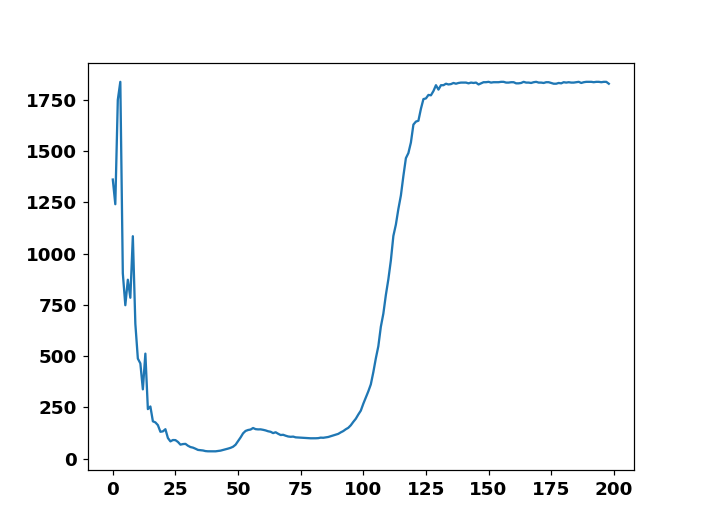

1838283


<IPython.core.display.Javascript object>


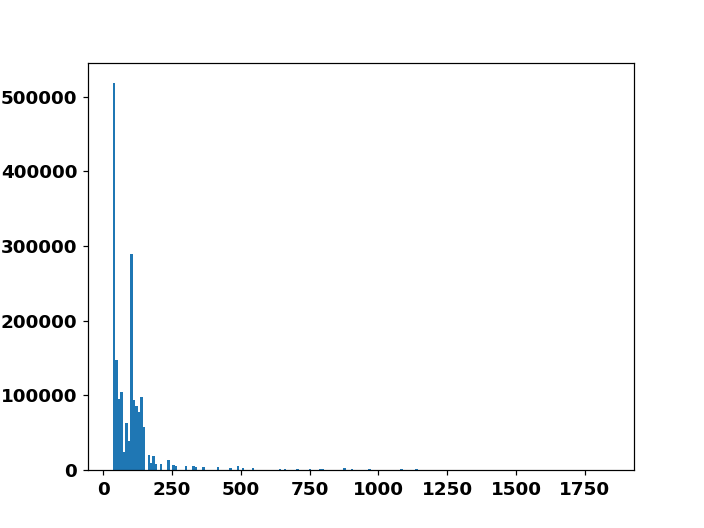

In [81]:
bins = np.linspace(np.min(y_train_log),np.max(y_train_log),200)
hist,bins = np.histogram(y_train_log,bins =bins)
plt.figure()
plt.scatter(bins[1:],hist)
plt.figure()
print(y_train_log.size)
plt.plot(y_train_log.size/(hist+1000))
bin_size = bins[1]-bins[0]
y_min = np.min(y_train_log)
sample_weights = np.ones((y_train_log.size))
for i in range(0,y_train_log.size):
    bin_i = int((y_train_log[i]-y_min)/bin_size)
    if bin_i ==199:
        bin_i = 198
    sample_weights[i] = y_train_log.size/(hist[bin_i]+1000)
    
plt.figure()
plt.hist(sample_weights,bins=200)
plt.show()


Model: "functional_3"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         [(None, 148)]             0         
_________________________________________________________________
dense_9 (Dense)              (None, 256)               38144     
_________________________________________________________________
dropout_1 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_10 (Dense)             (None, 64)                16448     
_________________________________________________________________
dense_11 (Dense)             (None, 32)                2080      
_________________________________________________________________
dense_12 (Dense)             (None, 256)               8448      
_________________________________________________________________
dense_13 (Dense)             (None, 1024)             

Epoch 71/1000
57/57 - 2s - loss: 79.0799 - mse: 0.6054 - val_loss: 0.6989 - val_mse: 0.6989
Epoch 72/1000
57/57 - 2s - loss: 77.7008 - mse: 0.5925 - val_loss: 0.7430 - val_mse: 0.7430
Epoch 73/1000
57/57 - 2s - loss: 77.4870 - mse: 0.5906 - val_loss: 0.7053 - val_mse: 0.7053
Epoch 74/1000
57/57 - 2s - loss: 77.7098 - mse: 0.5946 - val_loss: 0.6993 - val_mse: 0.6993
Epoch 75/1000
57/57 - 2s - loss: 77.6810 - mse: 0.5938 - val_loss: 0.7449 - val_mse: 0.7449
Epoch 76/1000
57/57 - 2s - loss: 77.2060 - mse: 0.5898 - val_loss: 0.6823 - val_mse: 0.6823
Epoch 77/1000
57/57 - 2s - loss: 77.6612 - mse: 0.5932 - val_loss: 0.6832 - val_mse: 0.6832
Epoch 78/1000
57/57 - 2s - loss: 76.7210 - mse: 0.5864 - val_loss: 0.6786 - val_mse: 0.6786
Epoch 79/1000
57/57 - 2s - loss: 76.4760 - mse: 0.5852 - val_loss: 0.6728 - val_mse: 0.6728
Epoch 80/1000
57/57 - 2s - loss: 76.3712 - mse: 0.5856 - val_loss: 0.6645 - val_mse: 0.6645
Epoch 81/1000
57/57 - 2s - loss: 76.3196 - mse: 0.5853 - val_loss: 0.6700 - val_

Epoch 160/1000
57/57 - 2s - loss: 70.0482 - mse: 0.5472 - val_loss: 0.6578 - val_mse: 0.6578
Epoch 161/1000
57/57 - 2s - loss: 70.4407 - mse: 0.5506 - val_loss: 0.6750 - val_mse: 0.6750
Epoch 162/1000
57/57 - 2s - loss: 69.7290 - mse: 0.5450 - val_loss: 0.6650 - val_mse: 0.6650
Epoch 163/1000
57/57 - 2s - loss: 69.5713 - mse: 0.5442 - val_loss: 0.6590 - val_mse: 0.6590
Epoch 164/1000
57/57 - 2s - loss: 69.5249 - mse: 0.5441 - val_loss: 0.7177 - val_mse: 0.7177
Epoch 165/1000
57/57 - 2s - loss: 70.6895 - mse: 0.5549 - val_loss: 0.6464 - val_mse: 0.6464
Epoch 166/1000
57/57 - 2s - loss: 69.5425 - mse: 0.5432 - val_loss: 0.6508 - val_mse: 0.6508
Epoch 167/1000
57/57 - 2s - loss: 69.5880 - mse: 0.5439 - val_loss: 0.6466 - val_mse: 0.6466
Epoch 168/1000
57/57 - 2s - loss: 69.6789 - mse: 0.5439 - val_loss: 0.6478 - val_mse: 0.6478
Epoch 169/1000
57/57 - 2s - loss: 69.6822 - mse: 0.5439 - val_loss: 0.6575 - val_mse: 0.6575
Epoch 170/1000
57/57 - 2s - loss: 69.3265 - mse: 0.5424 - val_loss: 0.

<IPython.core.display.Javascript object>


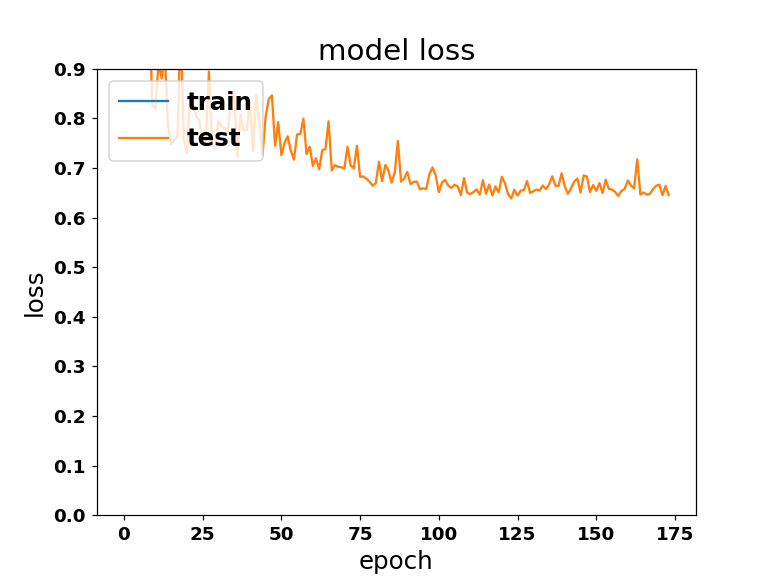

<IPython.core.display.Javascript object>


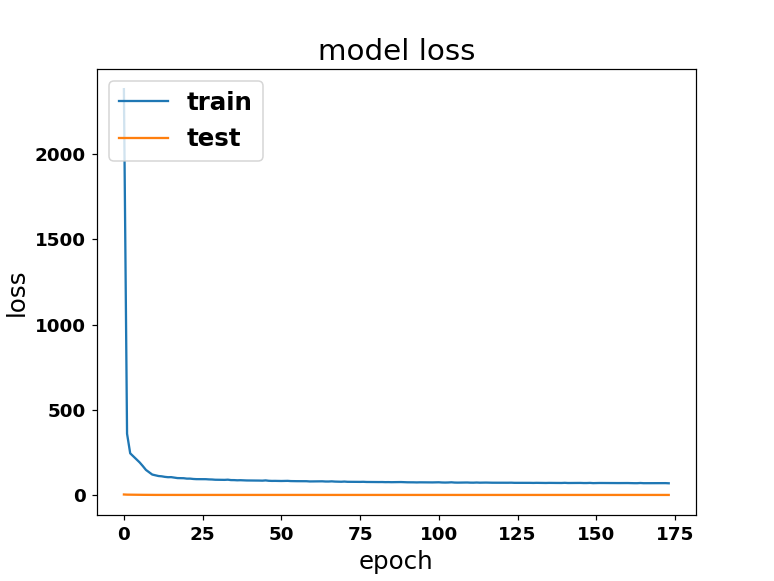

<IPython.core.display.Javascript object>


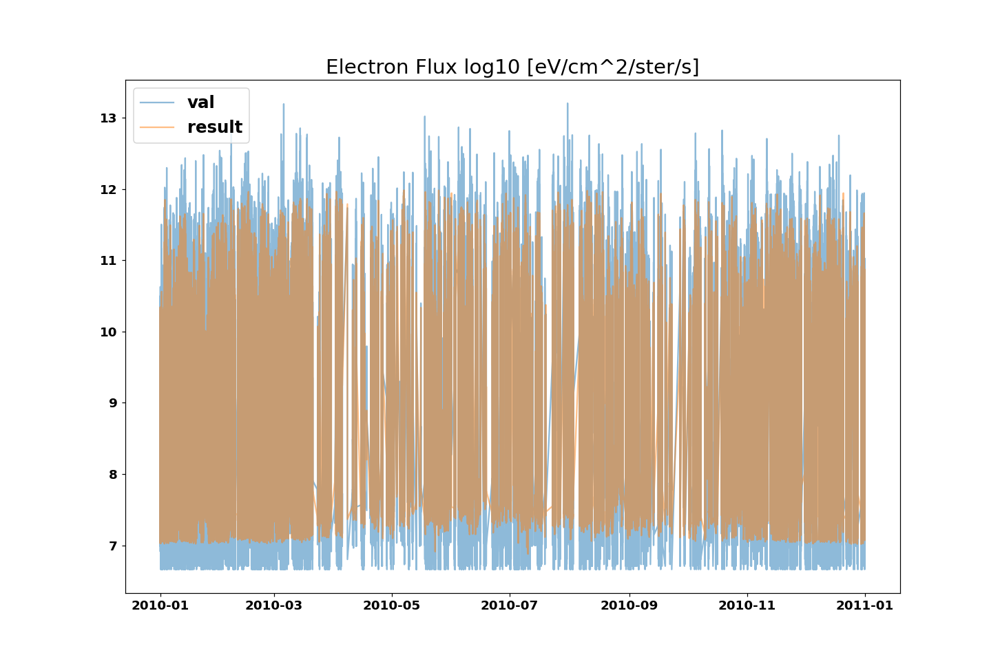

findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.
findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


<IPython.core.display.Javascript object>


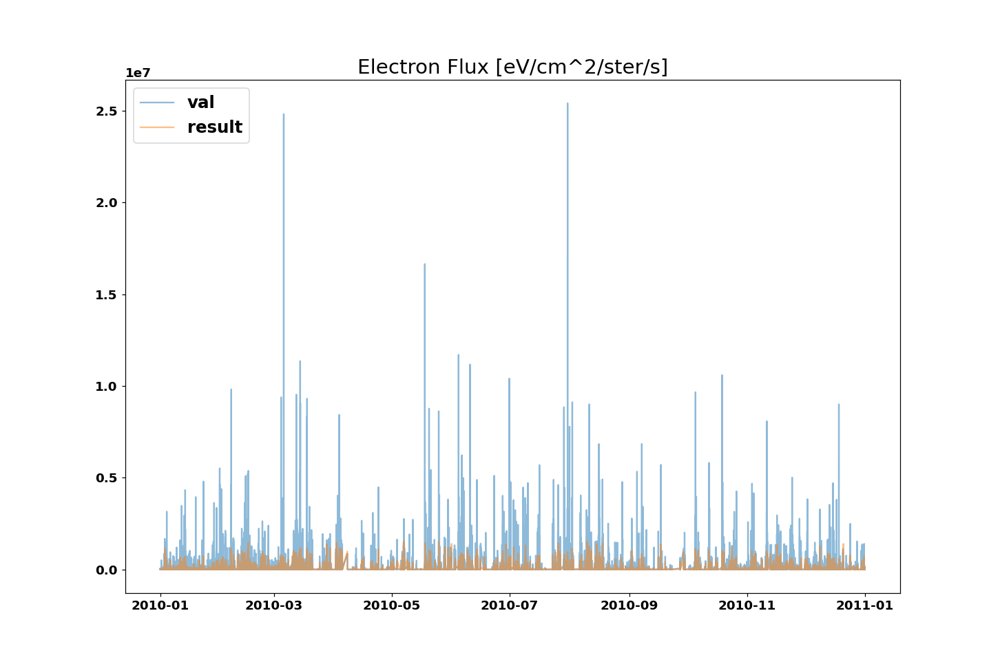

<IPython.core.display.Javascript object>


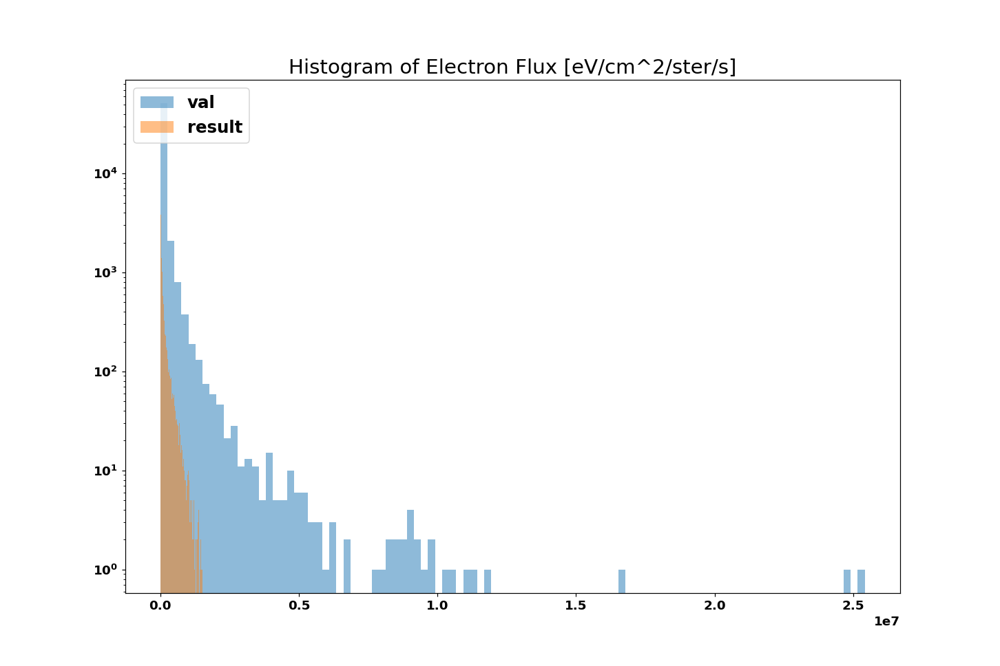

<IPython.core.display.Javascript object>


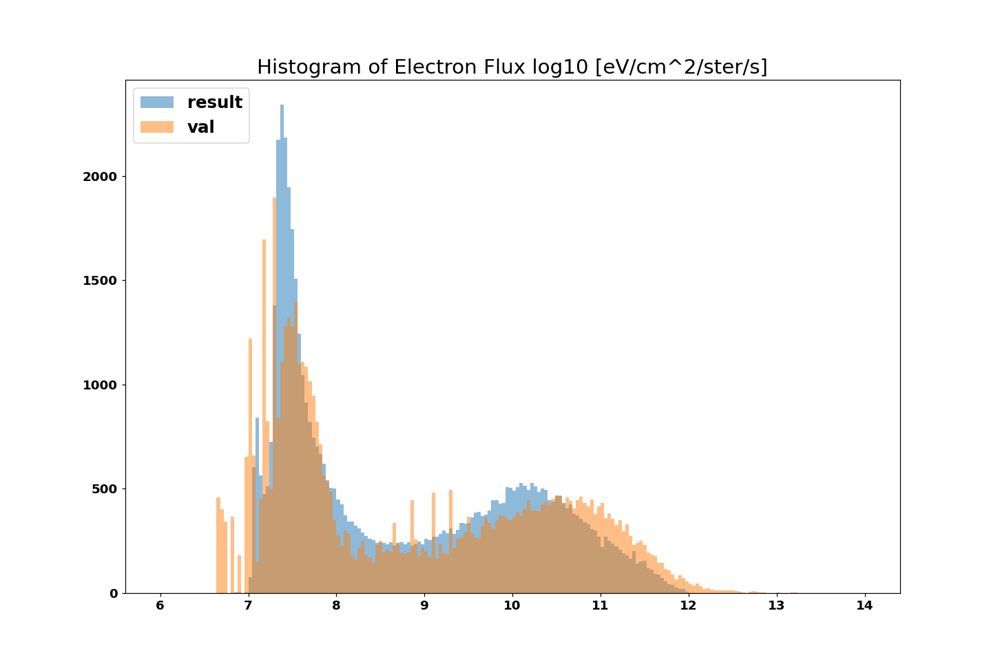

<IPython.core.display.Javascript object>


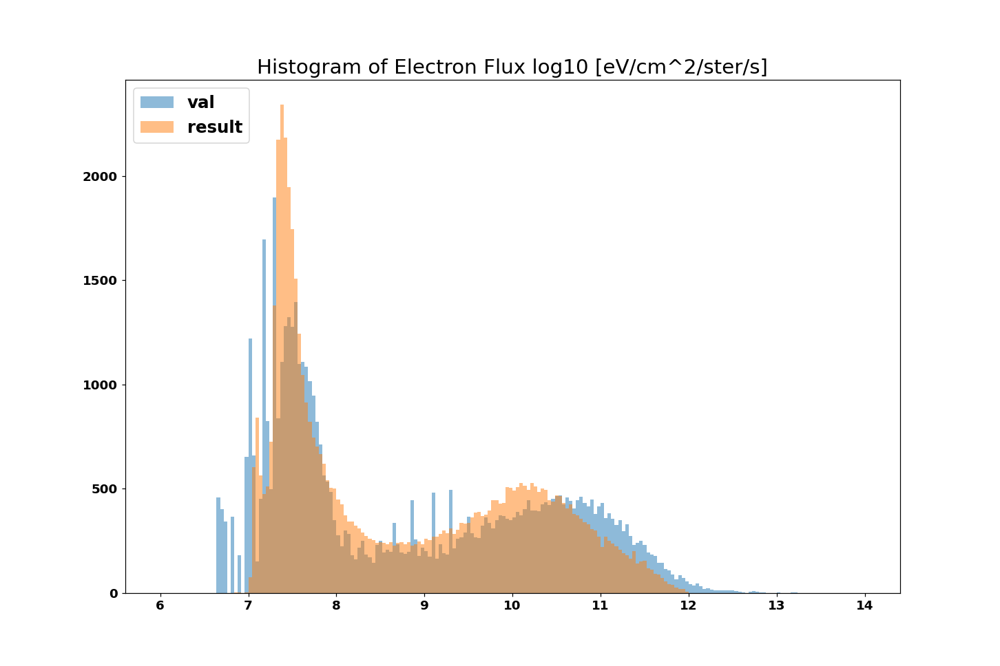

<IPython.core.display.Javascript object>


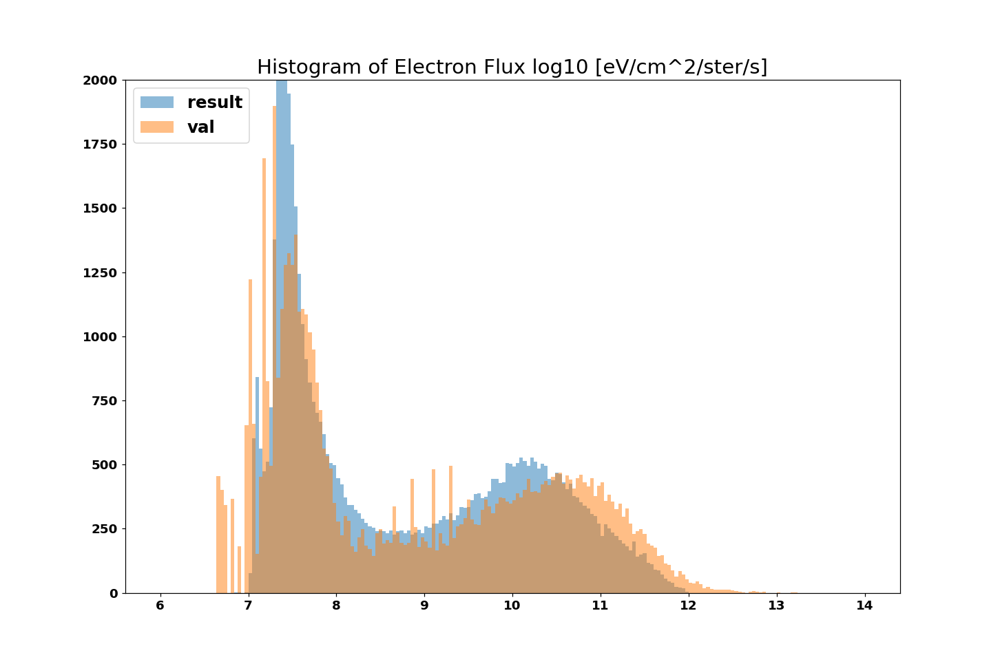

<IPython.core.display.Javascript object>


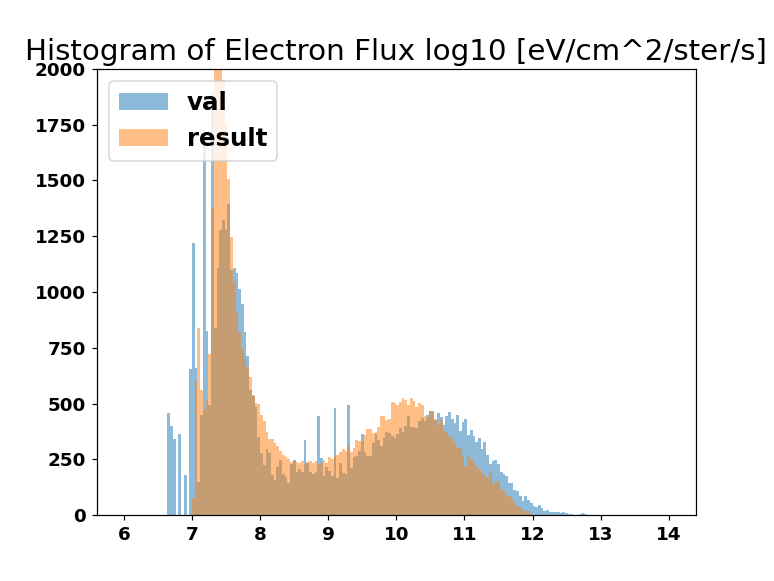

<IPython.core.display.Javascript object>


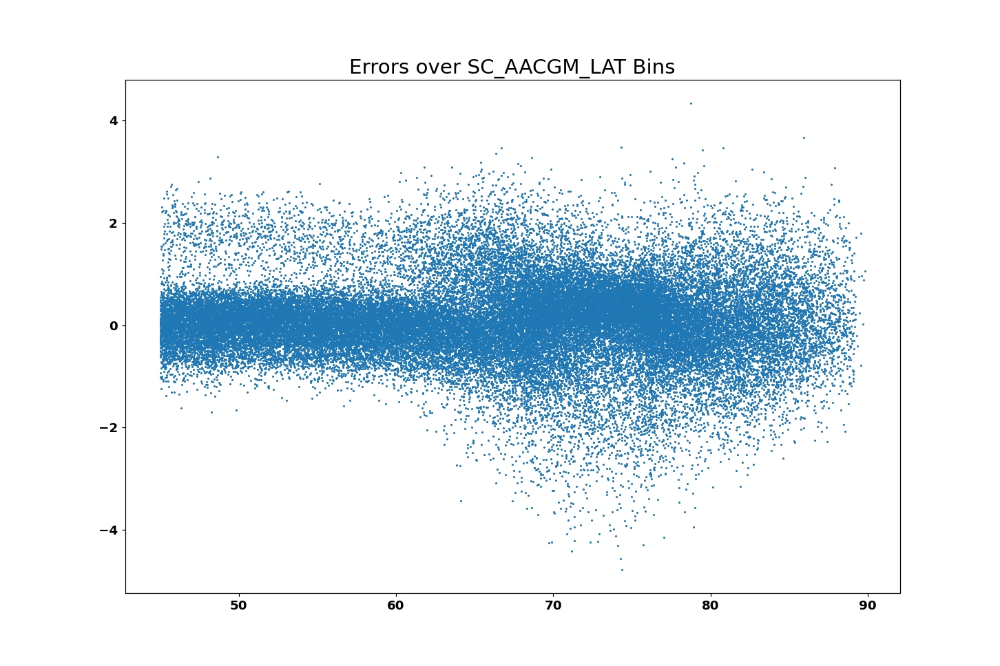

<IPython.core.display.Javascript object>


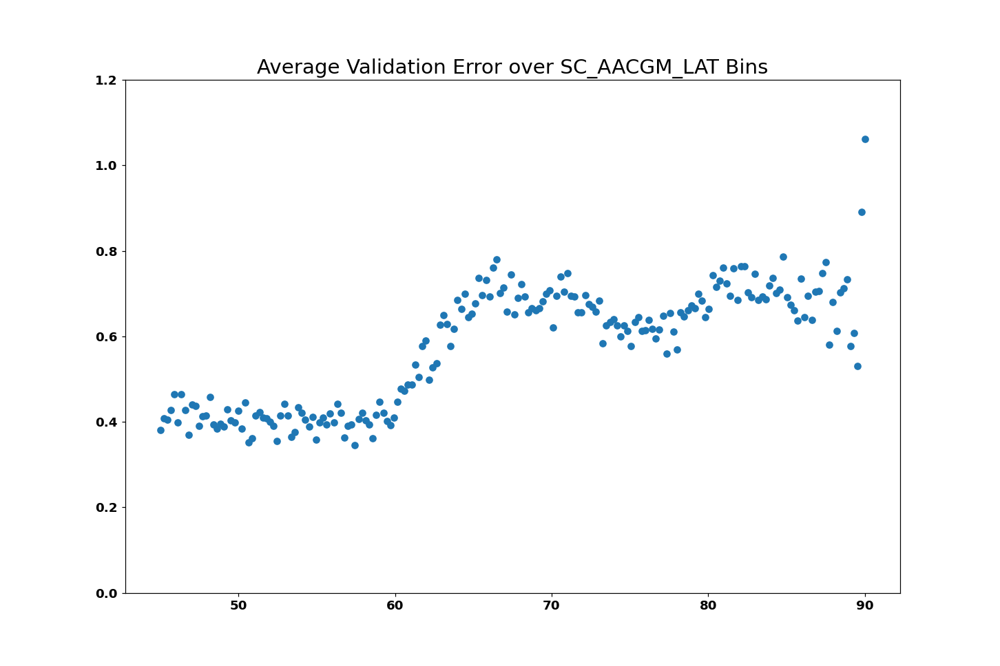

<IPython.core.display.Javascript object>


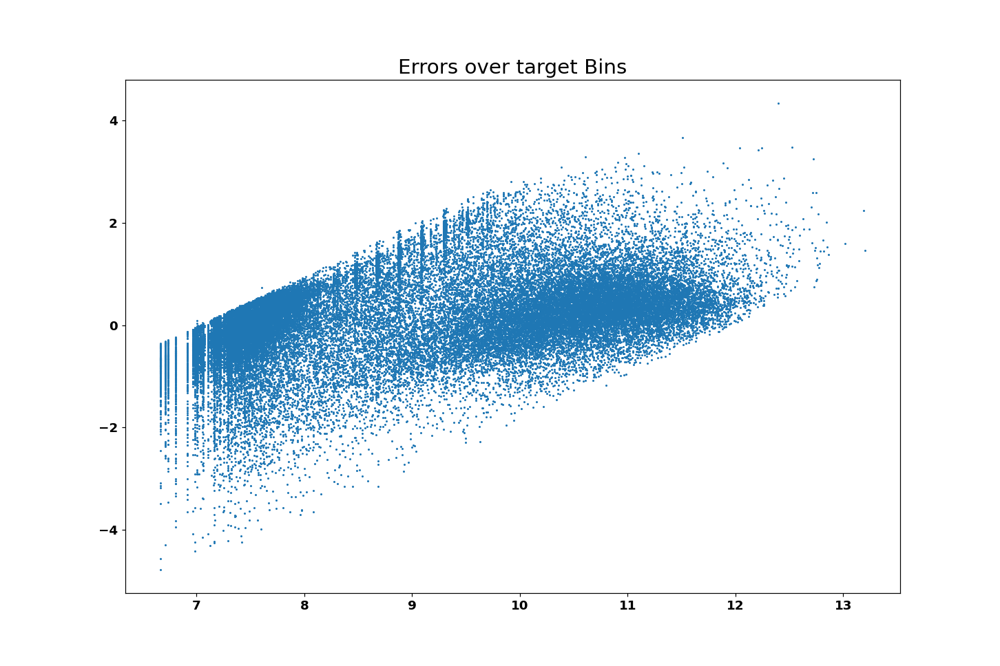

<IPython.core.display.Javascript object>


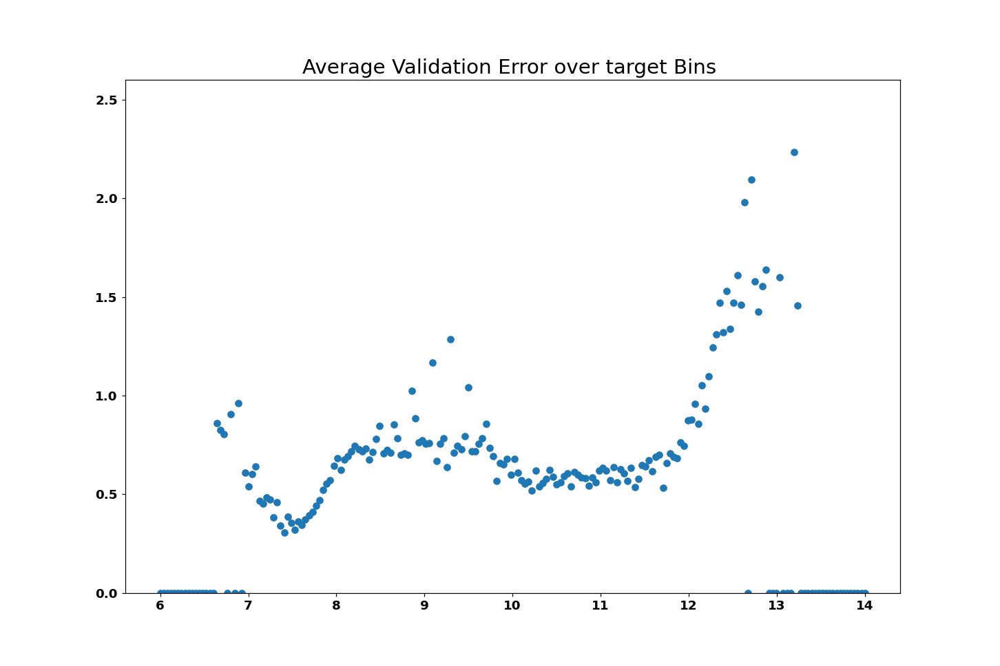

In [82]:
from tensorflow.keras.layers import Input

input1 = Input(shape=(148))
model1 = Dense(256,  activation='relu')(input1)
model1 = model1 = Dropout(0.5)(model1)
model1 = Dense(64, activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(int(256),   activation='relu')(model1)
model1 = Dense(int(1024),  activation='relu')(model1)
model1 = Dense(int(256),  activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(4, activation='relu')(model1)
model1 = Dense(1, activation='linear' )(model1)


output = model1
model = tensorflow.keras.models.Model(inputs=input1, outputs=output)
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',metrics=['mse'])
model.summary()

history = model.fit(X, 
                   y_train_log, 
                    validation_data=(
                        X_test, 
                        y_val_log,                                    ), sample_weight=sample_weights,
                    batch_size=32768,epochs=1000,verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=50)])#


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.ylim([0,.9])
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

results = model.predict(X_test)

df_results = pd.DataFrame(data=results, index = df_val.index)

model_3 = df_results

plot_model(df_results)

Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
Instructions for updating:
This property should not be used in TensorFlow 2.0, as updates are applied automatically.
INFO:tensorflow:Assets written to: model_3_dist_tail_Weighted/assets


<IPython.core.display.Javascript object>


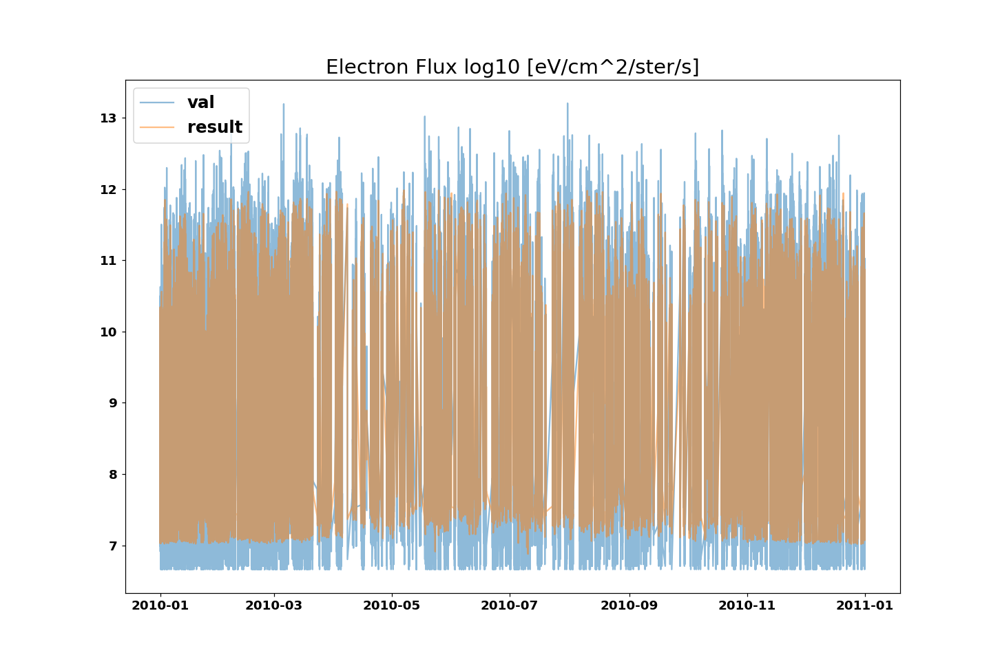

<IPython.core.display.Javascript object>


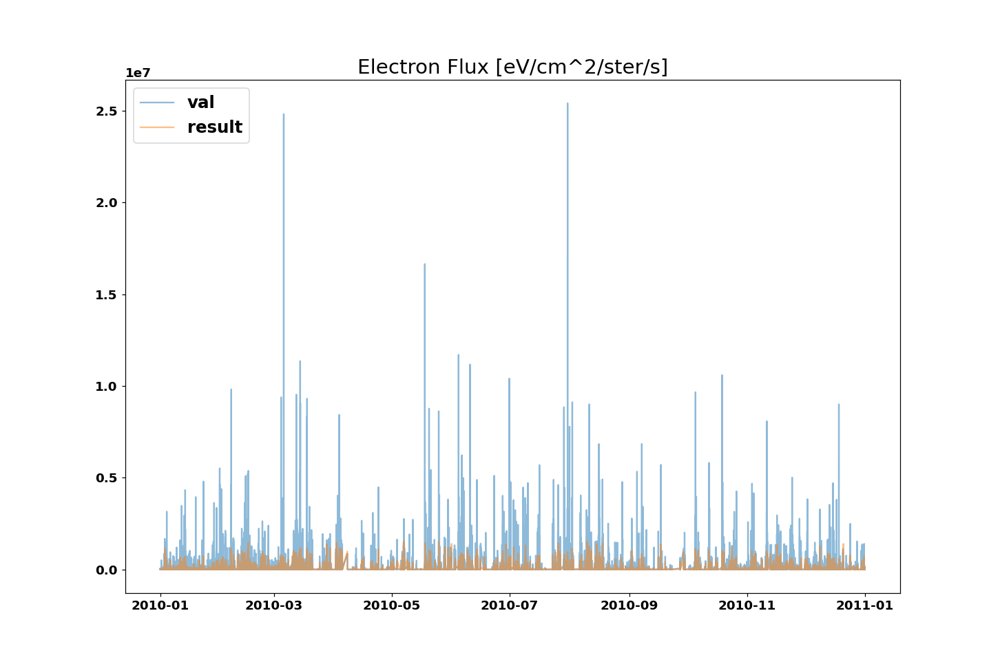

<IPython.core.display.Javascript object>


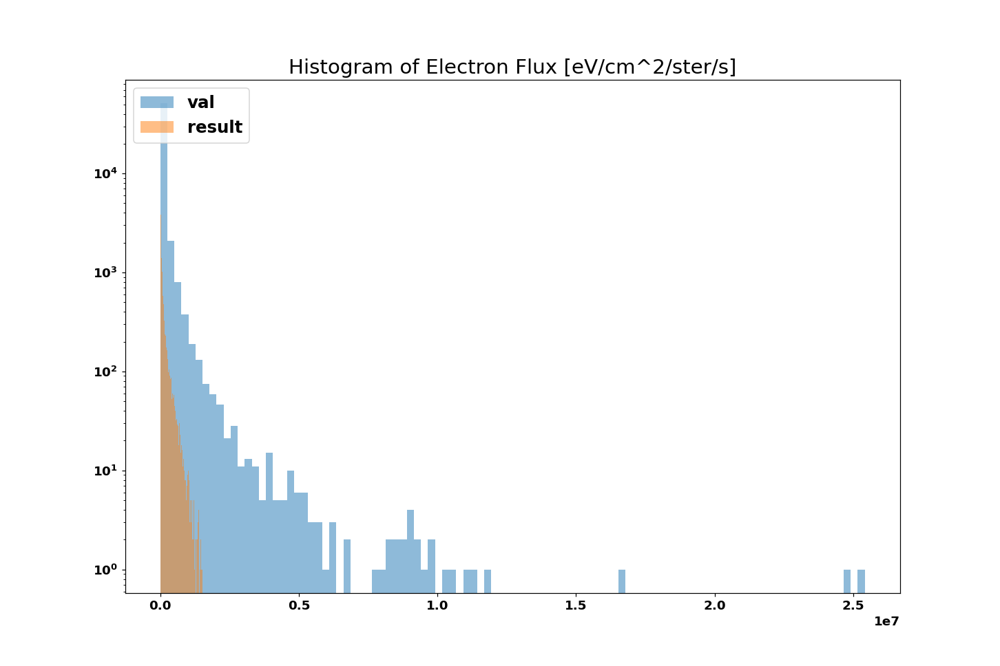

<IPython.core.display.Javascript object>


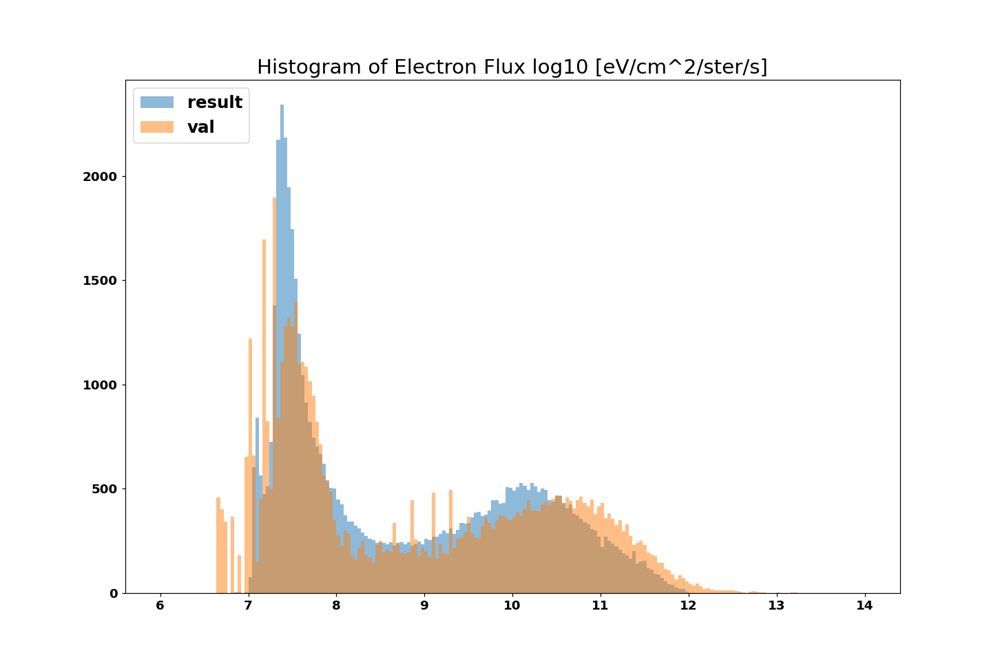

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


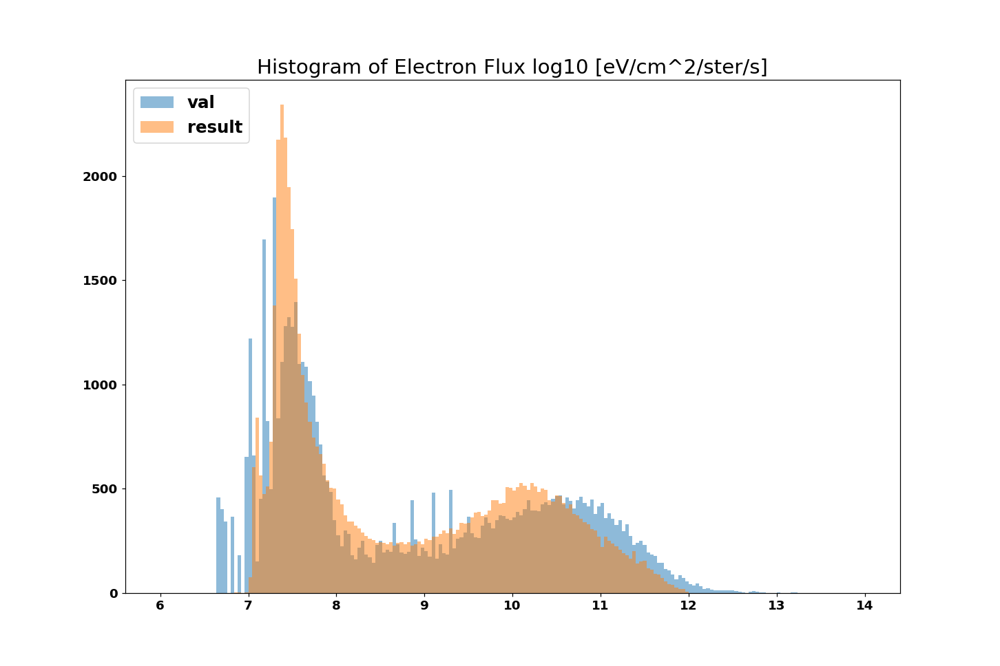

<IPython.core.display.Javascript object>


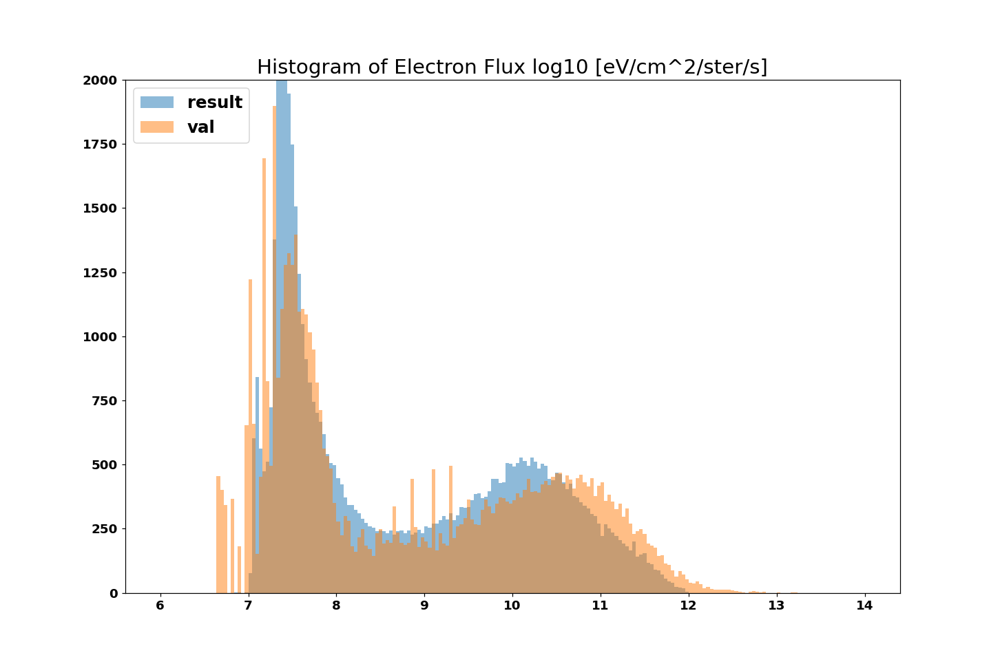

<IPython.core.display.Javascript object>


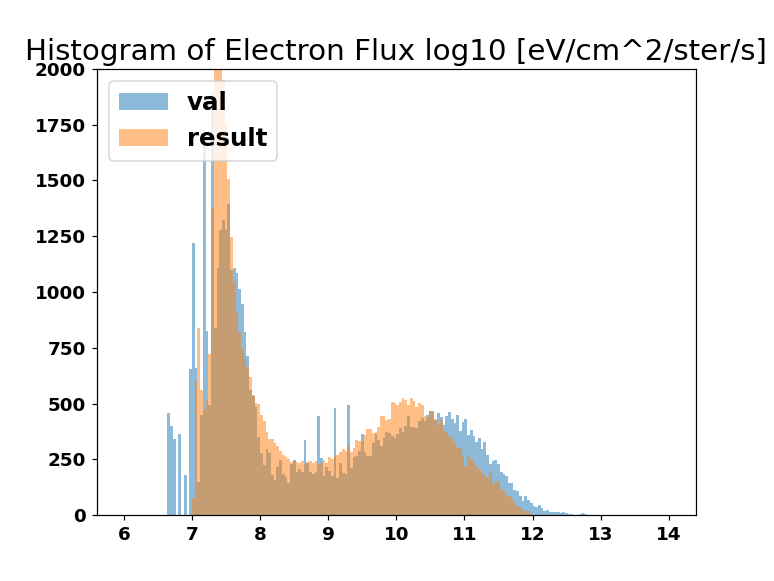

<IPython.core.display.Javascript object>


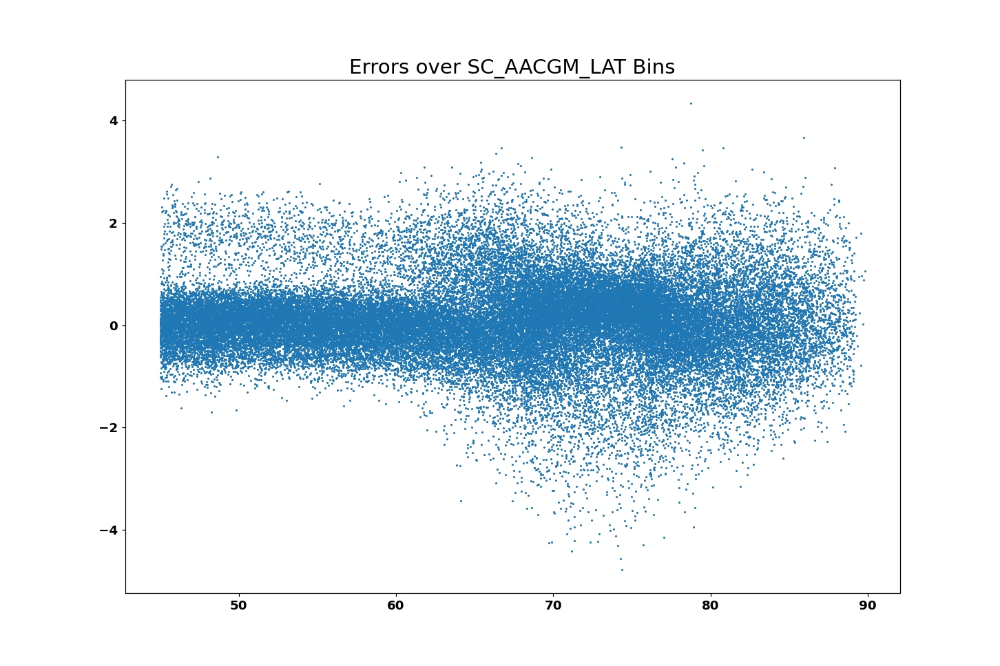

<IPython.core.display.Javascript object>


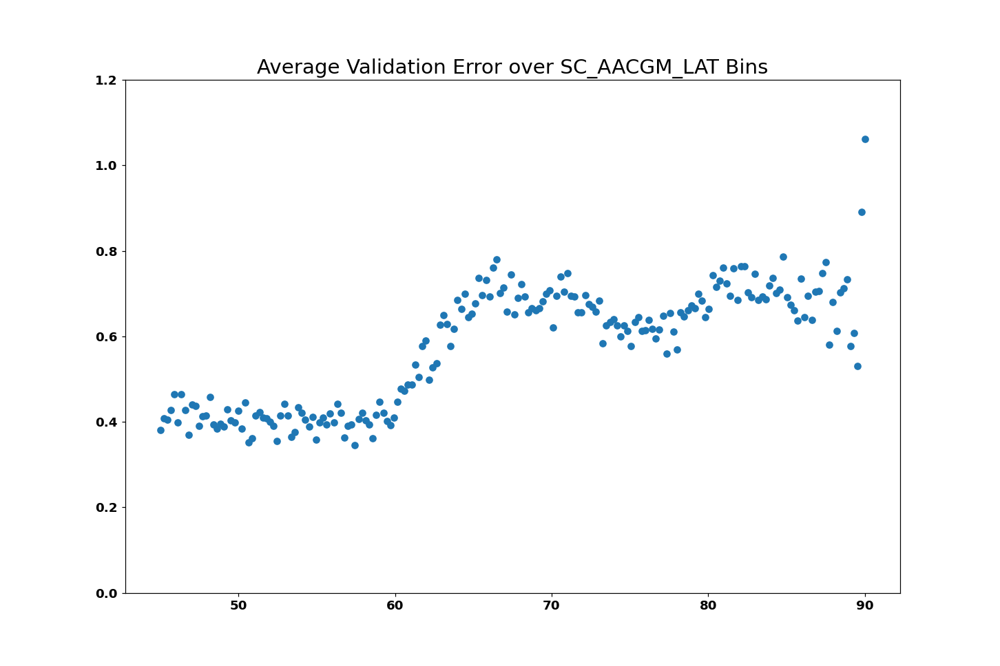

<IPython.core.display.Javascript object>


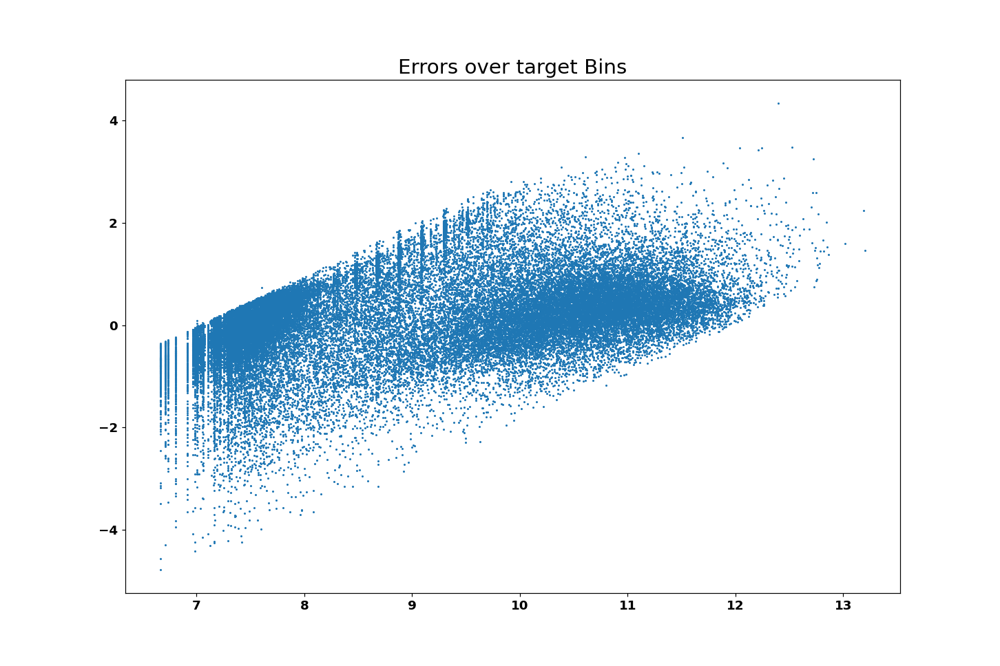

<IPython.core.display.Javascript object>


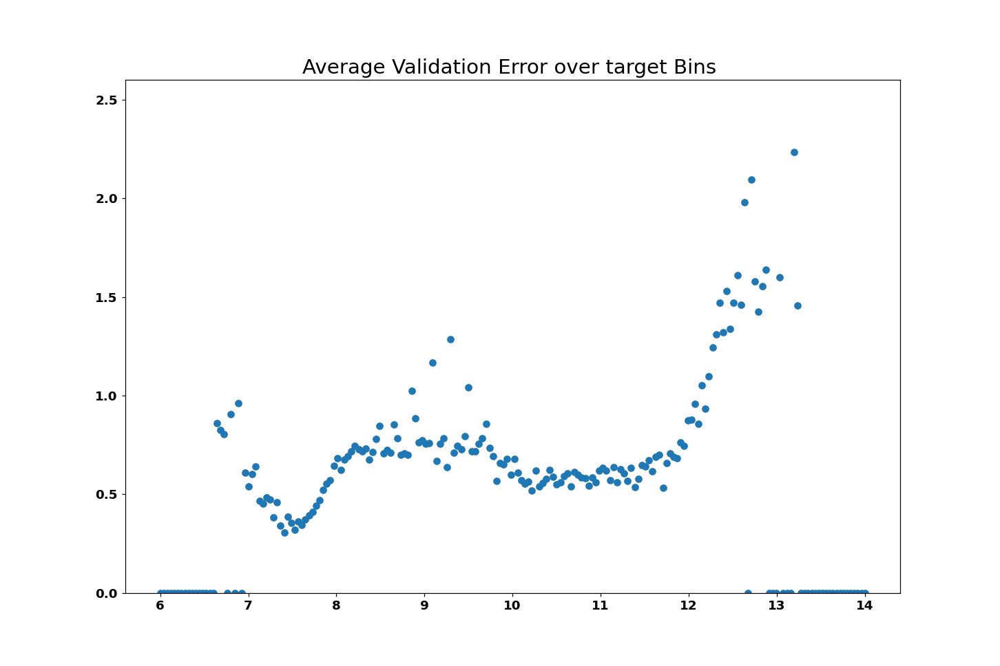

In [83]:
filename='model_3_dist_tail_Weighted'
model.save(filename)
model = tensorflow.keras.models.load_model(filename)


results = model.predict(X_test)

df_results = pd.DataFrame(data=results, index = df_val.index)

model_3 = df_results

plot_model(df_results)

18/18 [==============================] - 0s 2ms/step - loss: 1.4776 - mean_squared_error: 1.4776
0.05 percentile 0.6275713443756104
0.1 percentile 0.6313798427581787
0.15 percentile 0.6418837308883667
0.2 percentile 0.6527086496353149
0.25 percentile 0.6713895201683044
0.3 percentile 0.6952540874481201
0.35 percentile 0.7231497168540955
0.4 percentile 0.755666971206665
0.45 percentile 0.7867427468299866
0.5 percentile 0.7935022711753845
0.55 percentile 0.791144073009491
0.6 percentile 0.7539731860160828
0.65 percentile 0.6860591173171997
0.7 percentile 0.6551782488822937
0.75 percentile 0.655182421207428
0.8 percentile 0.6613374352455139
0.85 percentile 0.6777945756912231
0.9 percentile 0.7203571200370789
0.95 percentile 0.8233981132507324
0.05 percentile from left 0.8576861619949341
0.1 percentile from left 0.7028692364692688
0.15 percentile from left 0.6222244501113892
0.2 percentile from left 0.5835316181182861
0.25 percentile from left 0.5414655804634094
0.3 percentile from left 0.

<IPython.core.display.Javascript object>


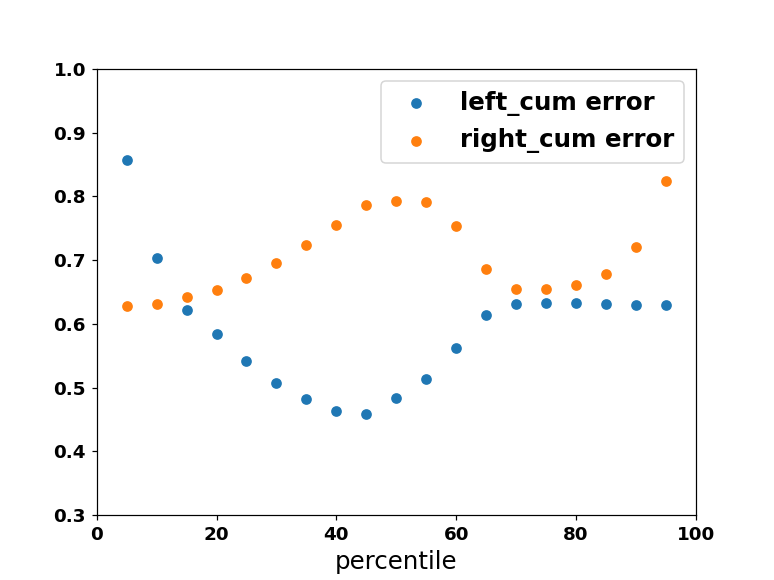

In [84]:
model.evaluate(X_test,y_val_log.values)
model.evaluate(X_val_90.values,y_val_log_90.values)
model.evaluate(X_val_95.values,y_val_log_95.values)
model.evaluate(X_val_99.values,y_val_log_99.values)

i=0
right_cum = []
for percent in [.05,.1,.15,.2,.25,.3,.35,.4,.45,.5,.55,.6,.65,.7,.75,.8,.85,.9,.95]:
    right_cum.append(model.evaluate(X_val_precentile[i],y_val_log_precentile[i],verbose=0)[0])
    print((percentile[i]+' percentile'), right_cum[i] )
    i = i+ 1

i=0
left_cum = []
for percent in [.05,.1,.15,.2,.25,.3,.35,.4,.45,.5,.55,.6,.65,.7,.75,.8,.85,.9,.95]:
    left_cum.append(model.evaluate(X_val_precentile_left[i],y_val_log_precentile_left[i],verbose=0)[0])
    print((percentile_left[i]+' percentile from left'),  left_cum[i])
    i = i+ 1    
    
plt.figure()
plt.scatter(np.array([.05,.1,.15,.2,.25,.3,.35,.4,.45,.5,.55,.6,.65,.7,.75,.8,.85,.9,.95])*100,left_cum)
plt.scatter(np.array([.05,.1,.15,.2,.25,.3,.35,.4,.45,.5,.55,.6,.65,.7,.75,.8,.85,.9,.95])*100,right_cum)
plt.xlim([0,100])
plt.ylim([0.3,1])
plt.legend(['left_cum error','right_cum error'])
plt.xlabel('percentile')


plt.show()

In [85]:
results = model.predict(X_test)
model_3_dist_tail_weighted = pd.DataFrame(data=results, index = df_val.index)


<IPython.core.display.Javascript object>


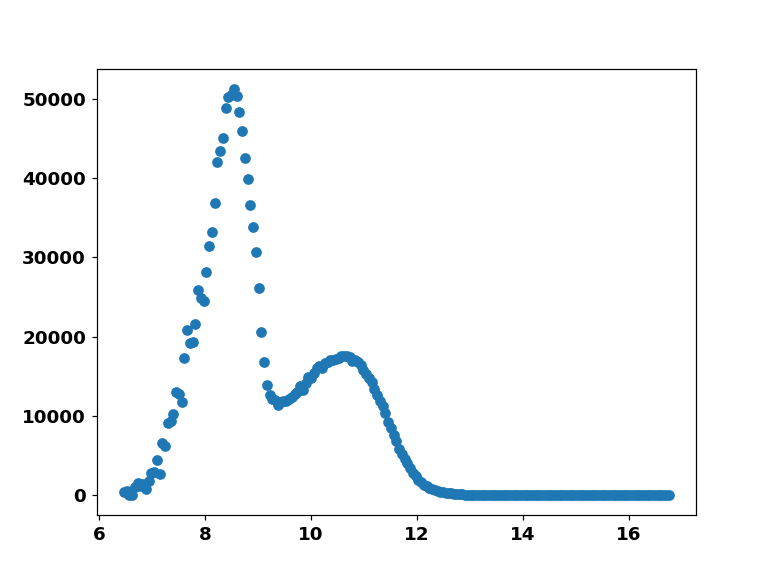

<IPython.core.display.Javascript object>


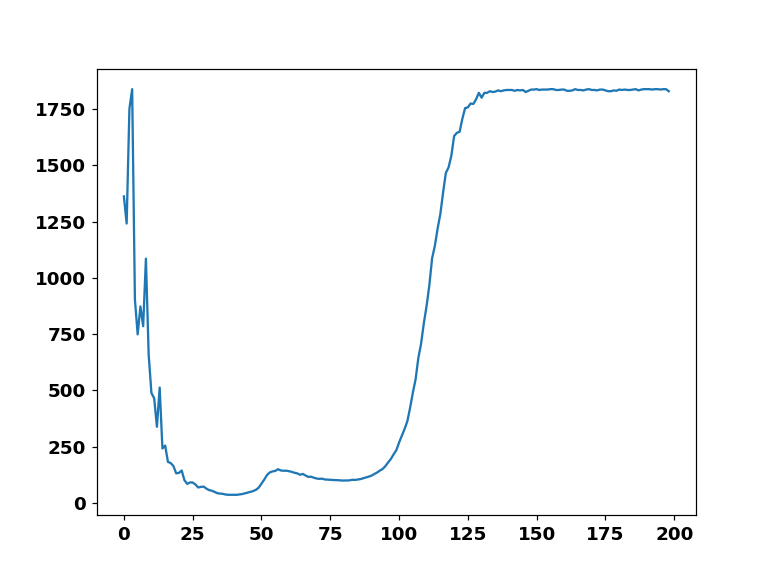

1838283


<IPython.core.display.Javascript object>


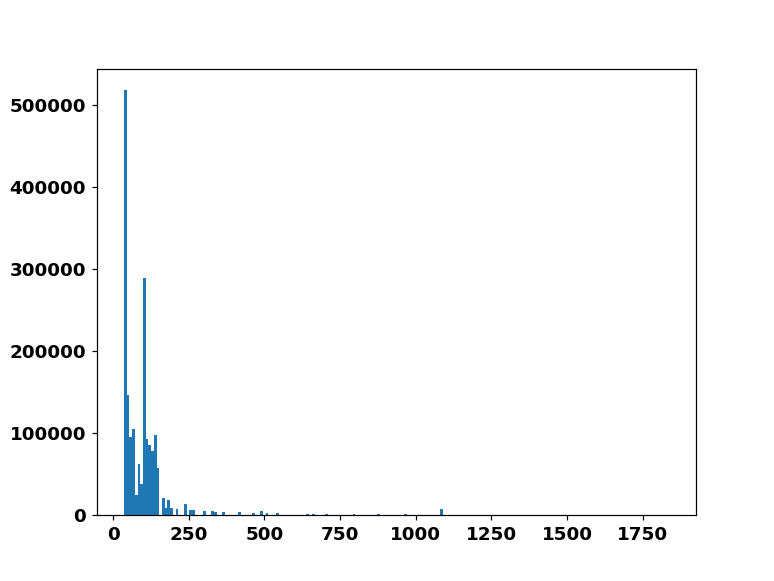

In [87]:
bins = np.linspace(np.min(y_train_log),np.max(y_train_log),200)
hist,bins = np.histogram(y_train_log,bins =bins)
plt.figure()
plt.scatter(bins[1:],hist)
plt.figure()
print(y_train_log.size)
plt.plot(y_train_log.size/(hist+1000))
bin_size = bins[1]-bins[0]
y_min = np.min(y_train_log)
sample_weights = np.ones((y_train_log.size))
for i in range(0,y_train_log.size):
    bin_i = int((y_train_log[i]-y_min)/bin_size)
    if bin_i ==199:
        bin_i = 198
    if bin_i < 8:
        bin_i = 8
    sample_weights[i] = y_train_log.size/(hist[bin_i]+1000)
    
plt.figure()
plt.hist(sample_weights,bins=200)
plt.show()

Model: "functional_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_3 (InputLayer)         [(None, 148)]             0         
_________________________________________________________________
dense_18 (Dense)             (None, 256)               38144     
_________________________________________________________________
dropout_2 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_19 (Dense)             (None, 64)                16448     
_________________________________________________________________
dense_20 (Dense)             (None, 32)                2080      
_________________________________________________________________
dense_21 (Dense)             (None, 256)               8448      
_________________________________________________________________
dense_22 (Dense)             (None, 1024)             

Epoch 71/1000
57/57 - 2s - loss: 77.9701 - mse: 0.5928 - val_loss: 0.7184 - val_mse: 0.7184
Epoch 72/1000
57/57 - 2s - loss: 77.4011 - mse: 0.5897 - val_loss: 0.6751 - val_mse: 0.6751
Epoch 73/1000
57/57 - 2s - loss: 77.7373 - mse: 0.5925 - val_loss: 0.6783 - val_mse: 0.6783
Epoch 74/1000
57/57 - 2s - loss: 77.5269 - mse: 0.5905 - val_loss: 0.7040 - val_mse: 0.7040
Epoch 75/1000
57/57 - 2s - loss: 76.7429 - mse: 0.5853 - val_loss: 0.6795 - val_mse: 0.6795
Epoch 76/1000
57/57 - 2s - loss: 76.0914 - mse: 0.5804 - val_loss: 0.6806 - val_mse: 0.6806
Epoch 77/1000
57/57 - 2s - loss: 76.3800 - mse: 0.5841 - val_loss: 0.6972 - val_mse: 0.6972
Epoch 78/1000
57/57 - 2s - loss: 76.5353 - mse: 0.5845 - val_loss: 0.6789 - val_mse: 0.6789
Epoch 79/1000
57/57 - 2s - loss: 76.7614 - mse: 0.5858 - val_loss: 0.6802 - val_mse: 0.6802
Epoch 80/1000
57/57 - 2s - loss: 75.8817 - mse: 0.5797 - val_loss: 0.6669 - val_mse: 0.6669
Epoch 81/1000
57/57 - 2s - loss: 76.6650 - mse: 0.5874 - val_loss: 0.8572 - val_

Epoch 160/1000
57/57 - 2s - loss: 69.6106 - mse: 0.5436 - val_loss: 0.6984 - val_mse: 0.6984
Epoch 161/1000
57/57 - 2s - loss: 70.0678 - mse: 0.5471 - val_loss: 0.6734 - val_mse: 0.6734
Epoch 162/1000
57/57 - 2s - loss: 69.8578 - mse: 0.5439 - val_loss: 0.6967 - val_mse: 0.6967
Epoch 163/1000
57/57 - 2s - loss: 69.4797 - mse: 0.5429 - val_loss: 0.6603 - val_mse: 0.6603
Epoch 164/1000
57/57 - 2s - loss: 69.8989 - mse: 0.5450 - val_loss: 0.6757 - val_mse: 0.6757
Epoch 165/1000
57/57 - 2s - loss: 69.4034 - mse: 0.5423 - val_loss: 0.6741 - val_mse: 0.6741
Epoch 166/1000
57/57 - 2s - loss: 69.5589 - mse: 0.5427 - val_loss: 0.6771 - val_mse: 0.6771
Epoch 167/1000
57/57 - 2s - loss: 69.7844 - mse: 0.5469 - val_loss: 0.6661 - val_mse: 0.6661
Epoch 168/1000
57/57 - 2s - loss: 69.9863 - mse: 0.5470 - val_loss: 0.6513 - val_mse: 0.6513
Epoch 169/1000
57/57 - 2s - loss: 69.1570 - mse: 0.5413 - val_loss: 0.6679 - val_mse: 0.6679
Epoch 170/1000
57/57 - 2s - loss: 69.0608 - mse: 0.5399 - val_loss: 0.

<IPython.core.display.Javascript object>


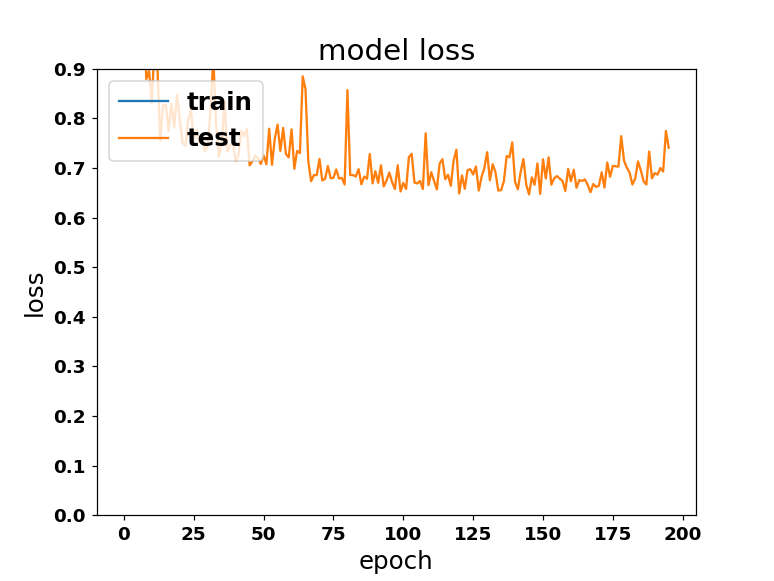

<IPython.core.display.Javascript object>


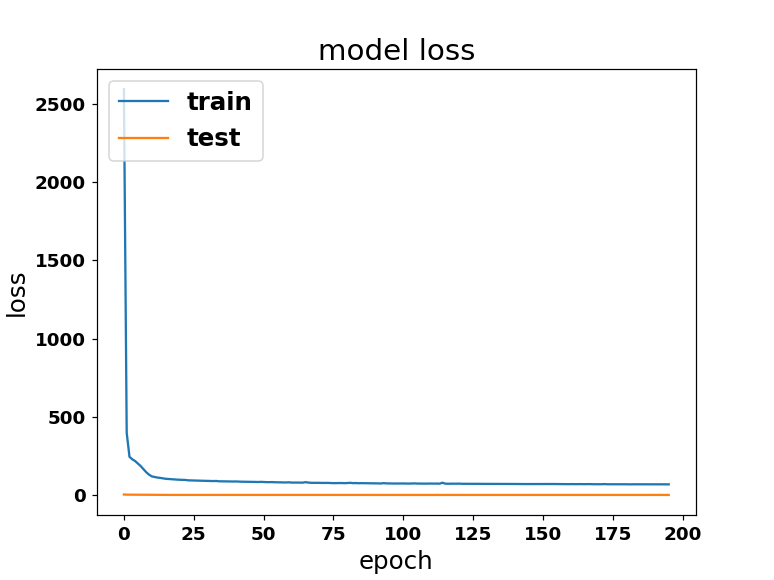

<IPython.core.display.Javascript object>


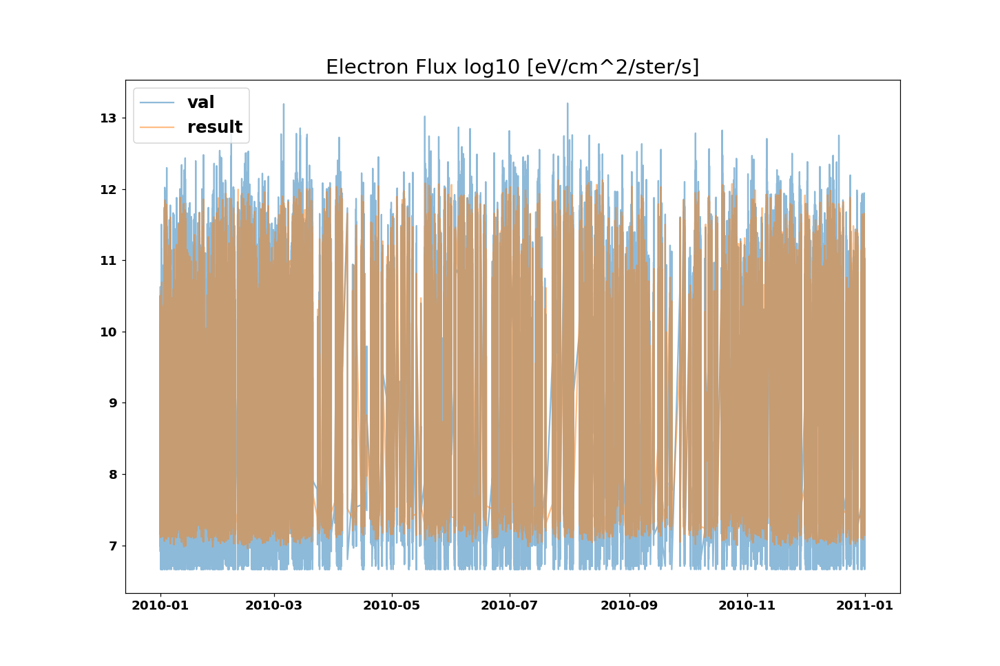

<IPython.core.display.Javascript object>


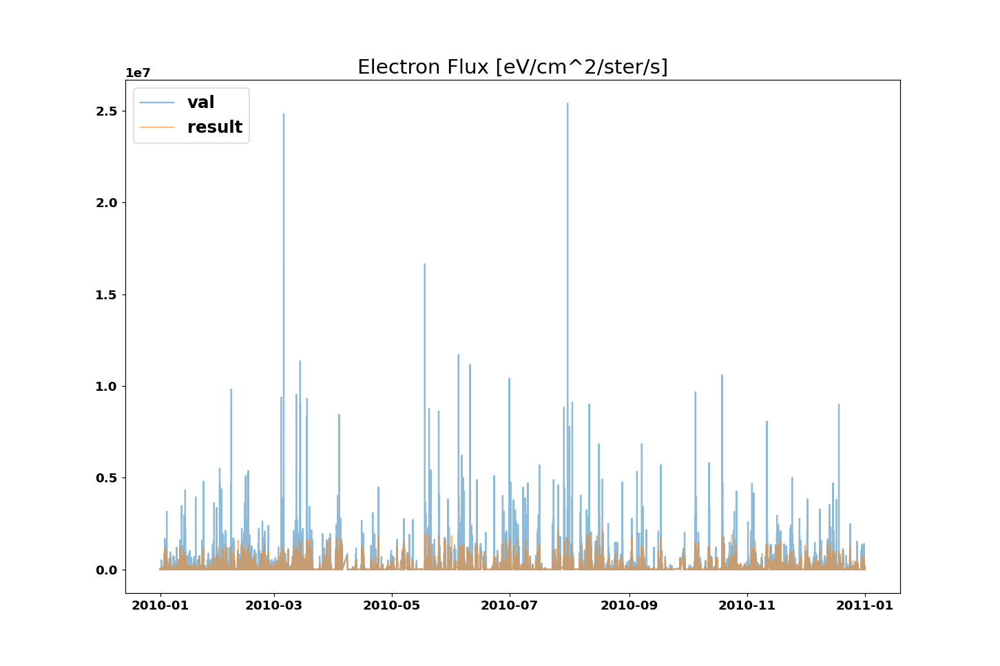

<IPython.core.display.Javascript object>


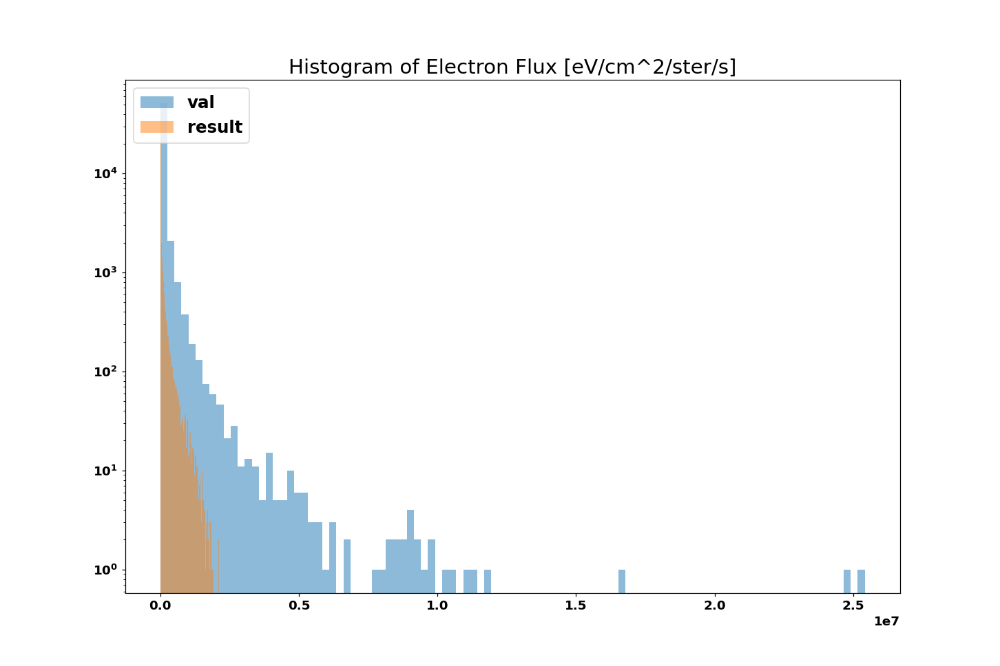

<IPython.core.display.Javascript object>


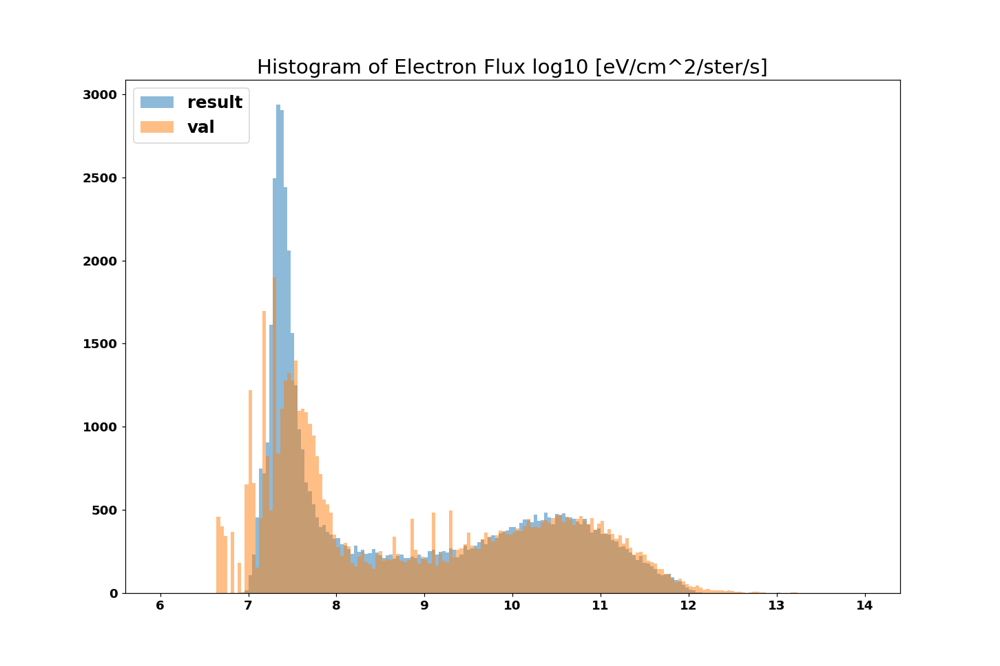

<IPython.core.display.Javascript object>


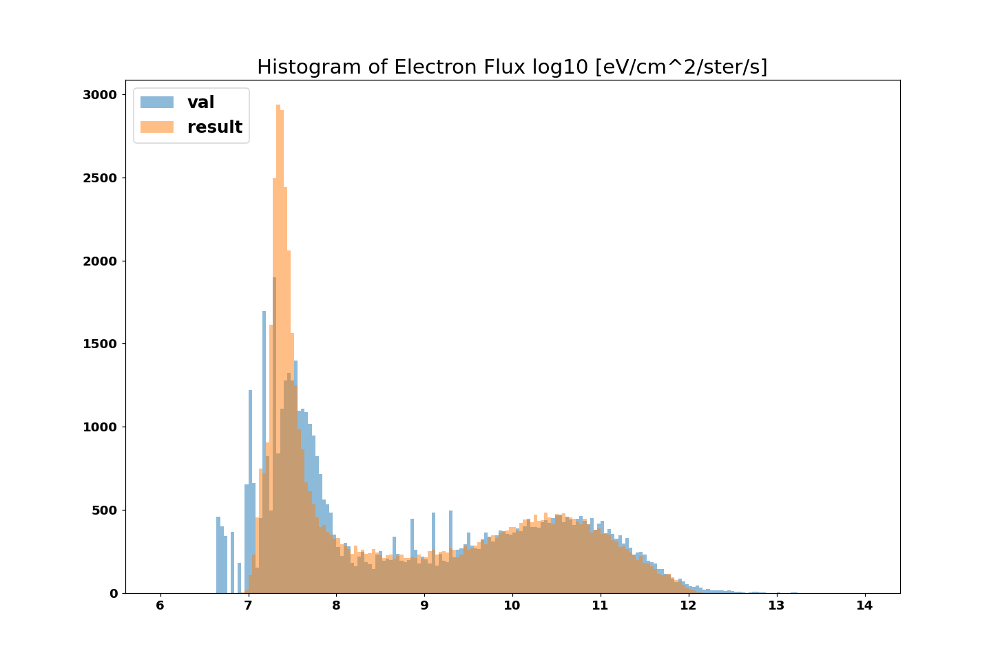

<IPython.core.display.Javascript object>


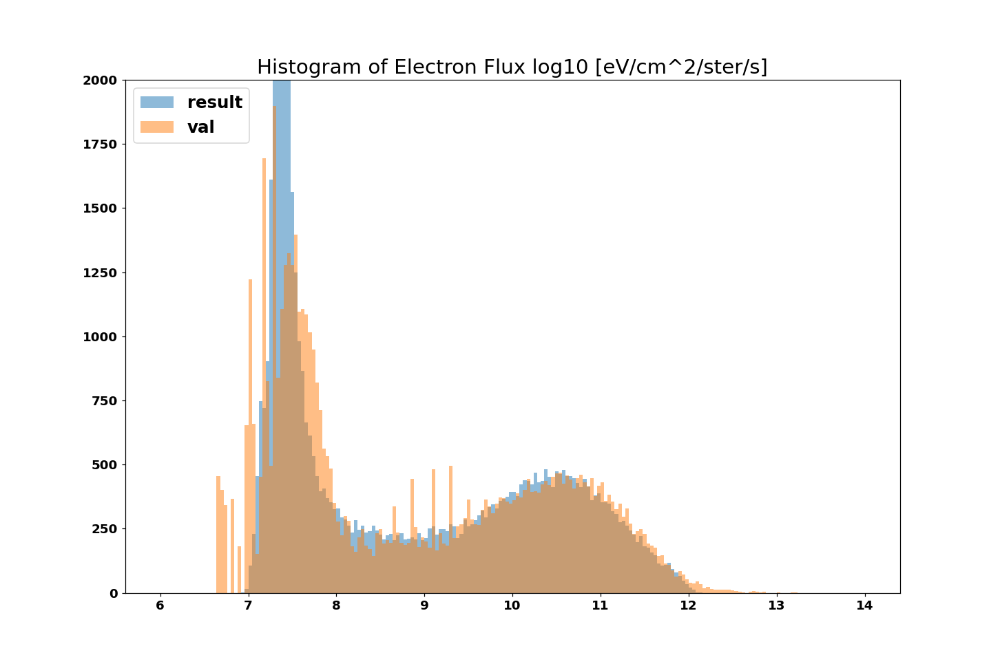

<IPython.core.display.Javascript object>


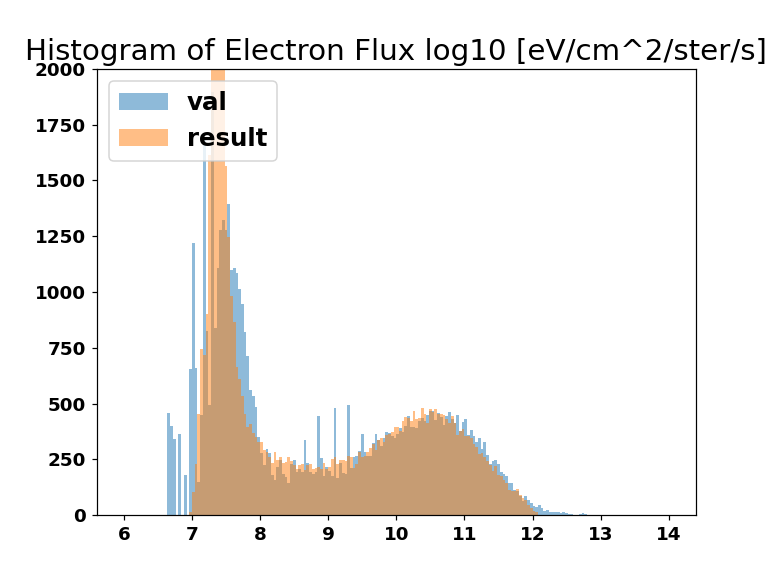

<IPython.core.display.Javascript object>


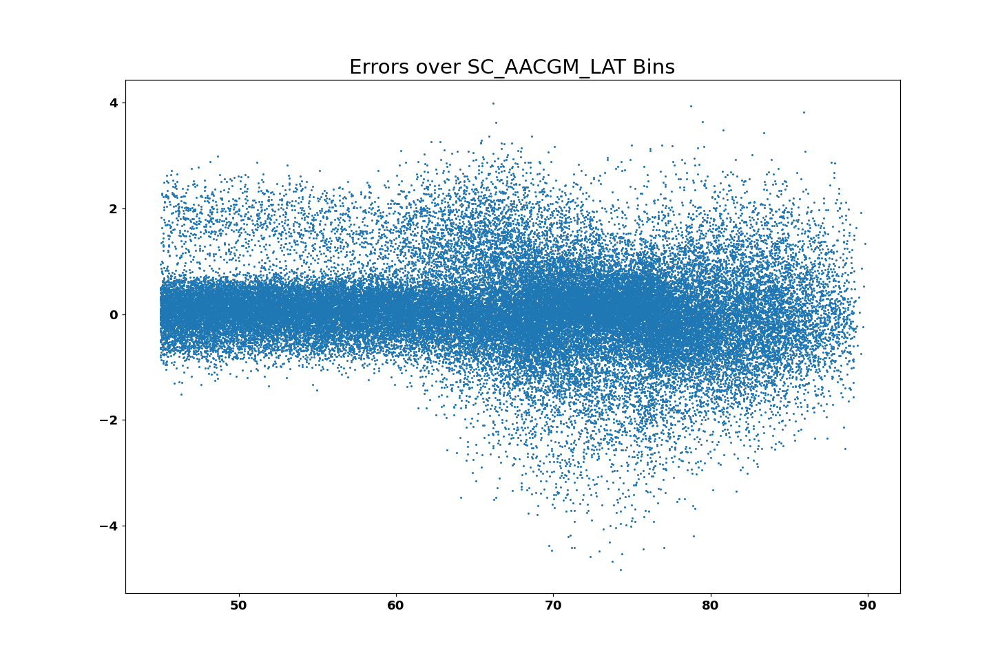

<IPython.core.display.Javascript object>


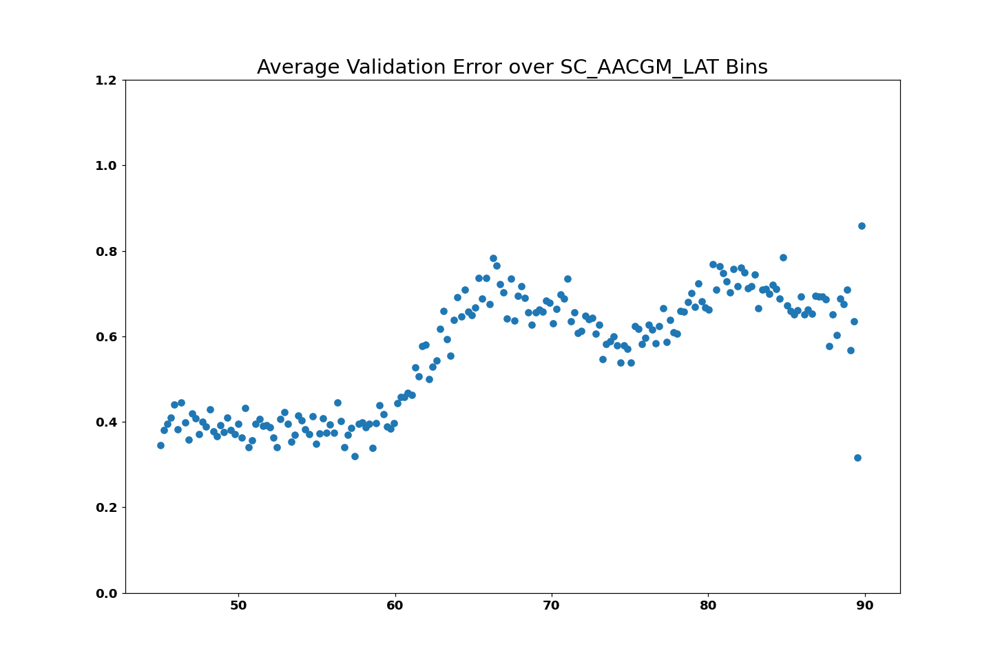

<IPython.core.display.Javascript object>


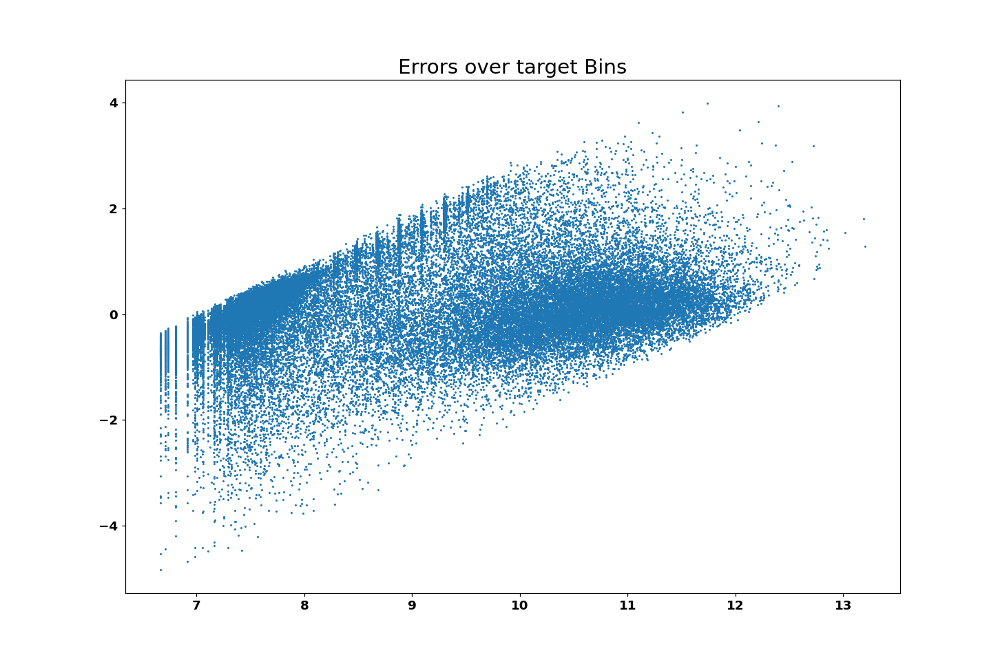

<IPython.core.display.Javascript object>


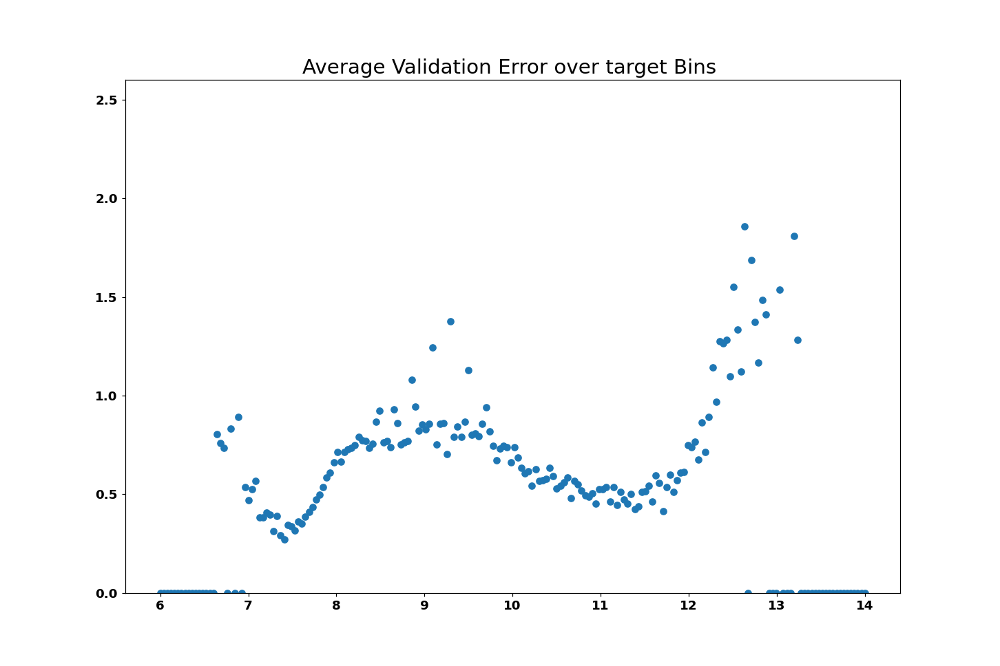

In [88]:
from tensorflow.keras.layers import Input

input1 = Input(shape=(148))
model1 = Dense(256,  activation='relu')(input1)
model1 = model1 = Dropout(0.5)(model1)
model1 = Dense(64, activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(int(256),   activation='relu')(model1)
model1 = Dense(int(1024),  activation='relu')(model1)
model1 = Dense(int(256),  activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(4, activation='relu')(model1)
model1 = Dense(1, activation='linear' )(model1)


output = model1
model = tensorflow.keras.models.Model(inputs=input1, outputs=output)
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',metrics=['mse'])
model.summary()

history = model.fit(X, 
                   y_train_log, 
                    validation_data=(
                        X_test, 
                        y_val_log,                                    ), sample_weight=sample_weights,
                    batch_size=32768,epochs=1000,verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=50)])#


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.ylim([0,.9])
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

results = model.predict(X_test)

df_results = pd.DataFrame(data=results, index = df_val.index)

model_3_dist_tail2 = df_results

plot_model(df_results)



In [90]:
filename='model_3_dist_tail_Weighted2'
model.save(filename)
model = tensorflow.keras.models.load_model(filename)

INFO:tensorflow:Assets written to: model_3_dist_tail_Weighted2/assets


<IPython.core.display.Javascript object>


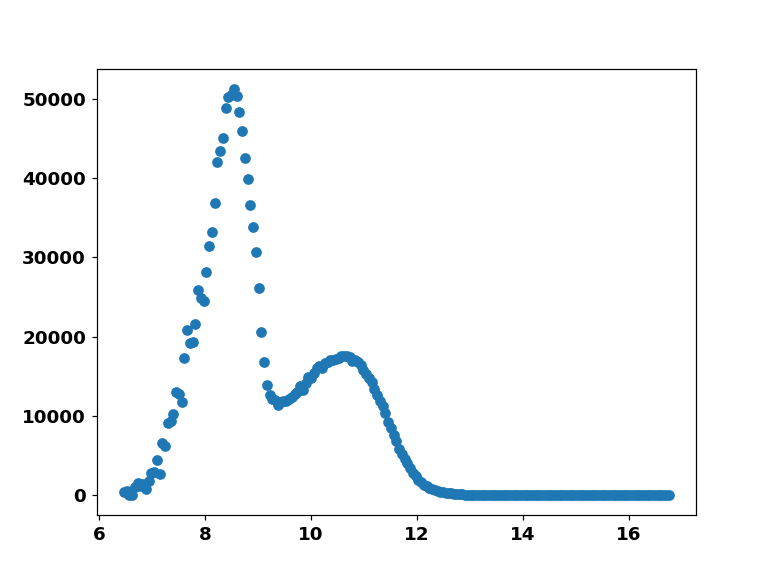

<IPython.core.display.Javascript object>


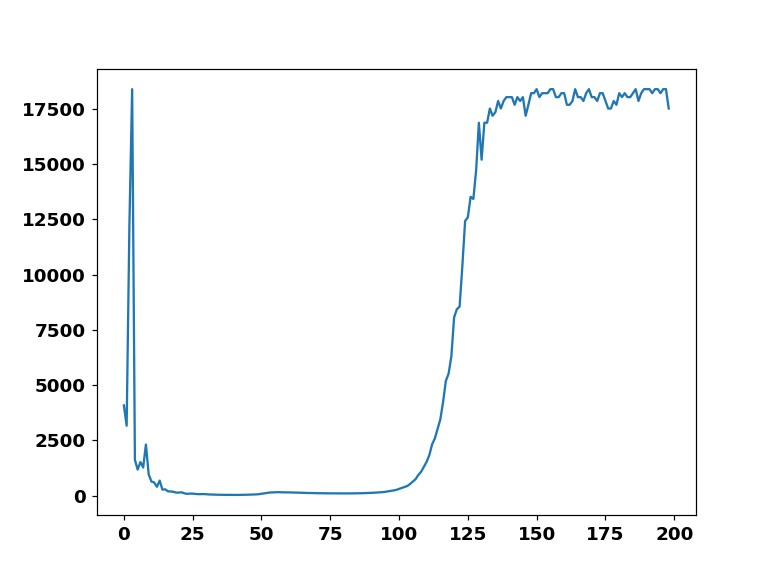

1838283


<IPython.core.display.Javascript object>


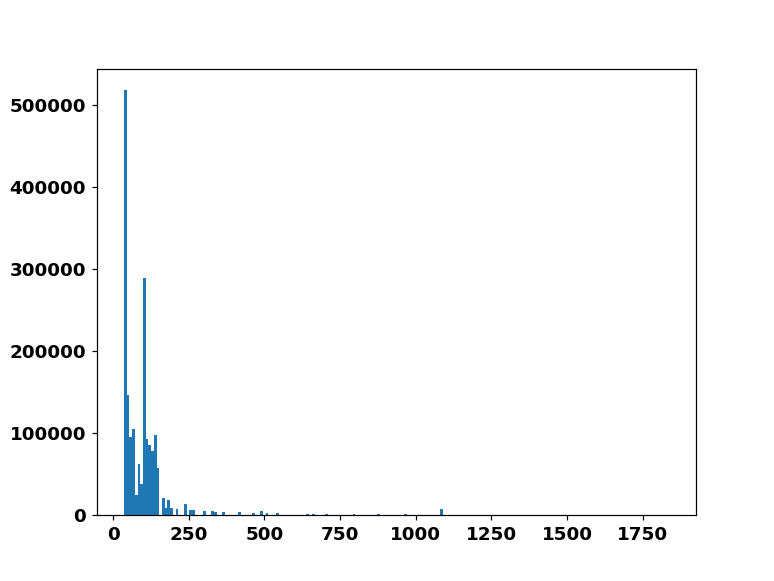

In [89]:
bins = np.linspace(np.min(y_train_log),np.max(y_train_log),200)
hist,bins = np.histogram(y_train_log,bins =bins)
plt.figure()
plt.scatter(bins[1:],hist)
plt.figure()
print(y_train_log.size)
plt.plot(y_train_log.size/(hist+100))
bin_size = bins[1]-bins[0]
y_min = np.min(y_train_log)
sample_weights = np.ones((y_train_log.size))
for i in range(0,y_train_log.size):
    bin_i = int((y_train_log[i]-y_min)/bin_size)
    if bin_i ==199:
        bin_i = 198
    if bin_i < 8:
        bin_i = 8
    sample_weights[i] = y_train_log.size/(hist[bin_i]+1000)
    
plt.figure()
plt.hist(sample_weights,bins=200)
plt.show()

Model: "functional_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_4 (InputLayer)         [(None, 148)]             0         
_________________________________________________________________
dense_27 (Dense)             (None, 256)               38144     
_________________________________________________________________
dropout_3 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_28 (Dense)             (None, 64)                16448     
_________________________________________________________________
dense_29 (Dense)             (None, 32)                2080      
_________________________________________________________________
dense_30 (Dense)             (None, 256)               8448      
_________________________________________________________________
dense_31 (Dense)             (None, 1024)             

Epoch 71/1000
57/57 - 2s - loss: 78.6585 - mse: 0.6015 - val_loss: 0.7163 - val_mse: 0.7163
Epoch 72/1000
57/57 - 2s - loss: 77.5081 - mse: 0.5905 - val_loss: 0.7013 - val_mse: 0.7013
Epoch 73/1000
57/57 - 2s - loss: 77.3427 - mse: 0.5890 - val_loss: 0.6791 - val_mse: 0.6791
Epoch 74/1000
57/57 - 2s - loss: 77.1744 - mse: 0.5875 - val_loss: 0.7393 - val_mse: 0.7393
Epoch 75/1000
57/57 - 2s - loss: 77.2016 - mse: 0.5893 - val_loss: 0.6817 - val_mse: 0.6817
Epoch 76/1000
57/57 - 2s - loss: 77.0336 - mse: 0.5876 - val_loss: 0.6724 - val_mse: 0.6724
Epoch 77/1000
57/57 - 2s - loss: 77.2014 - mse: 0.5898 - val_loss: 0.6775 - val_mse: 0.6775
Epoch 78/1000
57/57 - 2s - loss: 76.6075 - mse: 0.5868 - val_loss: 0.7645 - val_mse: 0.7645
Epoch 79/1000
57/57 - 2s - loss: 79.5903 - mse: 0.6115 - val_loss: 0.6726 - val_mse: 0.6726
Epoch 80/1000
57/57 - 2s - loss: 76.4512 - mse: 0.5815 - val_loss: 0.7016 - val_mse: 0.7016
Epoch 81/1000
57/57 - 2s - loss: 75.8968 - mse: 0.5811 - val_loss: 0.6889 - val_

<IPython.core.display.Javascript object>


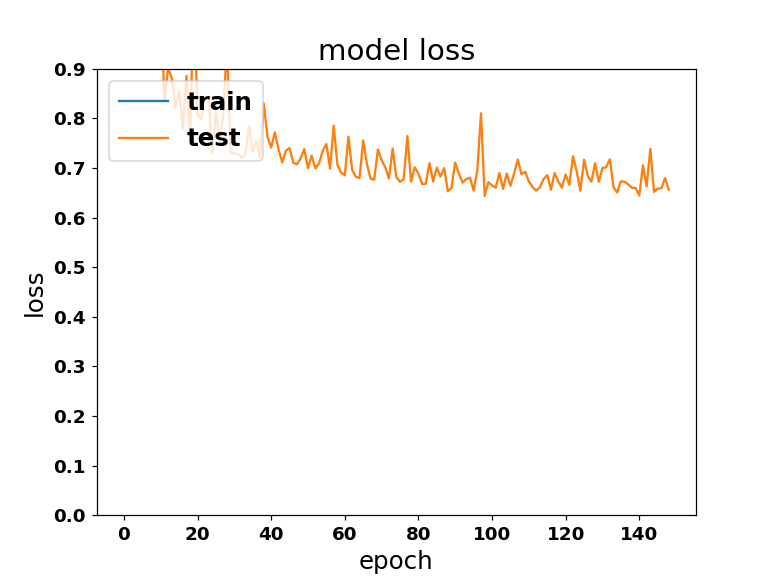

<IPython.core.display.Javascript object>


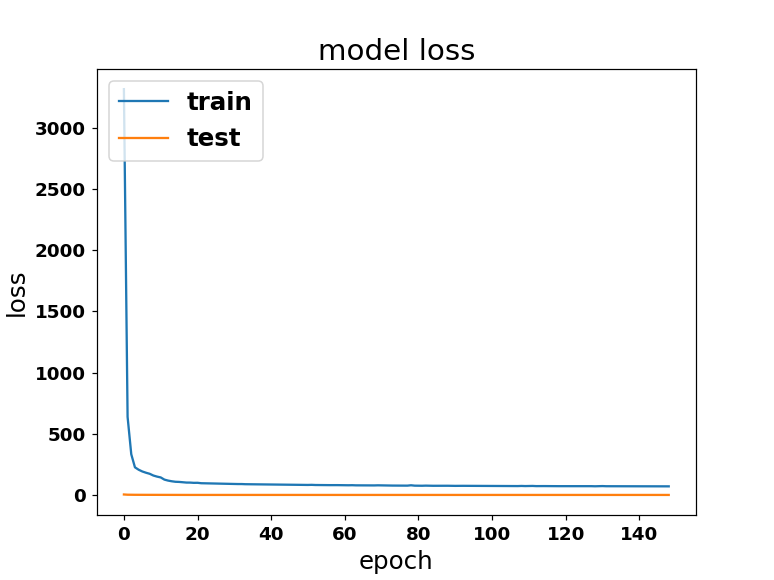

<IPython.core.display.Javascript object>


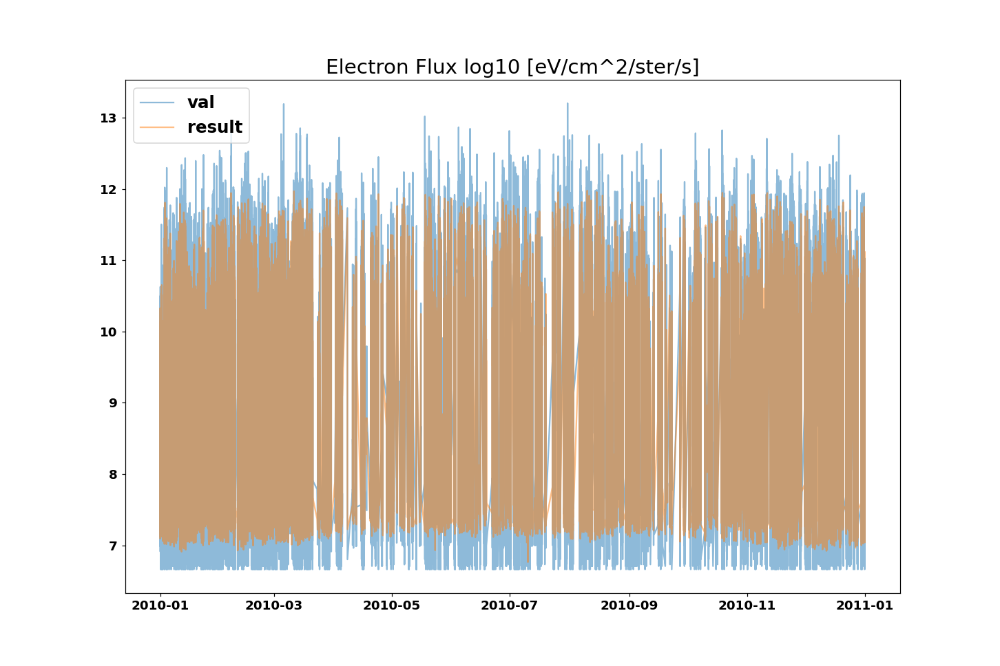

<IPython.core.display.Javascript object>


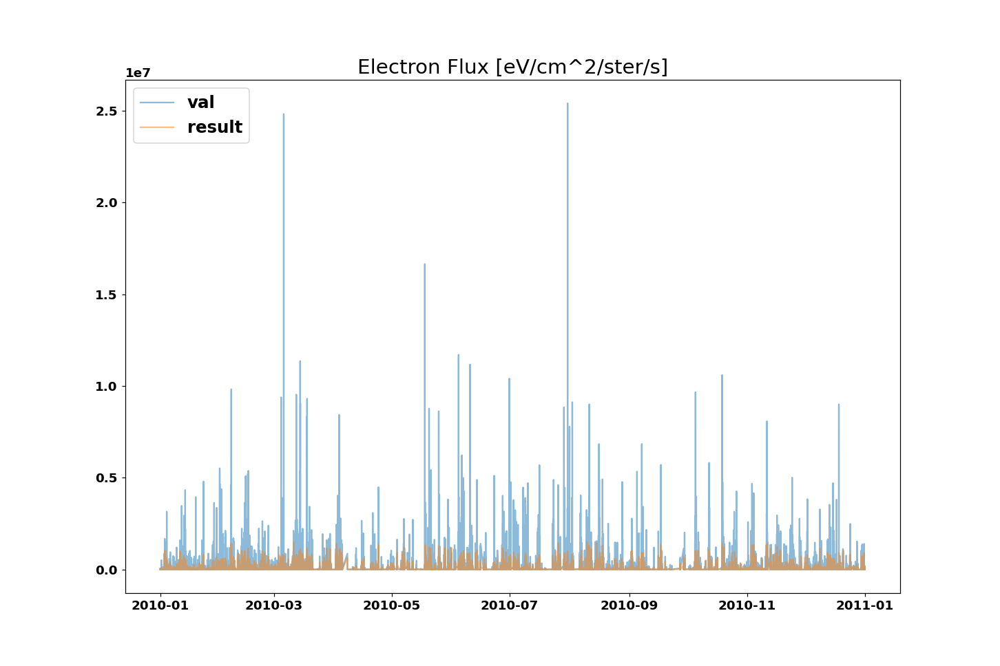

<IPython.core.display.Javascript object>


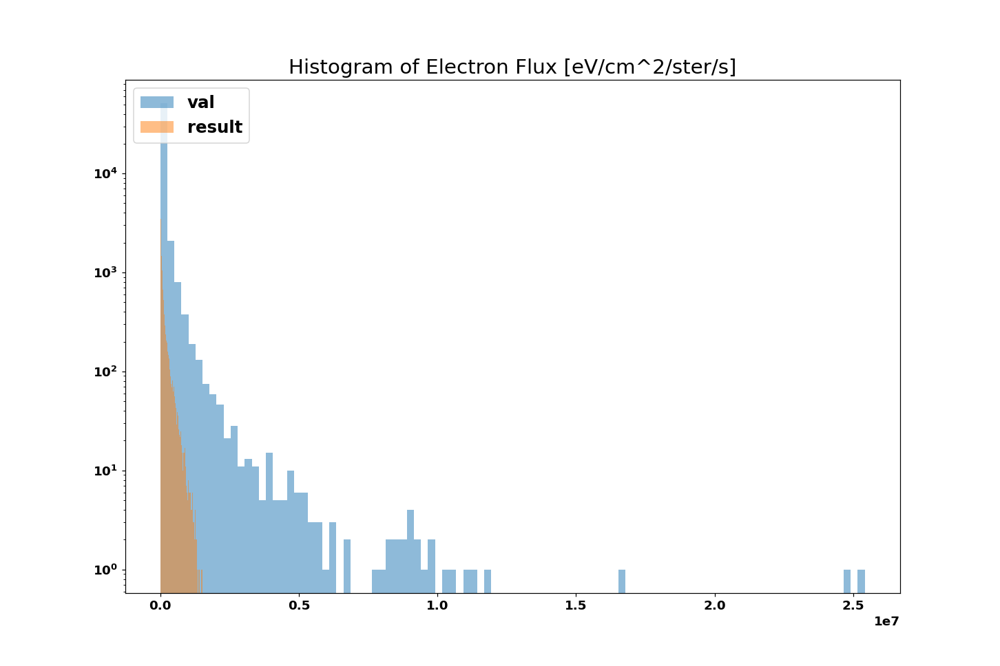

<IPython.core.display.Javascript object>


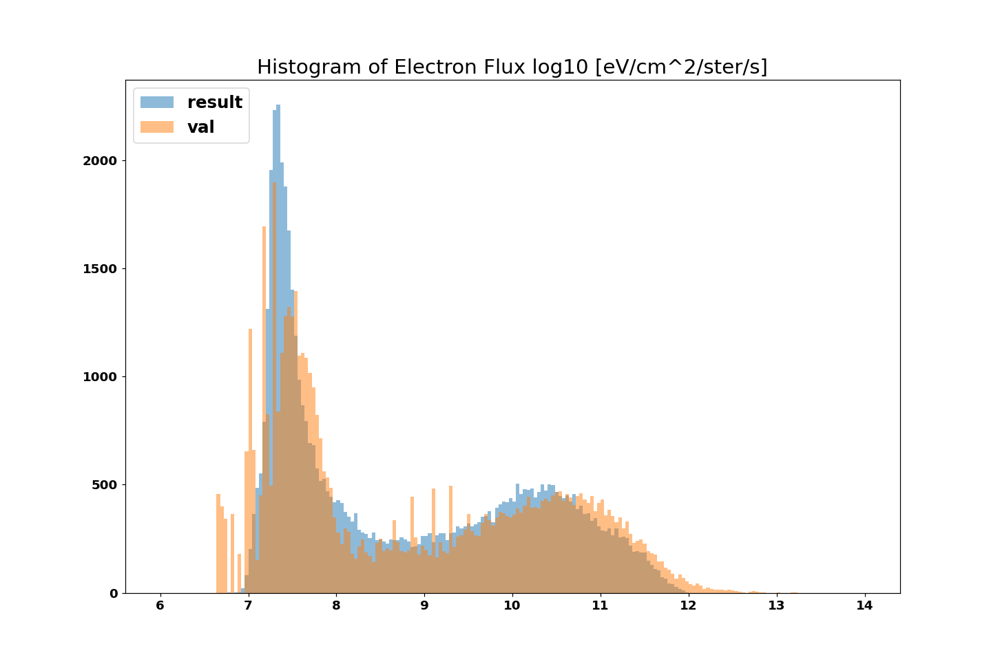

<IPython.core.display.Javascript object>


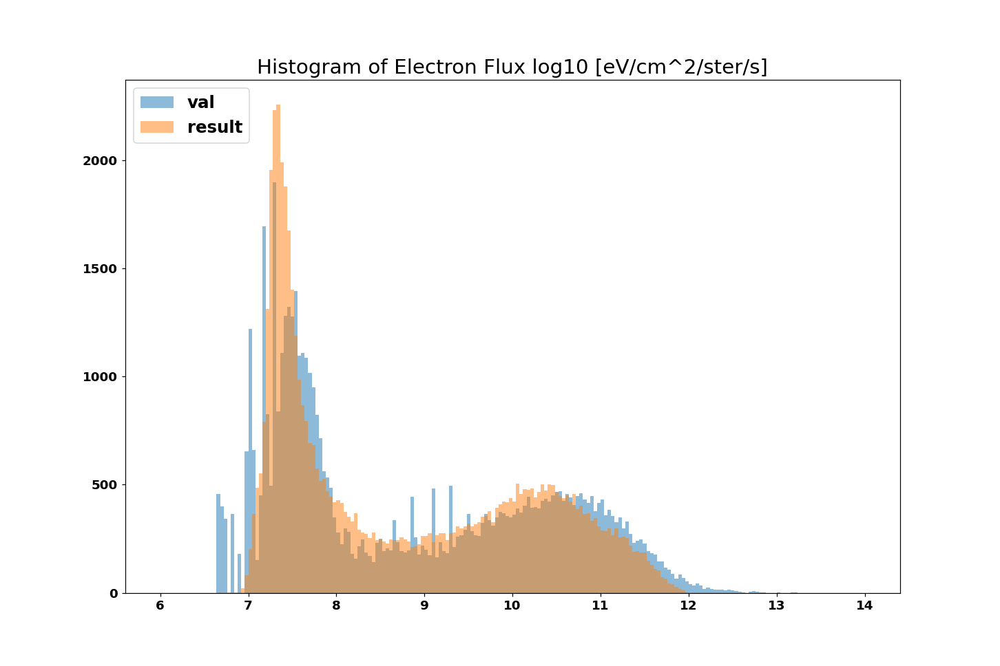

<IPython.core.display.Javascript object>


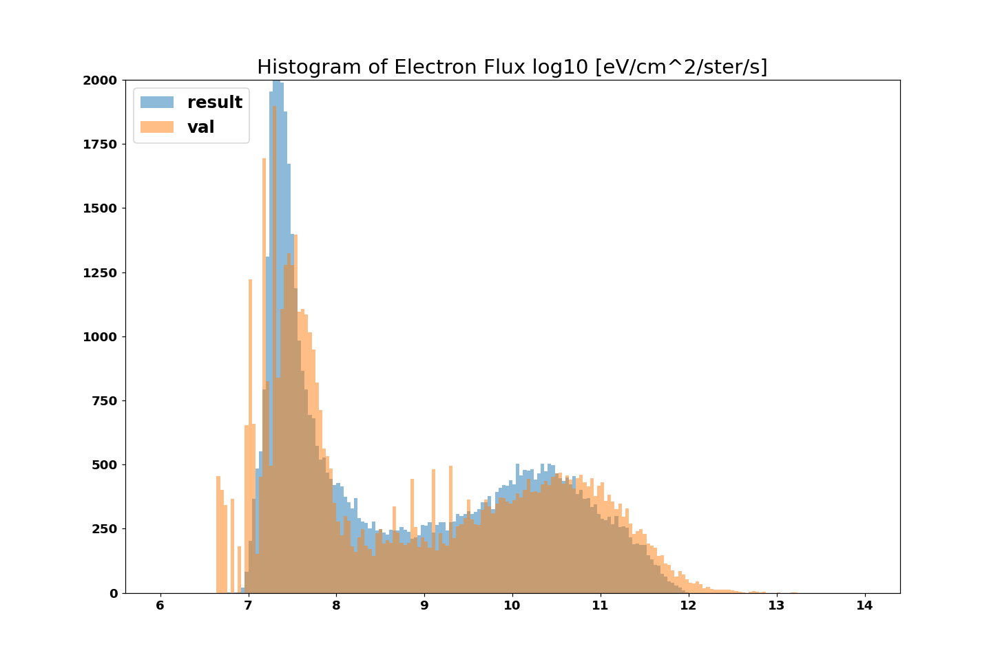

<IPython.core.display.Javascript object>


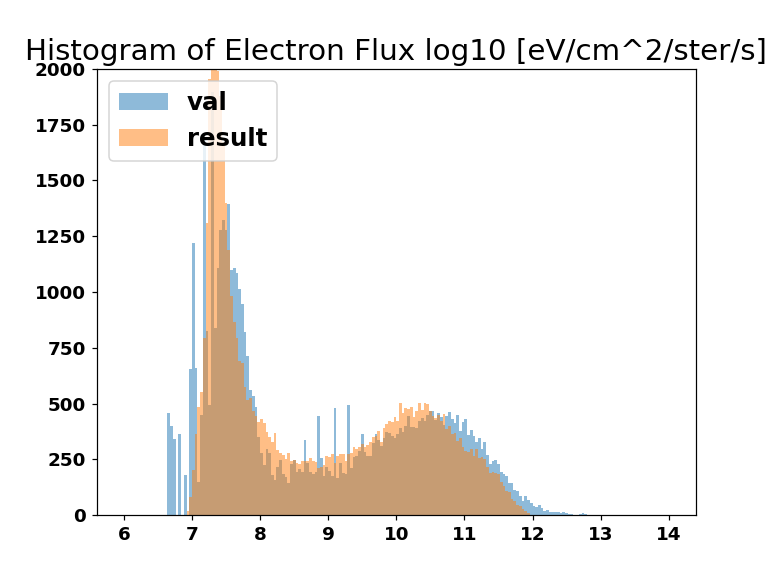

<IPython.core.display.Javascript object>


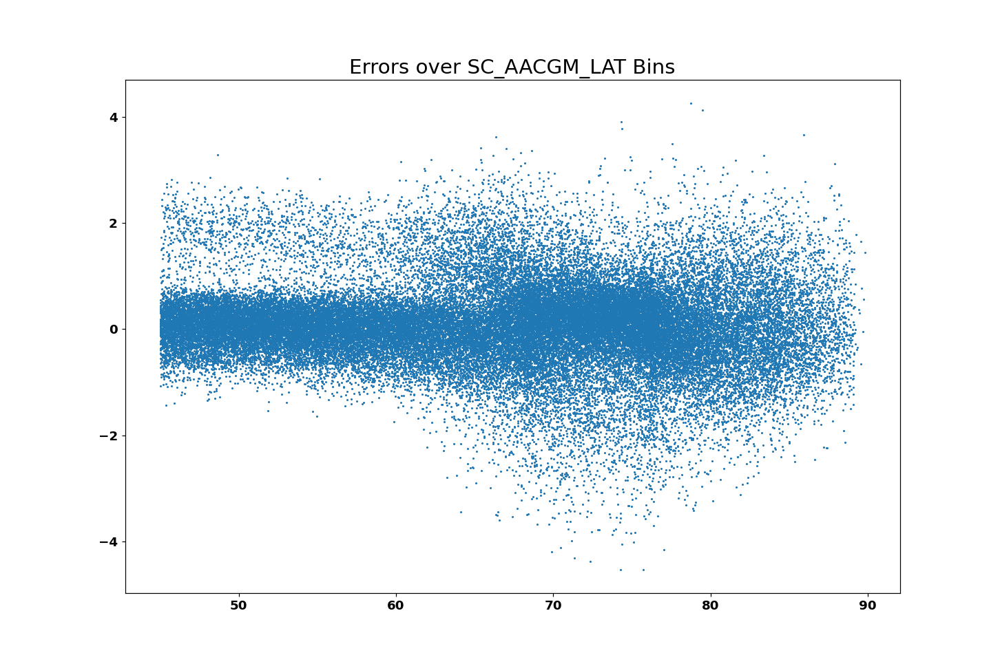

<IPython.core.display.Javascript object>


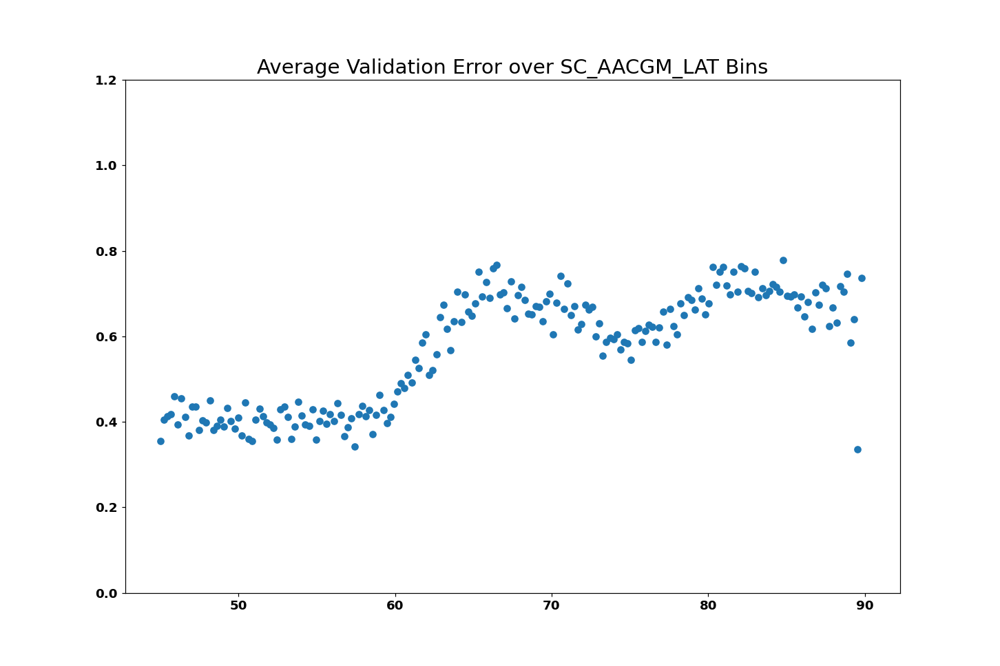

<IPython.core.display.Javascript object>


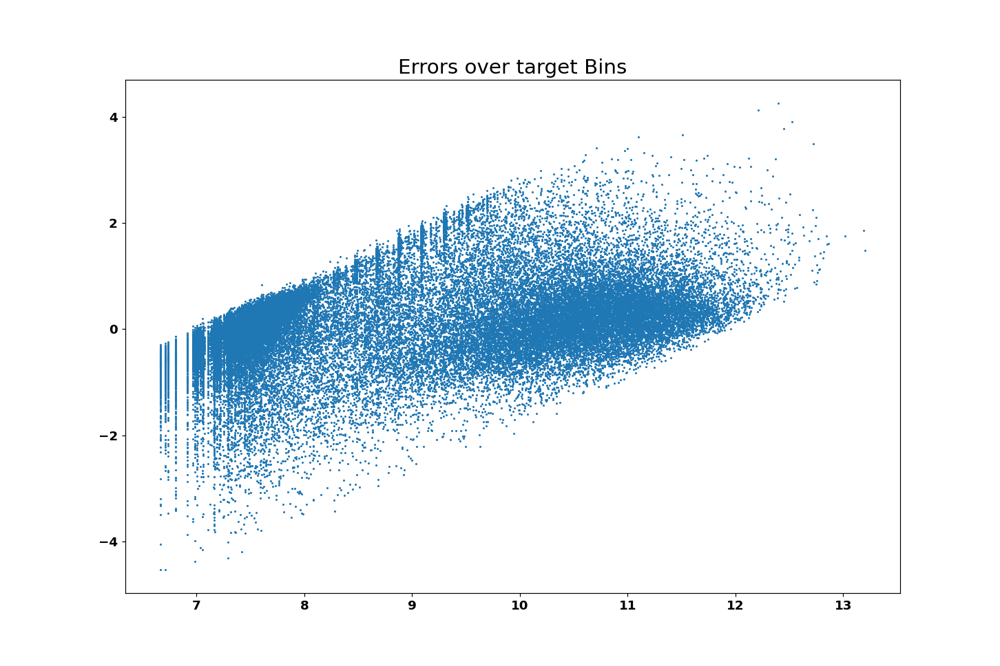

<IPython.core.display.Javascript object>


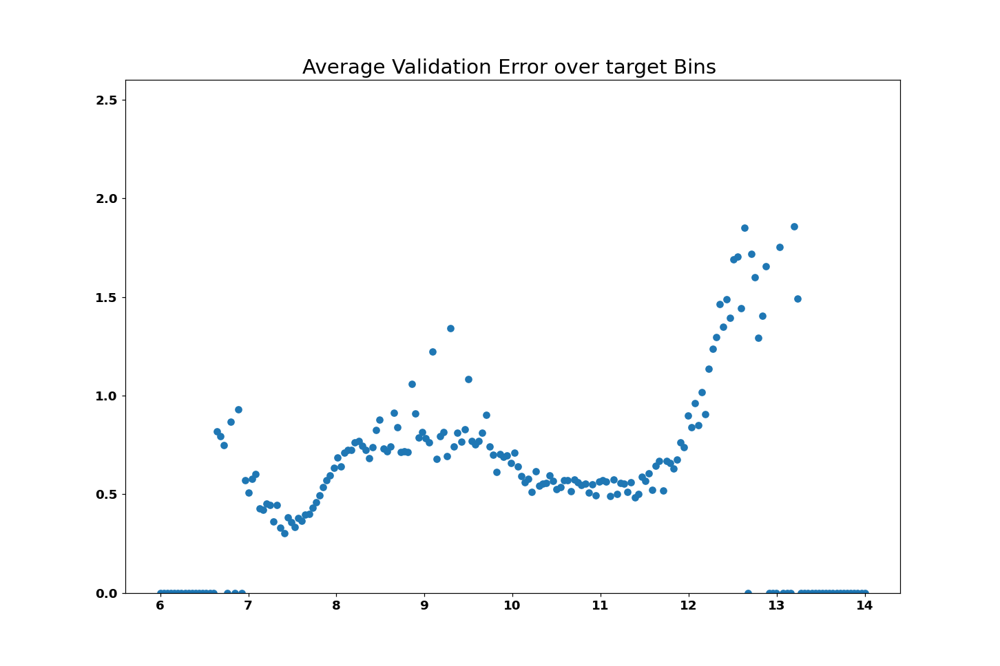

INFO:tensorflow:Assets written to: model_3_dist_tail_Weighted3/assets


In [91]:
from tensorflow.keras.layers import Input

input1 = Input(shape=(148))
model1 = Dense(256,  activation='relu')(input1)
model1 = model1 = Dropout(0.5)(model1)
model1 = Dense(64, activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(int(256),   activation='relu')(model1)
model1 = Dense(int(1024),  activation='relu')(model1)
model1 = Dense(int(256),  activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(4, activation='relu')(model1)
model1 = Dense(1, activation='linear' )(model1)


output = model1
model = tensorflow.keras.models.Model(inputs=input1, outputs=output)
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',metrics=['mse'])
model.summary()

history = model.fit(X, 
                   y_train_log, 
                    validation_data=(
                        X_test, 
                        y_val_log,                                    ), sample_weight=sample_weights,
                    batch_size=32768,epochs=1000,verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=50)])#


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.ylim([0,.9])
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

results = model.predict(X_test)

df_results = pd.DataFrame(data=results, index = df_val.index)

model_3_dist_tail3 = df_results

plot_model(df_results)
filename='model_3_dist_tail_Weighted3'
model.save(filename)
model = tensorflow.keras.models.load_model(filename)


<IPython.core.display.Javascript object>


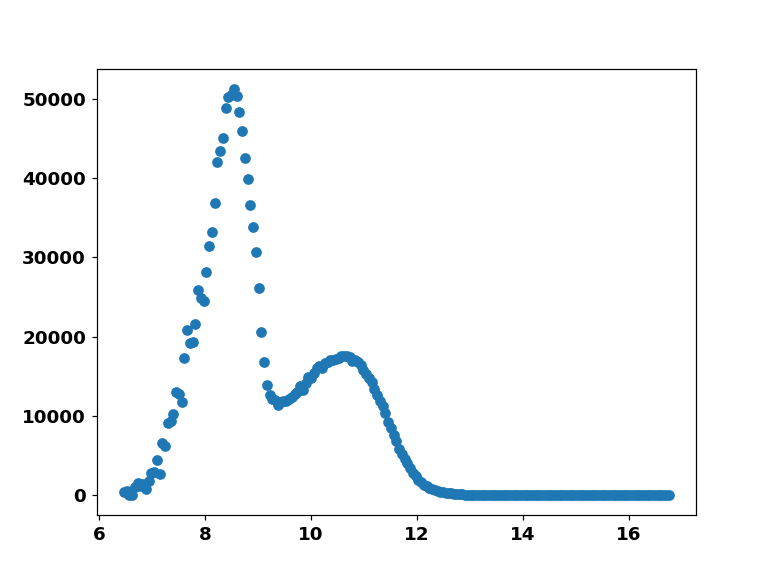

<IPython.core.display.Javascript object>


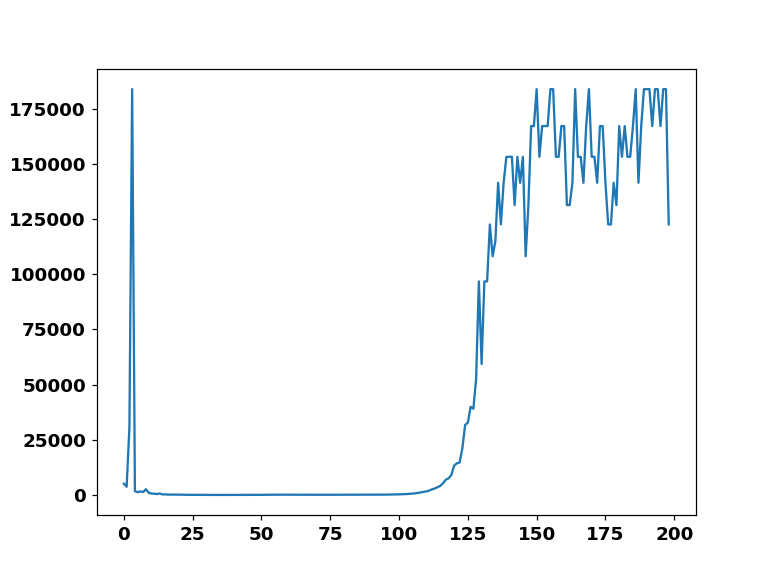

1838283


<IPython.core.display.Javascript object>


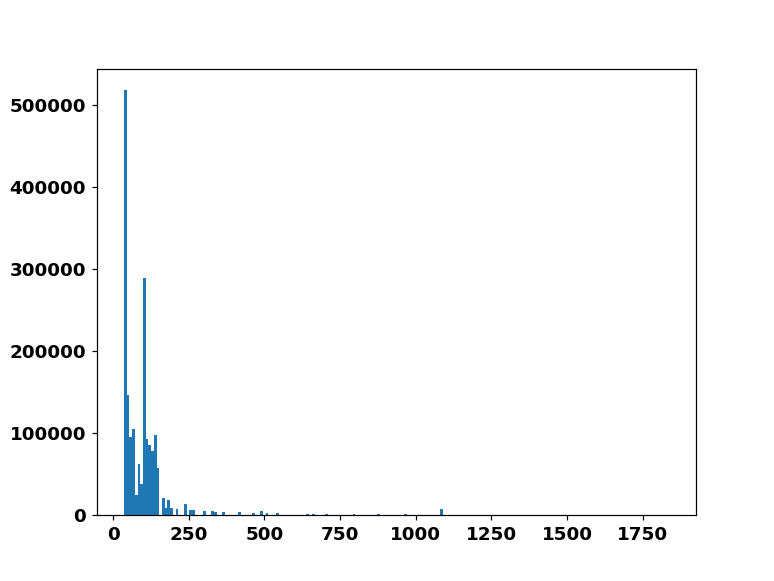

In [92]:
bins = np.linspace(np.min(y_train_log),np.max(y_train_log),200)
hist,bins = np.histogram(y_train_log,bins =bins)
plt.figure()
plt.scatter(bins[1:],hist)
plt.figure()
print(y_train_log.size)
plt.plot(y_train_log.size/(hist+10))
bin_size = bins[1]-bins[0]
y_min = np.min(y_train_log)
sample_weights = np.ones((y_train_log.size))
for i in range(0,y_train_log.size):
    bin_i = int((y_train_log[i]-y_min)/bin_size)
    if bin_i ==199:
        bin_i = 198
    if bin_i < 8:
        bin_i = 8
    sample_weights[i] = y_train_log.size/(hist[bin_i]+1000)
    
plt.figure()
plt.hist(sample_weights,bins=200)
plt.show()

Model: "functional_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_5 (InputLayer)         [(None, 148)]             0         
_________________________________________________________________
dense_36 (Dense)             (None, 256)               38144     
_________________________________________________________________
dropout_4 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_37 (Dense)             (None, 64)                16448     
_________________________________________________________________
dense_38 (Dense)             (None, 32)                2080      
_________________________________________________________________
dense_39 (Dense)             (None, 256)               8448      
_________________________________________________________________
dense_40 (Dense)             (None, 1024)             

Epoch 71/1000
57/57 - 2s - loss: 76.8024 - mse: 0.5857 - val_loss: 0.6943 - val_mse: 0.6943
Epoch 72/1000
57/57 - 2s - loss: 77.3080 - mse: 0.5897 - val_loss: 0.6932 - val_mse: 0.6932
Epoch 73/1000
57/57 - 2s - loss: 77.1328 - mse: 0.5889 - val_loss: 0.6892 - val_mse: 0.6892
Epoch 74/1000
57/57 - 2s - loss: 77.1438 - mse: 0.5900 - val_loss: 0.6954 - val_mse: 0.6954
Epoch 75/1000
57/57 - 2s - loss: 76.4105 - mse: 0.5838 - val_loss: 0.6822 - val_mse: 0.6822
Epoch 76/1000
57/57 - 2s - loss: 76.5631 - mse: 0.5840 - val_loss: 0.6871 - val_mse: 0.6871
Epoch 77/1000
57/57 - 2s - loss: 76.3186 - mse: 0.5835 - val_loss: 0.6768 - val_mse: 0.6768
Epoch 78/1000
57/57 - 2s - loss: 75.8463 - mse: 0.5779 - val_loss: 0.6918 - val_mse: 0.6918
Epoch 79/1000
57/57 - 2s - loss: 76.1095 - mse: 0.5826 - val_loss: 0.6739 - val_mse: 0.6739
Epoch 80/1000
57/57 - 2s - loss: 75.3703 - mse: 0.5760 - val_loss: 0.6686 - val_mse: 0.6686
Epoch 81/1000
57/57 - 2s - loss: 75.5394 - mse: 0.5776 - val_loss: 0.7097 - val_

Epoch 160/1000
57/57 - 2s - loss: 70.4417 - mse: 0.5521 - val_loss: 0.6832 - val_mse: 0.6832
Epoch 161/1000
57/57 - 2s - loss: 70.6148 - mse: 0.5497 - val_loss: 0.6645 - val_mse: 0.6645
Epoch 162/1000
57/57 - 2s - loss: 70.1601 - mse: 0.5488 - val_loss: 0.6838 - val_mse: 0.6838
Epoch 163/1000
57/57 - 2s - loss: 70.5056 - mse: 0.5524 - val_loss: 0.6509 - val_mse: 0.6509
Epoch 164/1000
57/57 - 2s - loss: 70.2137 - mse: 0.5490 - val_loss: 0.6555 - val_mse: 0.6555
Epoch 165/1000
57/57 - 2s - loss: 69.8251 - mse: 0.5454 - val_loss: 0.6814 - val_mse: 0.6814
Epoch 166/1000
57/57 - 2s - loss: 70.2012 - mse: 0.5501 - val_loss: 0.6585 - val_mse: 0.6585
Epoch 167/1000
57/57 - 2s - loss: 70.2435 - mse: 0.5491 - val_loss: 0.6783 - val_mse: 0.6783
Epoch 168/1000
57/57 - 2s - loss: 69.9094 - mse: 0.5466 - val_loss: 0.6492 - val_mse: 0.6492
Epoch 169/1000
57/57 - 2s - loss: 69.9108 - mse: 0.5471 - val_loss: 0.7065 - val_mse: 0.7065
Epoch 170/1000
57/57 - 2s - loss: 70.7304 - mse: 0.5539 - val_loss: 0.

<IPython.core.display.Javascript object>


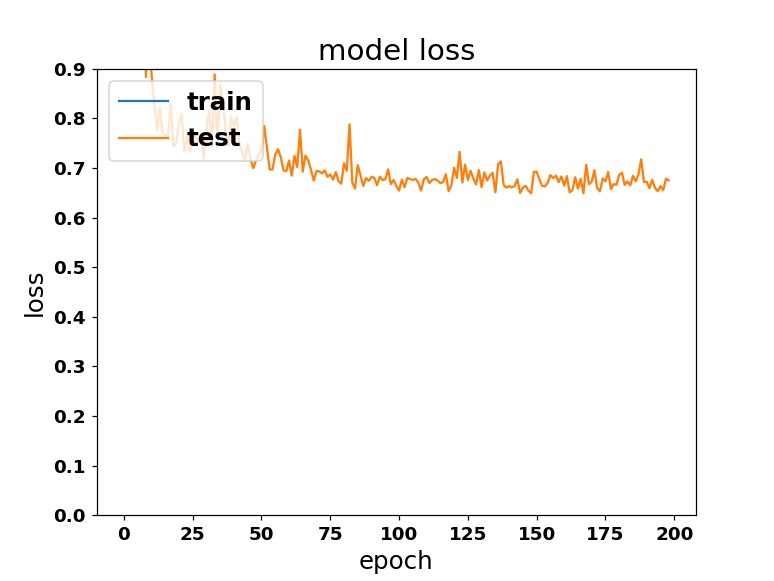

<IPython.core.display.Javascript object>


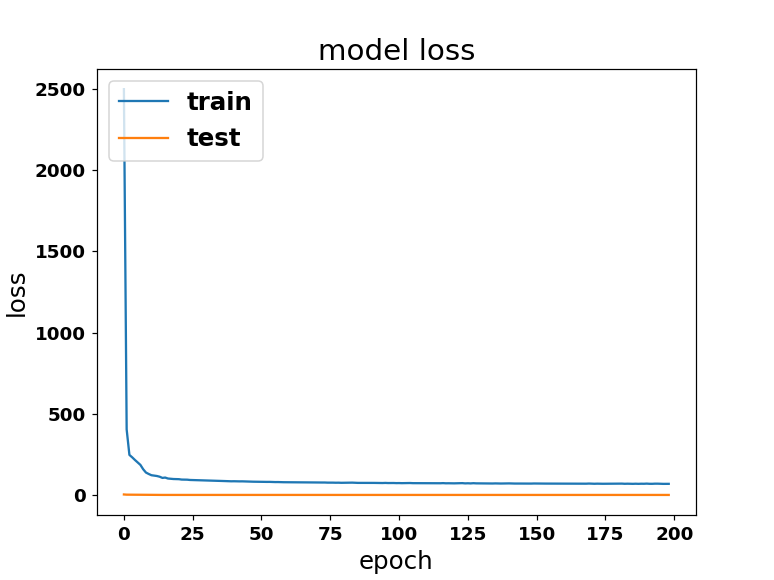

<IPython.core.display.Javascript object>


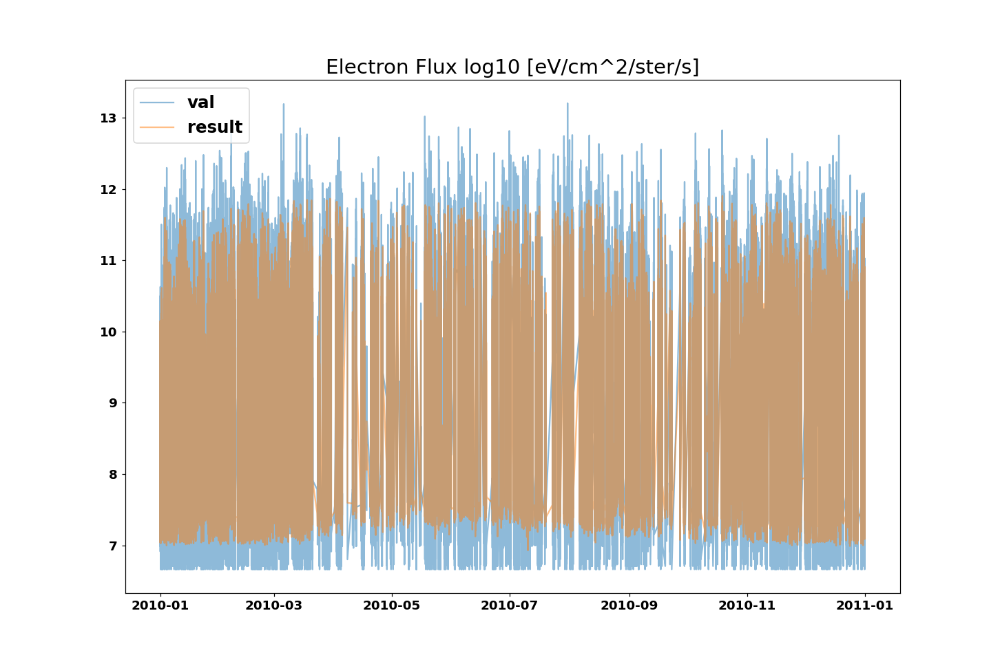

<IPython.core.display.Javascript object>


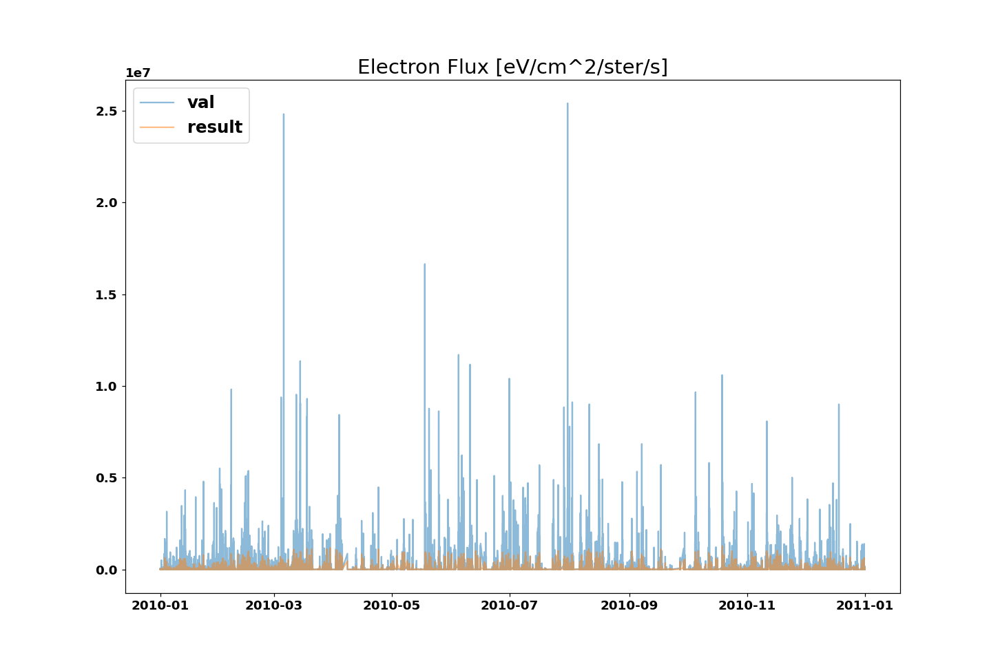

<IPython.core.display.Javascript object>


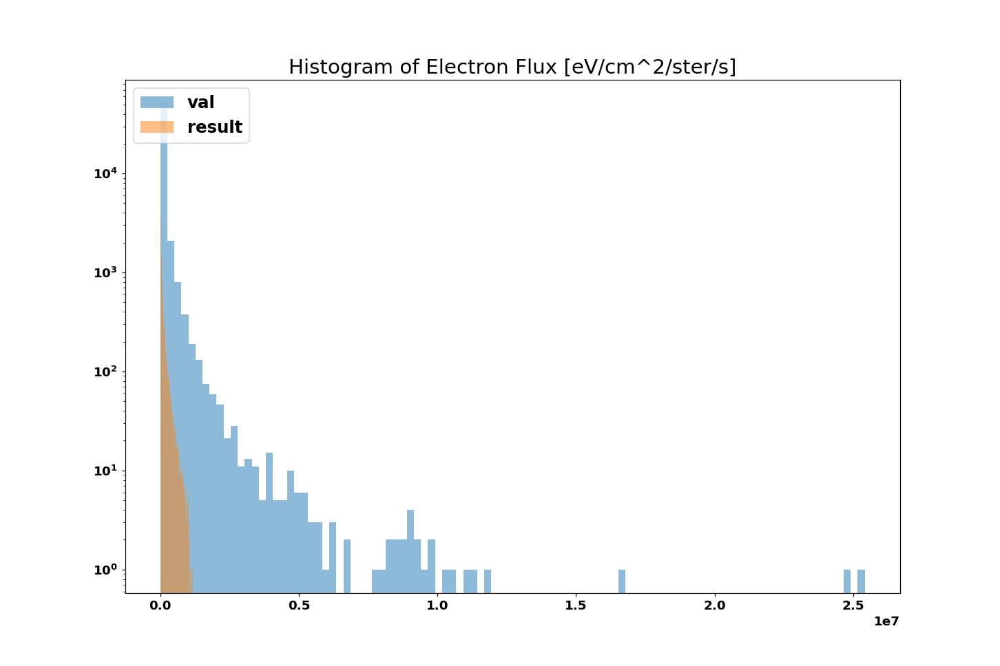

<IPython.core.display.Javascript object>


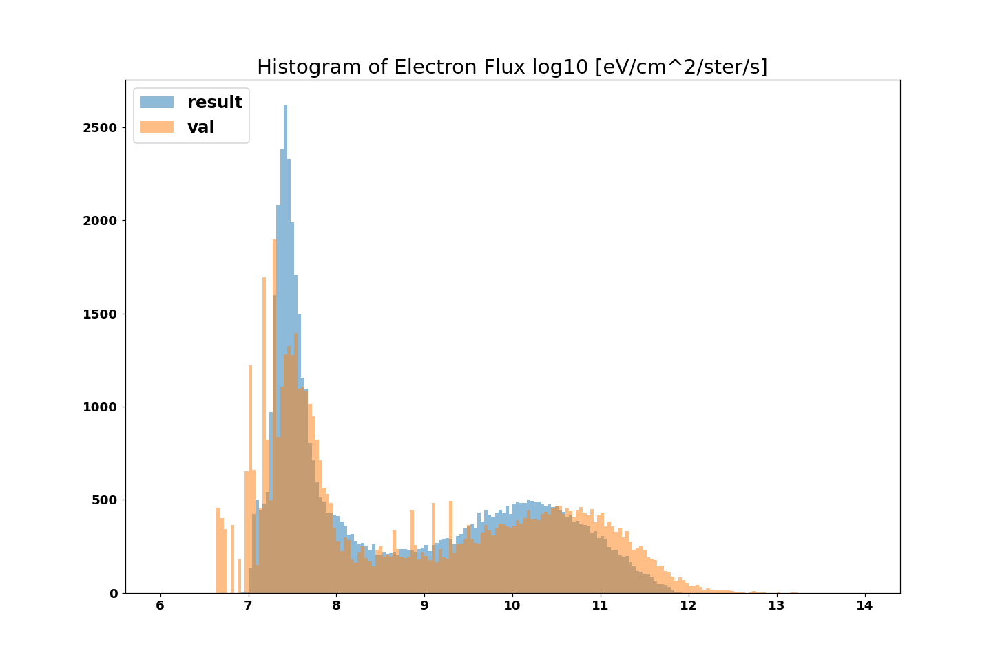

<IPython.core.display.Javascript object>


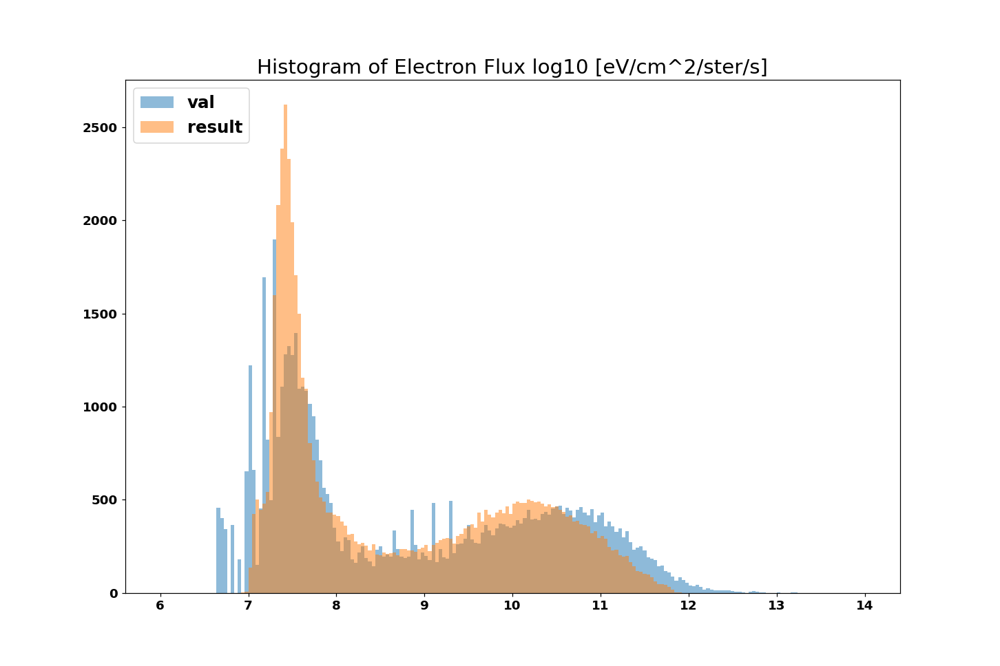

<IPython.core.display.Javascript object>


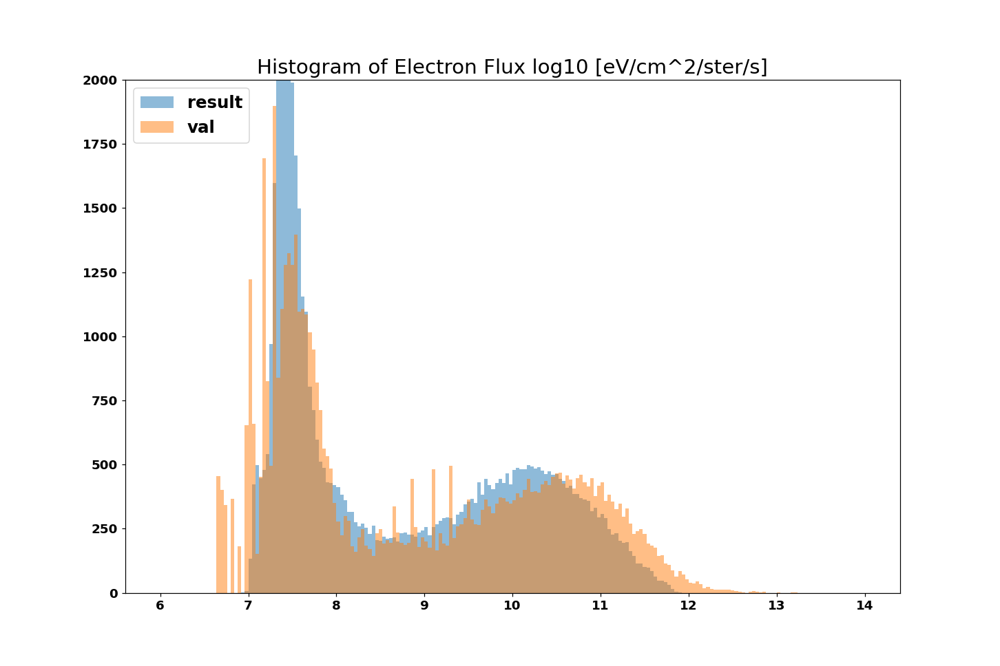

<IPython.core.display.Javascript object>


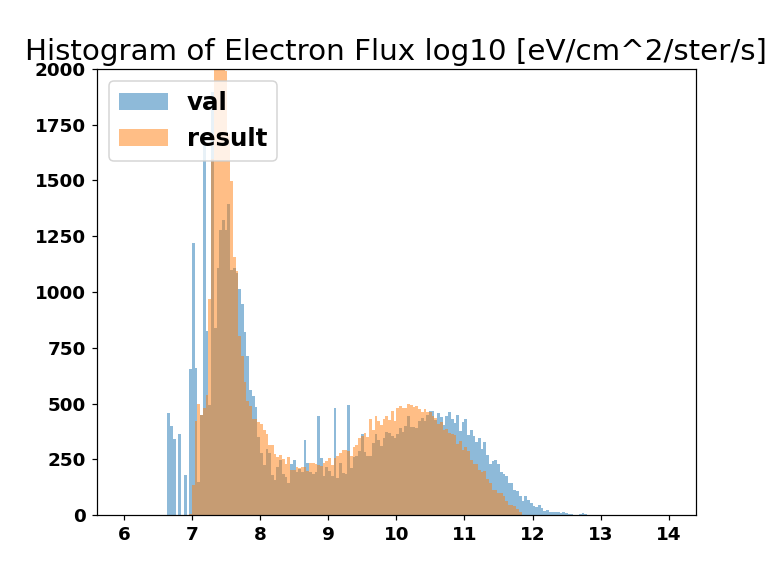

<IPython.core.display.Javascript object>


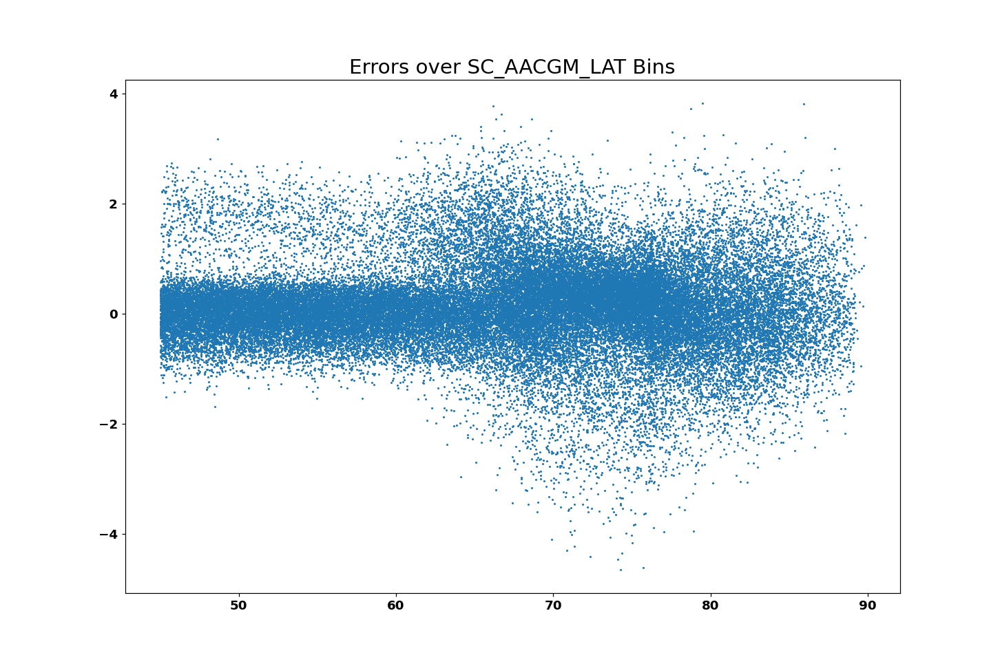

<IPython.core.display.Javascript object>


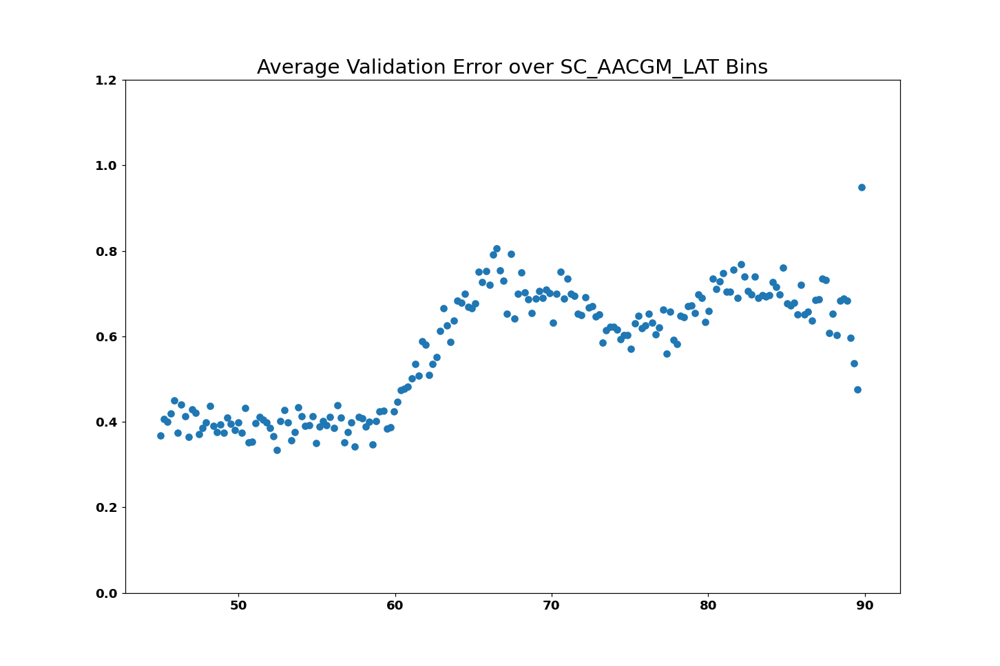

<IPython.core.display.Javascript object>


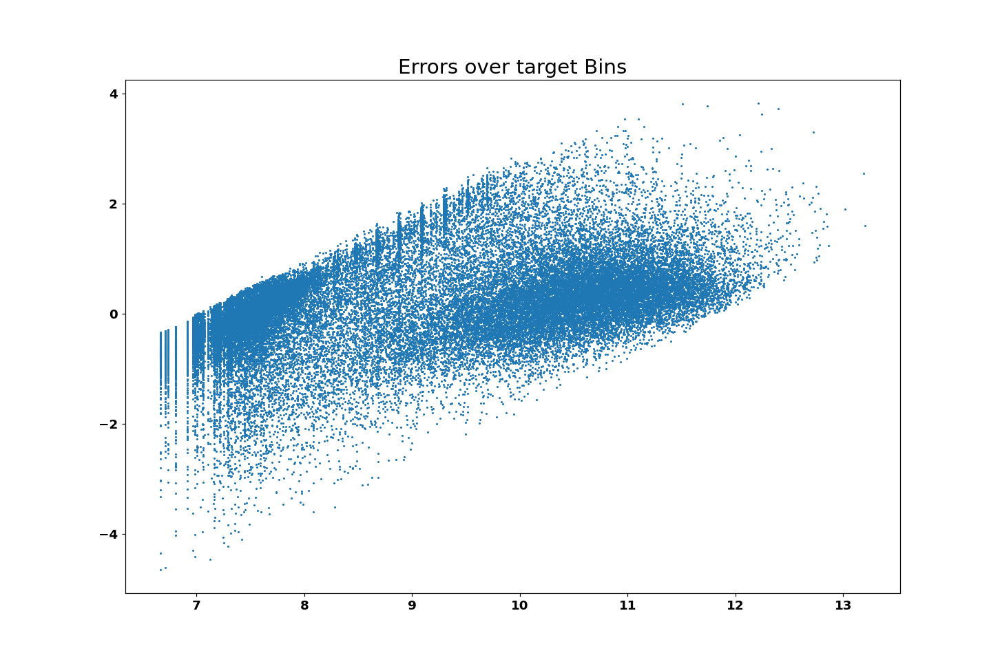

<IPython.core.display.Javascript object>


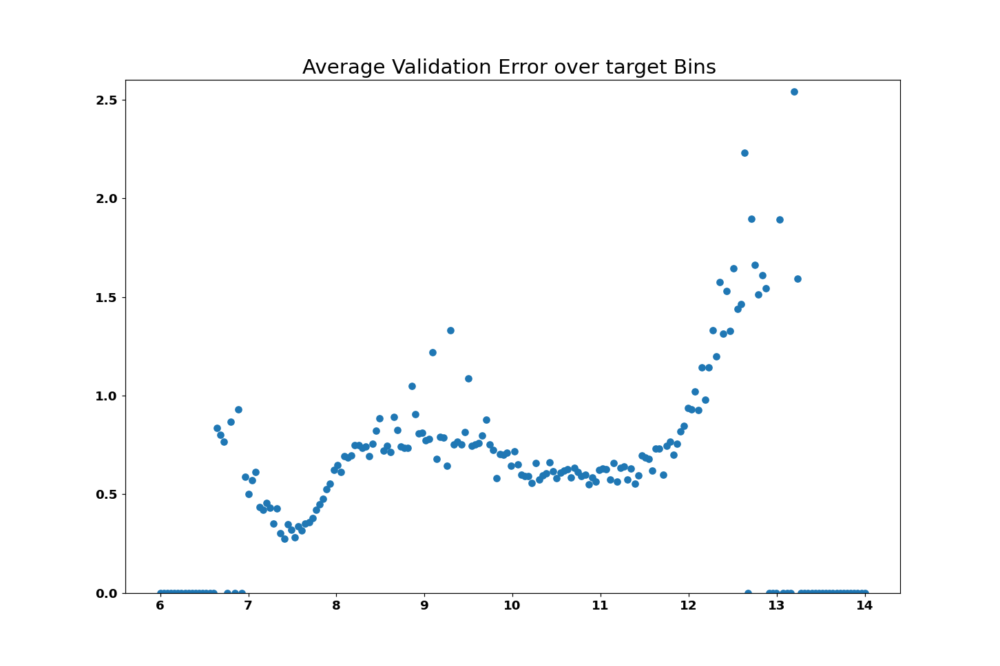

INFO:tensorflow:Assets written to: model_3_dist_tail_Weighted4/assets


In [93]:
from tensorflow.keras.layers import Input

input1 = Input(shape=(148))
model1 = Dense(256,  activation='relu')(input1)
model1 = model1 = Dropout(0.5)(model1)
model1 = Dense(64, activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(int(256),   activation='relu')(model1)
model1 = Dense(int(1024),  activation='relu')(model1)
model1 = Dense(int(256),  activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(4, activation='relu')(model1)
model1 = Dense(1, activation='linear' )(model1)


output = model1
model = tensorflow.keras.models.Model(inputs=input1, outputs=output)
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',metrics=['mse'])
model.summary()

history = model.fit(X, 
                   y_train_log, 
                    validation_data=(
                        X_test, 
                        y_val_log,                                    ), sample_weight=sample_weights,
                    batch_size=32768,epochs=1000,verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=50)])#


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.ylim([0,.9])
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

results = model.predict(X_test)

df_results = pd.DataFrame(data=results, index = df_val.index)

model_3_dist_tail4 = df_results

plot_model(df_results)
filename='model_3_dist_tail_Weighted4'
model.save(filename)
model = tensorflow.keras.models.load_model(filename)


In [95]:


def plot_model_multiple(df_results,model_names, y_val_log):
    %matplotlib notebook
    num = len(df_results)
    names = ['val']
    for i in range(0,num):
        names.append(model_names[i])
    
    plt.figure()
    plt.plot(y_val_log[:],alpha = 0.5)
    for i in range(0,num):
        plt.plot(df_results[i],alpha = 0.5)
    plt.legend(names, loc='upper left')
    plt.show()


    plt.figure()
    plt.plot(10**y_val_log[:]*1.6e-6,alpha = 0.5)
    for i in range(0,num):
        plt.plot(10**df_results[i]*1.6e-6,alpha = 0.5)
    plt.legend(names, loc='upper left')
    plt.show()

    plt.figure()
    plt.hist(10**y_val_log.values*1.6e-6,bins=100, log=True,alpha = 0.5)
    for i in range(0,num):
        plt.hist(10**df_results[i].values*1.6e-6,bins=100, log=True,alpha = 0.5)
    plt.legend(names, loc='upper left')
    plt.show()



    plt.figure()
    plt.hist(y_val_log.values,bins=200,range=(6,14),alpha = 0.5)
    for i in range(0,num):  
        plt.hist(df_results[i].values,bins=200,range=(6,14),alpha = 0.5)
    plt.legend(names, loc='upper left')
    plt.show()



    plt.figure()
    plt.hist(y_val_log.values,bins=200,range=(6,14))
    for k in range(0,num):
        plt.hist(df_results[k].values,bins=200,range=(6,14),alpha = 0.5)
    plt.legend(names, loc='upper left')
    plt.ylim([0,2000])
    plt.show()



    plt.figure();
    for k in range(0,num):     
        errors= y_val_log.values-df_results[k].values[:,0]
        plt.scatter(y_val_log.values,errors,s=1,alpha = 0.5)
    plt.title('Errors over target Bins')
    plt.legend(model_names, loc='upper left')                      
    plt.show()

    plt.figure();
    for k in range(0,num):
        errors= y_val_log.values-df_results[k].values[:,0]     
        bin_total = np.zeros((200))
        bin_error_total = np.zeros((200))
        for j in range(0,y_val_log.values.shape[0]):
            i = int((y_val_log[j]-6)/((14-6)/200))
            if i < 200:
                bin_total[i] = bin_total[i]+1
                bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])
        avg_error_over_hist = bin_error_total/(bin_total+.00001)
        plt.scatter(np.linspace(6,14,num=200),avg_error_over_hist,alpha = 0.5)
    plt.title('Average Validation Error over target Bins')    
    plt.legend(model_names, loc='upper left')
    plt.ylim([0,2.6])
    plt.show()

    for k in range(0,num):  
        plt.figure();

        errors= y_val_log.values-df_results[k].values[:,0]
        plt.hist2d(y_val_log.values,errors,bins=200)
        plt.title('Errors over target Bins'+model_names[k])
        plt.show()
        
    plt.figure();
    for k in range(0,num):      
        errors= y_val_log.values-df_results[k].values[:,0]     
        plt.scatter(df_val['SC_AACGM_LAT'].values,errors,s=1,alpha = 0.5)
    plt.legend(model_names, loc='upper left')                      
    plt.title('Errors over SC_AACGM_LAT Bins')
    plt.show()

    plt.figure();
    for k in range(0,num):
        errors= y_val_log.values-df_results[k].values[:,0]     
        bin_total = np.zeros((200))
        bin_error_total = np.zeros((200))
        for j in range(0,y_val_log.values.shape[0]):
            i = int((df_val['SC_AACGM_LAT'].values[j]-45)/((90-45)/200))
            if i < 200:
                bin_total[i] = bin_total[i]+1
                bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])
        avg_error_over_hist = bin_error_total/bin_total
        plt.scatter(np.linspace(45,90,num=200),avg_error_over_hist,alpha = 0.5)
    plt.title('Average Validation Error over SC_AACGM_LAT Bins')
    plt.legend(model_names, loc='upper left')
    plt.ylim([0,1.2])
    plt.show()

<IPython.core.display.Javascript object>


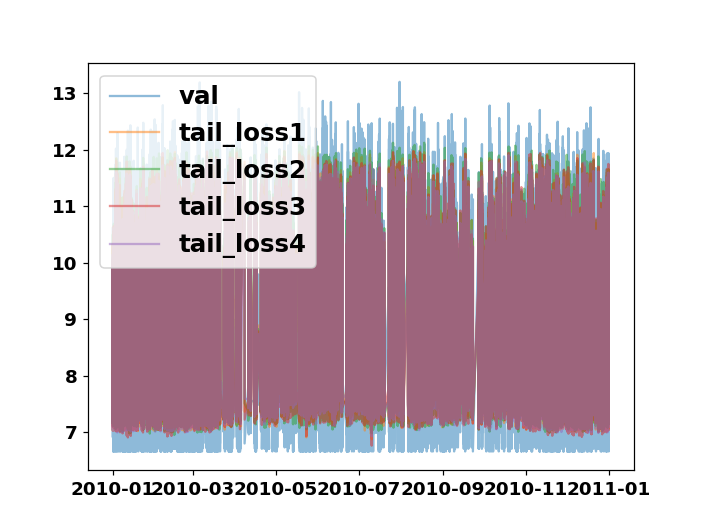

<IPython.core.display.Javascript object>


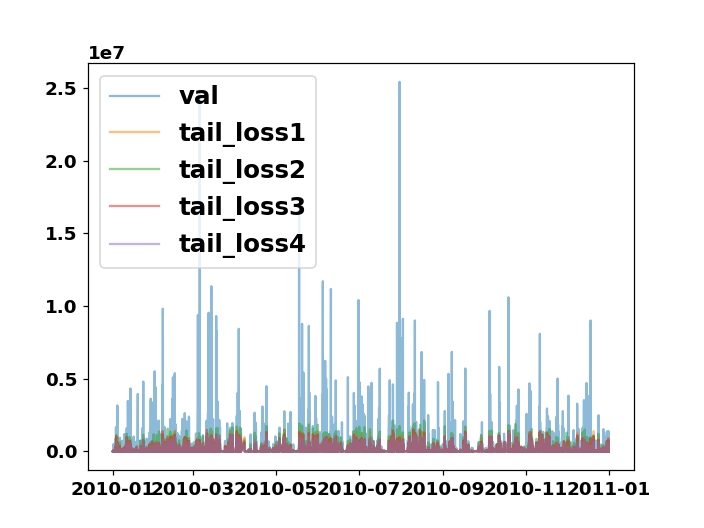

<IPython.core.display.Javascript object>


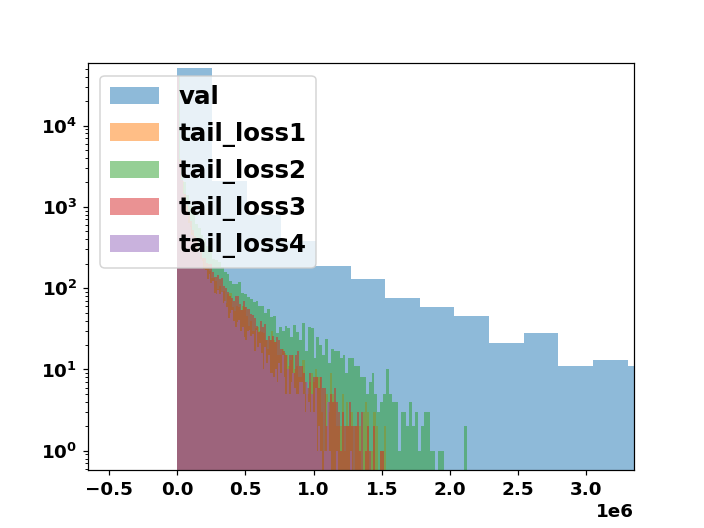

<IPython.core.display.Javascript object>


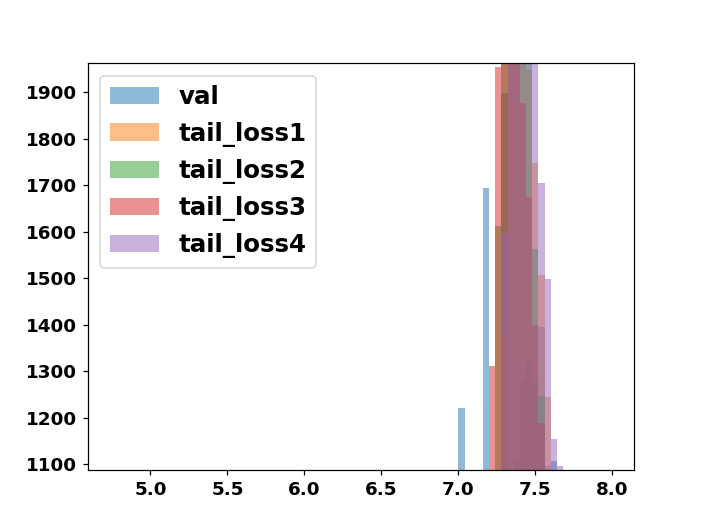

<IPython.core.display.Javascript object>


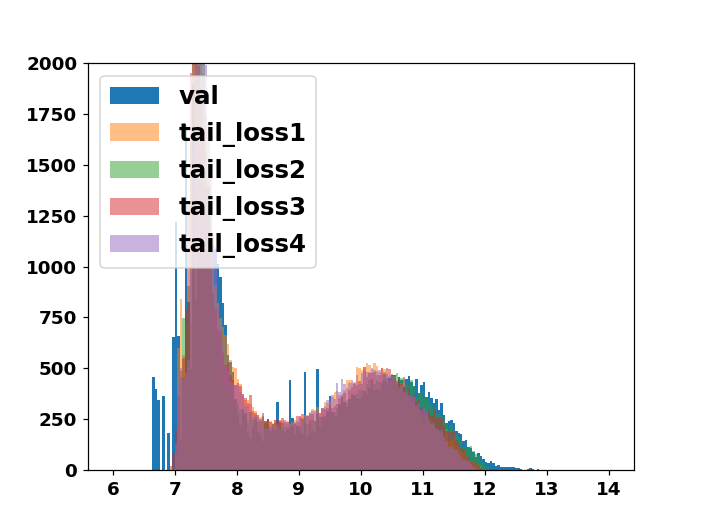

<IPython.core.display.Javascript object>


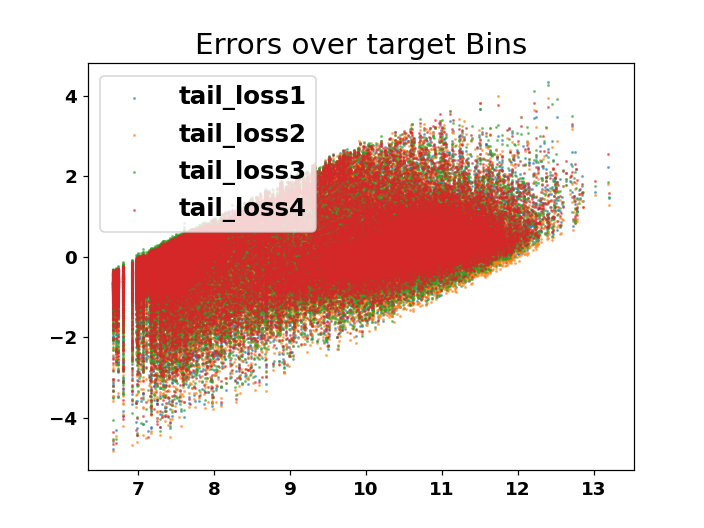

<IPython.core.display.Javascript object>


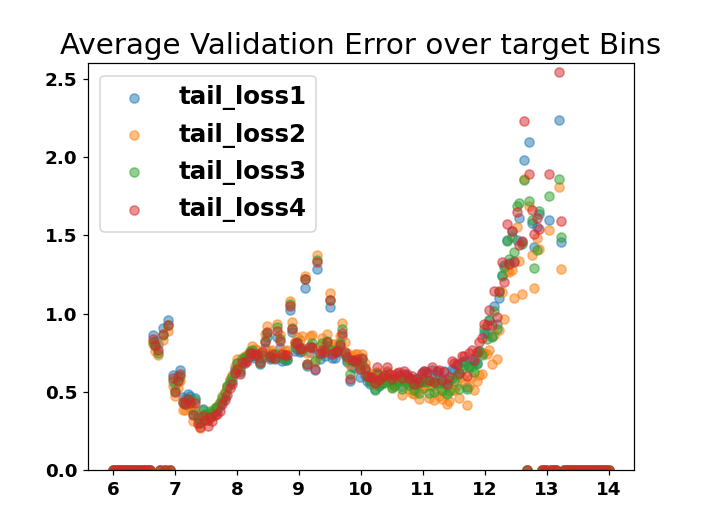

<IPython.core.display.Javascript object>


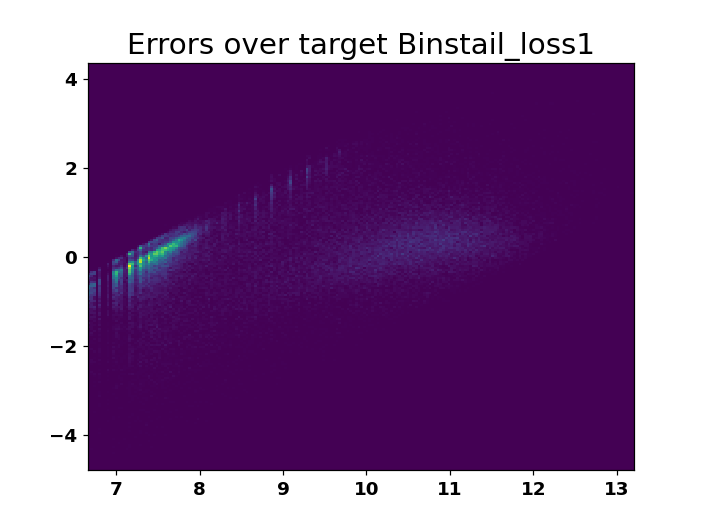

<IPython.core.display.Javascript object>


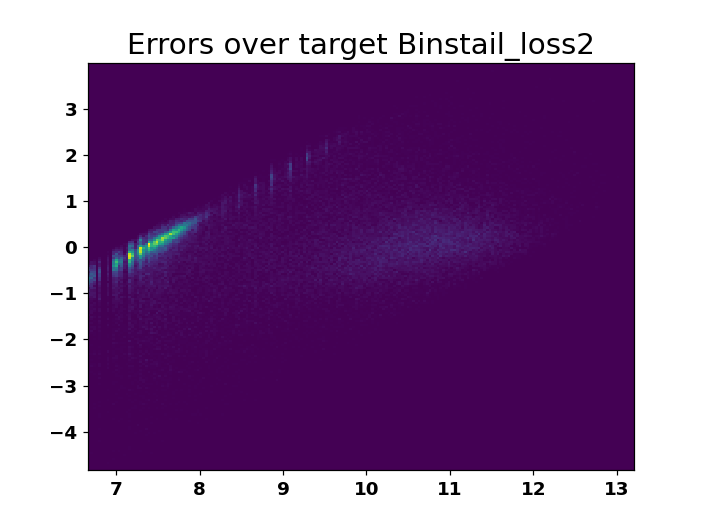

<IPython.core.display.Javascript object>


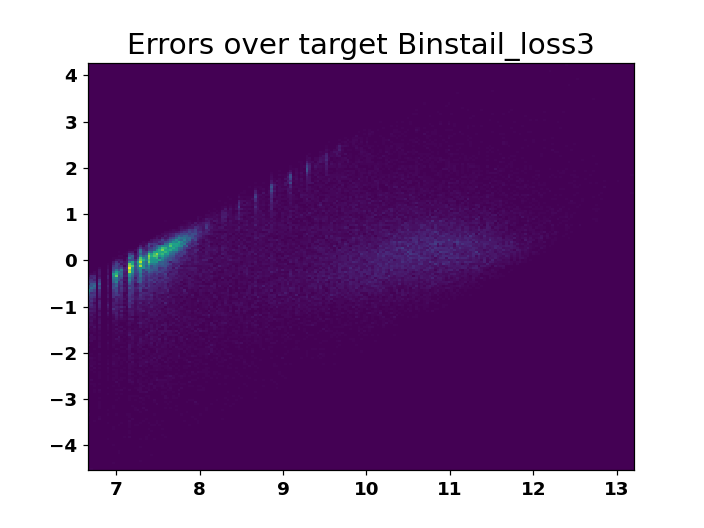

<IPython.core.display.Javascript object>


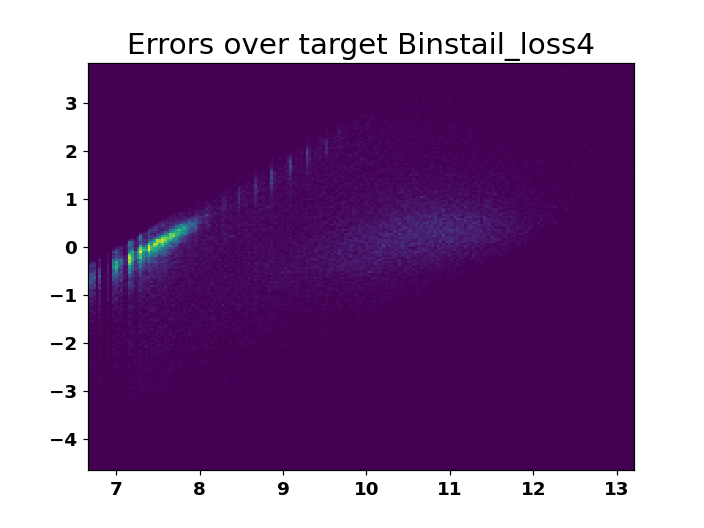

<IPython.core.display.Javascript object>


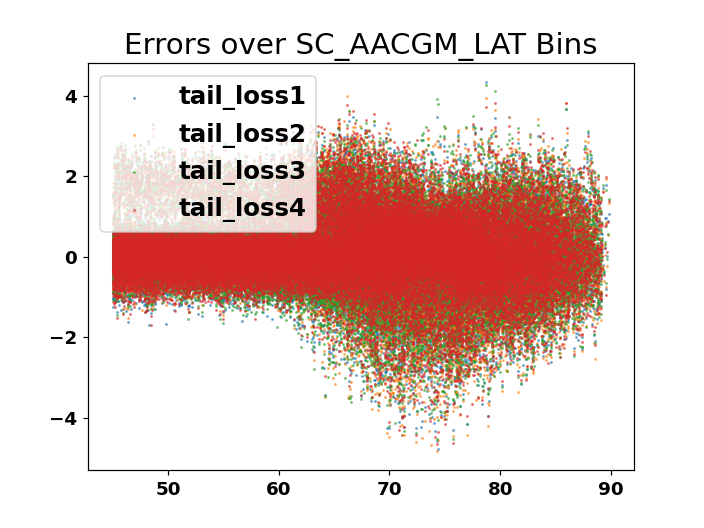

<IPython.core.display.Javascript object>


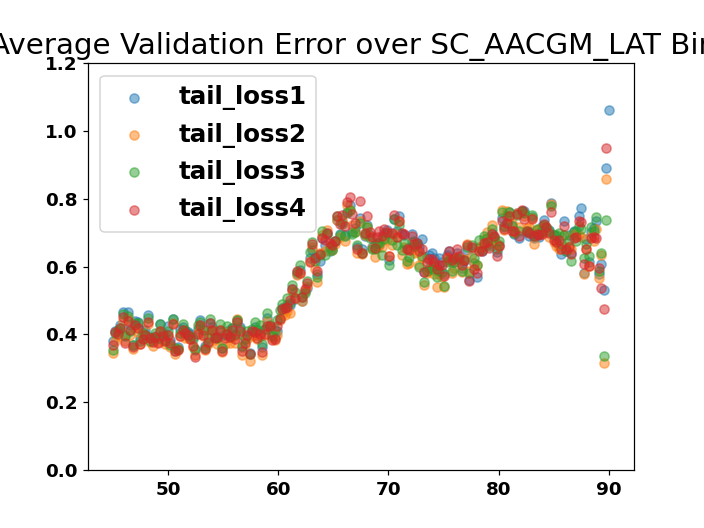

In [96]:
plot_model_multiple([model_3_dist_tail_weighted,model_3_dist_tail2,model_3_dist_tail3,model_3_dist_tail4],['tail_loss1','tail_loss2','tail_loss3','tail_loss4'], y_val_log)
    

<IPython.core.display.Javascript object>


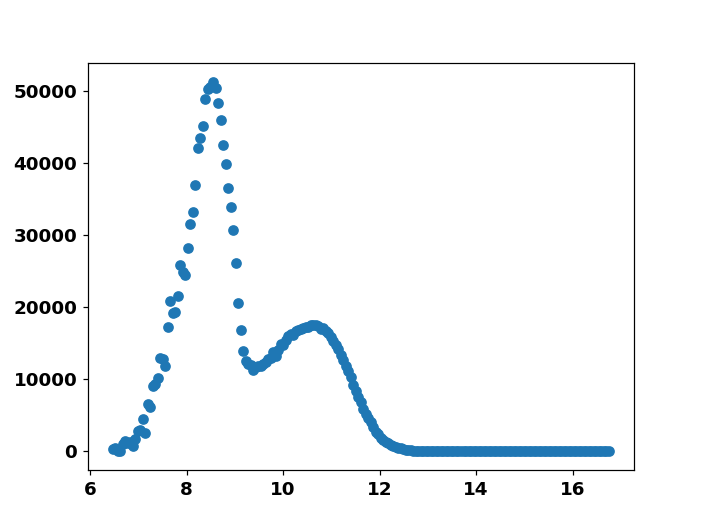

<IPython.core.display.Javascript object>


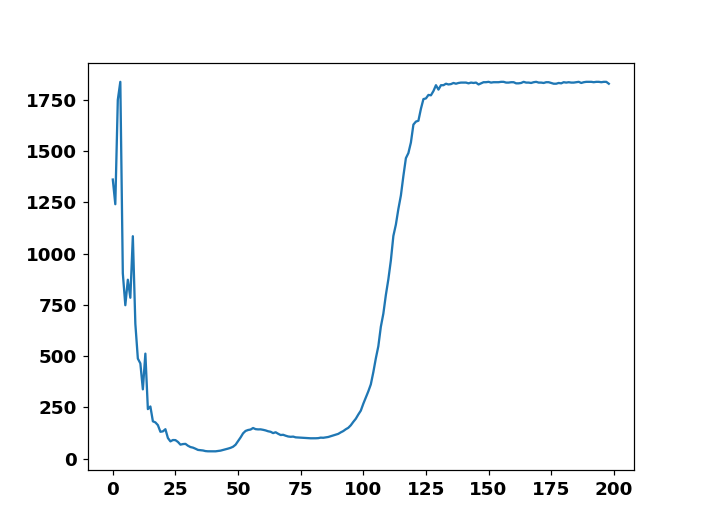

1838283


<IPython.core.display.Javascript object>


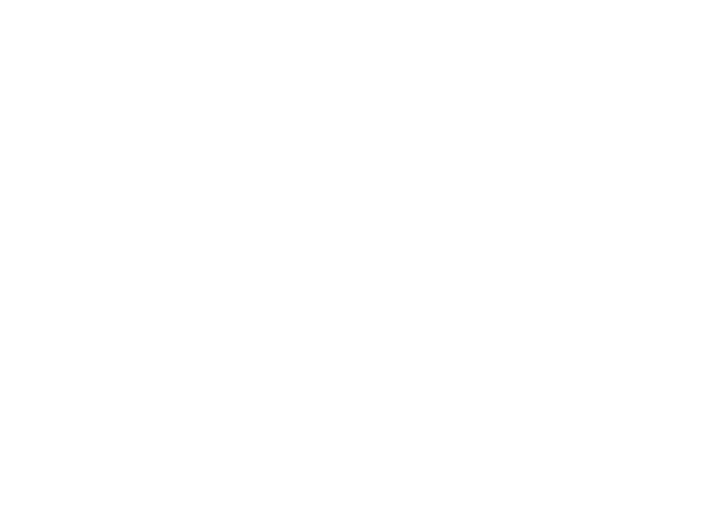

Model: "functional_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_7 (InputLayer)         [(None, 148)]             0         
_________________________________________________________________
dense_54 (Dense)             (None, 256)               38144     
_________________________________________________________________
dropout_6 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_55 (Dense)             (None, 64)                16448     
_________________________________________________________________
dense_56 (Dense)             (None, 32)                2080      
_________________________________________________________________
dense_57 (Dense)             (None, 256)               8448      
_________________________________________________________________
dense_58 (Dense)             (None, 1024)            

Epoch 70/1000
57/57 - 2s - loss: 92.4297 - mse: 0.6381 - val_loss: 0.7120 - val_mse: 0.7120
Epoch 71/1000
57/57 - 2s - loss: 92.2489 - mse: 0.6344 - val_loss: 0.7041 - val_mse: 0.7041
Epoch 72/1000
57/57 - 2s - loss: 91.1270 - mse: 0.6277 - val_loss: 0.6848 - val_mse: 0.6848
Epoch 73/1000
57/57 - 2s - loss: 92.2909 - mse: 0.6374 - val_loss: 0.6959 - val_mse: 0.6959
Epoch 74/1000
57/57 - 2s - loss: 91.1342 - mse: 0.6273 - val_loss: 0.8577 - val_mse: 0.8577
Epoch 75/1000
57/57 - 2s - loss: 92.9072 - mse: 0.6443 - val_loss: 0.7220 - val_mse: 0.7220
Epoch 76/1000
57/57 - 2s - loss: 91.0805 - mse: 0.6274 - val_loss: 0.7070 - val_mse: 0.7070
Epoch 77/1000
57/57 - 2s - loss: 90.9702 - mse: 0.6290 - val_loss: 0.7417 - val_mse: 0.7417
Epoch 78/1000
57/57 - 2s - loss: 91.4014 - mse: 0.6349 - val_loss: 0.7041 - val_mse: 0.7041
Epoch 79/1000
57/57 - 2s - loss: 89.9239 - mse: 0.6207 - val_loss: 0.7558 - val_mse: 0.7558
Epoch 80/1000
57/57 - 2s - loss: 91.7074 - mse: 0.6397 - val_loss: 0.7057 - val_

Epoch 159/1000
57/57 - 1s - loss: 81.3002 - mse: 0.5904 - val_loss: 0.7452 - val_mse: 0.7452
Epoch 160/1000
57/57 - 1s - loss: 82.4290 - mse: 0.5954 - val_loss: 0.7017 - val_mse: 0.7017
Epoch 161/1000
57/57 - 1s - loss: 81.9314 - mse: 0.5946 - val_loss: 0.6964 - val_mse: 0.6964
Epoch 162/1000
57/57 - 1s - loss: 80.9433 - mse: 0.5863 - val_loss: 0.6736 - val_mse: 0.6736
Epoch 163/1000
57/57 - 1s - loss: 80.9133 - mse: 0.5875 - val_loss: 0.6844 - val_mse: 0.6844
Epoch 164/1000
57/57 - 1s - loss: 81.1619 - mse: 0.5892 - val_loss: 0.6793 - val_mse: 0.6793
Epoch 165/1000
57/57 - 1s - loss: 80.6401 - mse: 0.5870 - val_loss: 0.6846 - val_mse: 0.6846
Epoch 166/1000
57/57 - 1s - loss: 80.8826 - mse: 0.5857 - val_loss: 0.8014 - val_mse: 0.8014
Epoch 167/1000
57/57 - 1s - loss: 83.8046 - mse: 0.6121 - val_loss: 0.6799 - val_mse: 0.6799
Epoch 168/1000
57/57 - 1s - loss: 81.0846 - mse: 0.5886 - val_loss: 0.7122 - val_mse: 0.7122
Epoch 169/1000
57/57 - 1s - loss: 81.2463 - mse: 0.5896 - val_loss: 0.

57/57 - 1s - loss: 77.9798 - mse: 0.5765 - val_loss: 0.6840 - val_mse: 0.6840
Epoch 248/1000
57/57 - 1s - loss: 77.4287 - mse: 0.5728 - val_loss: 0.6762 - val_mse: 0.6762
Epoch 249/1000
57/57 - 1s - loss: 77.7357 - mse: 0.5716 - val_loss: 0.6885 - val_mse: 0.6885
Epoch 250/1000
57/57 - 1s - loss: 77.7793 - mse: 0.5759 - val_loss: 0.7168 - val_mse: 0.7168
Epoch 251/1000
57/57 - 1s - loss: 79.2662 - mse: 0.5855 - val_loss: 0.6838 - val_mse: 0.6838
Epoch 252/1000
57/57 - 1s - loss: 78.3369 - mse: 0.5778 - val_loss: 0.6834 - val_mse: 0.6834
Epoch 253/1000
57/57 - 1s - loss: 77.6076 - mse: 0.5741 - val_loss: 0.6787 - val_mse: 0.6787
Epoch 254/1000
57/57 - 2s - loss: 77.4647 - mse: 0.5726 - val_loss: 0.6688 - val_mse: 0.6688
Epoch 255/1000
57/57 - 1s - loss: 77.0682 - mse: 0.5705 - val_loss: 0.6707 - val_mse: 0.6707
Epoch 256/1000
57/57 - 1s - loss: 77.1114 - mse: 0.5717 - val_loss: 0.6757 - val_mse: 0.6757
Epoch 257/1000
57/57 - 1s - loss: 78.2929 - mse: 0.5784 - val_loss: 0.6700 - val_mse:

Epoch 336/1000
57/57 - 2s - loss: 76.6908 - mse: 0.5771 - val_loss: 0.6508 - val_mse: 0.6508
Epoch 337/1000
57/57 - 1s - loss: 75.4603 - mse: 0.5679 - val_loss: 0.6868 - val_mse: 0.6868
Epoch 338/1000
57/57 - 1s - loss: 75.2689 - mse: 0.5650 - val_loss: 0.7100 - val_mse: 0.7100
Epoch 339/1000
57/57 - 1s - loss: 75.1885 - mse: 0.5658 - val_loss: 0.6856 - val_mse: 0.6856
Epoch 340/1000
57/57 - 1s - loss: 75.5074 - mse: 0.5660 - val_loss: 0.6948 - val_mse: 0.6948
Epoch 341/1000
57/57 - 1s - loss: 75.0503 - mse: 0.5640 - val_loss: 0.7001 - val_mse: 0.7001
Epoch 342/1000
57/57 - 2s - loss: 75.0978 - mse: 0.5653 - val_loss: 0.6863 - val_mse: 0.6863
Epoch 343/1000
57/57 - 2s - loss: 76.2432 - mse: 0.5747 - val_loss: 0.7049 - val_mse: 0.7049
Epoch 344/1000
57/57 - 2s - loss: 75.1916 - mse: 0.5666 - val_loss: 0.6754 - val_mse: 0.6754
Epoch 345/1000
57/57 - 1s - loss: 75.1960 - mse: 0.5679 - val_loss: 0.6608 - val_mse: 0.6608
Epoch 346/1000
57/57 - 2s - loss: 74.9550 - mse: 0.5691 - val_loss: 0.

57/57 - 1s - loss: 73.7316 - mse: 0.5615 - val_loss: 0.6659 - val_mse: 0.6659
Epoch 425/1000
57/57 - 2s - loss: 73.3338 - mse: 0.5576 - val_loss: 0.7271 - val_mse: 0.7271
Epoch 426/1000
57/57 - 1s - loss: 73.0405 - mse: 0.5591 - val_loss: 0.7241 - val_mse: 0.7241
Epoch 427/1000
57/57 - 1s - loss: 73.4981 - mse: 0.5586 - val_loss: 0.6798 - val_mse: 0.6798
Epoch 428/1000
57/57 - 1s - loss: 73.3534 - mse: 0.5637 - val_loss: 0.7012 - val_mse: 0.7012
Epoch 429/1000
57/57 - 1s - loss: 73.5890 - mse: 0.5624 - val_loss: 0.6959 - val_mse: 0.6959
Epoch 430/1000
57/57 - 2s - loss: 76.0102 - mse: 0.5819 - val_loss: 0.6746 - val_mse: 0.6746
Epoch 431/1000
57/57 - 2s - loss: 73.8228 - mse: 0.5623 - val_loss: 0.6806 - val_mse: 0.6806
Epoch 432/1000
57/57 - 1s - loss: 73.8412 - mse: 0.5625 - val_loss: 0.6593 - val_mse: 0.6593
Epoch 433/1000
57/57 - 1s - loss: 73.7630 - mse: 0.5620 - val_loss: 0.7035 - val_mse: 0.7035
Epoch 434/1000
57/57 - 1s - loss: 73.9495 - mse: 0.5633 - val_loss: 0.6840 - val_mse:

Epoch 513/1000
57/57 - 2s - loss: 72.9568 - mse: 0.5584 - val_loss: 0.7046 - val_mse: 0.7046
Epoch 514/1000
57/57 - 1s - loss: 72.1638 - mse: 0.5563 - val_loss: 0.7083 - val_mse: 0.7083
Epoch 515/1000
57/57 - 2s - loss: 72.3216 - mse: 0.5579 - val_loss: 0.6889 - val_mse: 0.6889
Epoch 516/1000
57/57 - 2s - loss: 71.9977 - mse: 0.5561 - val_loss: 0.6816 - val_mse: 0.6816
Epoch 517/1000
57/57 - 1s - loss: 72.1027 - mse: 0.5547 - val_loss: 0.7083 - val_mse: 0.7083
Epoch 518/1000
57/57 - 1s - loss: 72.1565 - mse: 0.5562 - val_loss: 0.6959 - val_mse: 0.6959
Epoch 519/1000
57/57 - 1s - loss: 71.8837 - mse: 0.5530 - val_loss: 0.6853 - val_mse: 0.6853
Epoch 520/1000
57/57 - 2s - loss: 72.7753 - mse: 0.5604 - val_loss: 0.6711 - val_mse: 0.6711
Epoch 521/1000
57/57 - 1s - loss: 72.4582 - mse: 0.5558 - val_loss: 0.7041 - val_mse: 0.7041
Epoch 522/1000
57/57 - 2s - loss: 72.3163 - mse: 0.5578 - val_loss: 0.6956 - val_mse: 0.6956
Epoch 523/1000
57/57 - 1s - loss: 72.7233 - mse: 0.5613 - val_loss: 0.

<IPython.core.display.Javascript object>


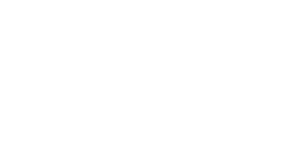

<IPython.core.display.Javascript object>


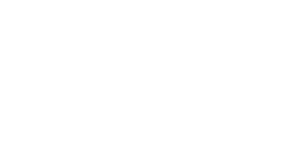

<IPython.core.display.Javascript object>


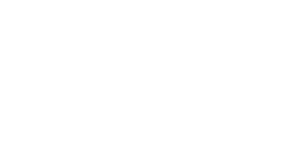

<IPython.core.display.Javascript object>


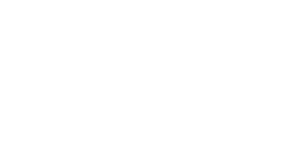

<IPython.core.display.Javascript object>


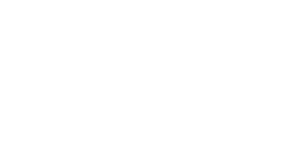

<IPython.core.display.Javascript object>


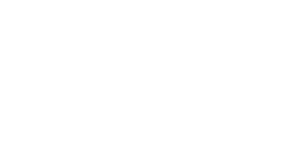

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


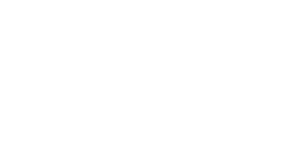

<IPython.core.display.Javascript object>


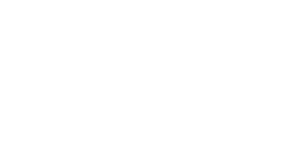

<IPython.core.display.Javascript object>


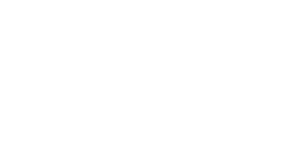

<IPython.core.display.Javascript object>


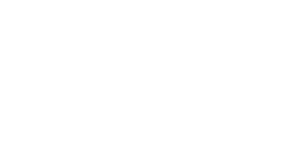

<IPython.core.display.Javascript object>


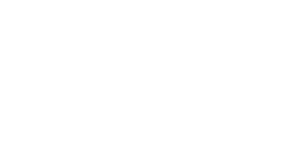

<IPython.core.display.Javascript object>


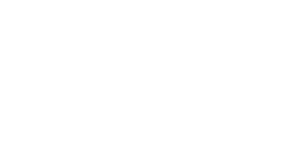

<IPython.core.display.Javascript object>


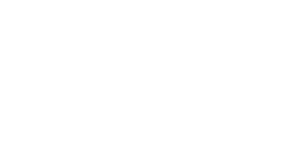

In [103]:
bins = np.linspace(np.min(y_train_log),np.max(y_train_log),200)
hist,bins = np.histogram(y_train_log,bins =bins)
plt.figure()
plt.scatter(bins[1:],hist)
plt.figure()
print(y_train_log.size)
plt.plot(y_train_log.size/(hist+1000))
bin_size = bins[1]-bins[0]
y_min = np.min(y_train_log)
sample_weights = np.ones((y_train_log.size))
for i in range(0,y_train_log.size):
    bin_i = int((y_train_log[i]-y_min)/bin_size)
    if bin_i ==199:
        bin_i = 198
#     if bin_i < 20:
#         bin_i = 20
    sample_weights[i] = y_train_log.size/(hist[bin_i]+500)
    
plt.figure()
plt.hist(sample_weights,bins=200)
plt.show()

from tensorflow.keras.layers import Input

input1 = Input(shape=(148))
model1 = Dense(256,  activation='relu')(input1)
model1 = model1 = Dropout(0.5)(model1)
model1 = Dense(64, activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(int(256),   activation='relu')(model1)
model1 = Dense(int(1024),  activation='relu')(model1)
model1 = Dense(int(256),  activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(4, activation='relu')(model1)
model1 = Dense(1, activation='linear' )(model1)


output = model1
model = tensorflow.keras.models.Model(inputs=input1, outputs=output)
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',metrics=['mse'])
model.summary()

history = model.fit(X, 
                   y_train_log, 
                    validation_data=(
                        X_test, 
                        y_val_log,                                    ), sample_weight=sample_weights,
                    batch_size=32768,epochs=1000,verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=200)])#


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.ylim([0,.9])
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

results = model.predict(X_test)

df_results = pd.DataFrame(data=results, index = df_val.index)

model_3_dist_tail2_2 = df_results

plot_model(df_results)

<IPython.core.display.Javascript object>


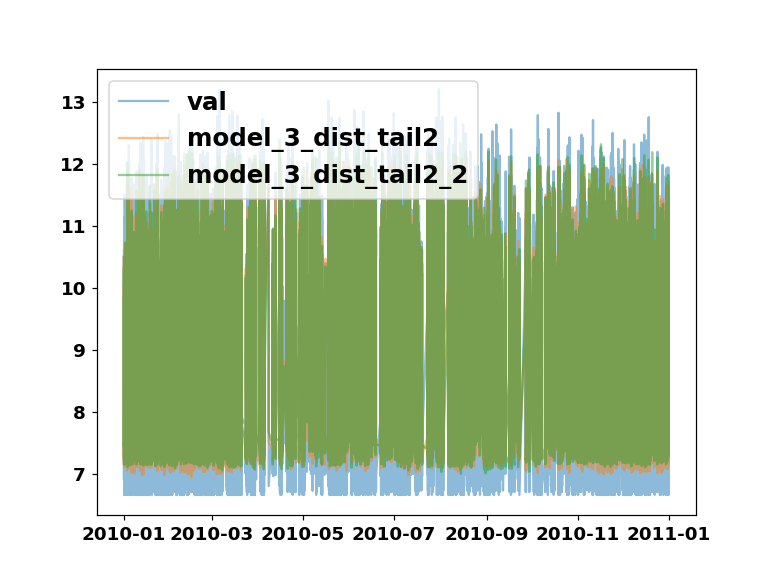

<IPython.core.display.Javascript object>


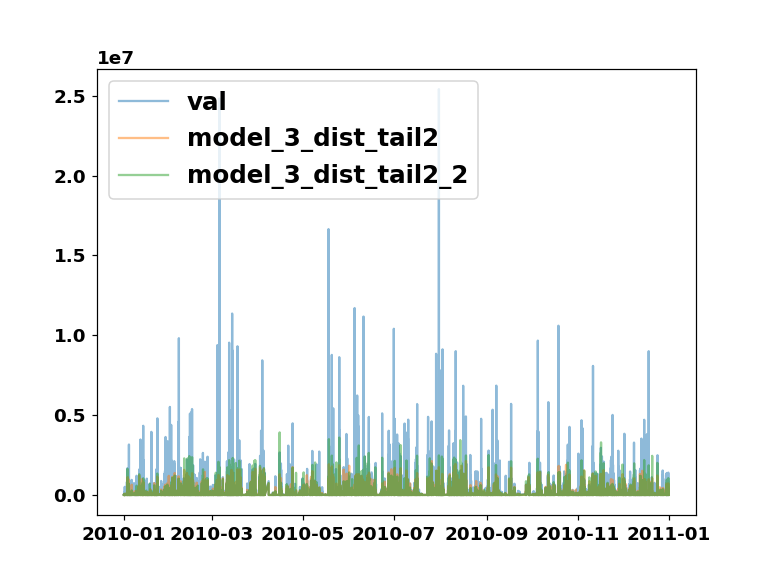

<IPython.core.display.Javascript object>


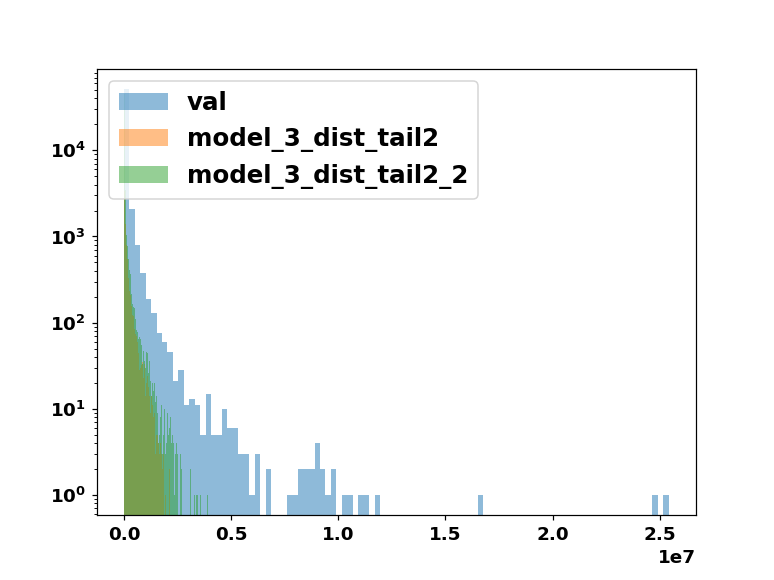

<IPython.core.display.Javascript object>


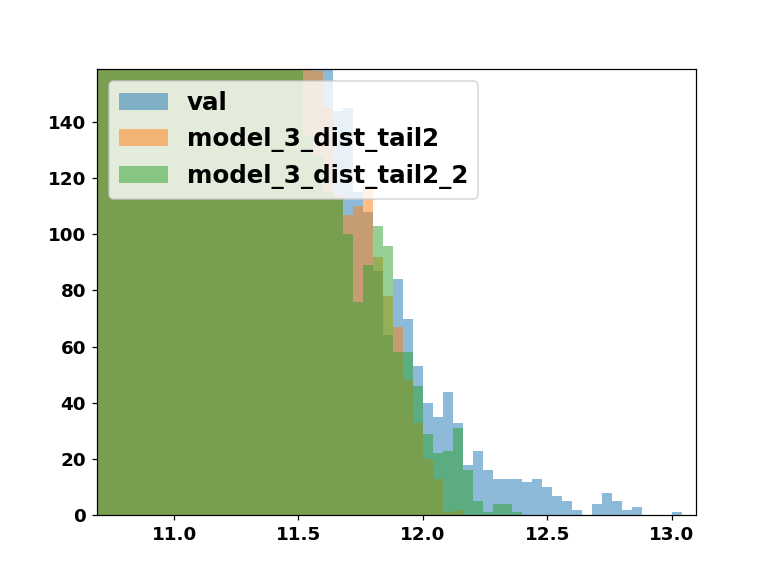

<IPython.core.display.Javascript object>


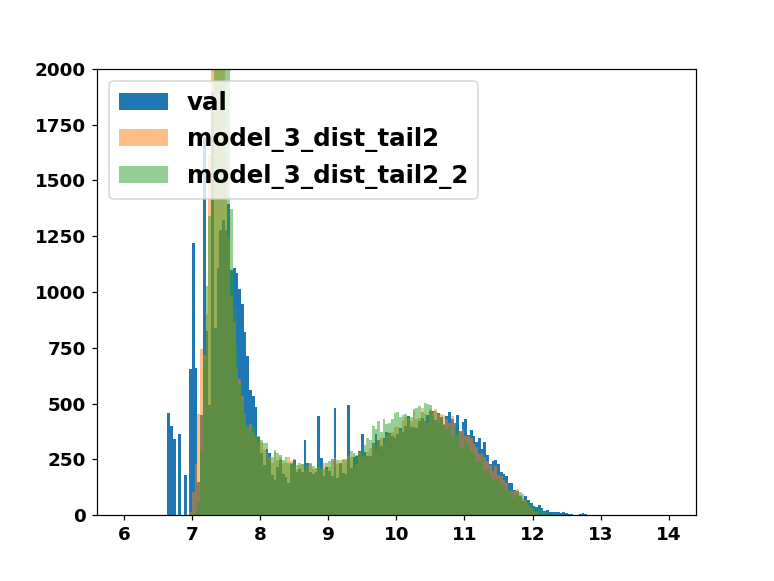

<IPython.core.display.Javascript object>


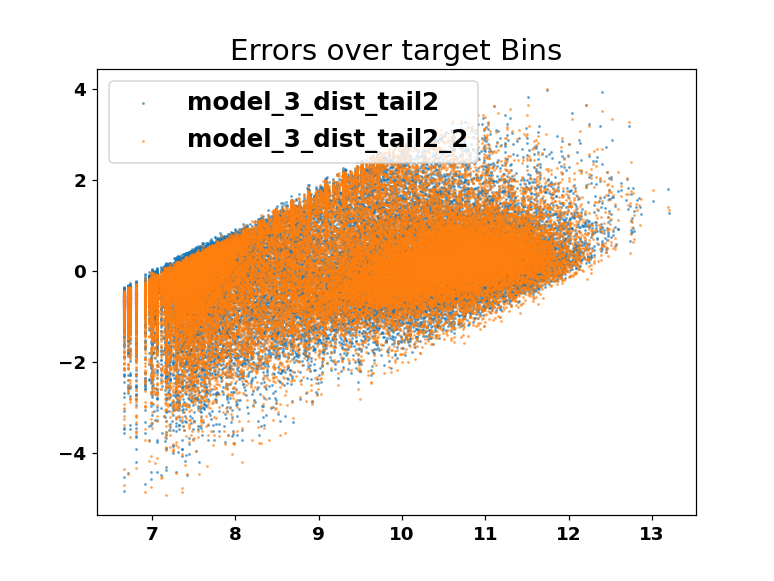

<IPython.core.display.Javascript object>


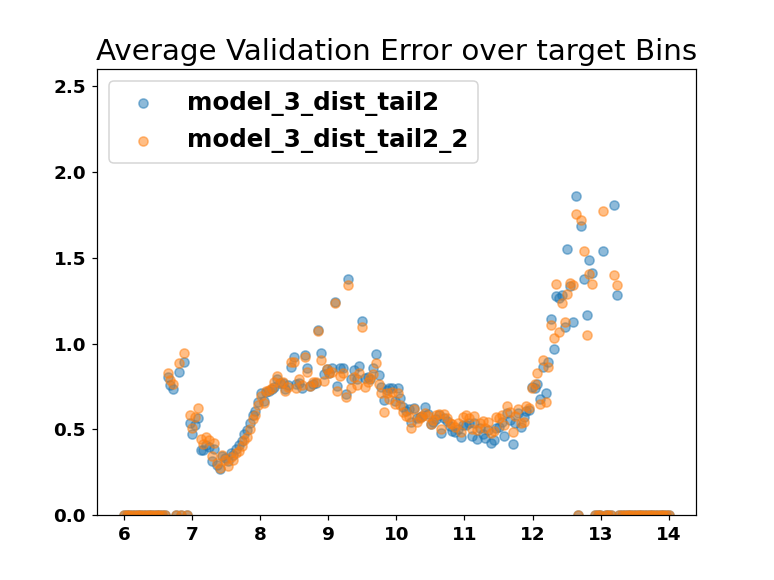

<IPython.core.display.Javascript object>


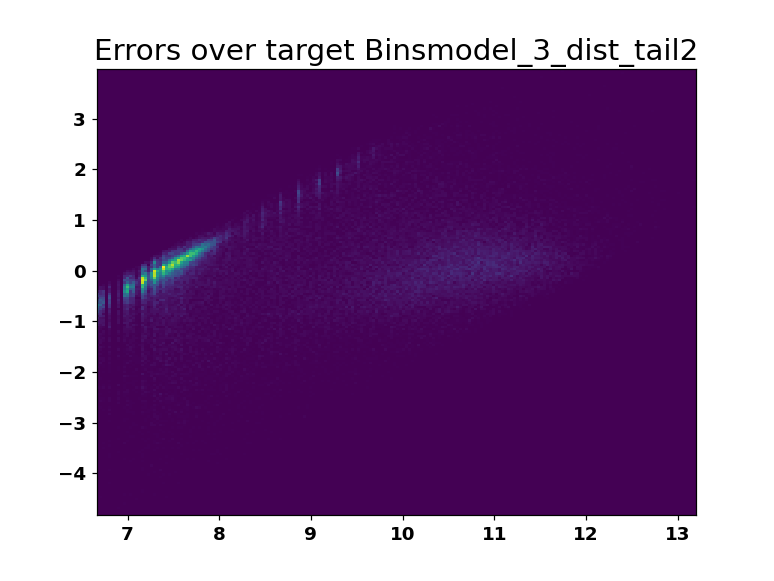

<IPython.core.display.Javascript object>


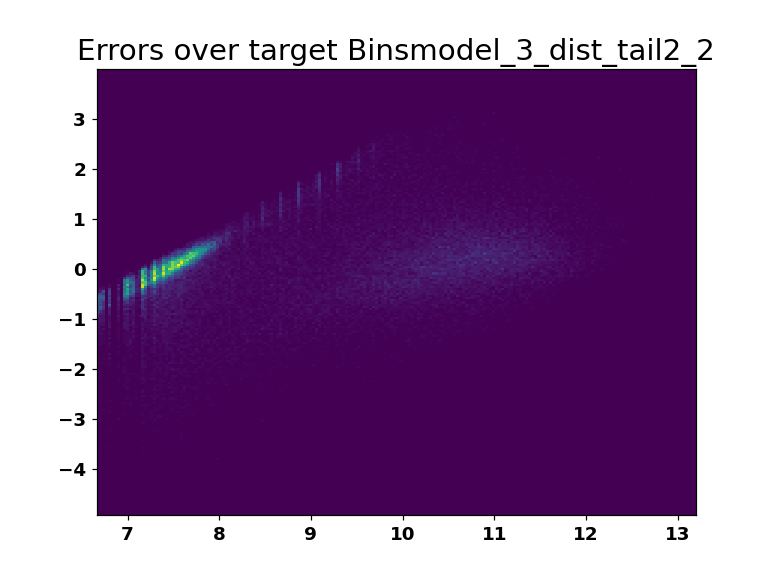

<IPython.core.display.Javascript object>


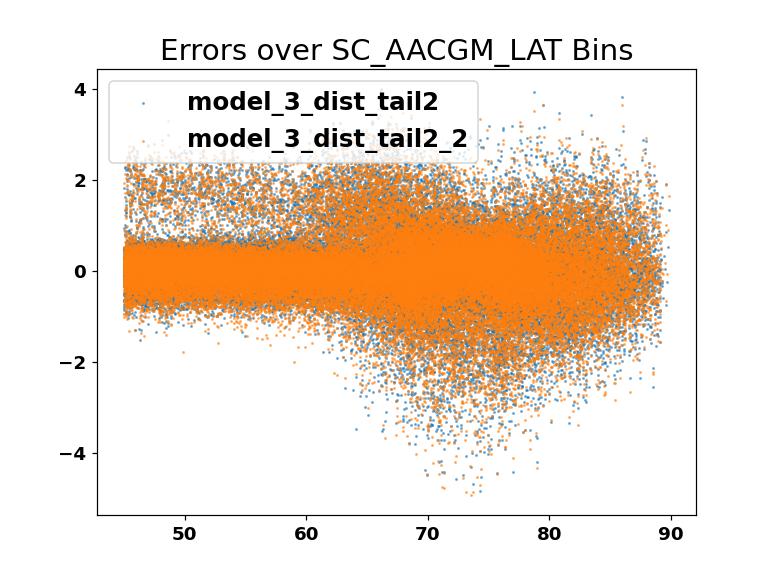

<IPython.core.display.Javascript object>


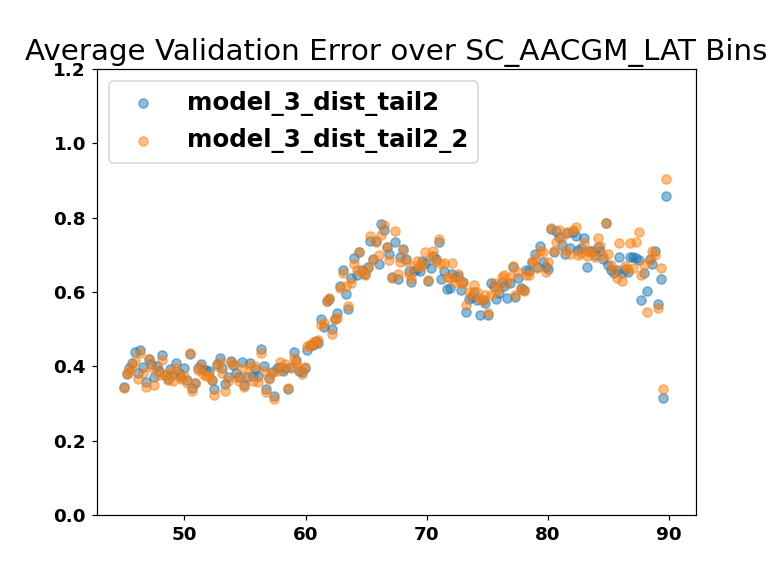

In [104]:
plot_model_multiple([model_3_dist_tail2, model_3_dist_tail2_2],['model_3_dist_tail2', 'model_3_dist_tail2_2'],y_val_log)

<IPython.core.display.Javascript object>


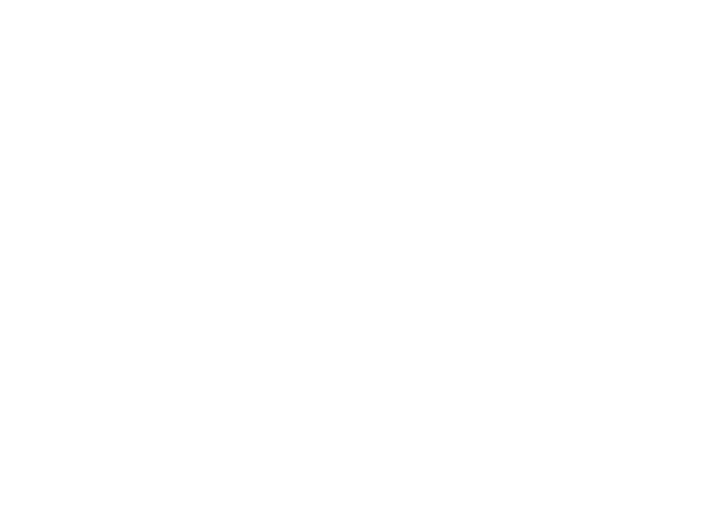

<IPython.core.display.Javascript object>


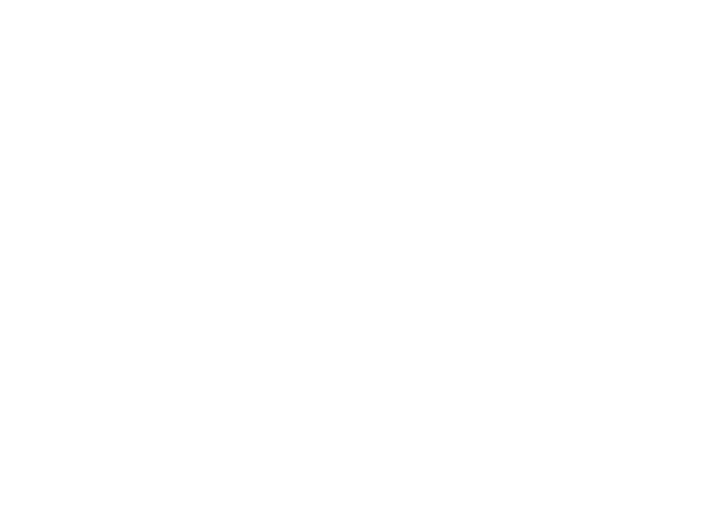

1838283


<IPython.core.display.Javascript object>


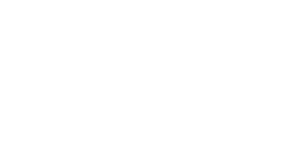

Model: "functional_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_8 (InputLayer)         [(None, 148)]             0         
_________________________________________________________________
dense_63 (Dense)             (None, 256)               38144     
_________________________________________________________________
dropout_7 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_64 (Dense)             (None, 64)                16448     
_________________________________________________________________
dense_65 (Dense)             (None, 32)                2080      
_________________________________________________________________
dense_66 (Dense)             (None, 256)               8448      
_________________________________________________________________
dense_67 (Dense)             (None, 1024)            

Epoch 70/1000
57/57 - 1s - loss: 136.3400 - mse: 0.8226 - val_loss: 0.7688 - val_mse: 0.7688
Epoch 71/1000
57/57 - 1s - loss: 134.8615 - mse: 0.8257 - val_loss: 0.8188 - val_mse: 0.8188
Epoch 72/1000
57/57 - 1s - loss: 133.4936 - mse: 0.8117 - val_loss: 0.8657 - val_mse: 0.8657
Epoch 73/1000
57/57 - 1s - loss: 135.0107 - mse: 0.8261 - val_loss: 0.7628 - val_mse: 0.7628
Epoch 74/1000
57/57 - 1s - loss: 134.3674 - mse: 0.8247 - val_loss: 0.7886 - val_mse: 0.7886
Epoch 75/1000
57/57 - 1s - loss: 134.0714 - mse: 0.8242 - val_loss: 0.8486 - val_mse: 0.8486
Epoch 76/1000
57/57 - 1s - loss: 133.1029 - mse: 0.8168 - val_loss: 0.8460 - val_mse: 0.8460
Epoch 77/1000
57/57 - 1s - loss: 131.5497 - mse: 0.8169 - val_loss: 0.7409 - val_mse: 0.7409
Epoch 78/1000
57/57 - 1s - loss: 132.5762 - mse: 0.8111 - val_loss: 0.8066 - val_mse: 0.8066
Epoch 79/1000
57/57 - 1s - loss: 132.4651 - mse: 0.8106 - val_loss: 0.7997 - val_mse: 0.7997
Epoch 80/1000
57/57 - 1s - loss: 130.8865 - mse: 0.8068 - val_loss: 0.

Epoch 158/1000
57/57 - 1s - loss: 112.6924 - mse: 0.7513 - val_loss: 0.7383 - val_mse: 0.7383
Epoch 159/1000
57/57 - 1s - loss: 114.2119 - mse: 0.7550 - val_loss: 0.7423 - val_mse: 0.7423
Epoch 160/1000
57/57 - 1s - loss: 112.8655 - mse: 0.7560 - val_loss: 0.8112 - val_mse: 0.8112
Epoch 161/1000
57/57 - 1s - loss: 113.9945 - mse: 0.7606 - val_loss: 0.7507 - val_mse: 0.7507
Epoch 162/1000
57/57 - 1s - loss: 115.9674 - mse: 0.7646 - val_loss: 0.7477 - val_mse: 0.7477
Epoch 163/1000
57/57 - 1s - loss: 111.9347 - mse: 0.7591 - val_loss: 0.7941 - val_mse: 0.7941
Epoch 164/1000
57/57 - 1s - loss: 115.4789 - mse: 0.7677 - val_loss: 0.8073 - val_mse: 0.8073
Epoch 165/1000
57/57 - 1s - loss: 115.3759 - mse: 0.7620 - val_loss: 0.8651 - val_mse: 0.8651
Epoch 166/1000
57/57 - 1s - loss: 115.8724 - mse: 0.7768 - val_loss: 0.7648 - val_mse: 0.7648
Epoch 167/1000
57/57 - 1s - loss: 114.1252 - mse: 0.7567 - val_loss: 0.7682 - val_mse: 0.7682
Epoch 168/1000
57/57 - 1s - loss: 113.2285 - mse: 0.7582 - v

57/57 - 1s - loss: 106.0721 - mse: 0.7263 - val_loss: 0.7900 - val_mse: 0.7900
Epoch 246/1000
57/57 - 1s - loss: 108.1906 - mse: 0.7409 - val_loss: 0.7695 - val_mse: 0.7695
Epoch 247/1000
57/57 - 1s - loss: 103.8817 - mse: 0.7135 - val_loss: 0.7296 - val_mse: 0.7296
Epoch 248/1000
57/57 - 1s - loss: 102.4131 - mse: 0.7084 - val_loss: 0.7429 - val_mse: 0.7429
Epoch 249/1000
57/57 - 1s - loss: 103.0594 - mse: 0.7112 - val_loss: 0.7464 - val_mse: 0.7464
Epoch 250/1000
57/57 - 1s - loss: 105.5729 - mse: 0.7236 - val_loss: 0.7479 - val_mse: 0.7479
Epoch 251/1000
57/57 - 1s - loss: 106.3802 - mse: 0.7376 - val_loss: 0.8116 - val_mse: 0.8116
Epoch 252/1000
57/57 - 1s - loss: 105.1636 - mse: 0.7273 - val_loss: 0.8530 - val_mse: 0.8530
Epoch 253/1000
57/57 - 1s - loss: 106.7821 - mse: 0.7349 - val_loss: 0.7375 - val_mse: 0.7375
Epoch 254/1000
57/57 - 1s - loss: 102.5108 - mse: 0.7013 - val_loss: 0.7427 - val_mse: 0.7427
Epoch 255/1000
57/57 - 1s - loss: 103.0382 - mse: 0.7069 - val_loss: 0.7689

Epoch 333/1000
57/57 - 1s - loss: 97.1530 - mse: 0.6754 - val_loss: 0.7344 - val_mse: 0.7344
Epoch 334/1000
57/57 - 1s - loss: 96.2822 - mse: 0.6770 - val_loss: 0.7252 - val_mse: 0.7252
Epoch 335/1000
57/57 - 1s - loss: 98.7305 - mse: 0.6940 - val_loss: 0.7289 - val_mse: 0.7289
Epoch 336/1000
57/57 - 1s - loss: 97.3220 - mse: 0.6879 - val_loss: 0.7142 - val_mse: 0.7142
Epoch 337/1000
57/57 - 1s - loss: 99.3933 - mse: 0.6898 - val_loss: 0.7097 - val_mse: 0.7097
Epoch 338/1000
57/57 - 1s - loss: 97.4875 - mse: 0.6860 - val_loss: 0.7206 - val_mse: 0.7206
Epoch 339/1000
57/57 - 1s - loss: 97.9971 - mse: 0.6831 - val_loss: 0.7079 - val_mse: 0.7079
Epoch 340/1000
57/57 - 1s - loss: 97.3370 - mse: 0.6848 - val_loss: 0.7889 - val_mse: 0.7889
Epoch 341/1000
57/57 - 1s - loss: 99.0706 - mse: 0.7000 - val_loss: 0.7170 - val_mse: 0.7170
Epoch 342/1000
57/57 - 1s - loss: 100.1467 - mse: 0.7042 - val_loss: 0.7168 - val_mse: 0.7168
Epoch 343/1000
57/57 - 1s - loss: 99.3562 - mse: 0.6962 - val_loss: 0

57/57 - 1s - loss: 96.6798 - mse: 0.6857 - val_loss: 0.6996 - val_mse: 0.6996
Epoch 422/1000
57/57 - 1s - loss: 96.3359 - mse: 0.6845 - val_loss: 0.7396 - val_mse: 0.7396
Epoch 423/1000
57/57 - 1s - loss: 96.3033 - mse: 0.6785 - val_loss: 0.7093 - val_mse: 0.7093
Epoch 424/1000
57/57 - 1s - loss: 95.7203 - mse: 0.6806 - val_loss: 0.7118 - val_mse: 0.7118
Epoch 425/1000
57/57 - 1s - loss: 95.0064 - mse: 0.6762 - val_loss: 0.7265 - val_mse: 0.7265
Epoch 426/1000
57/57 - 1s - loss: 94.7553 - mse: 0.6717 - val_loss: 0.7145 - val_mse: 0.7145
Epoch 427/1000
57/57 - 1s - loss: 95.5115 - mse: 0.6765 - val_loss: 0.7088 - val_mse: 0.7088
Epoch 428/1000
57/57 - 1s - loss: 95.9157 - mse: 0.6826 - val_loss: 0.6990 - val_mse: 0.6990
Epoch 429/1000
57/57 - 1s - loss: 95.9608 - mse: 0.6795 - val_loss: 0.7126 - val_mse: 0.7126
Epoch 430/1000
57/57 - 1s - loss: 95.8864 - mse: 0.6843 - val_loss: 0.7097 - val_mse: 0.7097
Epoch 431/1000
57/57 - 1s - loss: 96.3571 - mse: 0.6780 - val_loss: 0.7244 - val_mse:

Epoch 510/1000
57/57 - 1s - loss: 95.0343 - mse: 0.6751 - val_loss: 0.7107 - val_mse: 0.7107
Epoch 511/1000
57/57 - 1s - loss: 93.9858 - mse: 0.6740 - val_loss: 0.7130 - val_mse: 0.7130
Epoch 512/1000
57/57 - 1s - loss: 93.9370 - mse: 0.6688 - val_loss: 0.6996 - val_mse: 0.6996
Epoch 513/1000
57/57 - 1s - loss: 94.0973 - mse: 0.6724 - val_loss: 0.7296 - val_mse: 0.7296
Epoch 514/1000
57/57 - 1s - loss: 93.8410 - mse: 0.6712 - val_loss: 0.7245 - val_mse: 0.7245
Epoch 515/1000
57/57 - 1s - loss: 92.6183 - mse: 0.6599 - val_loss: 0.7058 - val_mse: 0.7058
Epoch 516/1000
57/57 - 1s - loss: 93.1898 - mse: 0.6675 - val_loss: 0.7204 - val_mse: 0.7204
Epoch 517/1000
57/57 - 1s - loss: 93.7538 - mse: 0.6689 - val_loss: 0.7076 - val_mse: 0.7076
Epoch 518/1000
57/57 - 1s - loss: 92.9962 - mse: 0.6614 - val_loss: 0.7136 - val_mse: 0.7136
Epoch 519/1000
57/57 - 1s - loss: 93.0300 - mse: 0.6691 - val_loss: 0.7110 - val_mse: 0.7110
Epoch 520/1000
57/57 - 1s - loss: 92.5378 - mse: 0.6643 - val_loss: 0.

57/57 - 1s - loss: 95.2688 - mse: 0.6745 - val_loss: 0.7321 - val_mse: 0.7321
Epoch 599/1000
57/57 - 1s - loss: 93.4534 - mse: 0.6739 - val_loss: 0.7223 - val_mse: 0.7223
Epoch 600/1000
57/57 - 1s - loss: 91.3855 - mse: 0.6600 - val_loss: 0.6924 - val_mse: 0.6924
Epoch 601/1000
57/57 - 1s - loss: 90.9609 - mse: 0.6563 - val_loss: 0.7077 - val_mse: 0.7077
Epoch 602/1000
57/57 - 1s - loss: 91.9713 - mse: 0.6594 - val_loss: 0.7242 - val_mse: 0.7242
Epoch 603/1000
57/57 - 1s - loss: 91.3874 - mse: 0.6566 - val_loss: 0.6986 - val_mse: 0.6986
Epoch 604/1000
57/57 - 1s - loss: 91.6029 - mse: 0.6548 - val_loss: 0.7202 - val_mse: 0.7202
Epoch 605/1000
57/57 - 1s - loss: 90.5621 - mse: 0.6533 - val_loss: 0.7142 - val_mse: 0.7142
Epoch 606/1000
57/57 - 1s - loss: 89.8469 - mse: 0.6523 - val_loss: 0.7090 - val_mse: 0.7090
Epoch 607/1000
57/57 - 1s - loss: 90.6767 - mse: 0.6533 - val_loss: 0.7291 - val_mse: 0.7291
Epoch 608/1000
57/57 - 1s - loss: 91.4626 - mse: 0.6628 - val_loss: 0.7040 - val_mse:

Epoch 687/1000
57/57 - 1s - loss: 91.6377 - mse: 0.6589 - val_loss: 0.7084 - val_mse: 0.7084
Epoch 688/1000
57/57 - 1s - loss: 92.1254 - mse: 0.6637 - val_loss: 0.6997 - val_mse: 0.6997
Epoch 689/1000
57/57 - 1s - loss: 91.3893 - mse: 0.6585 - val_loss: 0.7078 - val_mse: 0.7078
Epoch 690/1000
57/57 - 1s - loss: 90.0673 - mse: 0.6545 - val_loss: 0.7057 - val_mse: 0.7057
Epoch 691/1000
57/57 - 1s - loss: 88.7259 - mse: 0.6468 - val_loss: 0.7387 - val_mse: 0.7387
Epoch 692/1000
57/57 - 1s - loss: 88.8479 - mse: 0.6495 - val_loss: 0.6958 - val_mse: 0.6958
Epoch 693/1000
57/57 - 1s - loss: 87.8627 - mse: 0.6409 - val_loss: 0.6958 - val_mse: 0.6958
Epoch 694/1000
57/57 - 1s - loss: 88.7001 - mse: 0.6431 - val_loss: 0.6963 - val_mse: 0.6963
Epoch 695/1000
57/57 - 1s - loss: 89.3260 - mse: 0.6477 - val_loss: 0.7151 - val_mse: 0.7151
Epoch 696/1000
57/57 - 1s - loss: 90.7765 - mse: 0.6572 - val_loss: 0.7266 - val_mse: 0.7266
Epoch 697/1000
57/57 - 1s - loss: 90.4475 - mse: 0.6603 - val_loss: 0.

57/57 - 1s - loss: 90.3042 - mse: 0.6536 - val_loss: 0.6977 - val_mse: 0.6977
Epoch 776/1000
57/57 - 1s - loss: 88.7418 - mse: 0.6455 - val_loss: 0.7430 - val_mse: 0.7430
Epoch 777/1000
57/57 - 1s - loss: 88.4852 - mse: 0.6476 - val_loss: 0.7068 - val_mse: 0.7068
Epoch 778/1000
57/57 - 1s - loss: 89.5178 - mse: 0.6504 - val_loss: 0.7118 - val_mse: 0.7118
Epoch 779/1000
57/57 - 1s - loss: 89.3051 - mse: 0.6462 - val_loss: 0.6930 - val_mse: 0.6930
Epoch 780/1000
57/57 - 1s - loss: 89.8613 - mse: 0.6543 - val_loss: 0.7092 - val_mse: 0.7092
Epoch 781/1000
57/57 - 1s - loss: 90.1397 - mse: 0.6556 - val_loss: 0.7024 - val_mse: 0.7024
Epoch 782/1000
57/57 - 1s - loss: 90.6021 - mse: 0.6589 - val_loss: 0.7111 - val_mse: 0.7111
Epoch 783/1000
57/57 - 1s - loss: 88.4631 - mse: 0.6446 - val_loss: 0.7130 - val_mse: 0.7130
Epoch 784/1000
57/57 - 1s - loss: 89.4539 - mse: 0.6467 - val_loss: 0.7028 - val_mse: 0.7028
Epoch 785/1000
57/57 - 1s - loss: 87.3178 - mse: 0.6426 - val_loss: 0.7059 - val_mse:

Epoch 864/1000
57/57 - 1s - loss: 87.8778 - mse: 0.6456 - val_loss: 0.7156 - val_mse: 0.7156
Epoch 865/1000
57/57 - 1s - loss: 87.0211 - mse: 0.6391 - val_loss: 0.7040 - val_mse: 0.7040
Epoch 866/1000
57/57 - 1s - loss: 87.2749 - mse: 0.6456 - val_loss: 0.6980 - val_mse: 0.6980
Epoch 867/1000
57/57 - 1s - loss: 87.0199 - mse: 0.6404 - val_loss: 0.6950 - val_mse: 0.6950
Epoch 868/1000
57/57 - 1s - loss: 86.6795 - mse: 0.6401 - val_loss: 0.7001 - val_mse: 0.7001
Epoch 869/1000
57/57 - 1s - loss: 88.2730 - mse: 0.6383 - val_loss: 0.6952 - val_mse: 0.6952
Epoch 870/1000
57/57 - 1s - loss: 86.9513 - mse: 0.6375 - val_loss: 0.6995 - val_mse: 0.6995
Epoch 871/1000
57/57 - 1s - loss: 86.7720 - mse: 0.6340 - val_loss: 0.6891 - val_mse: 0.6891
Epoch 872/1000
57/57 - 1s - loss: 86.5600 - mse: 0.6336 - val_loss: 0.7161 - val_mse: 0.7161
Epoch 873/1000
57/57 - 1s - loss: 86.9554 - mse: 0.6368 - val_loss: 0.6961 - val_mse: 0.6961
Epoch 874/1000
57/57 - 1s - loss: 86.4977 - mse: 0.6335 - val_loss: 0.

57/57 - 1s - loss: 91.8966 - mse: 0.6652 - val_loss: 0.7129 - val_mse: 0.7129
Epoch 953/1000
57/57 - 1s - loss: 89.1088 - mse: 0.6402 - val_loss: 0.7063 - val_mse: 0.7063
Epoch 954/1000
57/57 - 1s - loss: 86.8123 - mse: 0.6371 - val_loss: 0.7051 - val_mse: 0.7051
Epoch 955/1000
57/57 - 1s - loss: 87.2840 - mse: 0.6356 - val_loss: 0.7165 - val_mse: 0.7165
Epoch 956/1000
57/57 - 1s - loss: 86.9964 - mse: 0.6397 - val_loss: 0.7004 - val_mse: 0.7004
Epoch 957/1000
57/57 - 1s - loss: 87.3676 - mse: 0.6426 - val_loss: 0.7159 - val_mse: 0.7159
Epoch 958/1000
57/57 - 1s - loss: 86.6953 - mse: 0.6380 - val_loss: 0.7178 - val_mse: 0.7178
Epoch 959/1000
57/57 - 1s - loss: 86.7139 - mse: 0.6345 - val_loss: 0.7088 - val_mse: 0.7088
Epoch 960/1000
57/57 - 1s - loss: 86.7792 - mse: 0.6386 - val_loss: 0.7266 - val_mse: 0.7266
Epoch 961/1000
57/57 - 1s - loss: 86.5615 - mse: 0.6357 - val_loss: 0.7182 - val_mse: 0.7182
Epoch 962/1000
57/57 - 1s - loss: 86.3154 - mse: 0.6347 - val_loss: 0.7021 - val_mse:

<IPython.core.display.Javascript object>


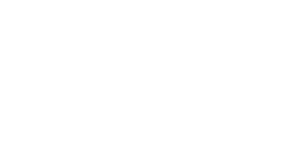

<IPython.core.display.Javascript object>


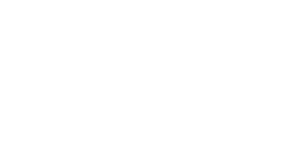

<IPython.core.display.Javascript object>


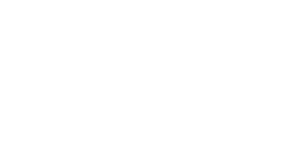

<IPython.core.display.Javascript object>


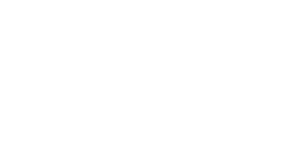

<IPython.core.display.Javascript object>


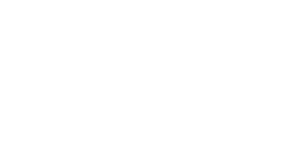

<IPython.core.display.Javascript object>


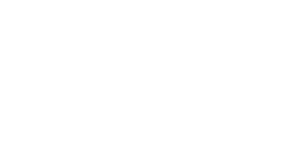

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:48: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


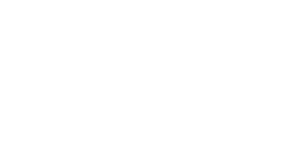

<IPython.core.display.Javascript object>


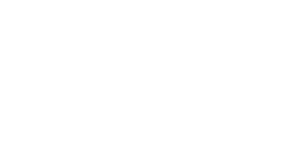

<IPython.core.display.Javascript object>


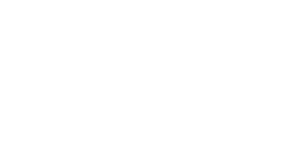

<IPython.core.display.Javascript object>


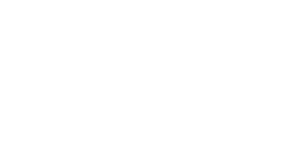

<IPython.core.display.Javascript object>


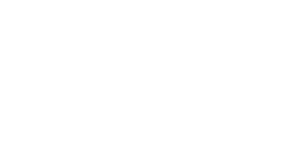

<IPython.core.display.Javascript object>


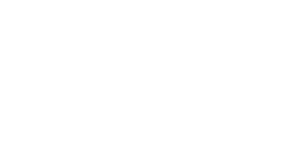

<IPython.core.display.Javascript object>


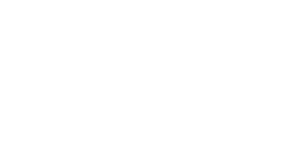

<IPython.core.display.Javascript object>


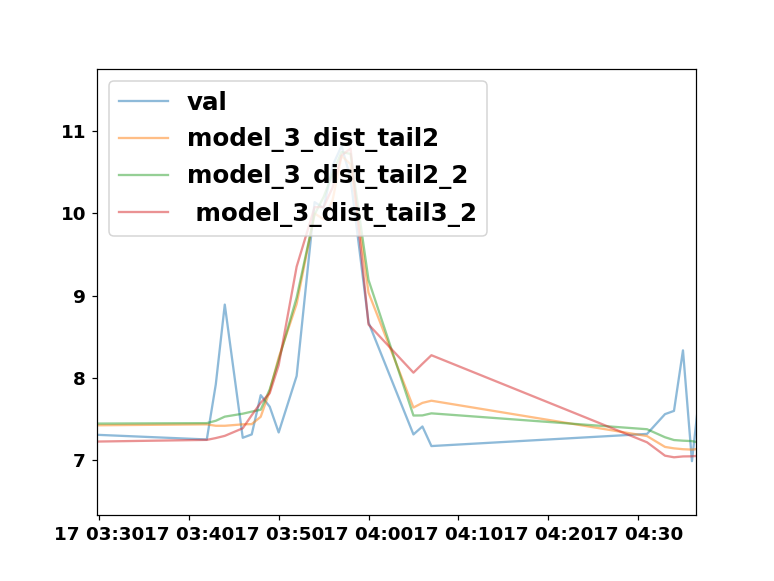

<IPython.core.display.Javascript object>


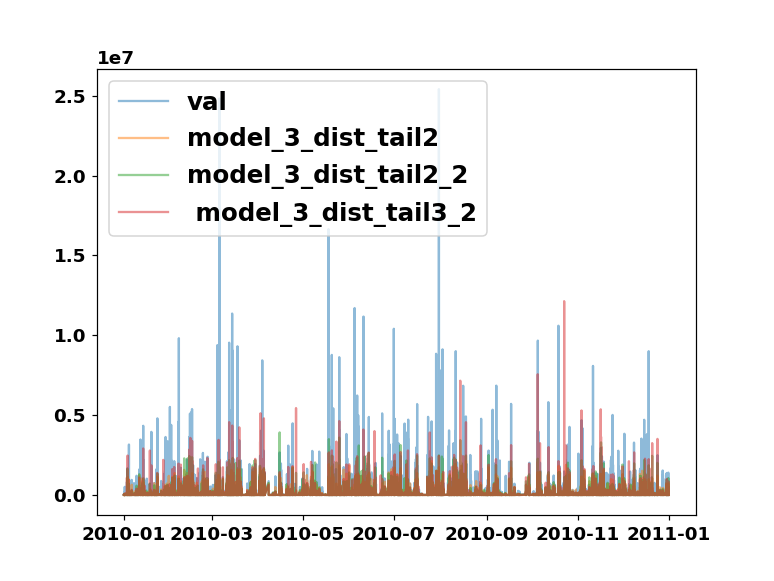

<IPython.core.display.Javascript object>


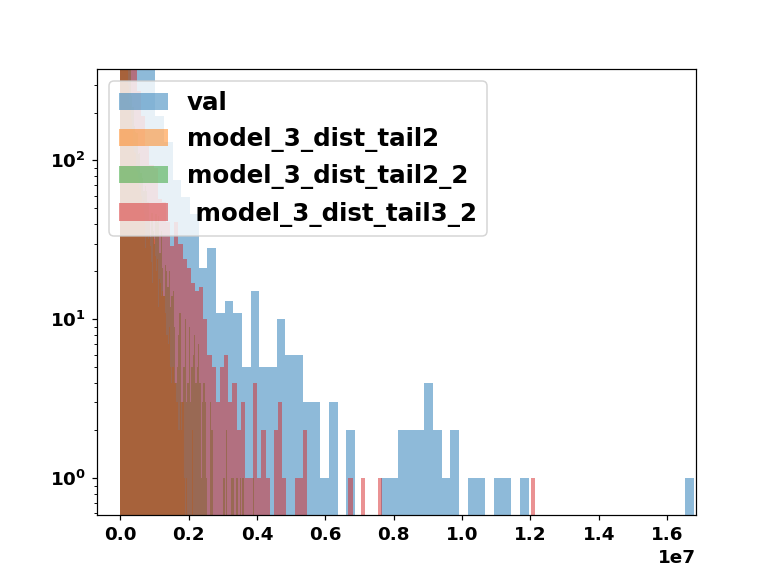

<IPython.core.display.Javascript object>


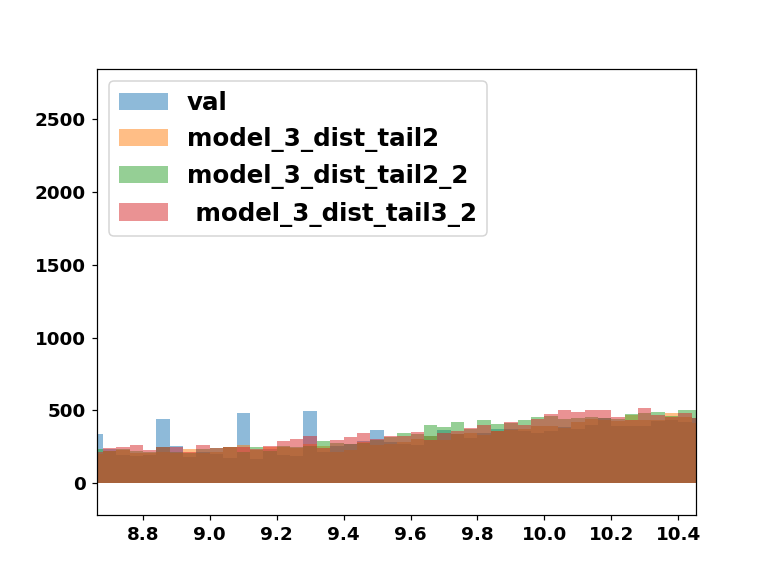

<IPython.core.display.Javascript object>


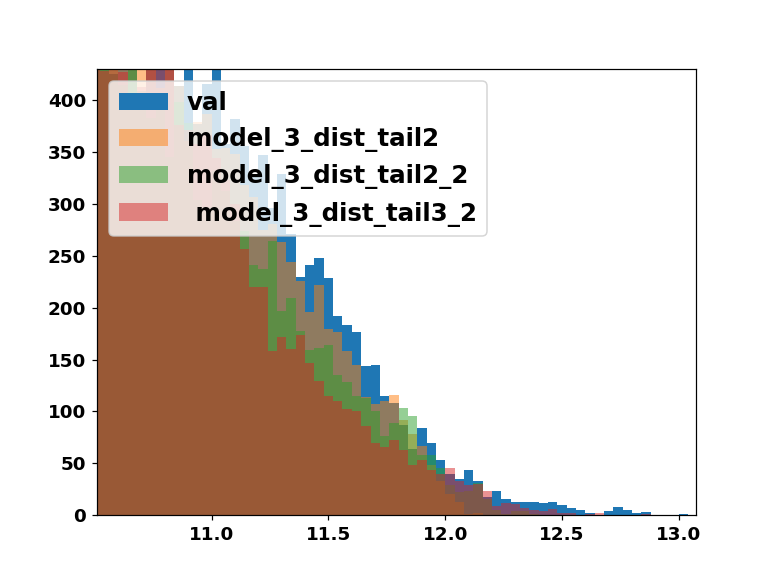

<IPython.core.display.Javascript object>


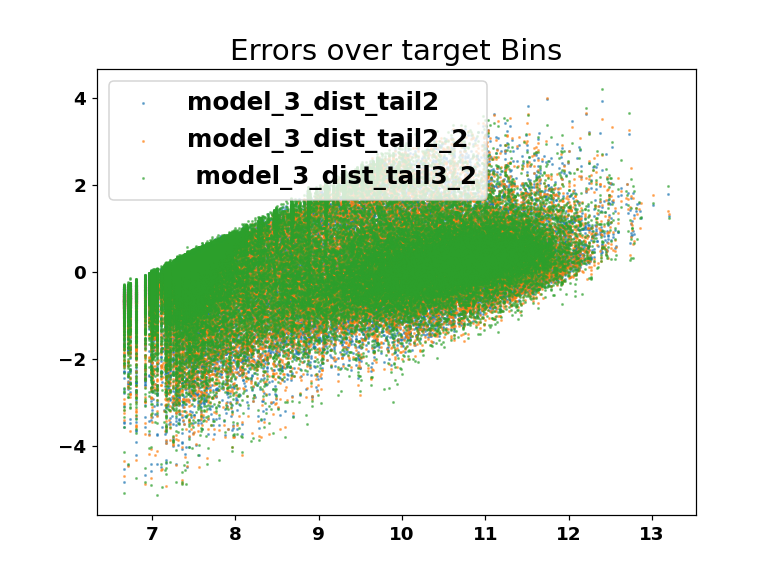

<IPython.core.display.Javascript object>


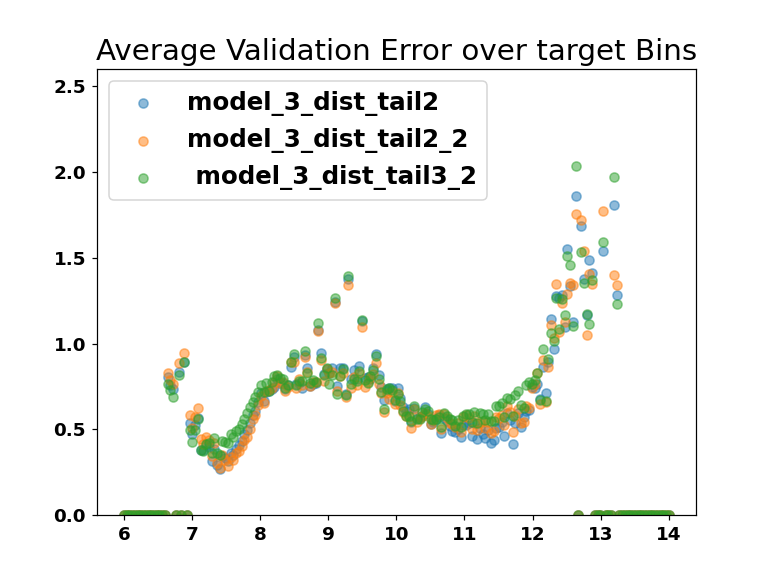

<IPython.core.display.Javascript object>


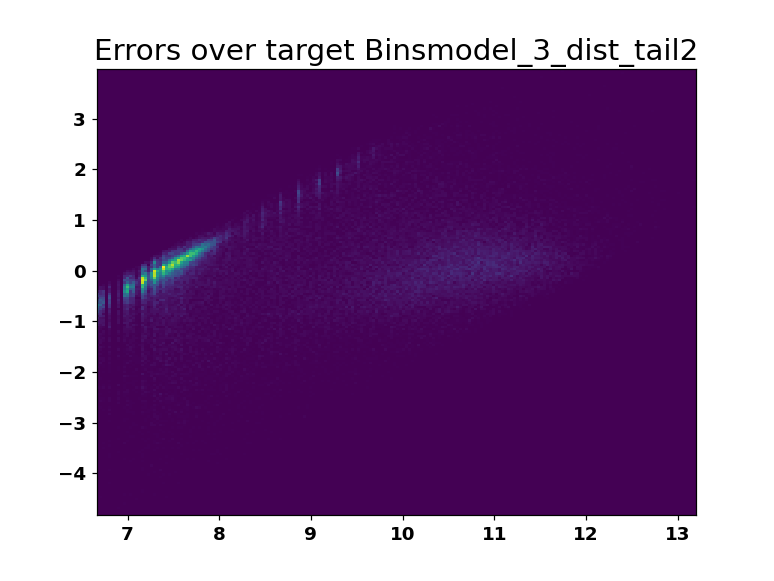

<IPython.core.display.Javascript object>


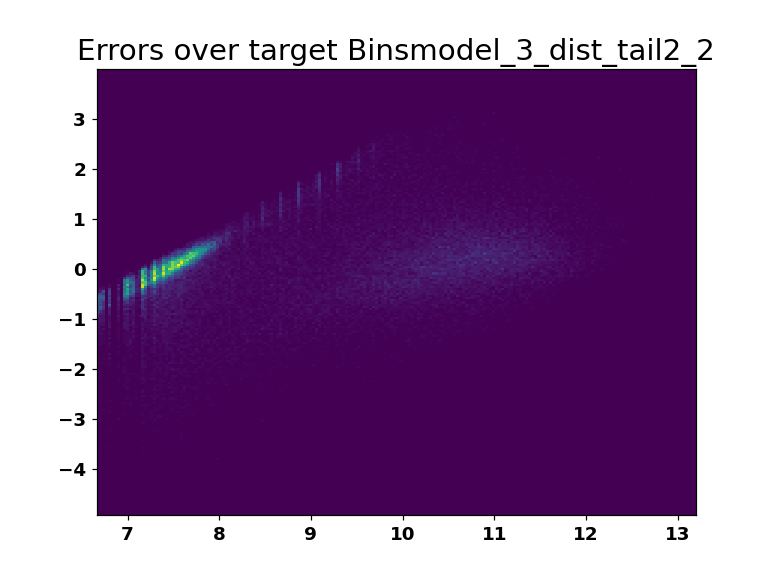

<IPython.core.display.Javascript object>


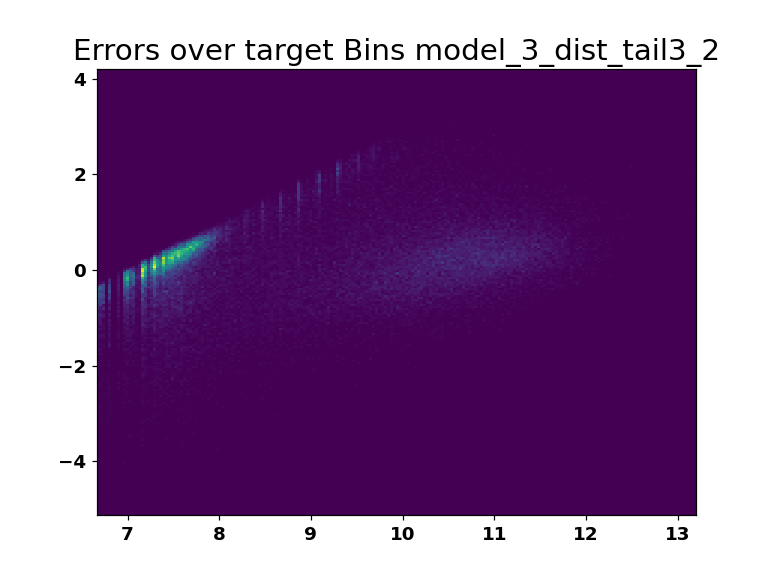

<IPython.core.display.Javascript object>


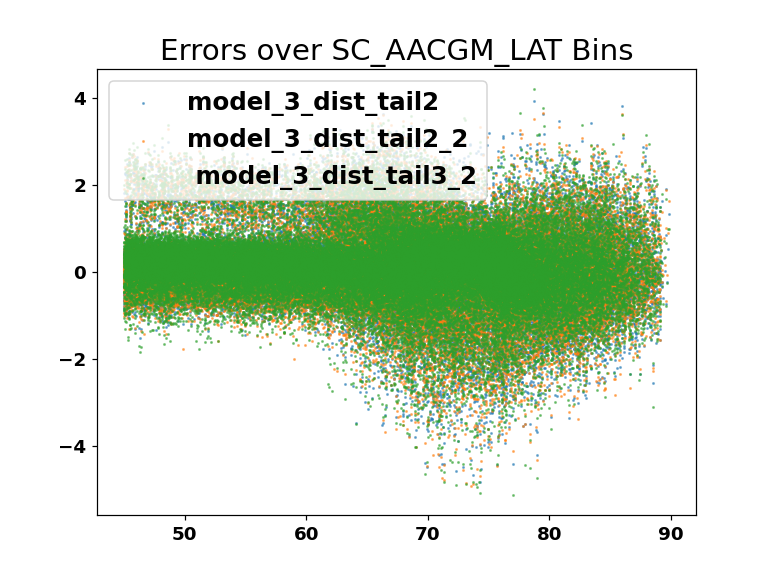

<IPython.core.display.Javascript object>


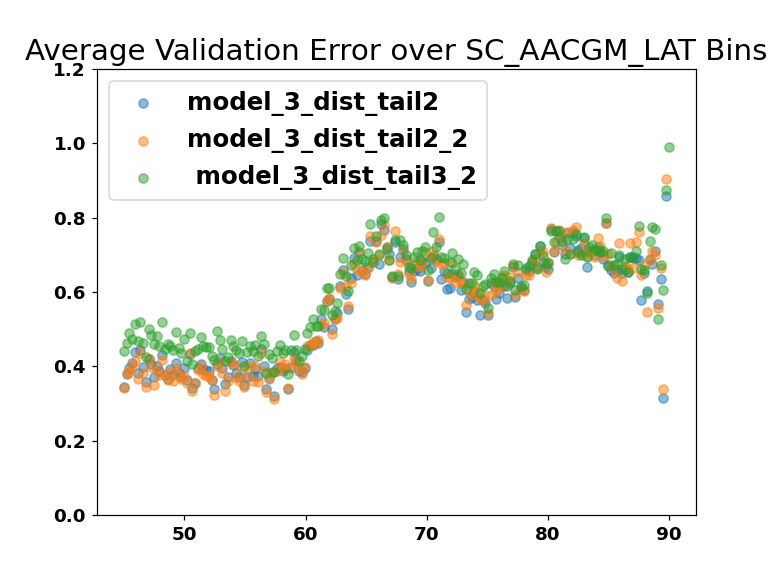

In [105]:
bins = np.linspace(np.min(y_train_log),np.max(y_train_log),200)
hist,bins = np.histogram(y_train_log,bins =bins)
plt.figure()
plt.scatter(bins[1:],hist)
plt.figure()
print(y_train_log.size)
plt.plot(y_train_log.size/(hist+1000))
bin_size = bins[1]-bins[0]
y_min = np.min(y_train_log)
sample_weights = np.ones((y_train_log.size))
for i in range(0,y_train_log.size):
    bin_i = int((y_train_log[i]-y_min)/bin_size)
    if bin_i ==199:
        bin_i = 198
#     if bin_i < 20:
#         bin_i = 20
    sample_weights[i] = y_train_log.size/(hist[bin_i]+100)
    
plt.figure()
plt.hist(sample_weights,bins=200)
plt.show()

from tensorflow.keras.layers import Input

input1 = Input(shape=(148))
model1 = Dense(256,  activation='relu')(input1)
model1 = model1 = Dropout(0.5)(model1)
model1 = Dense(64, activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(int(256),   activation='relu')(model1)
model1 = Dense(int(1024),  activation='relu')(model1)
model1 = Dense(int(256),  activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(4, activation='relu')(model1)
model1 = Dense(1, activation='linear' )(model1)


output = model1
model = tensorflow.keras.models.Model(inputs=input1, outputs=output)
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',metrics=['mse'])
model.summary()

history = model.fit(X, 
                   y_train_log, 
                    validation_data=(
                        X_test, 
                        y_val_log,                                    ), sample_weight=sample_weights,
                    batch_size=32768,epochs=1000,verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=200)])#


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.ylim([0,.9])
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

results = model.predict(X_test)

df_results = pd.DataFrame(data=results, index = df_val.index)

model_3_dist_tail3_2 = df_results

plot_model(df_results)

plot_model_multiple([model_3_dist_tail2, model_3_dist_tail2_2, model_3_dist_tail3_2],['model_3_dist_tail2', 'model_3_dist_tail2_2',' model_3_dist_tail3_2'],y_val_log)

<IPython.core.display.Javascript object>


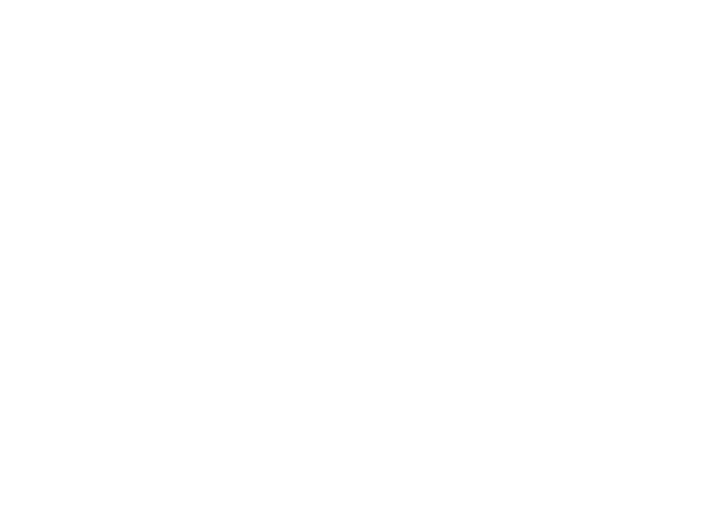

<IPython.core.display.Javascript object>


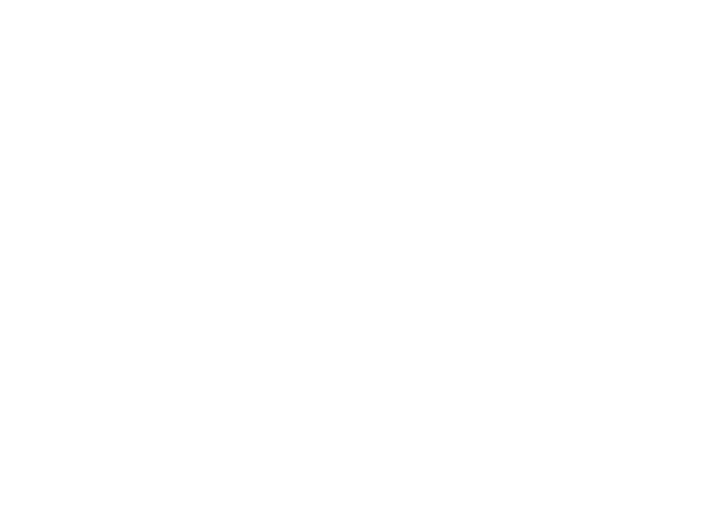

1838283


<IPython.core.display.Javascript object>


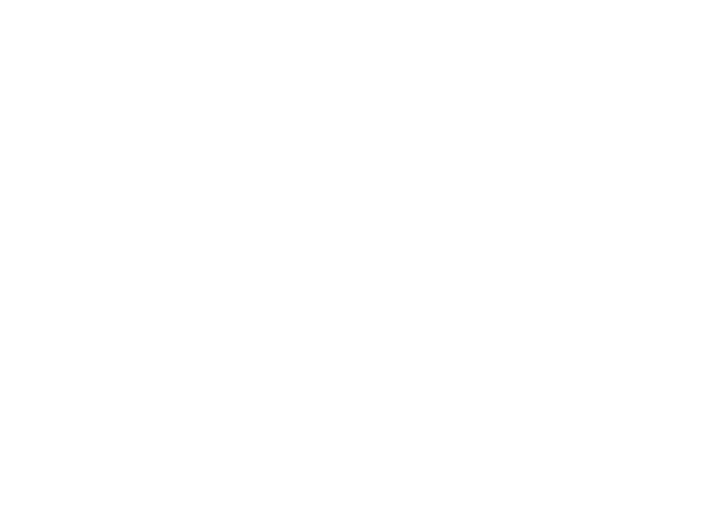

Model: "functional_21"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_11 (InputLayer)        [(None, 148)]             0         
_________________________________________________________________
dense_90 (Dense)             (None, 256)               38144     
_________________________________________________________________
dropout_10 (Dropout)         (None, 256)               0         
_________________________________________________________________
dense_91 (Dense)             (None, 64)                16448     
_________________________________________________________________
dense_92 (Dense)             (None, 32)                2080      
_________________________________________________________________
dense_93 (Dense)             (None, 256)               8448      
_________________________________________________________________
dense_94 (Dense)             (None, 1024)            

Epoch 70/2000
57/57 - 1s - loss: 242.0250 - mse: 1.4106 - val_loss: 1.0018 - val_mse: 1.0018
Epoch 71/2000
57/57 - 1s - loss: 233.7992 - mse: 1.4071 - val_loss: 1.1111 - val_mse: 1.1111
Epoch 72/2000
57/57 - 1s - loss: 223.6384 - mse: 1.3030 - val_loss: 0.9028 - val_mse: 0.9028
Epoch 73/2000
57/57 - 1s - loss: 250.8617 - mse: 1.4338 - val_loss: 0.8990 - val_mse: 0.8990
Epoch 74/2000
57/57 - 1s - loss: 238.1497 - mse: 1.3974 - val_loss: 0.9108 - val_mse: 0.9108
Epoch 75/2000
57/57 - 1s - loss: 224.6436 - mse: 1.3160 - val_loss: 1.2965 - val_mse: 1.2965
Epoch 76/2000
57/57 - 1s - loss: 228.9476 - mse: 1.3200 - val_loss: 0.9645 - val_mse: 0.9645
Epoch 77/2000
57/57 - 1s - loss: 220.0086 - mse: 1.2696 - val_loss: 1.0191 - val_mse: 1.0191
Epoch 78/2000
57/57 - 1s - loss: 202.1289 - mse: 1.2415 - val_loss: 0.8484 - val_mse: 0.8484
Epoch 79/2000
57/57 - 1s - loss: 211.9558 - mse: 1.2051 - val_loss: 1.1874 - val_mse: 1.1874
Epoch 80/2000
57/57 - 1s - loss: 222.0328 - mse: 1.3441 - val_loss: 0.

Epoch 158/2000
57/57 - 2s - loss: 164.1062 - mse: 1.0130 - val_loss: 0.9210 - val_mse: 0.9210
Epoch 159/2000
57/57 - 1s - loss: 171.8856 - mse: 1.1099 - val_loss: 0.8554 - val_mse: 0.8554
Epoch 160/2000
57/57 - 1s - loss: 166.7832 - mse: 1.0326 - val_loss: 0.8454 - val_mse: 0.8454
Epoch 161/2000
57/57 - 1s - loss: 167.3870 - mse: 1.0447 - val_loss: 0.8590 - val_mse: 0.8590
Epoch 162/2000
57/57 - 1s - loss: 166.9211 - mse: 1.0518 - val_loss: 0.8239 - val_mse: 0.8239
Epoch 163/2000
57/57 - 1s - loss: 161.7735 - mse: 1.0025 - val_loss: 0.8956 - val_mse: 0.8956
Epoch 164/2000
57/57 - 1s - loss: 170.5553 - mse: 1.0478 - val_loss: 0.8447 - val_mse: 0.8447
Epoch 165/2000
57/57 - 1s - loss: 168.8245 - mse: 1.0439 - val_loss: 0.8467 - val_mse: 0.8467
Epoch 166/2000
57/57 - 1s - loss: 169.2273 - mse: 1.0456 - val_loss: 0.8245 - val_mse: 0.8245
Epoch 167/2000
57/57 - 1s - loss: 171.5158 - mse: 1.0105 - val_loss: 0.8867 - val_mse: 0.8867
Epoch 168/2000
57/57 - 1s - loss: 167.8899 - mse: 1.0415 - v

57/57 - 1s - loss: 154.4131 - mse: 0.9864 - val_loss: 0.8790 - val_mse: 0.8790
Epoch 246/2000
57/57 - 1s - loss: 154.6708 - mse: 1.0020 - val_loss: 0.8024 - val_mse: 0.8024
Epoch 247/2000
57/57 - 1s - loss: 147.9681 - mse: 0.9342 - val_loss: 0.8058 - val_mse: 0.8058
Epoch 248/2000
57/57 - 1s - loss: 151.2517 - mse: 0.9328 - val_loss: 0.7954 - val_mse: 0.7954
Epoch 249/2000
57/57 - 1s - loss: 153.0890 - mse: 0.9874 - val_loss: 0.8319 - val_mse: 0.8319
Epoch 250/2000
57/57 - 1s - loss: 152.1555 - mse: 0.9766 - val_loss: 0.8144 - val_mse: 0.8144
Epoch 251/2000
57/57 - 1s - loss: 141.6798 - mse: 0.9237 - val_loss: 0.7965 - val_mse: 0.7965
Epoch 252/2000
57/57 - 2s - loss: 150.6591 - mse: 0.9617 - val_loss: 0.9339 - val_mse: 0.9339
Epoch 253/2000
57/57 - 2s - loss: 151.3518 - mse: 0.9666 - val_loss: 0.7837 - val_mse: 0.7837
Epoch 254/2000
57/57 - 1s - loss: 144.2486 - mse: 0.9215 - val_loss: 0.7918 - val_mse: 0.7918
Epoch 255/2000
57/57 - 1s - loss: 145.0293 - mse: 0.9258 - val_loss: 0.7973

Epoch 333/2000
57/57 - 1s - loss: 148.1100 - mse: 0.9449 - val_loss: 0.8958 - val_mse: 0.8958
Epoch 334/2000
57/57 - 1s - loss: 144.3184 - mse: 0.9473 - val_loss: 0.8180 - val_mse: 0.8180
Epoch 335/2000
57/57 - 1s - loss: 142.7063 - mse: 0.9211 - val_loss: 0.7958 - val_mse: 0.7958
Epoch 336/2000
57/57 - 1s - loss: 139.3152 - mse: 0.9179 - val_loss: 0.7750 - val_mse: 0.7750
Epoch 337/2000
57/57 - 1s - loss: 140.2549 - mse: 0.9277 - val_loss: 0.7602 - val_mse: 0.7602
Epoch 338/2000
57/57 - 1s - loss: 141.7763 - mse: 0.9140 - val_loss: 0.8100 - val_mse: 0.8100
Epoch 339/2000
57/57 - 1s - loss: 141.0583 - mse: 0.9314 - val_loss: 0.8919 - val_mse: 0.8919
Epoch 340/2000
57/57 - 1s - loss: 143.1084 - mse: 0.9230 - val_loss: 0.7939 - val_mse: 0.7939
Epoch 341/2000
57/57 - 1s - loss: 137.2802 - mse: 0.8793 - val_loss: 0.7880 - val_mse: 0.7880
Epoch 342/2000
57/57 - 1s - loss: 136.8623 - mse: 0.8851 - val_loss: 0.8125 - val_mse: 0.8125
Epoch 343/2000
57/57 - 1s - loss: 137.7719 - mse: 0.9045 - v

57/57 - 1s - loss: 129.5870 - mse: 0.8613 - val_loss: 0.7712 - val_mse: 0.7712
Epoch 421/2000
57/57 - 1s - loss: 133.8355 - mse: 0.8620 - val_loss: 0.8480 - val_mse: 0.8480
Epoch 422/2000
57/57 - 1s - loss: 129.3383 - mse: 0.8600 - val_loss: 0.7891 - val_mse: 0.7891
Epoch 423/2000
57/57 - 2s - loss: 128.3715 - mse: 0.8431 - val_loss: 0.7908 - val_mse: 0.7908
Epoch 424/2000
57/57 - 1s - loss: 128.2782 - mse: 0.8429 - val_loss: 0.7803 - val_mse: 0.7803
Epoch 425/2000
57/57 - 1s - loss: 129.3122 - mse: 0.8505 - val_loss: 0.7718 - val_mse: 0.7718
Epoch 426/2000
57/57 - 1s - loss: 126.8128 - mse: 0.8406 - val_loss: 0.7685 - val_mse: 0.7685
Epoch 427/2000
57/57 - 1s - loss: 126.3240 - mse: 0.8383 - val_loss: 0.8291 - val_mse: 0.8291
Epoch 428/2000
57/57 - 1s - loss: 128.4979 - mse: 0.8506 - val_loss: 0.8691 - val_mse: 0.8691
Epoch 429/2000
57/57 - 1s - loss: 132.3418 - mse: 0.8432 - val_loss: 0.7832 - val_mse: 0.7832
Epoch 430/2000
57/57 - 1s - loss: 135.2742 - mse: 0.8575 - val_loss: 0.8246

Epoch 508/2000
57/57 - 1s - loss: 122.8093 - mse: 0.8233 - val_loss: 0.7918 - val_mse: 0.7918
Epoch 509/2000
57/57 - 1s - loss: 122.5256 - mse: 0.8156 - val_loss: 0.7552 - val_mse: 0.7552
Epoch 510/2000
57/57 - 1s - loss: 126.3325 - mse: 0.8209 - val_loss: 0.7623 - val_mse: 0.7623
Epoch 511/2000
57/57 - 1s - loss: 131.1847 - mse: 0.8635 - val_loss: 0.8003 - val_mse: 0.8003
Epoch 512/2000
57/57 - 1s - loss: 132.2955 - mse: 0.8656 - val_loss: 0.8110 - val_mse: 0.8110
Epoch 513/2000
57/57 - 1s - loss: 130.4159 - mse: 0.8614 - val_loss: 0.7720 - val_mse: 0.7720
Epoch 514/2000
57/57 - 1s - loss: 133.4171 - mse: 0.8403 - val_loss: 0.7660 - val_mse: 0.7660
Epoch 515/2000
57/57 - 1s - loss: 125.0566 - mse: 0.8307 - val_loss: 0.7482 - val_mse: 0.7482
Epoch 516/2000
57/57 - 1s - loss: 126.3828 - mse: 0.8300 - val_loss: 0.7589 - val_mse: 0.7589
Epoch 517/2000
57/57 - 1s - loss: 126.0080 - mse: 0.8209 - val_loss: 0.7593 - val_mse: 0.7593
Epoch 518/2000
57/57 - 1s - loss: 125.6463 - mse: 0.8109 - v

57/57 - 1s - loss: 121.0785 - mse: 0.8091 - val_loss: 0.7713 - val_mse: 0.7713
Epoch 596/2000
57/57 - 1s - loss: 120.3339 - mse: 0.8096 - val_loss: 0.7488 - val_mse: 0.7488
Epoch 597/2000
57/57 - 1s - loss: 125.5155 - mse: 0.8187 - val_loss: 0.7802 - val_mse: 0.7802
Epoch 598/2000
57/57 - 1s - loss: 123.8899 - mse: 0.8196 - val_loss: 0.7606 - val_mse: 0.7606
Epoch 599/2000
57/57 - 1s - loss: 120.5423 - mse: 0.8020 - val_loss: 0.7837 - val_mse: 0.7837
Epoch 600/2000
57/57 - 1s - loss: 123.7688 - mse: 0.8123 - val_loss: 0.7760 - val_mse: 0.7760
Epoch 601/2000
57/57 - 1s - loss: 122.4809 - mse: 0.8151 - val_loss: 0.7562 - val_mse: 0.7562
Epoch 602/2000
57/57 - 1s - loss: 120.6690 - mse: 0.8070 - val_loss: 0.7735 - val_mse: 0.7735
Epoch 603/2000
57/57 - 1s - loss: 119.3259 - mse: 0.8014 - val_loss: 0.7721 - val_mse: 0.7721
Epoch 604/2000
57/57 - 1s - loss: 122.6989 - mse: 0.8117 - val_loss: 0.7812 - val_mse: 0.7812
Epoch 605/2000
57/57 - 1s - loss: 119.0233 - mse: 0.7963 - val_loss: 0.7646

Epoch 683/2000
57/57 - 1s - loss: 126.1144 - mse: 0.8492 - val_loss: 0.7632 - val_mse: 0.7632
Epoch 684/2000
57/57 - 1s - loss: 130.6196 - mse: 0.8506 - val_loss: 0.7526 - val_mse: 0.7526
Epoch 685/2000
57/57 - 1s - loss: 126.8592 - mse: 0.8212 - val_loss: 0.7750 - val_mse: 0.7750
Epoch 686/2000
57/57 - 1s - loss: 122.4983 - mse: 0.8096 - val_loss: 0.7647 - val_mse: 0.7647
Epoch 687/2000
57/57 - 1s - loss: 123.1239 - mse: 0.8284 - val_loss: 0.7474 - val_mse: 0.7474
Epoch 688/2000
57/57 - 1s - loss: 125.5545 - mse: 0.8302 - val_loss: 0.7511 - val_mse: 0.7511
Epoch 689/2000
57/57 - 1s - loss: 124.7747 - mse: 0.8135 - val_loss: 0.7486 - val_mse: 0.7486
Epoch 690/2000
57/57 - 1s - loss: 130.6696 - mse: 0.8616 - val_loss: 0.7701 - val_mse: 0.7701
Epoch 691/2000
57/57 - 1s - loss: 125.7010 - mse: 0.8182 - val_loss: 0.7562 - val_mse: 0.7562
Epoch 692/2000
57/57 - 1s - loss: 135.3082 - mse: 0.8444 - val_loss: 0.7302 - val_mse: 0.7302
Epoch 693/2000
57/57 - 1s - loss: 122.4203 - mse: 0.8259 - v

57/57 - 1s - loss: 123.2672 - mse: 0.8111 - val_loss: 0.7382 - val_mse: 0.7382
Epoch 771/2000
57/57 - 1s - loss: 129.1612 - mse: 0.8472 - val_loss: 0.7933 - val_mse: 0.7933
Epoch 772/2000
57/57 - 1s - loss: 130.2933 - mse: 0.8454 - val_loss: 0.7877 - val_mse: 0.7877
Epoch 773/2000
57/57 - 1s - loss: 118.9983 - mse: 0.7965 - val_loss: 0.7505 - val_mse: 0.7505
Epoch 774/2000
57/57 - 1s - loss: 117.7829 - mse: 0.7864 - val_loss: 0.7532 - val_mse: 0.7532
Epoch 775/2000
57/57 - 1s - loss: 116.7448 - mse: 0.7861 - val_loss: 0.7582 - val_mse: 0.7582
Epoch 776/2000
57/57 - 1s - loss: 120.5165 - mse: 0.7973 - val_loss: 0.7641 - val_mse: 0.7641
Epoch 777/2000
57/57 - 1s - loss: 117.8091 - mse: 0.7911 - val_loss: 0.7323 - val_mse: 0.7323
Epoch 778/2000
57/57 - 1s - loss: 116.2935 - mse: 0.7852 - val_loss: 0.7449 - val_mse: 0.7449
Epoch 779/2000
57/57 - 1s - loss: 116.0235 - mse: 0.7875 - val_loss: 0.7446 - val_mse: 0.7446
Epoch 780/2000
57/57 - 2s - loss: 117.2284 - mse: 0.7865 - val_loss: 0.7591

Epoch 858/2000
57/57 - 1s - loss: 126.3203 - mse: 0.8092 - val_loss: 0.7412 - val_mse: 0.7412
Epoch 859/2000
57/57 - 1s - loss: 122.6875 - mse: 0.8016 - val_loss: 0.7440 - val_mse: 0.7440
Epoch 860/2000
57/57 - 1s - loss: 123.4159 - mse: 0.7993 - val_loss: 0.7302 - val_mse: 0.7302
Epoch 861/2000
57/57 - 1s - loss: 118.1876 - mse: 0.7908 - val_loss: 0.7577 - val_mse: 0.7577
Epoch 862/2000
57/57 - 1s - loss: 115.5821 - mse: 0.7777 - val_loss: 0.7396 - val_mse: 0.7396
Epoch 863/2000
57/57 - 1s - loss: 118.8991 - mse: 0.7770 - val_loss: 0.7455 - val_mse: 0.7455
Epoch 864/2000
57/57 - 1s - loss: 117.5931 - mse: 0.7733 - val_loss: 0.7470 - val_mse: 0.7470
Epoch 865/2000
57/57 - 1s - loss: 125.5601 - mse: 0.8316 - val_loss: 0.7947 - val_mse: 0.7947
Epoch 866/2000
57/57 - 1s - loss: 121.5511 - mse: 0.7968 - val_loss: 0.7597 - val_mse: 0.7597
Epoch 867/2000
57/57 - 1s - loss: 125.6712 - mse: 0.8028 - val_loss: 0.7926 - val_mse: 0.7926
Epoch 868/2000
57/57 - 1s - loss: 126.6949 - mse: 0.8275 - v

<IPython.core.display.Javascript object>


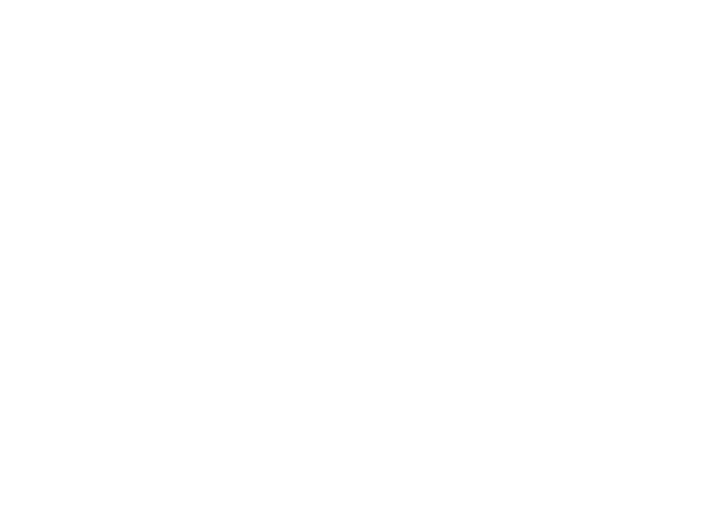

<IPython.core.display.Javascript object>


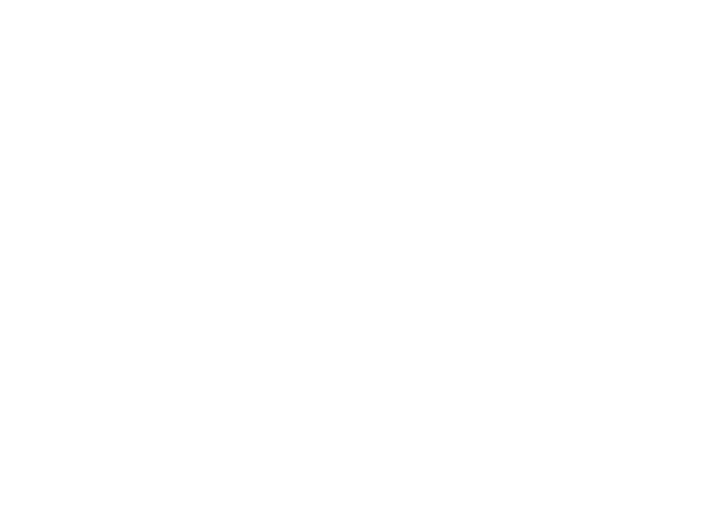

<IPython.core.display.Javascript object>


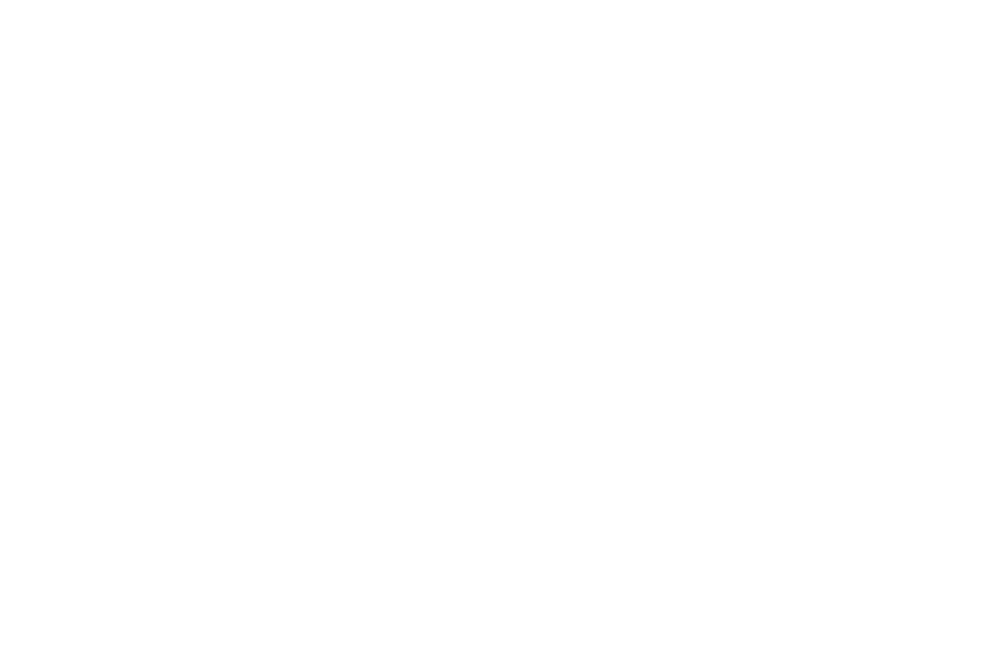

<IPython.core.display.Javascript object>


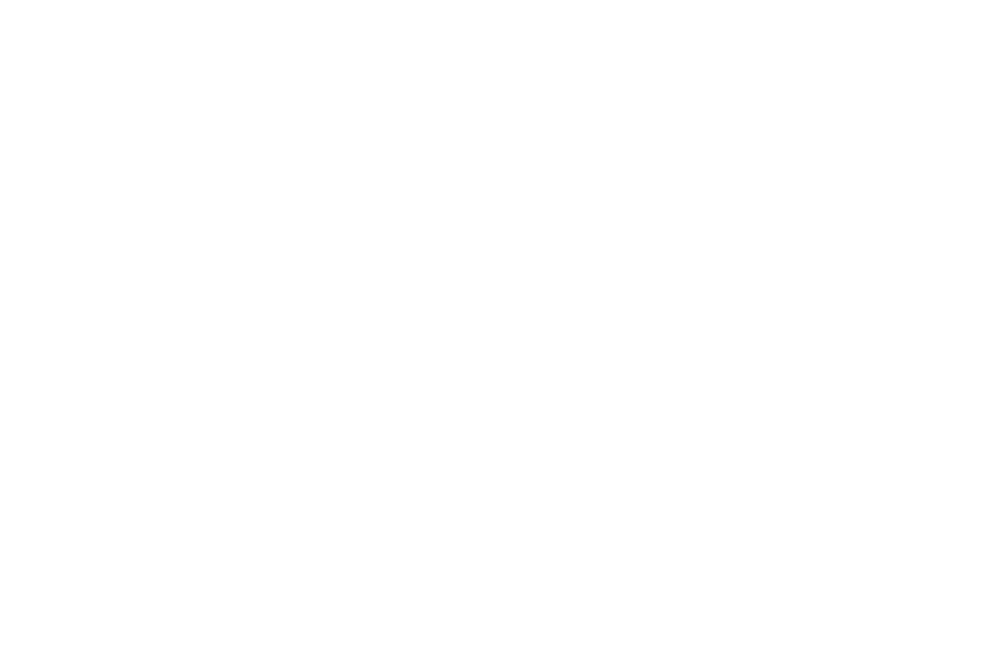

<IPython.core.display.Javascript object>


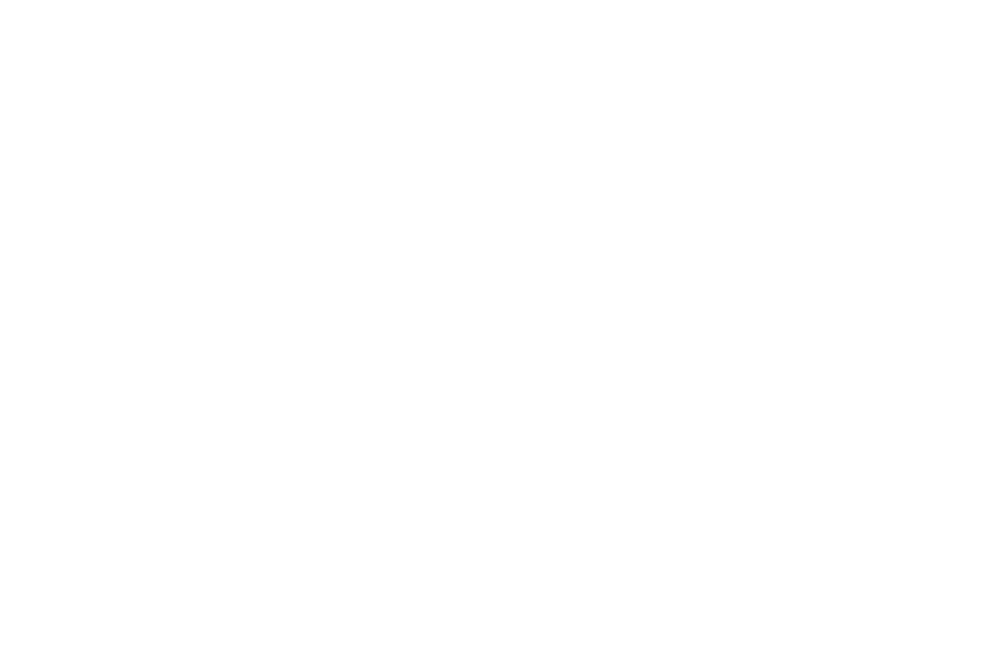

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:40: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


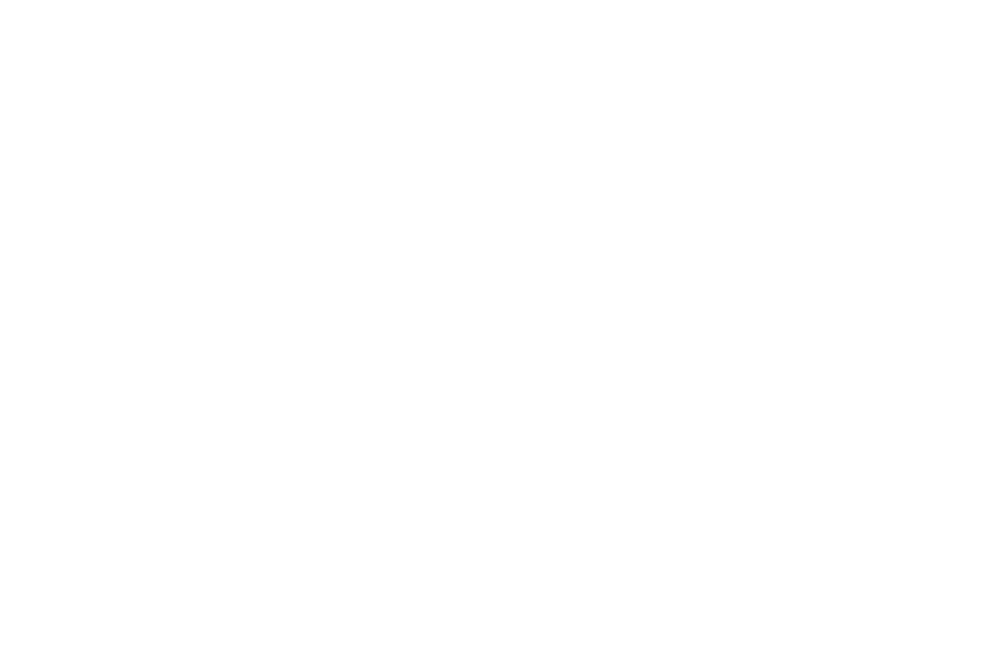

<IPython.core.display.Javascript object>


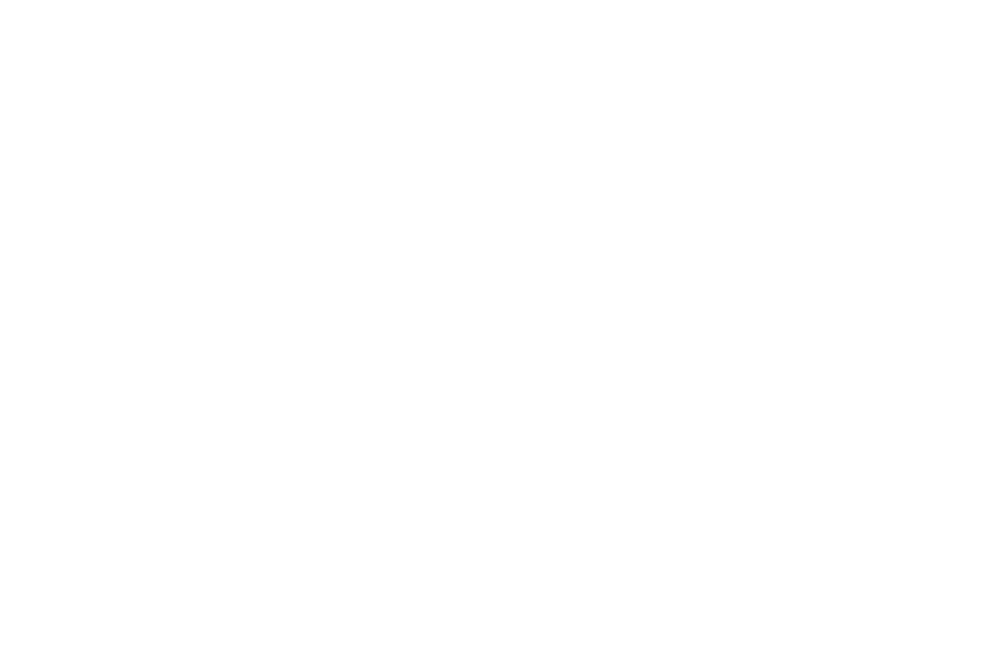

<IPython.core.display.Javascript object>


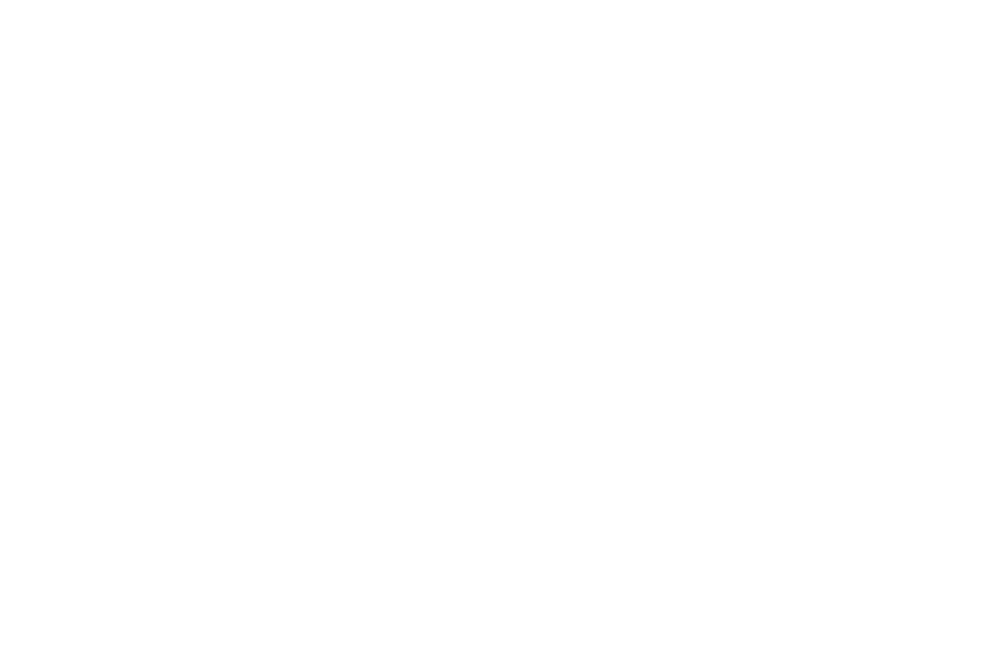

<IPython.core.display.Javascript object>


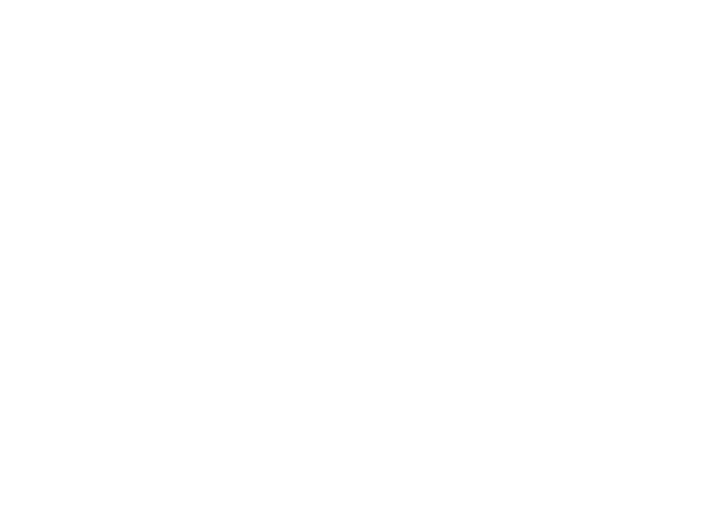

<IPython.core.display.Javascript object>


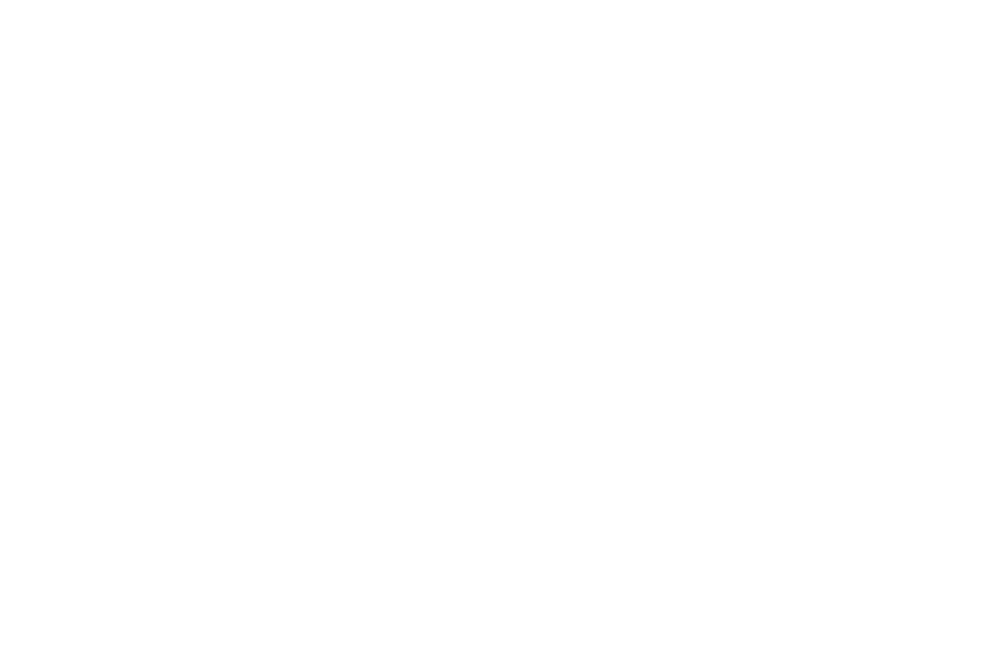

<IPython.core.display.Javascript object>


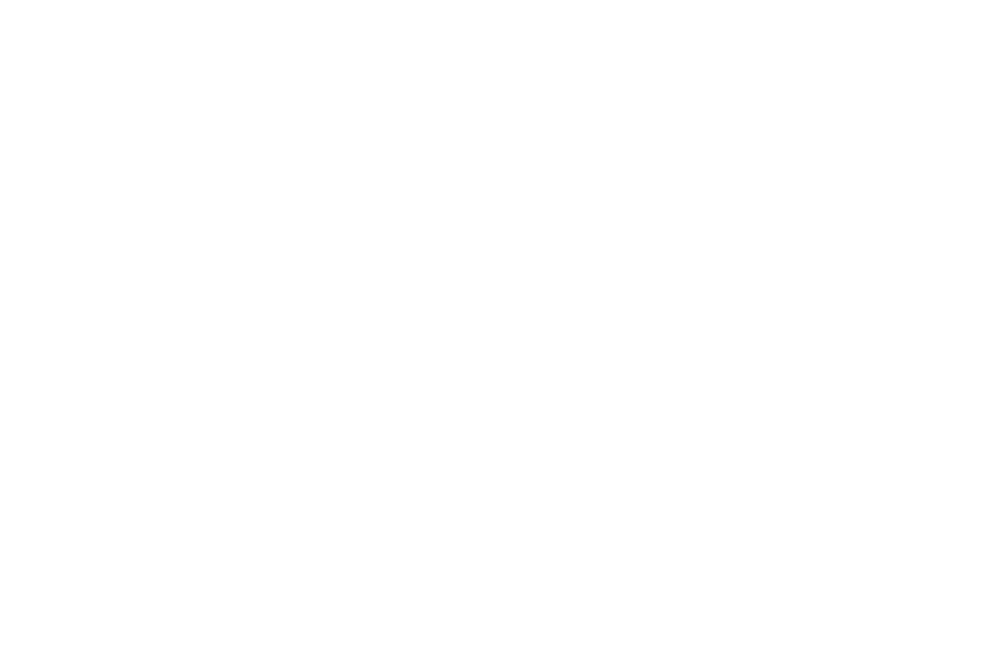

<IPython.core.display.Javascript object>


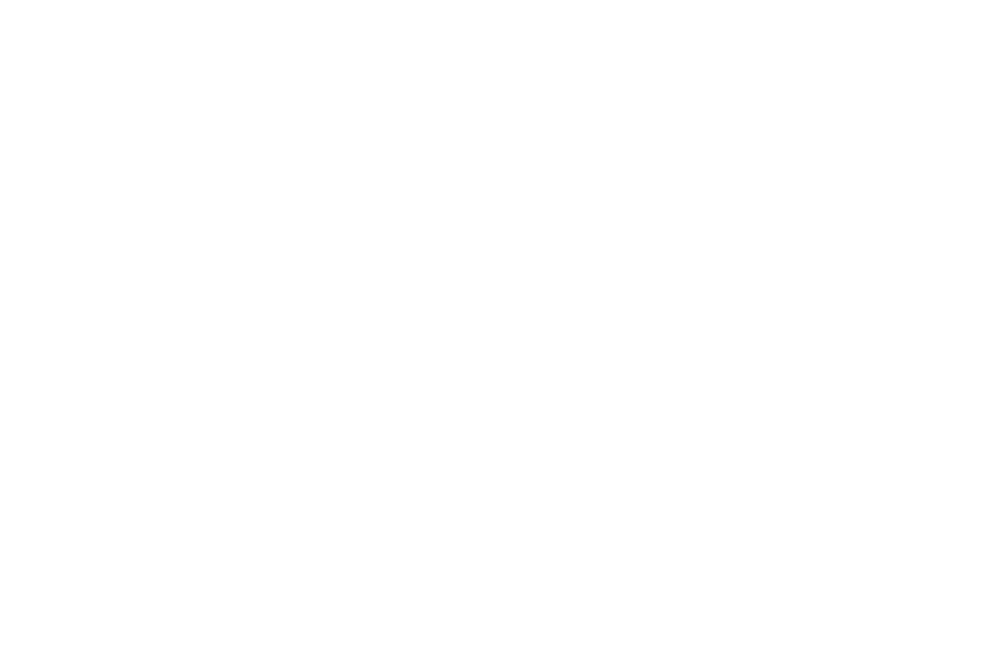

<IPython.core.display.Javascript object>


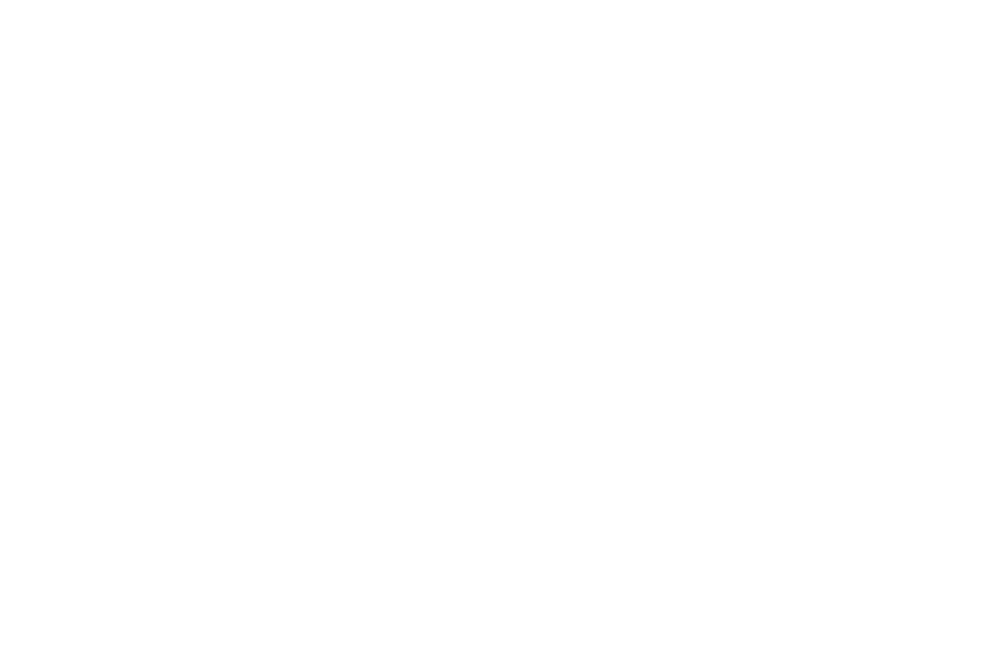

<IPython.core.display.Javascript object>


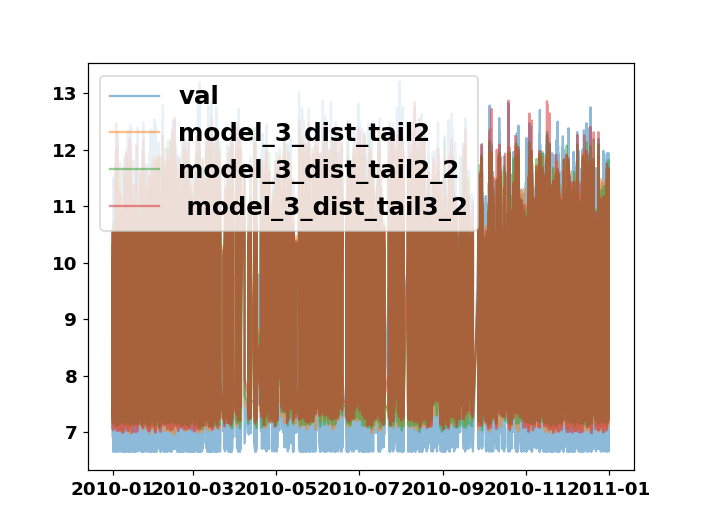

<IPython.core.display.Javascript object>


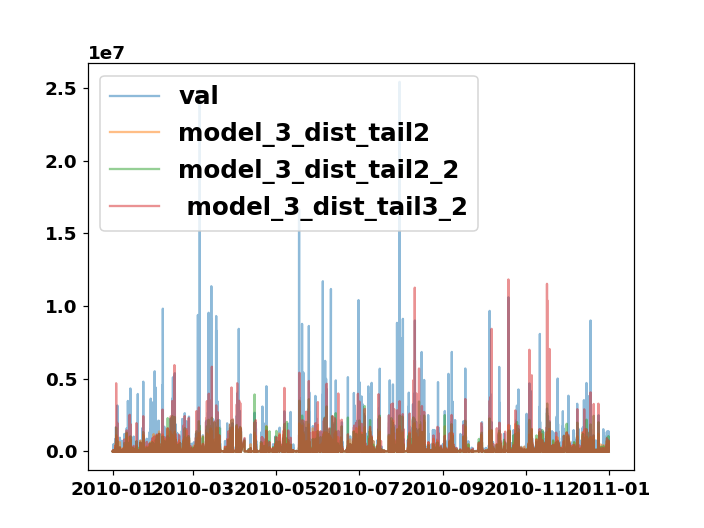

<IPython.core.display.Javascript object>


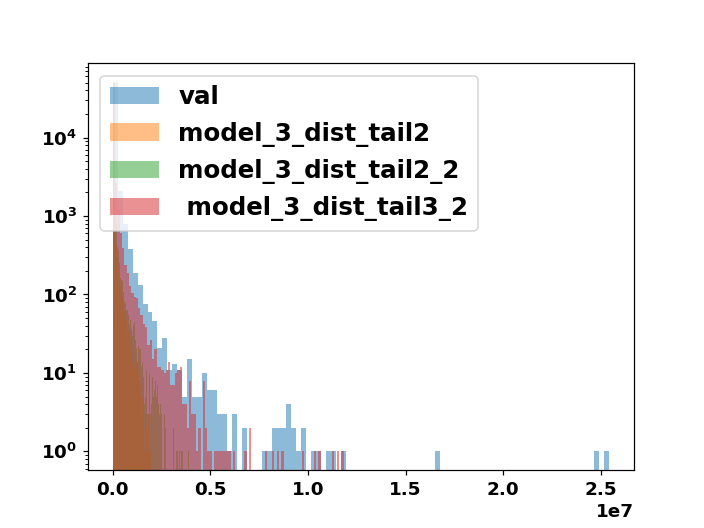

<IPython.core.display.Javascript object>


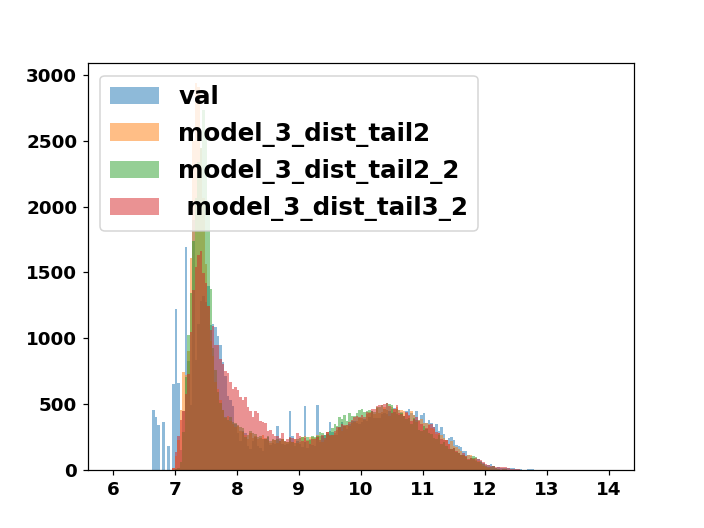

<IPython.core.display.Javascript object>


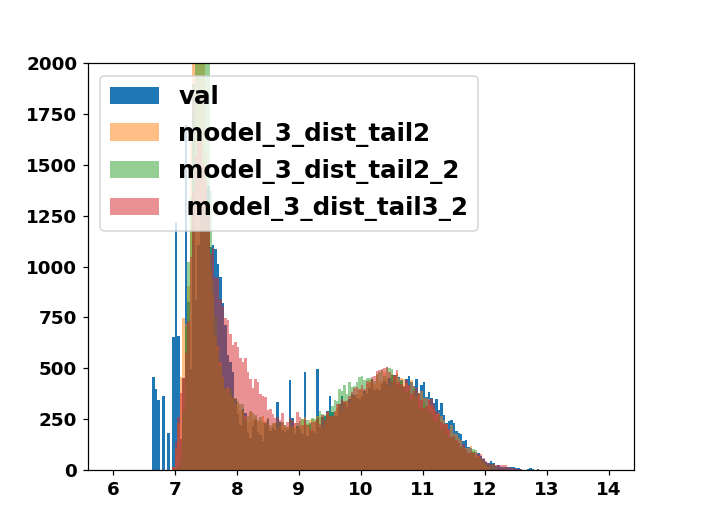

<IPython.core.display.Javascript object>


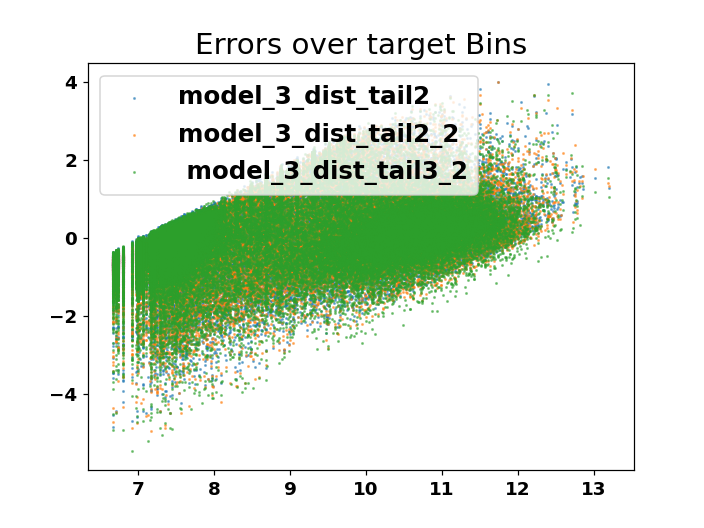

<IPython.core.display.Javascript object>


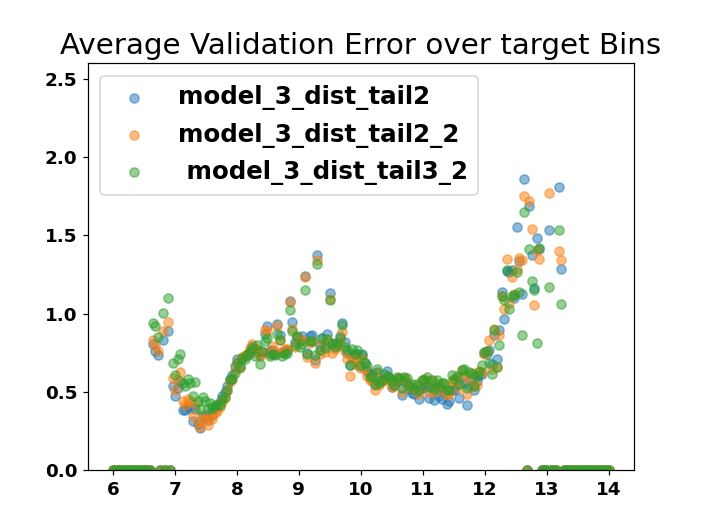

<IPython.core.display.Javascript object>


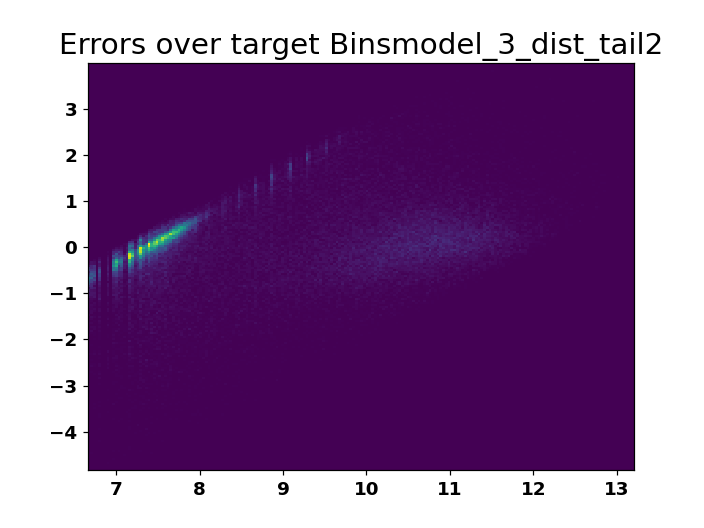

<IPython.core.display.Javascript object>


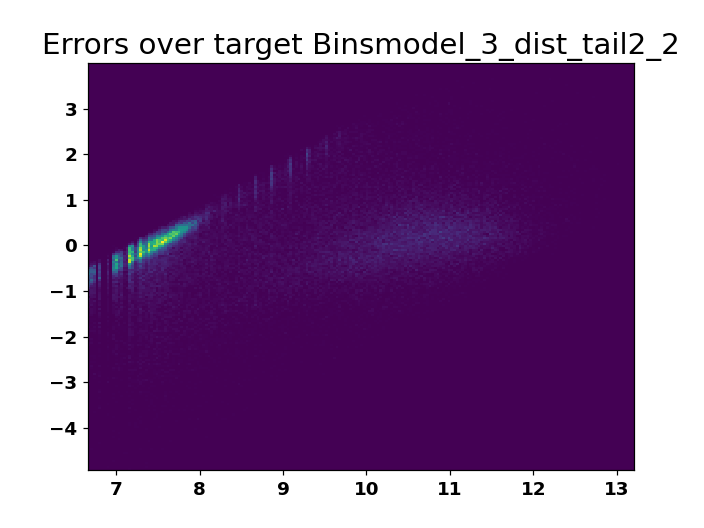

<IPython.core.display.Javascript object>


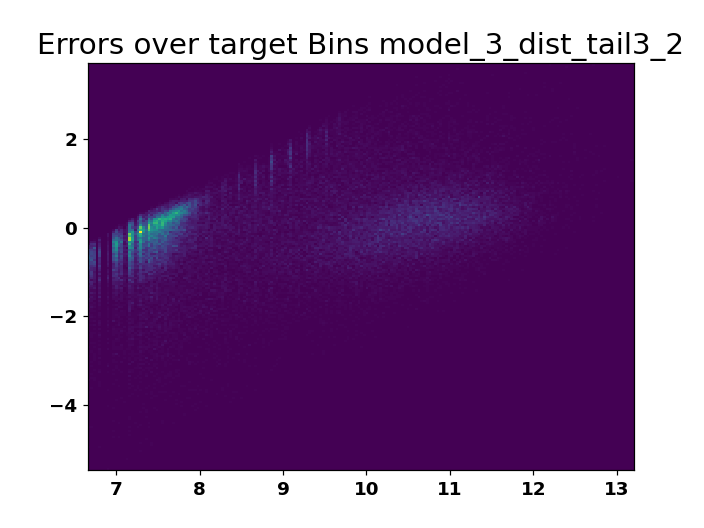

<IPython.core.display.Javascript object>


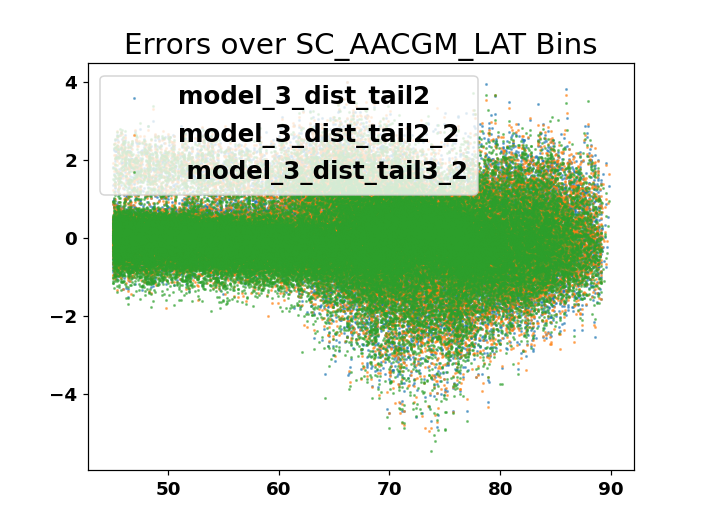

<IPython.core.display.Javascript object>


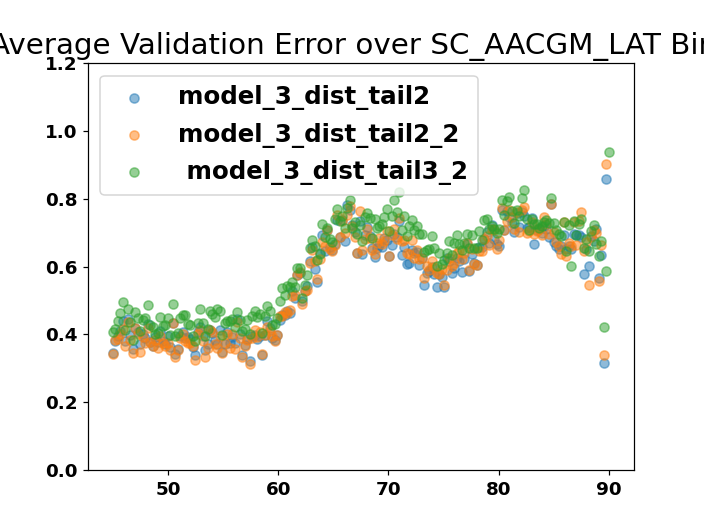

In [109]:
bins = np.linspace(np.min(y_train_log),np.max(y_train_log),200)
hist,bins = np.histogram(y_train_log,bins =bins)
plt.figure()
plt.scatter(bins[1:],hist)
plt.figure()
print(y_train_log.size)
plt.plot(y_train_log.size/(hist+10))
bin_size = bins[1]-bins[0]
y_min = np.min(y_train_log)
sample_weights = np.ones((y_train_log.size))
for i in range(0,y_train_log.size):
    bin_i = int((y_train_log[i]-y_min)/bin_size)
    if bin_i ==199:
        bin_i = 198
    sample_weights[i] = y_train_log.size/(hist[bin_i]+10)
    
plt.figure()
plt.hist(sample_weights,bins=200)
plt.show()

from tensorflow.keras.layers import Input

input1 = Input(shape=(148))
model1 = Dense(256,  activation='relu')(input1)
model1 = model1 = Dropout(0.5)(model1)
model1 = Dense(64, activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(int(256),   activation='relu')(model1)
model1 = Dense(int(1024),  activation='relu')(model1)
model1 = Dense(int(256),  activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(4, activation='relu')(model1)
model1 = Dense(1, activation='linear' )(model1)


output = model1
model = tensorflow.keras.models.Model(inputs=input1, outputs=output)
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',metrics=['mse'])
model.summary()

history = model.fit(X, 
                   y_train_log, 
                    validation_data=(
                        X_test, 
                        y_val_log,                                    ), sample_weight=sample_weights,
                    batch_size=32768,epochs=2000,verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=200)])#


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.ylim([0,.9])
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

results = model.predict(X_test)

df_results = pd.DataFrame(data=results, index = df_val.index)

model_3_dist_tail3_2 = df_results

plot_model(df_results)

plot_model_multiple([model_3_dist_tail2, model_3_dist_tail2_2, model_3_dist_tail3_2],['model_3_dist_tail2', 'model_3_dist_tail2_2',' model_3_dist_tail3_2'],y_val_log)

INFO:tensorflow:Assets written to: model_3_dist_tail3_2/assets


<IPython.core.display.Javascript object>


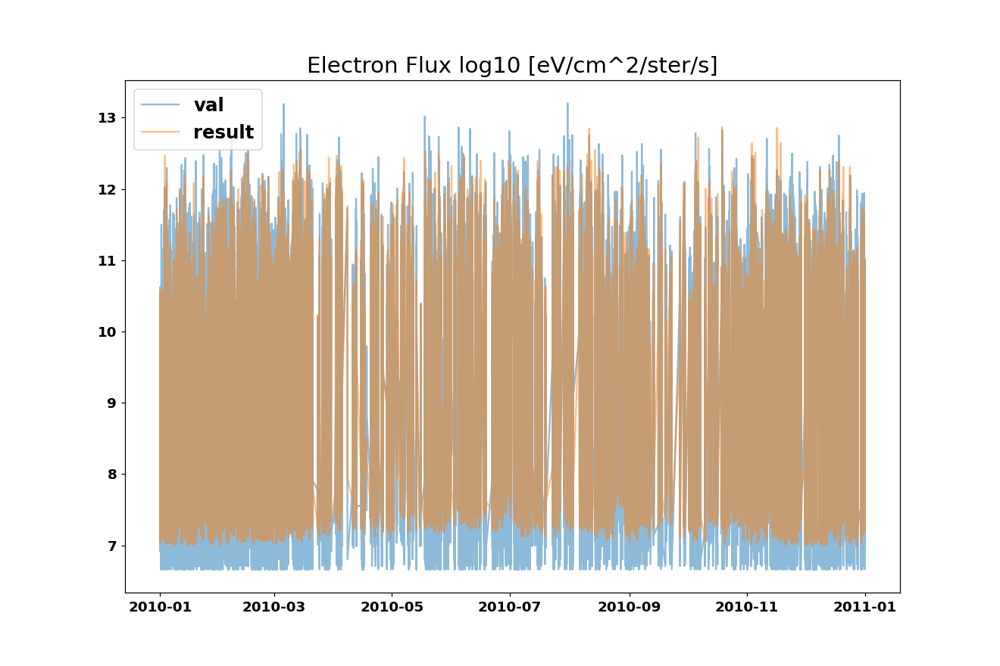

<IPython.core.display.Javascript object>


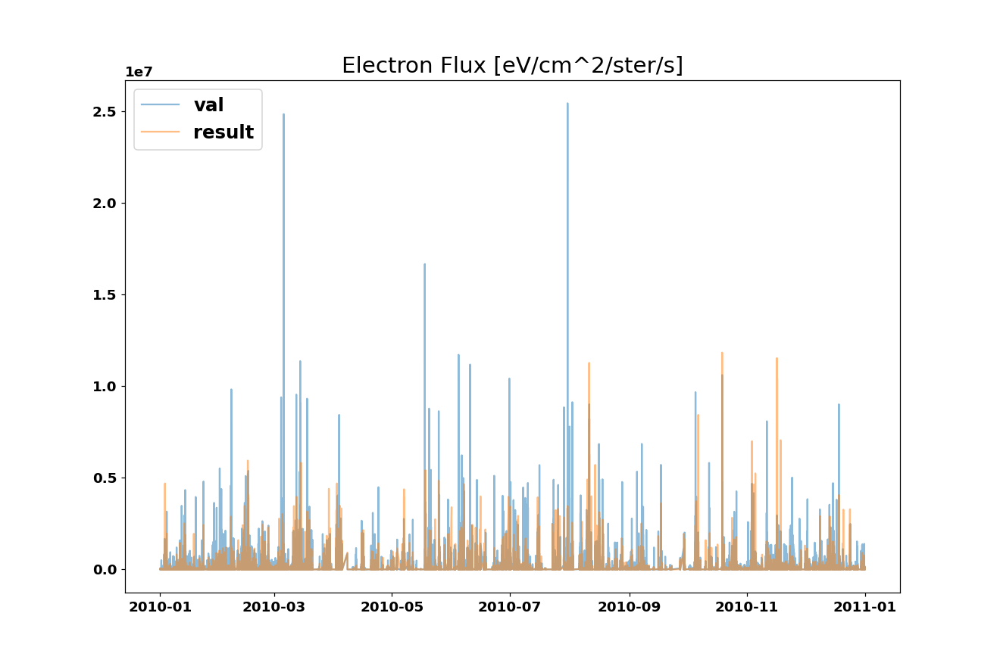

<IPython.core.display.Javascript object>


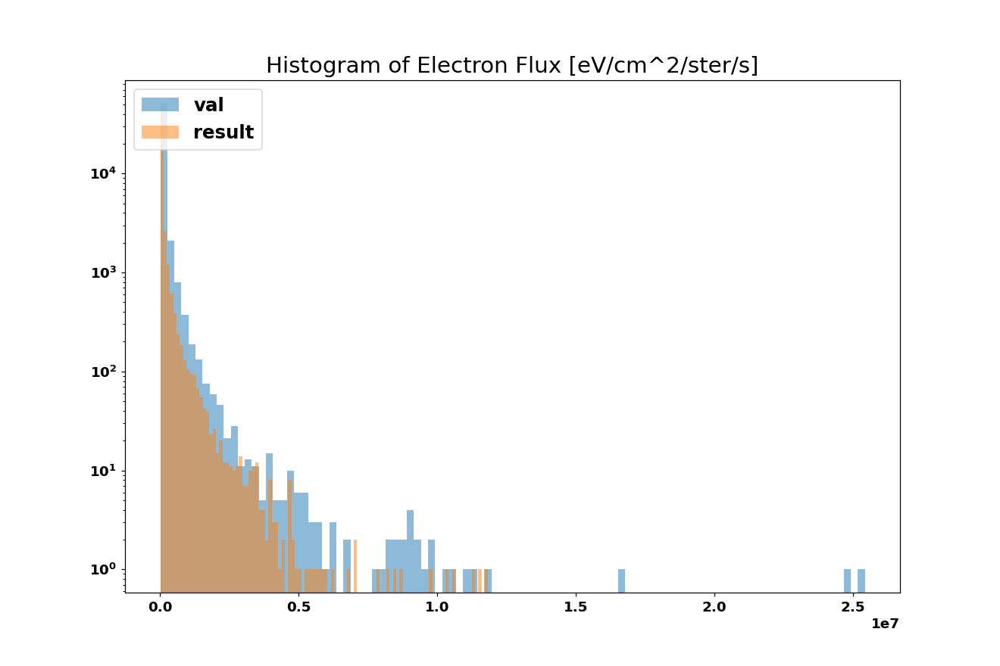

<IPython.core.display.Javascript object>


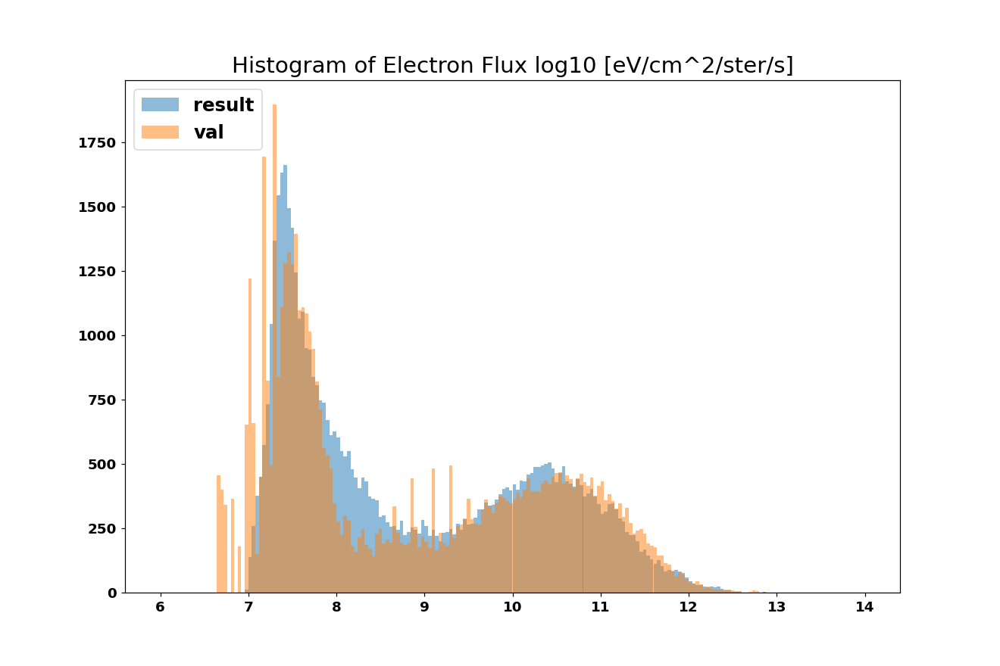

<IPython.core.display.Javascript object>


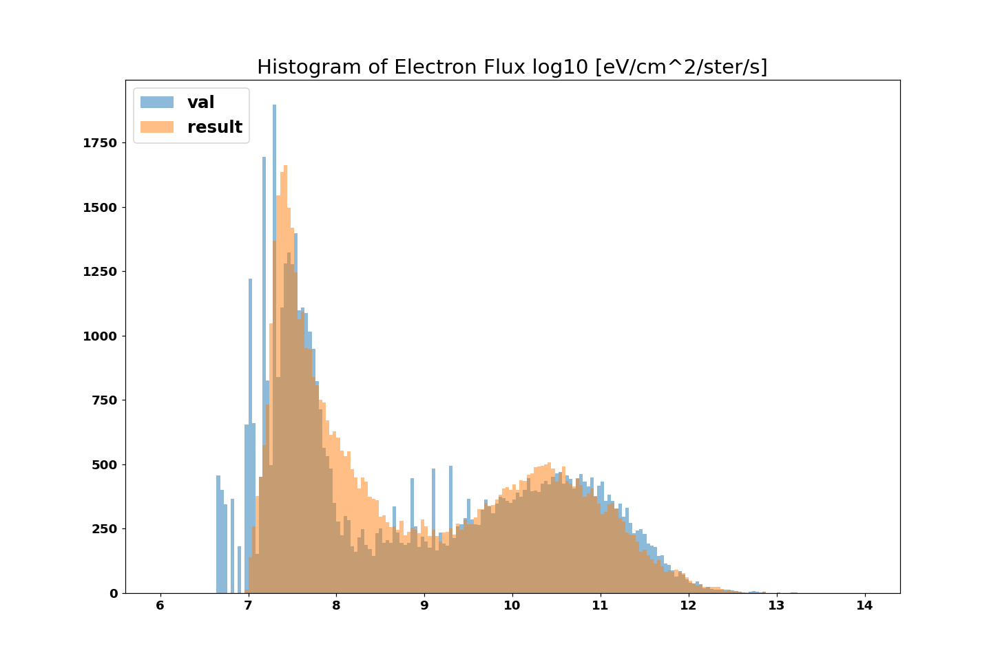

<IPython.core.display.Javascript object>


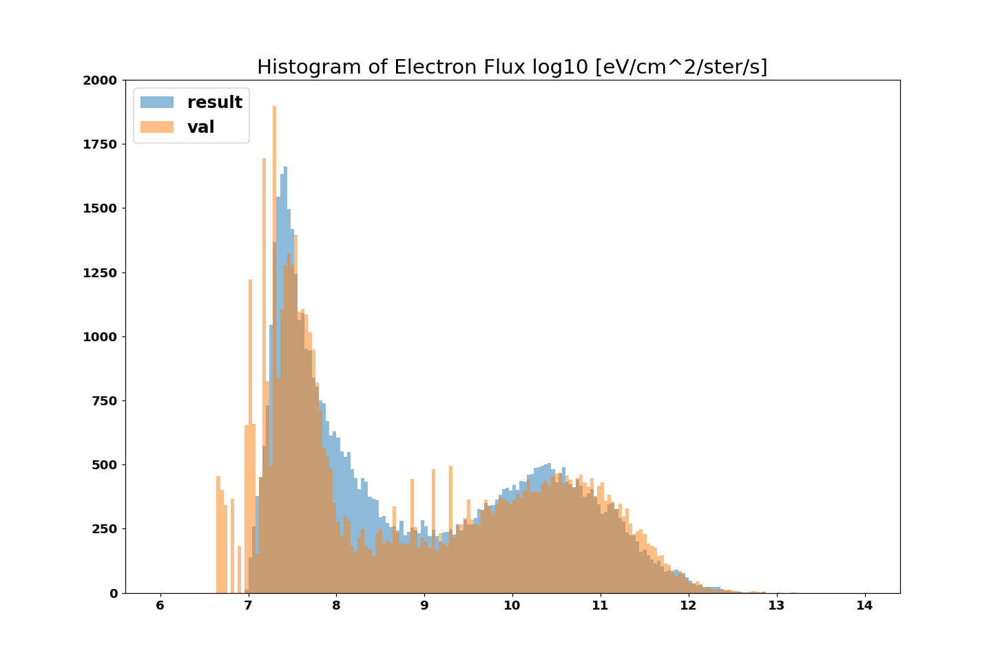

<IPython.core.display.Javascript object>


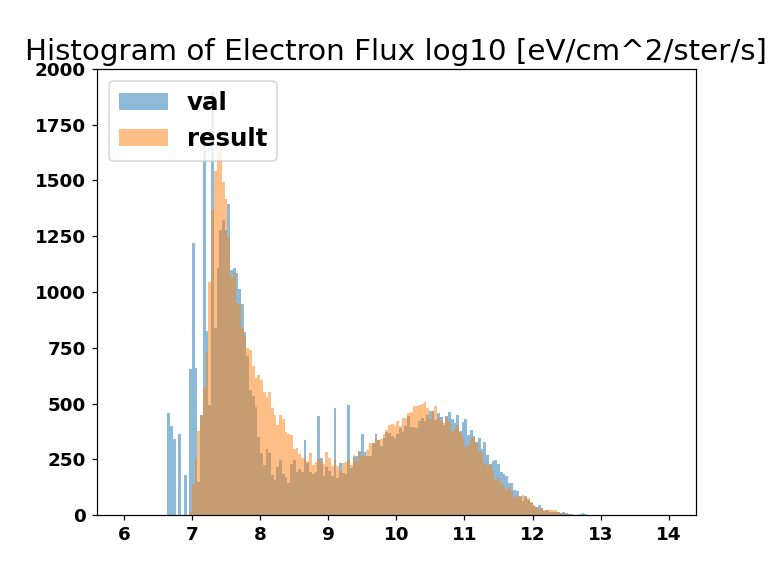

<IPython.core.display.Javascript object>


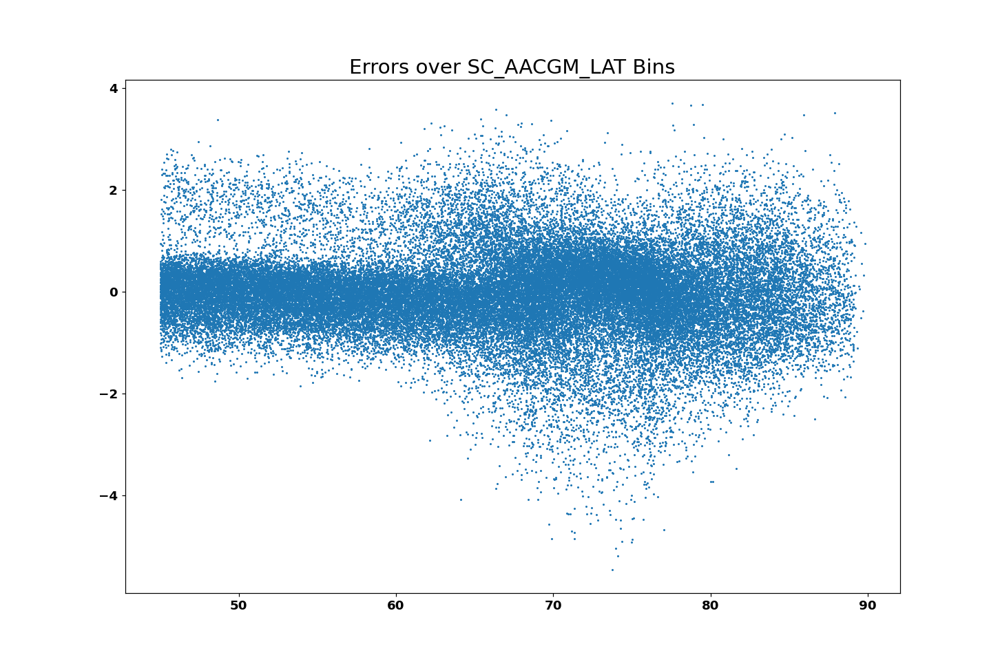

<IPython.core.display.Javascript object>


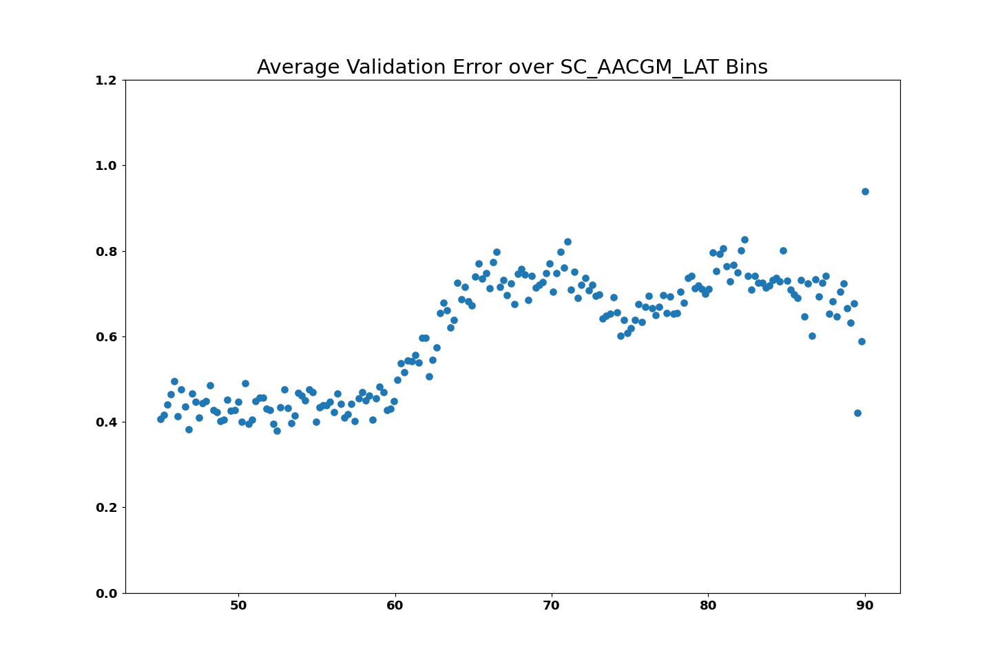

<IPython.core.display.Javascript object>


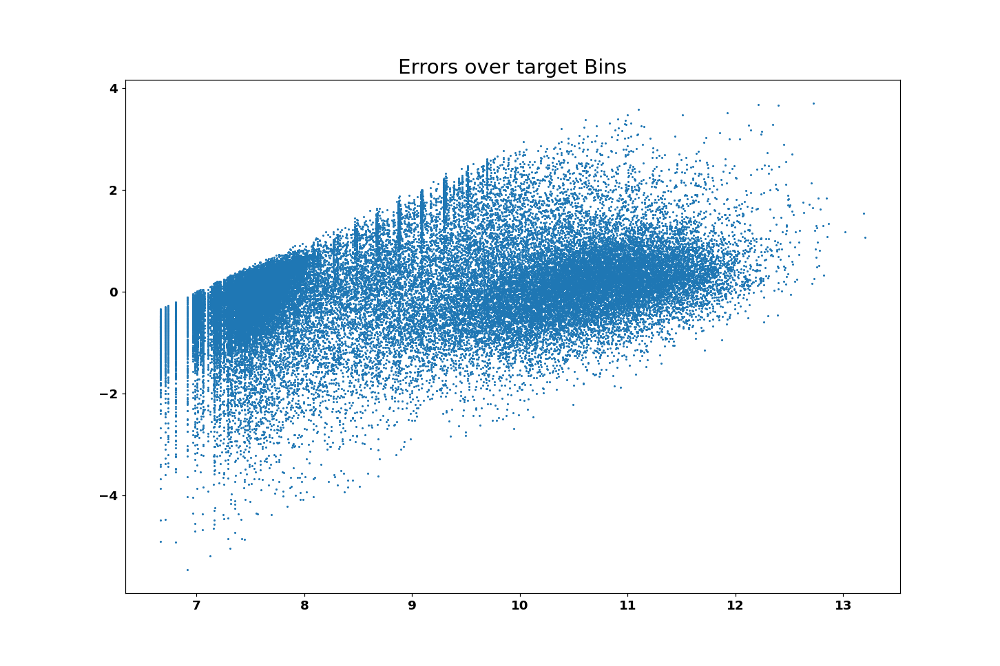

<IPython.core.display.Javascript object>


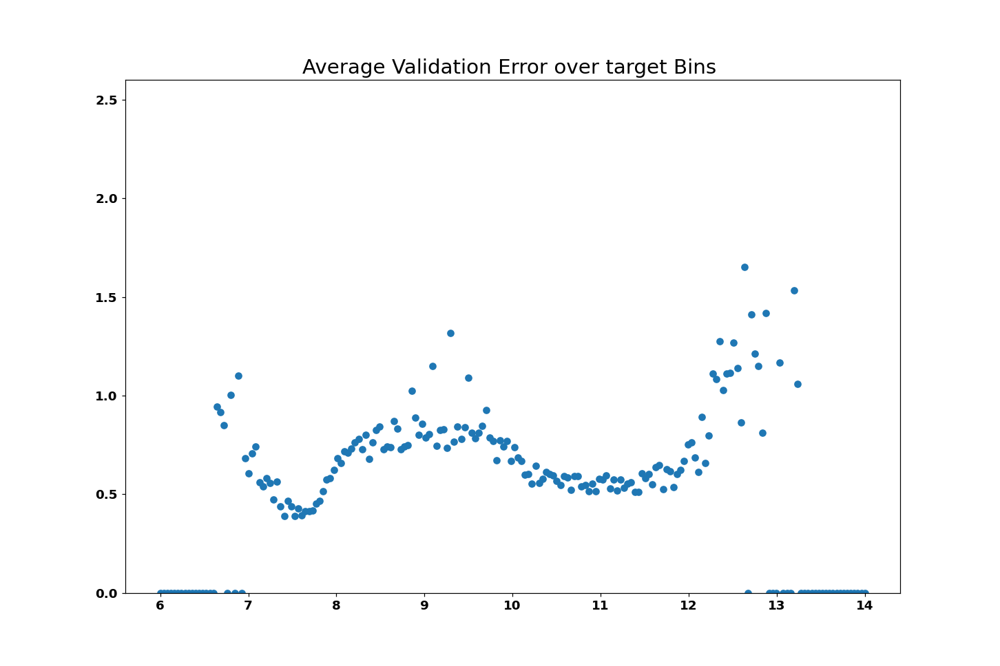

In [111]:
model.save('model_3_dist_tail3_2')
plot_model(df_results)



1838283


KeyboardInterrupt: 

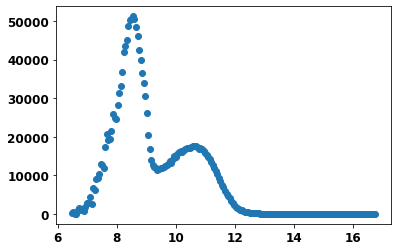

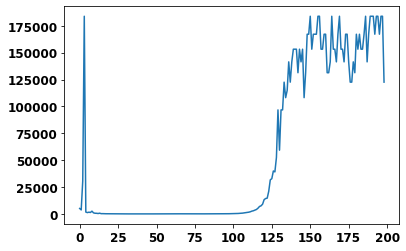

In [19]:
bins = np.linspace(np.min(y_train_log),np.max(y_train_log),200)
hist,bins = np.histogram(y_train_log,bins =bins)
plt.figure()
plt.scatter(bins[1:],hist)
plt.figure()
print(y_train_log.size)
plt.plot(y_train_log.size/(hist+10))
bin_size = bins[1]-bins[0]
y_min = np.min(y_train_log)
sample_weights = np.ones((y_train_log.size))
for i in range(0,y_train_log.size):
    bin_i = int((y_train_log[i]-y_min)/bin_size)
    if bin_i ==199:
        bin_i = 198
#     if bin_i < 20:
#         bin_i = 20
    sample_weights[i] = y_train_log.size/(hist[bin_i]+1)
    
plt.figure()
plt.hist(sample_weights,bins=200)
plt.show()

<IPython.core.display.Javascript object>


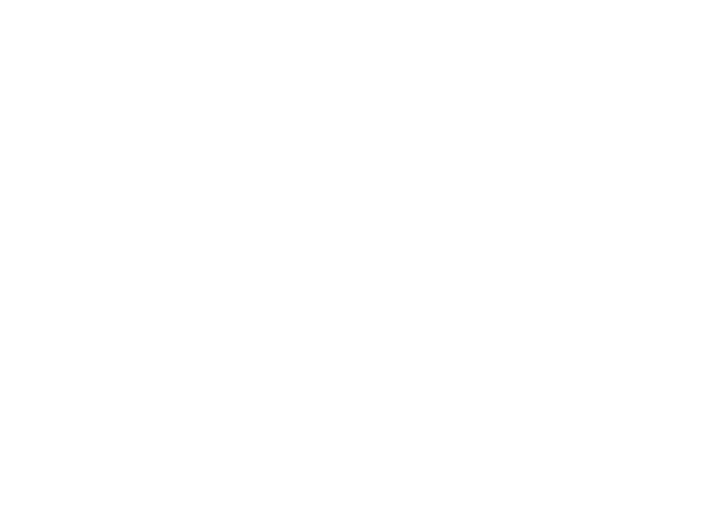

<IPython.core.display.Javascript object>


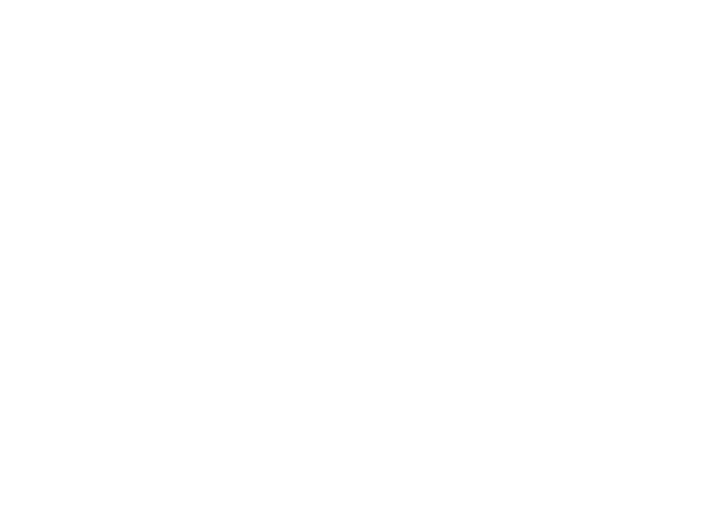

1838283


<IPython.core.display.Javascript object>


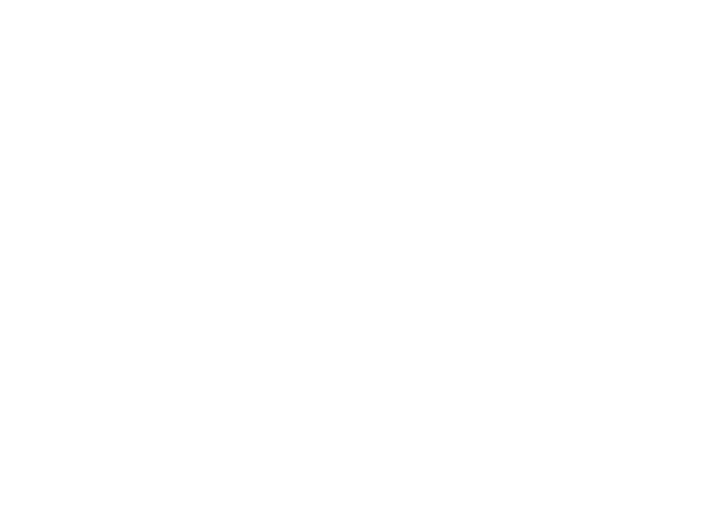

Model: "functional_19"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_10 (InputLayer)        [(None, 148)]             0         
_________________________________________________________________
dense_81 (Dense)             (None, 256)               38144     
_________________________________________________________________
dropout_9 (Dropout)          (None, 256)               0         
_________________________________________________________________
dense_82 (Dense)             (None, 64)                16448     
_________________________________________________________________
dense_83 (Dense)             (None, 32)                2080      
_________________________________________________________________
dense_84 (Dense)             (None, 256)               8448      
_________________________________________________________________
dense_85 (Dense)             (None, 1024)            

Epoch 70/2000
57/57 - 1s - loss: 390.1938 - mse: 2.1398 - val_loss: 1.5711 - val_mse: 1.5711
Epoch 71/2000
57/57 - 1s - loss: 417.9232 - mse: 2.4007 - val_loss: 3.7153 - val_mse: 3.7153
Epoch 72/2000
57/57 - 1s - loss: 516.9685 - mse: 3.0158 - val_loss: 1.1900 - val_mse: 1.1900
Epoch 73/2000
57/57 - 1s - loss: 426.7675 - mse: 2.6146 - val_loss: 1.2013 - val_mse: 1.2013
Epoch 74/2000
57/57 - 1s - loss: 418.3994 - mse: 2.5848 - val_loss: 1.1284 - val_mse: 1.1284
Epoch 75/2000
57/57 - 1s - loss: 386.6388 - mse: 2.2425 - val_loss: 1.1308 - val_mse: 1.1308
Epoch 76/2000
57/57 - 1s - loss: 369.2757 - mse: 2.2317 - val_loss: 1.2073 - val_mse: 1.2073
Epoch 77/2000
57/57 - 1s - loss: 364.1109 - mse: 2.1700 - val_loss: 1.1607 - val_mse: 1.1607
Epoch 78/2000
57/57 - 1s - loss: 365.0297 - mse: 2.1744 - val_loss: 1.3279 - val_mse: 1.3279
Epoch 79/2000
57/57 - 1s - loss: 344.1036 - mse: 2.0706 - val_loss: 1.2912 - val_mse: 1.2912
Epoch 80/2000
57/57 - 1s - loss: 421.9419 - mse: 2.3522 - val_loss: 1.

Epoch 158/2000
57/57 - 1s - loss: 238.8980 - mse: 1.4441 - val_loss: 1.0241 - val_mse: 1.0241
Epoch 159/2000
57/57 - 1s - loss: 233.5466 - mse: 1.3918 - val_loss: 0.8873 - val_mse: 0.8873
Epoch 160/2000
57/57 - 1s - loss: 273.6803 - mse: 1.5502 - val_loss: 1.1227 - val_mse: 1.1227
Epoch 161/2000
57/57 - 1s - loss: 235.0552 - mse: 1.4829 - val_loss: 0.9651 - val_mse: 0.9651
Epoch 162/2000
57/57 - 1s - loss: 245.2994 - mse: 1.4642 - val_loss: 0.8953 - val_mse: 0.8953
Epoch 163/2000
57/57 - 1s - loss: 260.0140 - mse: 1.4475 - val_loss: 0.9378 - val_mse: 0.9378
Epoch 164/2000
57/57 - 1s - loss: 260.5887 - mse: 1.6500 - val_loss: 0.9623 - val_mse: 0.9623
Epoch 165/2000
57/57 - 1s - loss: 236.0216 - mse: 1.3940 - val_loss: 0.9406 - val_mse: 0.9406
Epoch 166/2000
57/57 - 1s - loss: 265.1301 - mse: 1.5619 - val_loss: 0.9664 - val_mse: 0.9664
Epoch 167/2000
57/57 - 1s - loss: 236.5101 - mse: 1.4920 - val_loss: 0.8819 - val_mse: 0.8819
Epoch 168/2000
57/57 - 1s - loss: 242.9075 - mse: 1.5058 - v

57/57 - 1s - loss: 221.1054 - mse: 1.3278 - val_loss: 1.0757 - val_mse: 1.0757
Epoch 246/2000
57/57 - 1s - loss: 222.7627 - mse: 1.3007 - val_loss: 0.8574 - val_mse: 0.8574
Epoch 247/2000
57/57 - 1s - loss: 220.4300 - mse: 1.2761 - val_loss: 0.8723 - val_mse: 0.8723
Epoch 248/2000
57/57 - 1s - loss: 204.6666 - mse: 1.2857 - val_loss: 0.8616 - val_mse: 0.8616
Epoch 249/2000
57/57 - 1s - loss: 195.6428 - mse: 1.2243 - val_loss: 0.9366 - val_mse: 0.9366
Epoch 250/2000
57/57 - 1s - loss: 198.3106 - mse: 1.2220 - val_loss: 0.8753 - val_mse: 0.8753
Epoch 251/2000
57/57 - 1s - loss: 217.1044 - mse: 1.2562 - val_loss: 0.9472 - val_mse: 0.9472
Epoch 252/2000
57/57 - 1s - loss: 205.9859 - mse: 1.2528 - val_loss: 0.8766 - val_mse: 0.8766
Epoch 253/2000
57/57 - 1s - loss: 221.4810 - mse: 1.3301 - val_loss: 1.0030 - val_mse: 1.0030
Epoch 254/2000
57/57 - 1s - loss: 221.6597 - mse: 1.3965 - val_loss: 0.9015 - val_mse: 0.9015
Epoch 255/2000
57/57 - 1s - loss: 203.2833 - mse: 1.2525 - val_loss: 0.9840

Epoch 333/2000
57/57 - 1s - loss: 189.4084 - mse: 1.1487 - val_loss: 0.8878 - val_mse: 0.8878
Epoch 334/2000
57/57 - 1s - loss: 206.6956 - mse: 1.1779 - val_loss: 0.9257 - val_mse: 0.9257
Epoch 335/2000
57/57 - 1s - loss: 186.9204 - mse: 1.1668 - val_loss: 0.9019 - val_mse: 0.9019
Epoch 336/2000
57/57 - 1s - loss: 176.7082 - mse: 1.1123 - val_loss: 0.8253 - val_mse: 0.8253
Epoch 337/2000
57/57 - 1s - loss: 193.5814 - mse: 1.1564 - val_loss: 0.8803 - val_mse: 0.8803
Epoch 338/2000
57/57 - 1s - loss: 213.9808 - mse: 1.2275 - val_loss: 0.9056 - val_mse: 0.9056
Epoch 339/2000
57/57 - 1s - loss: 189.3230 - mse: 1.1589 - val_loss: 1.0519 - val_mse: 1.0519
Epoch 340/2000
57/57 - 2s - loss: 189.0877 - mse: 1.1816 - val_loss: 0.8342 - val_mse: 0.8342
Epoch 341/2000
57/57 - 1s - loss: 181.8122 - mse: 1.1328 - val_loss: 0.8643 - val_mse: 0.8643
Epoch 342/2000
57/57 - 1s - loss: 195.5522 - mse: 1.2137 - val_loss: 0.9746 - val_mse: 0.9746
Epoch 343/2000
57/57 - 1s - loss: 219.4193 - mse: 1.2925 - v

57/57 - 1s - loss: 181.7650 - mse: 1.1221 - val_loss: 1.0022 - val_mse: 1.0022
Epoch 421/2000
57/57 - 1s - loss: 187.4141 - mse: 1.2105 - val_loss: 0.8188 - val_mse: 0.8188
Epoch 422/2000
57/57 - 1s - loss: 190.5289 - mse: 1.1271 - val_loss: 0.9071 - val_mse: 0.9071
Epoch 423/2000
57/57 - 1s - loss: 183.1507 - mse: 1.1253 - val_loss: 0.9296 - val_mse: 0.9296
Epoch 424/2000
57/57 - 1s - loss: 170.3210 - mse: 1.0905 - val_loss: 0.8145 - val_mse: 0.8145
Epoch 425/2000
57/57 - 1s - loss: 168.5285 - mse: 1.0710 - val_loss: 0.9278 - val_mse: 0.9278
Epoch 426/2000
57/57 - 1s - loss: 164.7067 - mse: 1.0345 - val_loss: 0.9184 - val_mse: 0.9184
Epoch 427/2000
57/57 - 1s - loss: 188.7982 - mse: 1.1137 - val_loss: 0.9745 - val_mse: 0.9745
Epoch 428/2000
57/57 - 1s - loss: 180.5263 - mse: 1.1329 - val_loss: 0.8190 - val_mse: 0.8190
Epoch 429/2000
57/57 - 1s - loss: 204.0732 - mse: 1.1685 - val_loss: 1.0642 - val_mse: 1.0642
Epoch 430/2000
57/57 - 1s - loss: 177.2282 - mse: 1.1083 - val_loss: 0.8914

Epoch 508/2000
57/57 - 1s - loss: 183.4654 - mse: 1.1033 - val_loss: 0.8089 - val_mse: 0.8089
Epoch 509/2000
57/57 - 1s - loss: 170.3025 - mse: 1.0656 - val_loss: 0.7886 - val_mse: 0.7886
Epoch 510/2000
57/57 - 1s - loss: 166.8811 - mse: 1.0505 - val_loss: 0.8040 - val_mse: 0.8040
Epoch 511/2000
57/57 - 1s - loss: 192.0134 - mse: 1.1809 - val_loss: 0.8344 - val_mse: 0.8344
Epoch 512/2000
57/57 - 1s - loss: 169.8110 - mse: 1.0563 - val_loss: 0.8527 - val_mse: 0.8527
Epoch 513/2000
57/57 - 1s - loss: 168.2454 - mse: 1.0501 - val_loss: 0.7982 - val_mse: 0.7982
Epoch 514/2000
57/57 - 1s - loss: 162.4103 - mse: 1.0126 - val_loss: 0.8477 - val_mse: 0.8477
Epoch 515/2000
57/57 - 1s - loss: 166.7322 - mse: 1.0337 - val_loss: 0.7973 - val_mse: 0.7973
Epoch 516/2000
57/57 - 1s - loss: 174.4375 - mse: 1.0652 - val_loss: 0.8090 - val_mse: 0.8090
Epoch 517/2000
57/57 - 1s - loss: 172.0230 - mse: 1.0505 - val_loss: 0.8342 - val_mse: 0.8342
Epoch 518/2000
57/57 - 1s - loss: 171.5739 - mse: 1.0380 - v

57/57 - 1s - loss: 160.5838 - mse: 0.9912 - val_loss: 0.9951 - val_mse: 0.9951
Epoch 596/2000
57/57 - 1s - loss: 166.2163 - mse: 1.0652 - val_loss: 0.8793 - val_mse: 0.8793
Epoch 597/2000
57/57 - 1s - loss: 163.7804 - mse: 1.0310 - val_loss: 0.8308 - val_mse: 0.8308
Epoch 598/2000
57/57 - 1s - loss: 188.7363 - mse: 1.0602 - val_loss: 0.8156 - val_mse: 0.8156
Epoch 599/2000
57/57 - 1s - loss: 172.7991 - mse: 1.0738 - val_loss: 0.8698 - val_mse: 0.8698
Epoch 600/2000
57/57 - 1s - loss: 216.7013 - mse: 1.0839 - val_loss: 1.0619 - val_mse: 1.0619
Epoch 601/2000
57/57 - 1s - loss: 189.9462 - mse: 1.1166 - val_loss: 0.8212 - val_mse: 0.8212
Epoch 602/2000
57/57 - 1s - loss: 180.7534 - mse: 1.1130 - val_loss: 0.8680 - val_mse: 0.8680
Epoch 603/2000
57/57 - 1s - loss: 166.7652 - mse: 1.0638 - val_loss: 0.8529 - val_mse: 0.8529
Epoch 604/2000
57/57 - 1s - loss: 165.6358 - mse: 1.0483 - val_loss: 0.8858 - val_mse: 0.8858
Epoch 605/2000
57/57 - 1s - loss: 163.6053 - mse: 1.0311 - val_loss: 0.9687

Epoch 683/2000
57/57 - 1s - loss: 168.1162 - mse: 1.0326 - val_loss: 0.8004 - val_mse: 0.8004
Epoch 684/2000
57/57 - 1s - loss: 197.7712 - mse: 1.0611 - val_loss: 0.8066 - val_mse: 0.8066
Epoch 685/2000
57/57 - 1s - loss: 181.3732 - mse: 1.0277 - val_loss: 0.8087 - val_mse: 0.8087
Epoch 686/2000
57/57 - 1s - loss: 194.0945 - mse: 1.0279 - val_loss: 0.8348 - val_mse: 0.8348
Epoch 687/2000
57/57 - 1s - loss: 193.4098 - mse: 1.0477 - val_loss: 0.8214 - val_mse: 0.8214
Epoch 688/2000
57/57 - 1s - loss: 169.9568 - mse: 1.0295 - val_loss: 1.1380 - val_mse: 1.1380
Epoch 689/2000
57/57 - 1s - loss: 207.3714 - mse: 1.2431 - val_loss: 0.8713 - val_mse: 0.8713
Epoch 690/2000
57/57 - 1s - loss: 190.9960 - mse: 1.1016 - val_loss: 0.8097 - val_mse: 0.8097
Epoch 691/2000
57/57 - 1s - loss: 197.0396 - mse: 1.1258 - val_loss: 1.0910 - val_mse: 1.0910
Epoch 692/2000
57/57 - 1s - loss: 208.7388 - mse: 1.2050 - val_loss: 0.8453 - val_mse: 0.8453
Epoch 693/2000
57/57 - 1s - loss: 179.5751 - mse: 1.0449 - v

57/57 - 1s - loss: 150.1820 - mse: 0.9471 - val_loss: 0.8057 - val_mse: 0.8057
Epoch 771/2000
57/57 - 1s - loss: 149.4393 - mse: 0.9322 - val_loss: 0.8479 - val_mse: 0.8479
Epoch 772/2000
57/57 - 1s - loss: 165.6143 - mse: 0.9844 - val_loss: 0.8432 - val_mse: 0.8432
Epoch 773/2000
57/57 - 1s - loss: 163.0850 - mse: 0.9660 - val_loss: 0.8204 - val_mse: 0.8204
Epoch 774/2000
57/57 - 1s - loss: 158.3527 - mse: 0.9648 - val_loss: 0.8164 - val_mse: 0.8164
Epoch 775/2000
57/57 - 1s - loss: 172.7587 - mse: 1.0134 - val_loss: 0.8474 - val_mse: 0.8474
Epoch 776/2000
57/57 - 1s - loss: 170.5693 - mse: 1.0250 - val_loss: 0.8188 - val_mse: 0.8188
Epoch 777/2000
57/57 - 1s - loss: 177.5242 - mse: 1.0195 - val_loss: 1.0346 - val_mse: 1.0346
Epoch 778/2000
57/57 - 1s - loss: 180.8143 - mse: 1.0957 - val_loss: 0.8757 - val_mse: 0.8757
Epoch 779/2000
57/57 - 1s - loss: 164.4118 - mse: 0.9809 - val_loss: 0.8573 - val_mse: 0.8573
Epoch 780/2000
57/57 - 1s - loss: 166.7369 - mse: 0.9678 - val_loss: 0.8593

Epoch 858/2000
57/57 - 1s - loss: 155.5840 - mse: 0.9738 - val_loss: 0.7795 - val_mse: 0.7795
Epoch 859/2000
57/57 - 1s - loss: 184.4298 - mse: 0.9848 - val_loss: 0.8032 - val_mse: 0.8032
Epoch 860/2000
57/57 - 1s - loss: 173.3239 - mse: 1.0333 - val_loss: 0.8769 - val_mse: 0.8769
Epoch 861/2000
57/57 - 1s - loss: 204.1442 - mse: 1.0553 - val_loss: 0.8262 - val_mse: 0.8262
Epoch 862/2000
57/57 - 1s - loss: 192.0588 - mse: 1.0245 - val_loss: 0.8531 - val_mse: 0.8531
Epoch 863/2000
57/57 - 1s - loss: 180.2686 - mse: 1.0142 - val_loss: 0.8349 - val_mse: 0.8349
Epoch 864/2000
57/57 - 1s - loss: 186.7378 - mse: 1.0241 - val_loss: 0.8883 - val_mse: 0.8883
Epoch 865/2000
57/57 - 1s - loss: 165.8885 - mse: 1.0132 - val_loss: 0.8072 - val_mse: 0.8072
Epoch 866/2000
57/57 - 1s - loss: 166.6738 - mse: 1.0134 - val_loss: 0.8159 - val_mse: 0.8159
Epoch 867/2000
57/57 - 1s - loss: 157.0381 - mse: 0.9947 - val_loss: 0.8644 - val_mse: 0.8644
Epoch 868/2000
57/57 - 1s - loss: 148.7879 - mse: 0.9533 - v

57/57 - 1s - loss: 148.9194 - mse: 0.9507 - val_loss: 0.7854 - val_mse: 0.7854
Epoch 946/2000
57/57 - 1s - loss: 147.4026 - mse: 0.9276 - val_loss: 0.8163 - val_mse: 0.8163
Epoch 947/2000
57/57 - 1s - loss: 153.5056 - mse: 0.9328 - val_loss: 0.7824 - val_mse: 0.7824
Epoch 948/2000
57/57 - 1s - loss: 157.0979 - mse: 0.9666 - val_loss: 0.8315 - val_mse: 0.8315
Epoch 949/2000
57/57 - 1s - loss: 146.9396 - mse: 0.9455 - val_loss: 0.8059 - val_mse: 0.8059
Epoch 950/2000
57/57 - 1s - loss: 146.4710 - mse: 0.9219 - val_loss: 0.8104 - val_mse: 0.8104
Epoch 951/2000
57/57 - 1s - loss: 153.4171 - mse: 0.9492 - val_loss: 0.7968 - val_mse: 0.7968
Epoch 952/2000
57/57 - 1s - loss: 160.7728 - mse: 0.9518 - val_loss: 0.8233 - val_mse: 0.8233
Epoch 953/2000
57/57 - 1s - loss: 150.0374 - mse: 0.9329 - val_loss: 0.8197 - val_mse: 0.8197
Epoch 954/2000
57/57 - 1s - loss: 168.8874 - mse: 0.9308 - val_loss: 0.8840 - val_mse: 0.8840


<IPython.core.display.Javascript object>


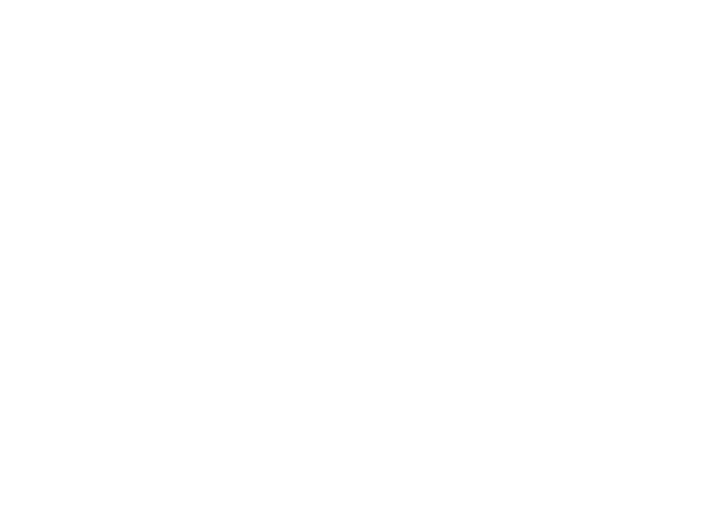

<IPython.core.display.Javascript object>


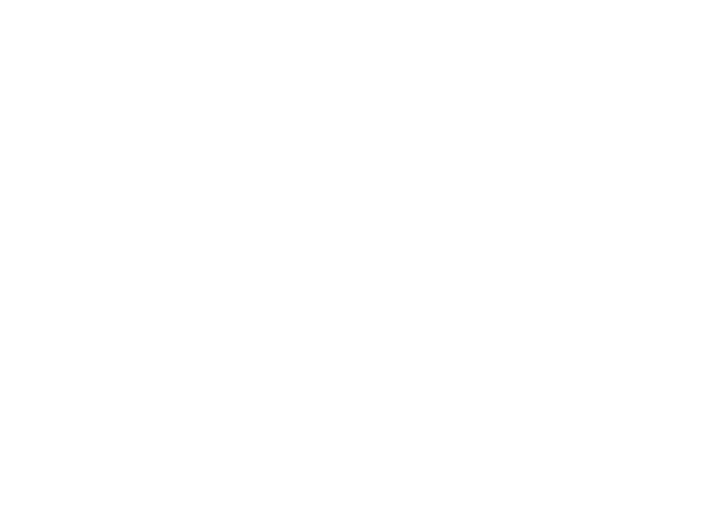

<IPython.core.display.Javascript object>


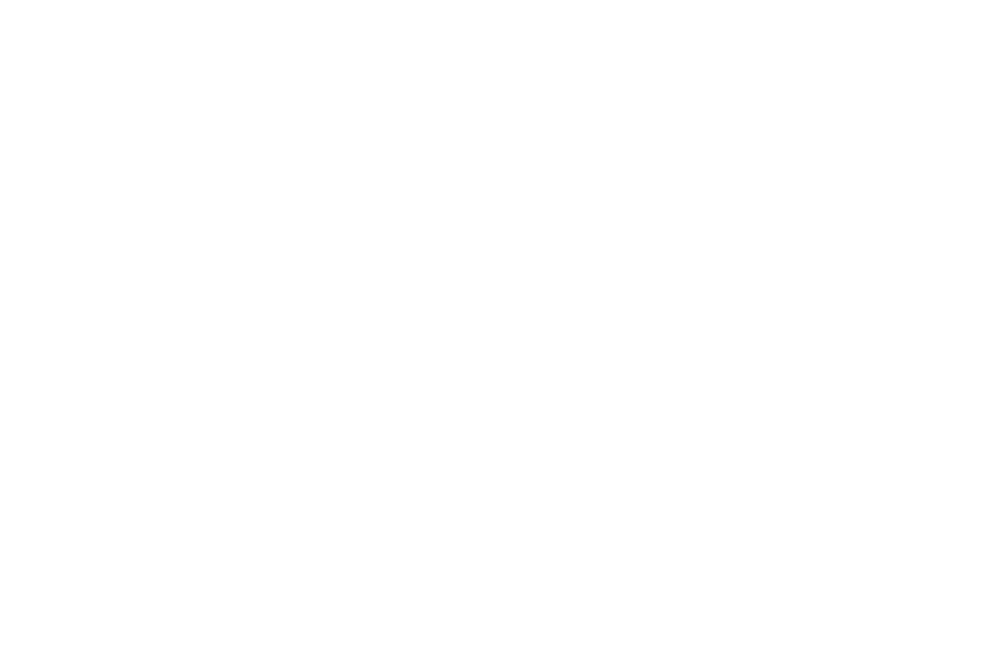

<IPython.core.display.Javascript object>


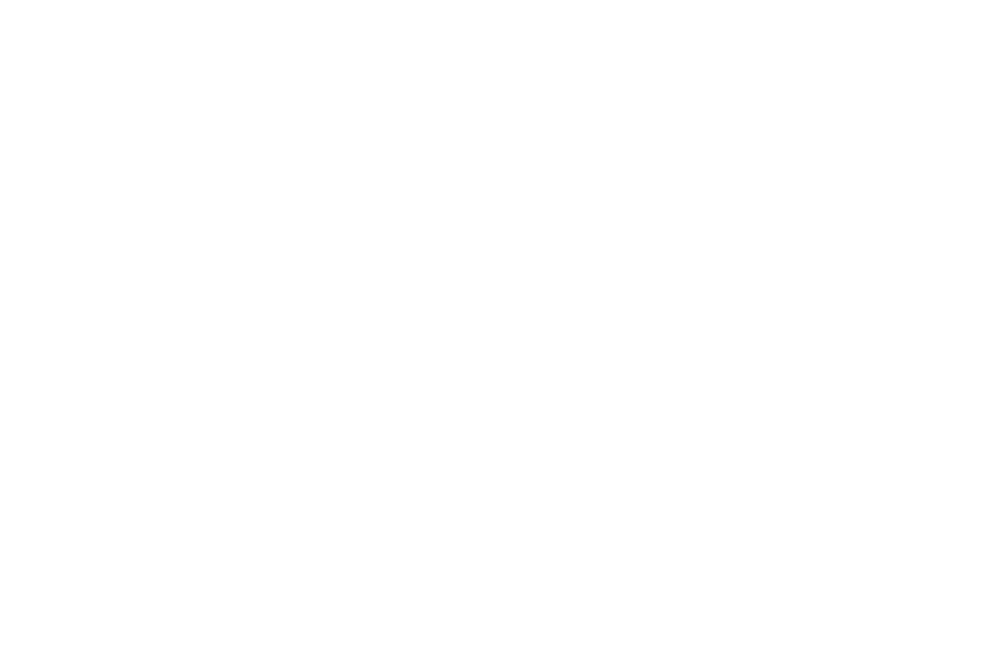

<IPython.core.display.Javascript object>


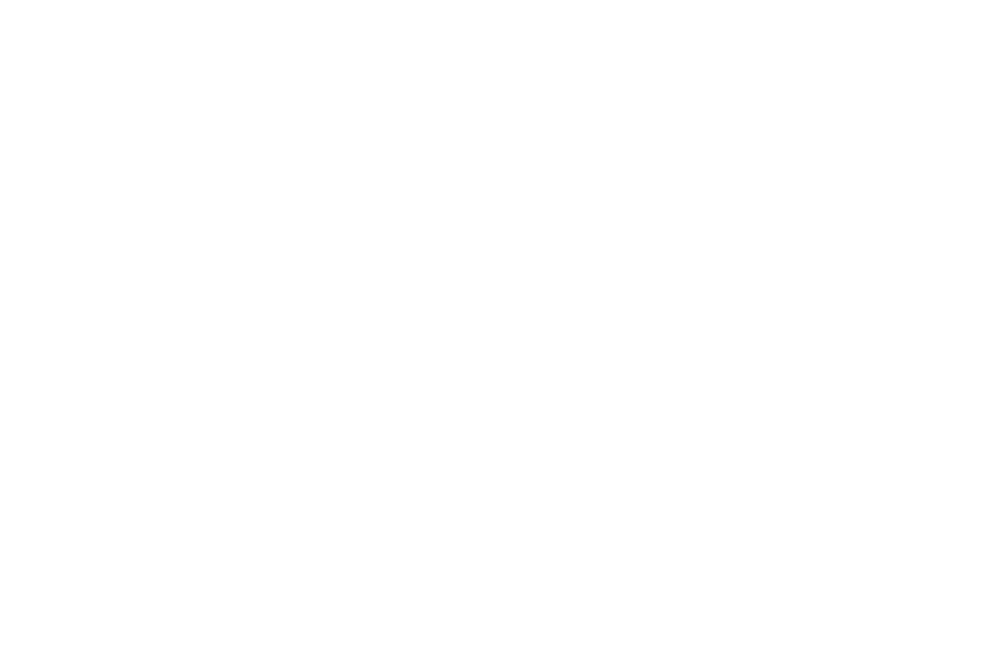

<IPython.core.display.Javascript object>


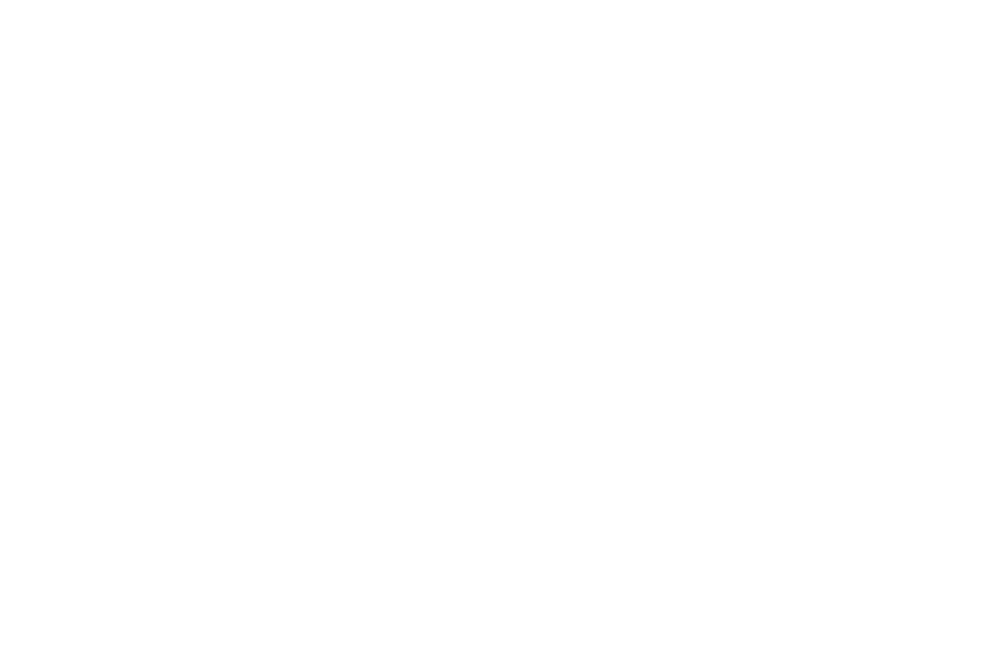

<IPython.core.display.Javascript object>


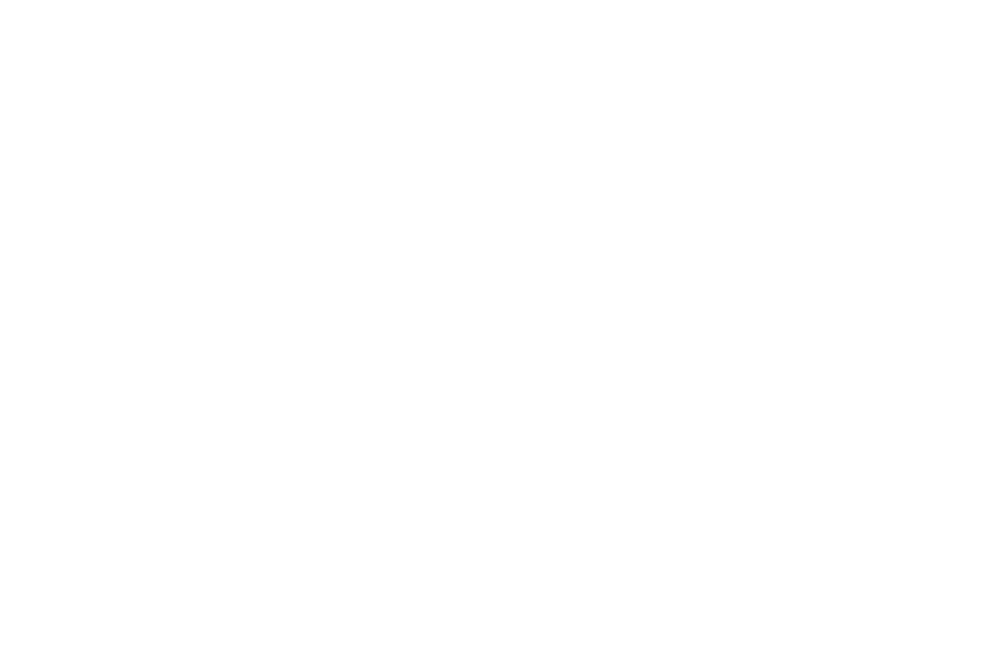

<IPython.core.display.Javascript object>


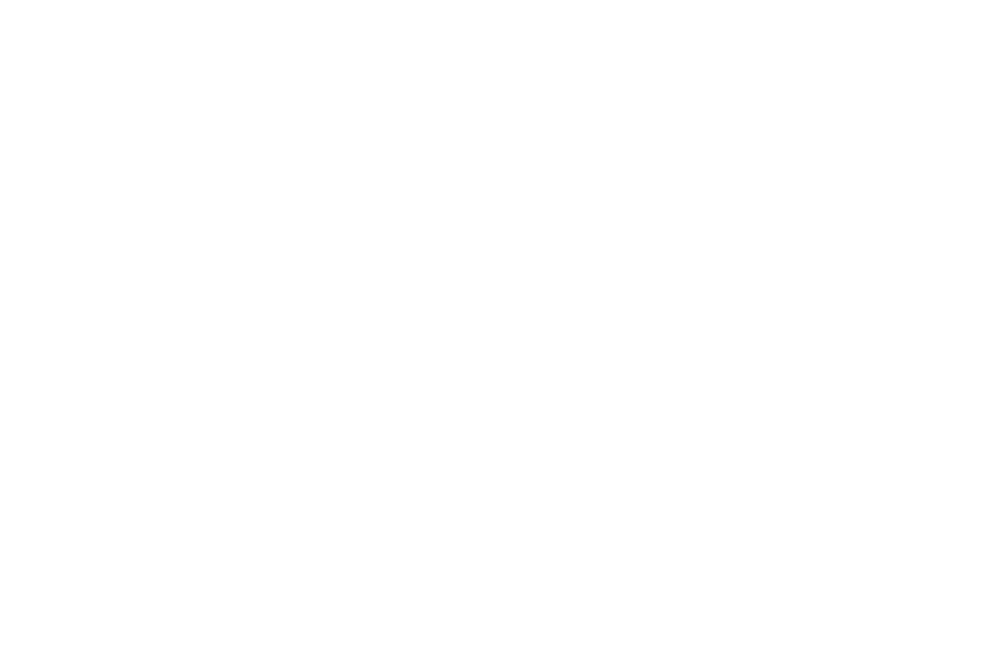

<IPython.core.display.Javascript object>


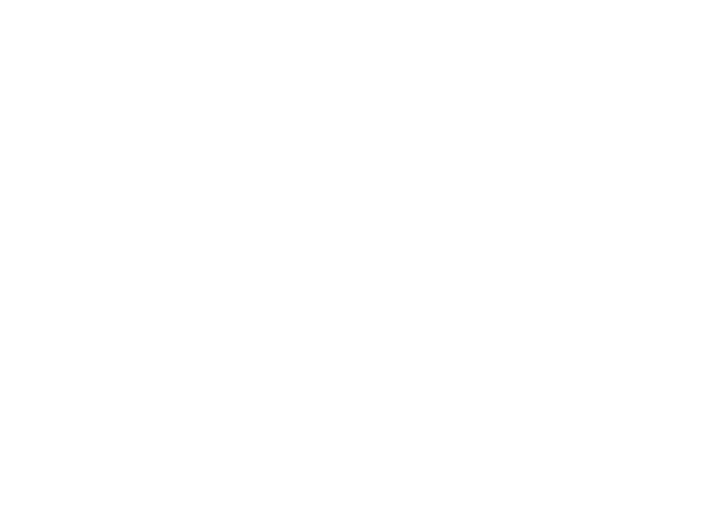

<IPython.core.display.Javascript object>


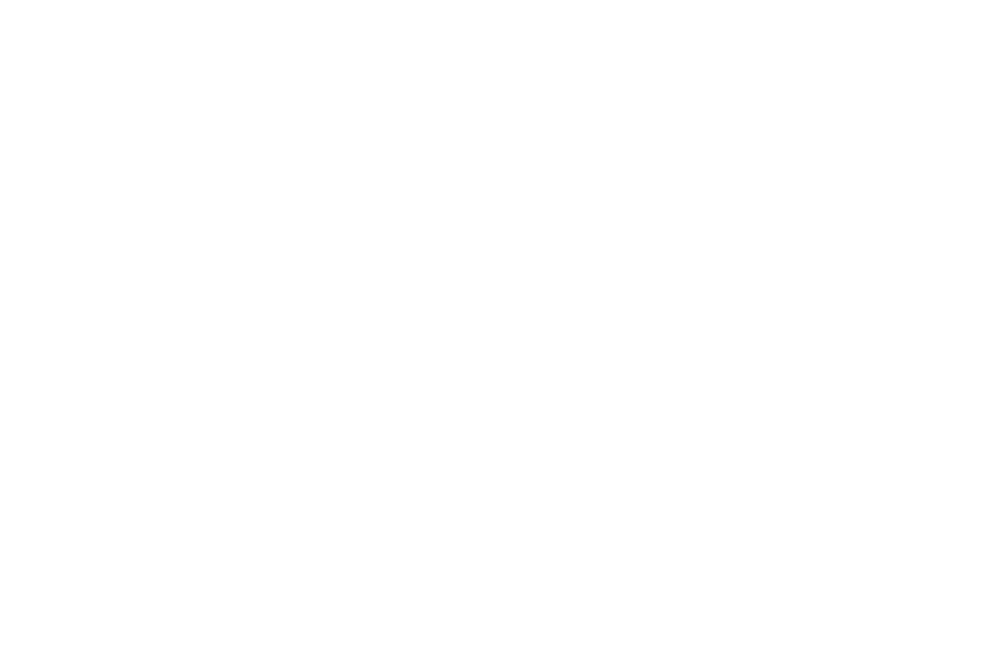

<IPython.core.display.Javascript object>


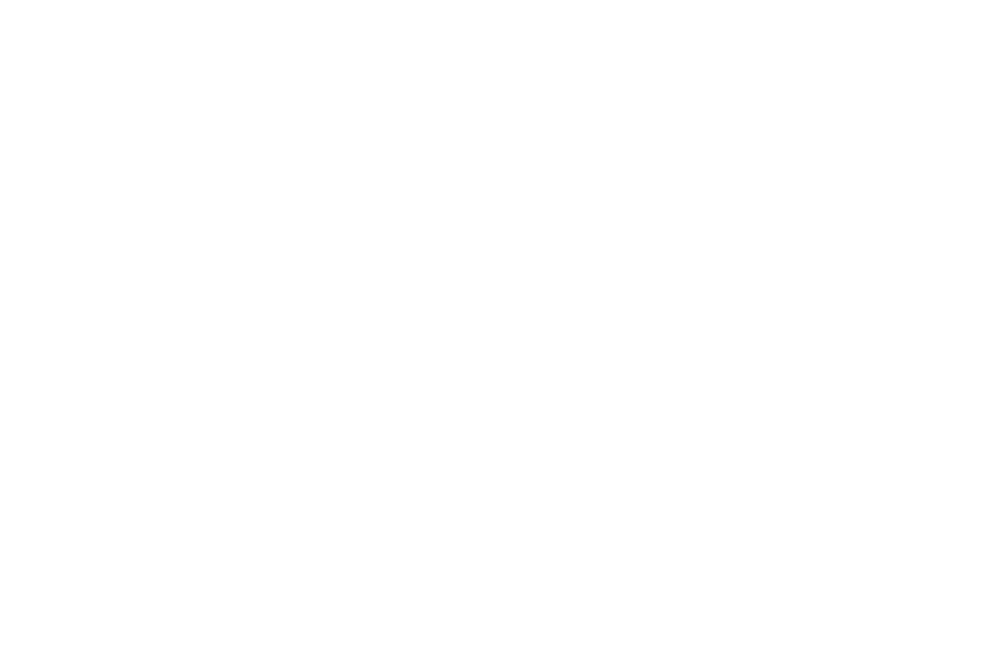

<IPython.core.display.Javascript object>


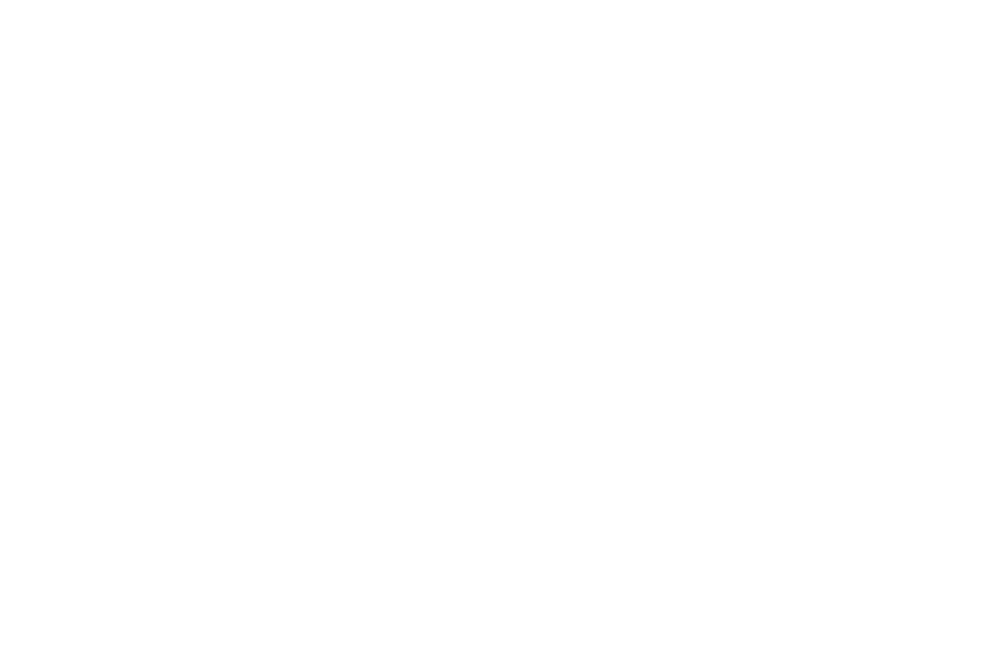

<IPython.core.display.Javascript object>


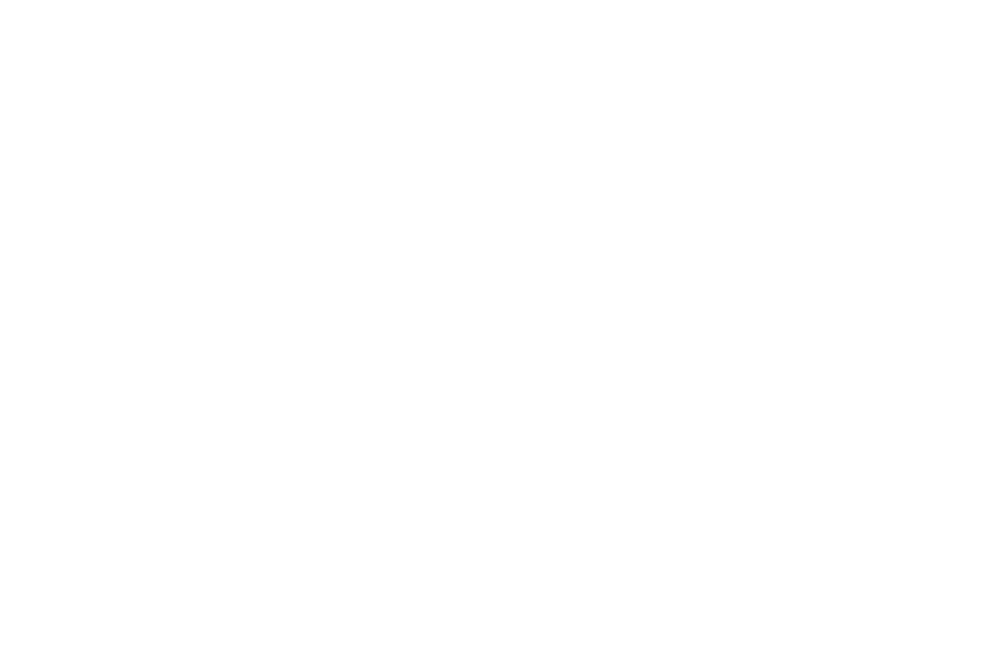

<IPython.core.display.Javascript object>


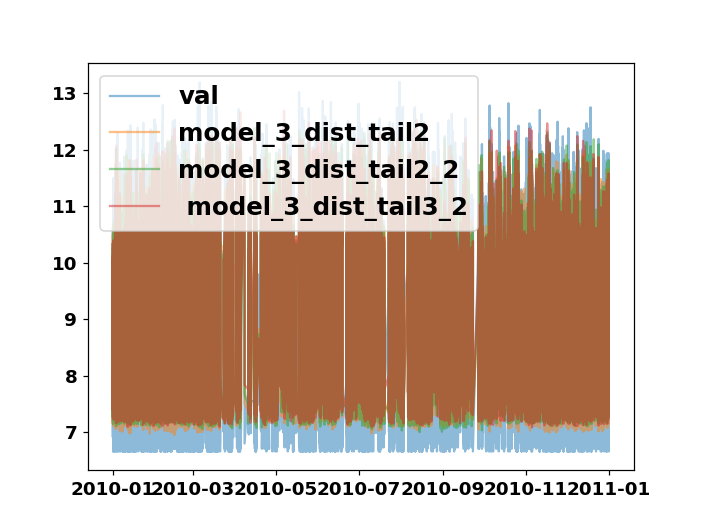

<IPython.core.display.Javascript object>


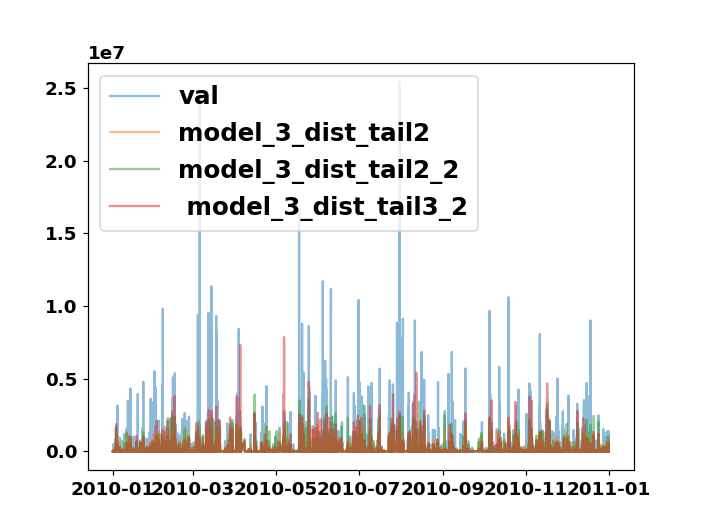

<IPython.core.display.Javascript object>


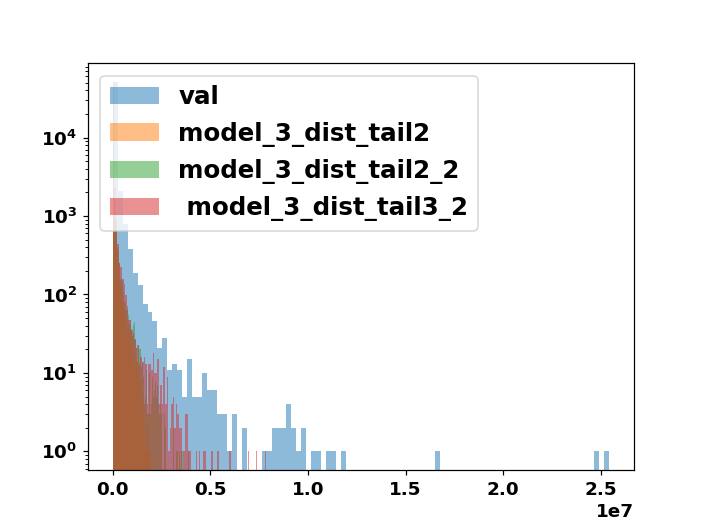

<IPython.core.display.Javascript object>


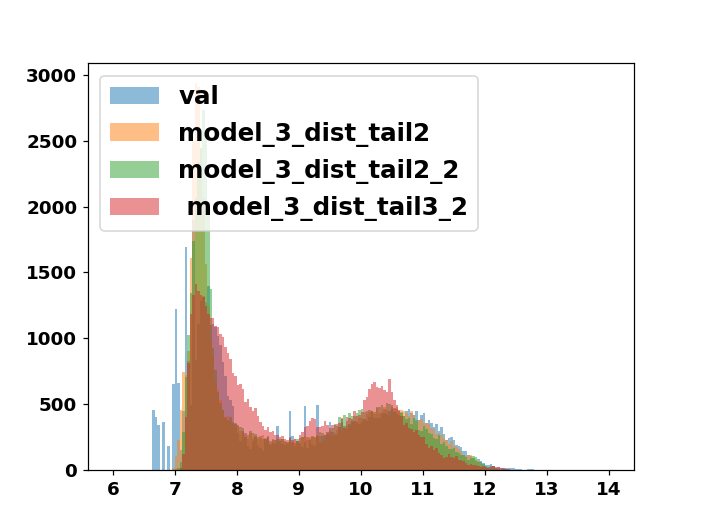

<IPython.core.display.Javascript object>


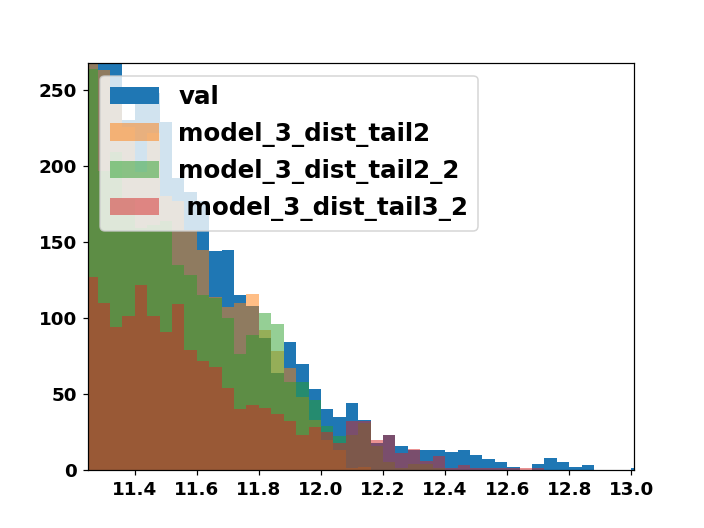

<IPython.core.display.Javascript object>


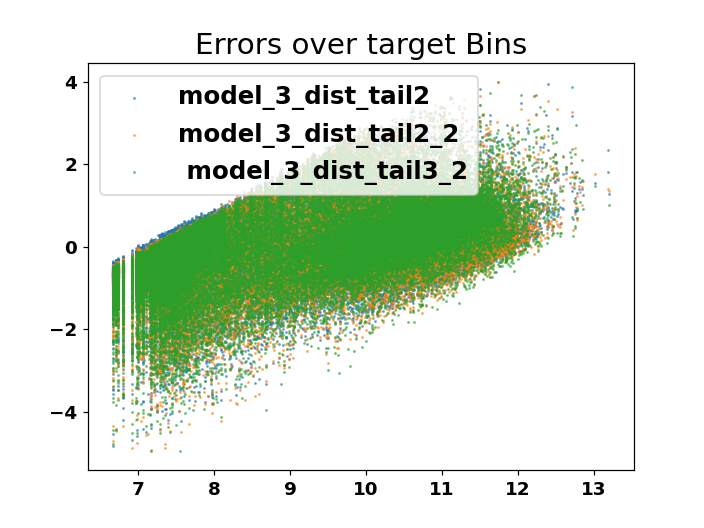

<IPython.core.display.Javascript object>


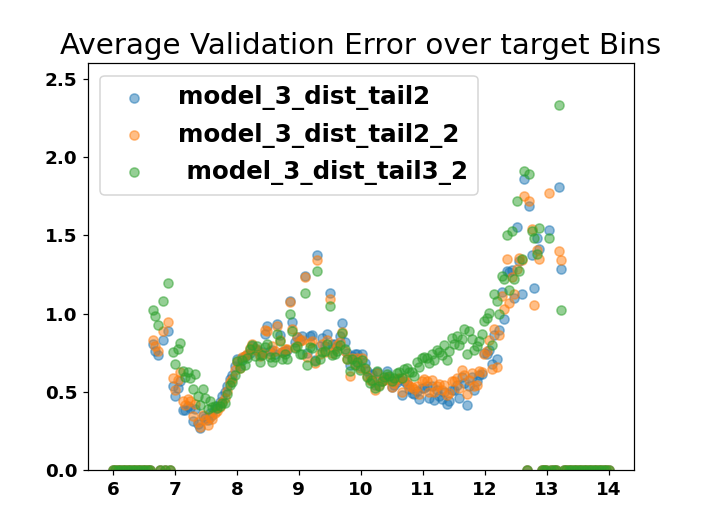

<IPython.core.display.Javascript object>


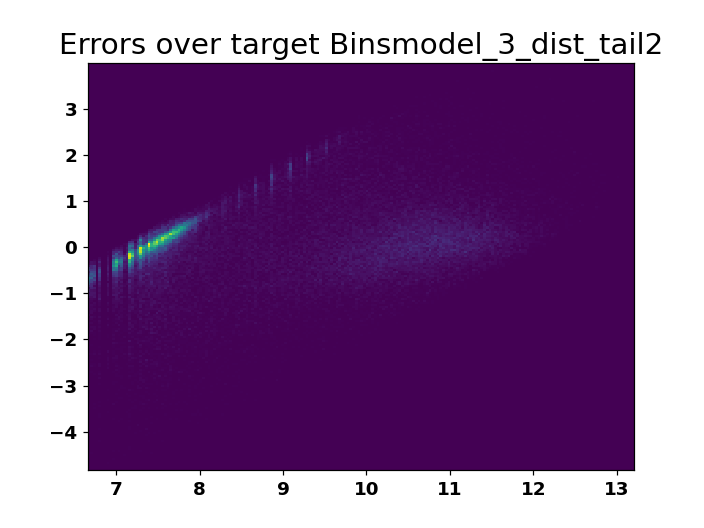

<IPython.core.display.Javascript object>


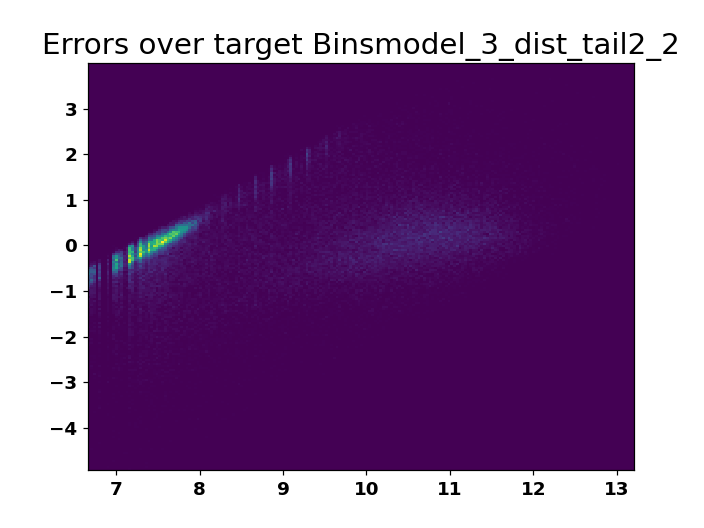

<IPython.core.display.Javascript object>


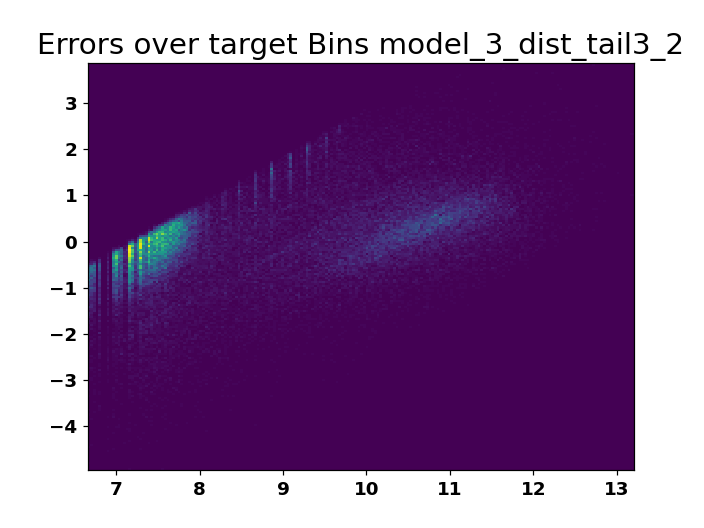

<IPython.core.display.Javascript object>


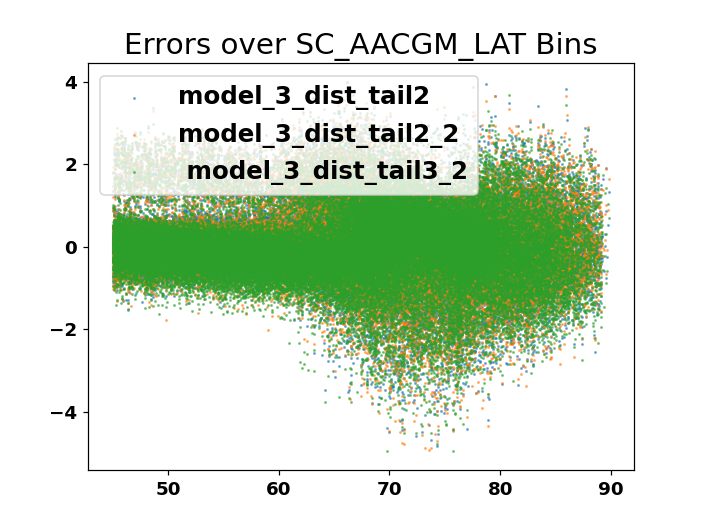

<IPython.core.display.Javascript object>


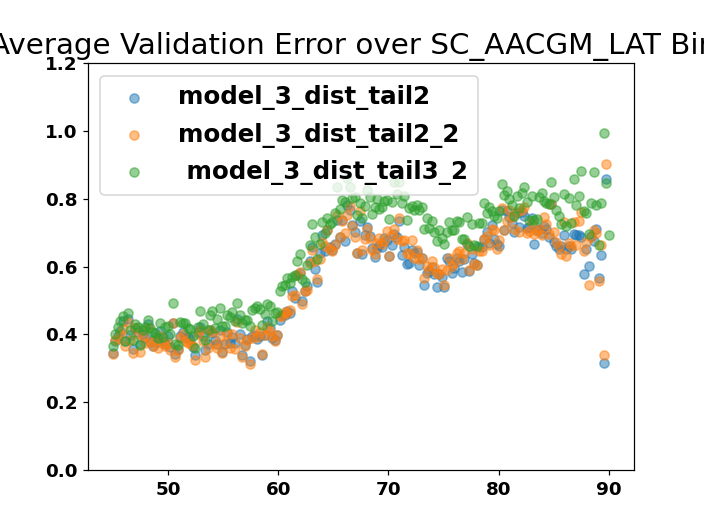

In [108]:
from tensorflow.keras.layers import Input

input1 = Input(shape=(148))
model1 = Dense(256,  activation='relu')(input1)
model1 = model1 = Dropout(0.5)(model1)
model1 = Dense(64, activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(int(256),   activation='relu')(model1)
model1 = Dense(int(1024),  activation='relu')(model1)
model1 = Dense(int(256),  activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(4, activation='relu')(model1)
model1 = Dense(1, activation='linear' )(model1)


output = model1
model = tensorflow.keras.models.Model(inputs=input1, outputs=output)
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',metrics=['mse'])
model.summary()

history = model.fit(X, 
                   y_train_log, 
                    validation_data=(
                        X_test, 
                        y_val_log,                                    ), sample_weight=sample_weights,
                    batch_size=32768,epochs=2000,verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=200)])#


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.ylim([0,.9])
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

results = model.predict(X_test)

df_results = pd.DataFrame(data=results, index = df_val.index)

model_3_dist_tail3_2 = df_results

plot_model(df_results)

plot_model_multiple([model_3_dist_tail2, model_3_dist_tail2_2, model_3_dist_tail3_2],['model_3_dist_tail2', 'model_3_dist_tail2_2',' model_3_dist_tail3_2'],y_val_log)

1838283
1838283


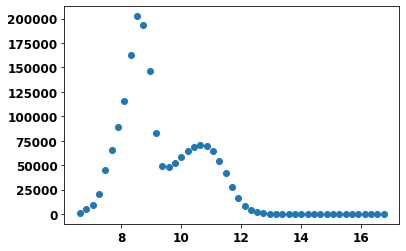

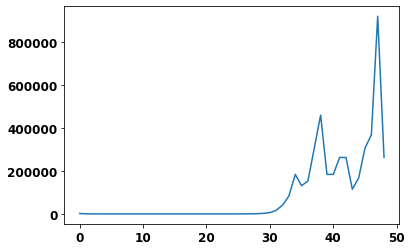

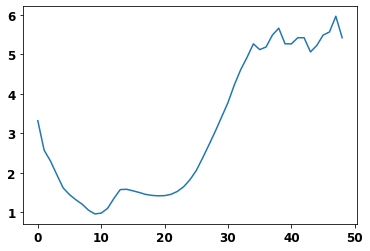

In [29]:
bins = np.linspace(np.min(y_train_log),np.max(y_train_log),50)
hist,bins = np.histogram(y_train_log,bins =bins)
plt.figure()
plt.scatter(bins[1:],hist)
plt.figure()
print(y_train_log.size)
plt.plot(y_train_log.size/(hist+1))
bin_size = bins[1]-bins[0]
y_min = np.min(y_train_log)
sample_weights = np.ones((y_train_log.size))


plt.figure()
print(y_train_log.size)
plt.plot(np.log10((y_train_log.size/(hist+1))))

plt.show()

1838283


W0622 12:46:44.829247 140090459936576 font_manager.py:1282] findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


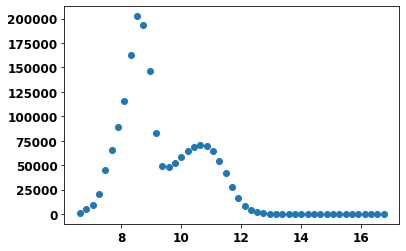

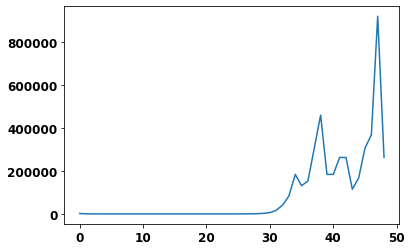

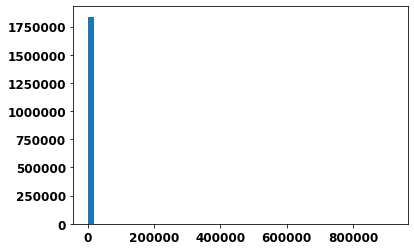

In [17]:
for i in range(0,y_train_log.size):
    bin_i = int((y_train_log[i]-y_min)/bin_size)
    if bin_i ==49:
        bin_i = 48
    sample_weights[i] = y_train_log.size/(hist[bin_i]+1)
    
plt.figure()
plt.hist(sample_weights,bins=50)
plt.show()

Model: "functional_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 148)]             0         
_________________________________________________________________
dense (Dense)                (None, 256)               38144     
_________________________________________________________________
dropout (Dropout)            (None, 256)               0         
_________________________________________________________________
dense_1 (Dense)              (None, 64)                16448     
_________________________________________________________________
dense_2 (Dense)              (None, 32)                2080      
_________________________________________________________________
dense_3 (Dense)              (None, 256)               8448      
_________________________________________________________________
dense_4 (Dense)              (None, 1024)             

Epoch 70/2000
57/57 - 2s - loss: 155.7888 - mse: 3.3983 - val_loss: 1.9138 - val_mse: 1.9138
Epoch 71/2000
57/57 - 2s - loss: 143.1530 - mse: 3.4508 - val_loss: 1.4410 - val_mse: 1.4410
Epoch 72/2000
57/57 - 2s - loss: 138.2350 - mse: 3.1455 - val_loss: 1.4014 - val_mse: 1.4014
Epoch 73/2000
57/57 - 2s - loss: 121.9635 - mse: 3.1398 - val_loss: 1.3428 - val_mse: 1.3428
Epoch 74/2000
57/57 - 2s - loss: 116.3110 - mse: 2.8998 - val_loss: 1.3210 - val_mse: 1.3210
Epoch 75/2000
57/57 - 2s - loss: 113.2879 - mse: 2.7565 - val_loss: 1.9920 - val_mse: 1.9920
Epoch 76/2000
57/57 - 2s - loss: 116.8472 - mse: 2.9199 - val_loss: 1.3026 - val_mse: 1.3026
Epoch 77/2000
57/57 - 2s - loss: 112.5831 - mse: 2.7006 - val_loss: 1.1987 - val_mse: 1.1987
Epoch 78/2000
57/57 - 2s - loss: 113.2883 - mse: 2.7034 - val_loss: 1.6712 - val_mse: 1.6712
Epoch 79/2000
57/57 - 2s - loss: 119.6909 - mse: 2.9052 - val_loss: 1.2414 - val_mse: 1.2414
Epoch 80/2000
57/57 - 2s - loss: 110.7124 - mse: 2.6514 - val_loss: 1.

Epoch 158/2000
57/57 - 2s - loss: 79.9495 - mse: 1.8902 - val_loss: 0.9165 - val_mse: 0.9165
Epoch 159/2000
57/57 - 2s - loss: 95.6588 - mse: 1.9622 - val_loss: 1.0661 - val_mse: 1.0661
Epoch 160/2000
57/57 - 2s - loss: 75.8374 - mse: 1.9802 - val_loss: 1.1076 - val_mse: 1.1076
Epoch 161/2000
57/57 - 2s - loss: 72.7555 - mse: 1.8140 - val_loss: 1.1976 - val_mse: 1.1976
Epoch 162/2000
57/57 - 2s - loss: 76.5493 - mse: 1.7865 - val_loss: 1.1400 - val_mse: 1.1400
Epoch 163/2000
57/57 - 2s - loss: 78.9076 - mse: 2.0357 - val_loss: 1.2446 - val_mse: 1.2446
Epoch 164/2000
57/57 - 2s - loss: 79.2516 - mse: 2.0977 - val_loss: 0.9979 - val_mse: 0.9979
Epoch 165/2000
57/57 - 2s - loss: 74.3948 - mse: 1.8331 - val_loss: 0.9187 - val_mse: 0.9187
Epoch 166/2000
57/57 - 2s - loss: 66.7826 - mse: 1.6277 - val_loss: 1.4087 - val_mse: 1.4087
Epoch 167/2000
57/57 - 2s - loss: 73.9010 - mse: 1.8323 - val_loss: 1.3735 - val_mse: 1.3735
Epoch 168/2000
57/57 - 3s - loss: 74.1486 - mse: 1.8797 - val_loss: 0.

57/57 - 3s - loss: 66.7551 - mse: 1.7294 - val_loss: 0.9118 - val_mse: 0.9118
Epoch 247/2000
57/57 - 3s - loss: 64.8070 - mse: 1.6038 - val_loss: 1.0150 - val_mse: 1.0150
Epoch 248/2000
57/57 - 3s - loss: 63.4435 - mse: 1.5860 - val_loss: 1.0268 - val_mse: 1.0268
Epoch 249/2000
57/57 - 3s - loss: 63.9540 - mse: 1.6094 - val_loss: 1.0522 - val_mse: 1.0522
Epoch 250/2000
57/57 - 2s - loss: 60.8023 - mse: 1.5617 - val_loss: 1.0812 - val_mse: 1.0812
Epoch 251/2000
57/57 - 2s - loss: 61.9712 - mse: 1.4791 - val_loss: 1.1867 - val_mse: 1.1867
Epoch 252/2000
57/57 - 2s - loss: 66.4782 - mse: 1.5919 - val_loss: 0.8776 - val_mse: 0.8776
Epoch 253/2000
57/57 - 2s - loss: 66.9080 - mse: 1.6714 - val_loss: 1.1762 - val_mse: 1.1762
Epoch 254/2000
57/57 - 2s - loss: 63.9313 - mse: 1.7303 - val_loss: 0.9440 - val_mse: 0.9440
Epoch 255/2000
57/57 - 2s - loss: 65.0352 - mse: 1.5092 - val_loss: 1.1059 - val_mse: 1.1059
Epoch 256/2000
57/57 - 2s - loss: 60.2547 - mse: 1.5834 - val_loss: 0.8948 - val_mse:

Epoch 335/2000
57/57 - 2s - loss: 73.3487 - mse: 1.5751 - val_loss: 1.0754 - val_mse: 1.0754
Epoch 336/2000
57/57 - 2s - loss: 60.9286 - mse: 1.4680 - val_loss: 1.3283 - val_mse: 1.3283
Epoch 337/2000
57/57 - 2s - loss: 62.5958 - mse: 1.5639 - val_loss: 0.9568 - val_mse: 0.9568
Epoch 338/2000
57/57 - 2s - loss: 63.7154 - mse: 1.5817 - val_loss: 1.0134 - val_mse: 1.0134
Epoch 339/2000
57/57 - 2s - loss: 60.1572 - mse: 1.6161 - val_loss: 0.8722 - val_mse: 0.8722
Epoch 340/2000
57/57 - 2s - loss: 55.8980 - mse: 1.4062 - val_loss: 0.9246 - val_mse: 0.9246
Epoch 341/2000
57/57 - 2s - loss: 62.5197 - mse: 1.4345 - val_loss: 0.9547 - val_mse: 0.9547
Epoch 342/2000
57/57 - 2s - loss: 54.9793 - mse: 1.4002 - val_loss: 0.8766 - val_mse: 0.8766
Epoch 343/2000
57/57 - 2s - loss: 57.6080 - mse: 1.4636 - val_loss: 0.9954 - val_mse: 0.9954
Epoch 344/2000
57/57 - 2s - loss: 54.6634 - mse: 1.3936 - val_loss: 0.9025 - val_mse: 0.9025
Epoch 345/2000
57/57 - 2s - loss: 56.4572 - mse: 1.4195 - val_loss: 0.

57/57 - 3s - loss: 54.6422 - mse: 1.1835 - val_loss: 0.9214 - val_mse: 0.9214
Epoch 424/2000
57/57 - 2s - loss: 64.5680 - mse: 1.3735 - val_loss: 0.9298 - val_mse: 0.9298
Epoch 425/2000
57/57 - 2s - loss: 53.0059 - mse: 1.3511 - val_loss: 0.8954 - val_mse: 0.8954
Epoch 426/2000
57/57 - 2s - loss: 58.2528 - mse: 1.2855 - val_loss: 0.8963 - val_mse: 0.8963
Epoch 427/2000
57/57 - 2s - loss: 50.1381 - mse: 1.2859 - val_loss: 0.8981 - val_mse: 0.8981
Epoch 428/2000
57/57 - 2s - loss: 48.6482 - mse: 1.2765 - val_loss: 0.9259 - val_mse: 0.9259
Epoch 429/2000
57/57 - 2s - loss: 54.1447 - mse: 1.3070 - val_loss: 0.8455 - val_mse: 0.8455
Epoch 430/2000
57/57 - 2s - loss: 53.4040 - mse: 1.2698 - val_loss: 0.8570 - val_mse: 0.8570
Epoch 431/2000
57/57 - 2s - loss: 53.5774 - mse: 1.2693 - val_loss: 0.9266 - val_mse: 0.9266
Epoch 432/2000
57/57 - 2s - loss: 48.9161 - mse: 1.2431 - val_loss: 0.8795 - val_mse: 0.8795
Epoch 433/2000
57/57 - 2s - loss: 47.3704 - mse: 1.1665 - val_loss: 0.9034 - val_mse:

Epoch 512/2000
57/57 - 3s - loss: 51.9515 - mse: 1.1946 - val_loss: 0.8474 - val_mse: 0.8474
Epoch 513/2000
57/57 - 3s - loss: 44.8405 - mse: 1.0996 - val_loss: 0.8876 - val_mse: 0.8876
Epoch 514/2000
57/57 - 3s - loss: 49.8076 - mse: 1.2123 - val_loss: 0.8590 - val_mse: 0.8590
Epoch 515/2000
57/57 - 3s - loss: 47.7442 - mse: 1.1985 - val_loss: 1.0042 - val_mse: 1.0042
Epoch 516/2000
57/57 - 3s - loss: 46.5883 - mse: 1.1916 - val_loss: 0.8431 - val_mse: 0.8431
Epoch 517/2000
57/57 - 3s - loss: 48.0359 - mse: 1.1729 - val_loss: 0.8679 - val_mse: 0.8679
Epoch 518/2000
57/57 - 3s - loss: 46.3654 - mse: 1.1860 - val_loss: 0.8178 - val_mse: 0.8178
Epoch 519/2000
57/57 - 3s - loss: 51.2999 - mse: 1.1264 - val_loss: 0.8401 - val_mse: 0.8401
Epoch 520/2000
57/57 - 3s - loss: 47.9583 - mse: 1.1595 - val_loss: 0.8910 - val_mse: 0.8910
Epoch 521/2000
57/57 - 3s - loss: 52.3988 - mse: 1.1867 - val_loss: 0.8641 - val_mse: 0.8641
Epoch 522/2000
57/57 - 3s - loss: 47.0945 - mse: 1.1675 - val_loss: 0.

57/57 - 3s - loss: 46.1317 - mse: 1.1334 - val_loss: 0.8333 - val_mse: 0.8333
Epoch 601/2000
57/57 - 3s - loss: 44.5829 - mse: 1.1138 - val_loss: 0.8789 - val_mse: 0.8789
Epoch 602/2000
57/57 - 3s - loss: 44.8439 - mse: 1.1295 - val_loss: 0.8057 - val_mse: 0.8057
Epoch 603/2000
57/57 - 3s - loss: 45.6652 - mse: 1.1296 - val_loss: 1.0931 - val_mse: 1.0931
Epoch 604/2000
57/57 - 3s - loss: 44.7275 - mse: 1.1173 - val_loss: 0.9374 - val_mse: 0.9374
Epoch 605/2000
57/57 - 2s - loss: 41.3680 - mse: 1.0457 - val_loss: 0.8853 - val_mse: 0.8853
Epoch 606/2000
57/57 - 2s - loss: 48.6849 - mse: 1.1473 - val_loss: 0.8969 - val_mse: 0.8969
Epoch 607/2000
57/57 - 2s - loss: 50.8489 - mse: 1.1323 - val_loss: 0.9775 - val_mse: 0.9775
Epoch 608/2000
57/57 - 2s - loss: 46.3693 - mse: 1.1626 - val_loss: 0.9282 - val_mse: 0.9282
Epoch 609/2000
57/57 - 2s - loss: 51.4193 - mse: 1.1737 - val_loss: 0.9507 - val_mse: 0.9507
Epoch 610/2000
57/57 - 2s - loss: 44.3143 - mse: 1.1505 - val_loss: 0.8690 - val_mse:

Epoch 689/2000
57/57 - 2s - loss: 44.2047 - mse: 1.1252 - val_loss: 0.9265 - val_mse: 0.9265
Epoch 690/2000
57/57 - 2s - loss: 45.3113 - mse: 1.1397 - val_loss: 0.8206 - val_mse: 0.8206
Epoch 691/2000
57/57 - 2s - loss: 47.7038 - mse: 1.1958 - val_loss: 0.8872 - val_mse: 0.8872
Epoch 692/2000
57/57 - 2s - loss: 46.0317 - mse: 1.1539 - val_loss: 0.8430 - val_mse: 0.8430
Epoch 693/2000
57/57 - 2s - loss: 48.2480 - mse: 1.1560 - val_loss: 0.8161 - val_mse: 0.8161
Epoch 694/2000
57/57 - 2s - loss: 44.0986 - mse: 1.1306 - val_loss: 0.8239 - val_mse: 0.8239
Epoch 695/2000
57/57 - 2s - loss: 57.5394 - mse: 1.3696 - val_loss: 0.8474 - val_mse: 0.8474
Epoch 696/2000
57/57 - 2s - loss: 47.3026 - mse: 1.1775 - val_loss: 0.8601 - val_mse: 0.8601
Epoch 697/2000
57/57 - 2s - loss: 48.5320 - mse: 1.2018 - val_loss: 0.8609 - val_mse: 0.8609
Epoch 698/2000
57/57 - 2s - loss: 48.7407 - mse: 1.1472 - val_loss: 0.8677 - val_mse: 0.8677
Epoch 699/2000
57/57 - 2s - loss: 43.7657 - mse: 1.0825 - val_loss: 0.

57/57 - 2s - loss: 45.6972 - mse: 1.1534 - val_loss: 0.8376 - val_mse: 0.8376
Epoch 778/2000
57/57 - 2s - loss: 45.3519 - mse: 1.1431 - val_loss: 0.8504 - val_mse: 0.8504
Epoch 779/2000
57/57 - 2s - loss: 53.2650 - mse: 1.1652 - val_loss: 0.8809 - val_mse: 0.8809
Epoch 780/2000
57/57 - 2s - loss: 45.9958 - mse: 1.1252 - val_loss: 0.8809 - val_mse: 0.8809
Epoch 781/2000
57/57 - 2s - loss: 47.2952 - mse: 1.1684 - val_loss: 0.9110 - val_mse: 0.9110
Epoch 782/2000
57/57 - 2s - loss: 56.5258 - mse: 1.2028 - val_loss: 0.8520 - val_mse: 0.8520
Epoch 783/2000
57/57 - 2s - loss: 63.8991 - mse: 1.2252 - val_loss: 0.8108 - val_mse: 0.8108
Epoch 784/2000
57/57 - 2s - loss: 60.8651 - mse: 1.2200 - val_loss: 0.8733 - val_mse: 0.8733
Epoch 785/2000
57/57 - 2s - loss: 67.3664 - mse: 1.2411 - val_loss: 1.0600 - val_mse: 1.0600
Epoch 786/2000
57/57 - 2s - loss: 64.8561 - mse: 1.5170 - val_loss: 0.9681 - val_mse: 0.9681
Epoch 787/2000
57/57 - 2s - loss: 64.3563 - mse: 1.4041 - val_loss: 0.9514 - val_mse:

Epoch 866/2000
57/57 - 2s - loss: 48.4735 - mse: 1.2512 - val_loss: 0.9060 - val_mse: 0.9060
Epoch 867/2000
57/57 - 2s - loss: 54.1670 - mse: 1.2665 - val_loss: 0.8629 - val_mse: 0.8629
Epoch 868/2000
57/57 - 2s - loss: 46.3885 - mse: 1.1870 - val_loss: 0.8419 - val_mse: 0.8419
Epoch 869/2000
57/57 - 2s - loss: 50.7569 - mse: 1.1948 - val_loss: 0.8258 - val_mse: 0.8258
Epoch 870/2000
57/57 - 2s - loss: 45.4869 - mse: 1.1309 - val_loss: 0.9133 - val_mse: 0.9133
Epoch 871/2000
57/57 - 2s - loss: 46.1999 - mse: 1.1297 - val_loss: 0.8305 - val_mse: 0.8305
Epoch 872/2000
57/57 - 2s - loss: 51.1413 - mse: 1.1212 - val_loss: 0.8438 - val_mse: 0.8438
Epoch 873/2000
57/57 - 2s - loss: 47.8946 - mse: 1.1673 - val_loss: 0.8583 - val_mse: 0.8583
Epoch 874/2000
57/57 - 2s - loss: 50.4204 - mse: 1.2630 - val_loss: 0.9324 - val_mse: 0.9324
Epoch 875/2000
57/57 - 2s - loss: 46.5639 - mse: 1.1906 - val_loss: 0.8440 - val_mse: 0.8440
Epoch 876/2000
57/57 - 2s - loss: 48.9064 - mse: 1.1761 - val_loss: 0.

W0622 13:29:08.450291 140090459936576 font_manager.py:1282] findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.
W0622 13:29:08.469946 140090459936576 font_manager.py:1282] findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.
W0622 13:29:08.492241 140090459936576 font_manager.py:1282] findfont: Font family ['normal'] not found. Falling back to DejaVu Sans.


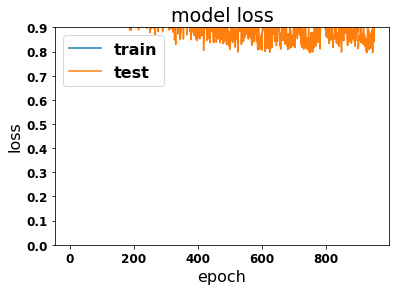

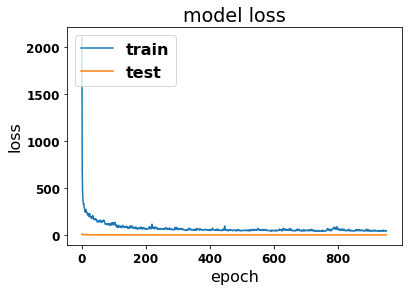

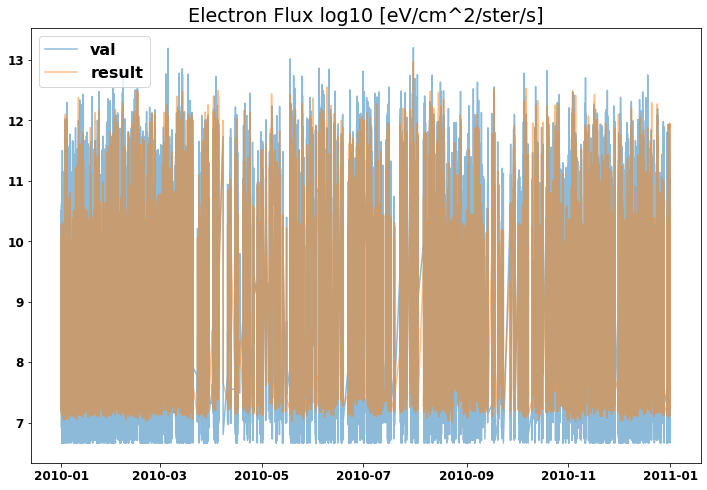

<Figure size 432x288 with 0 Axes>

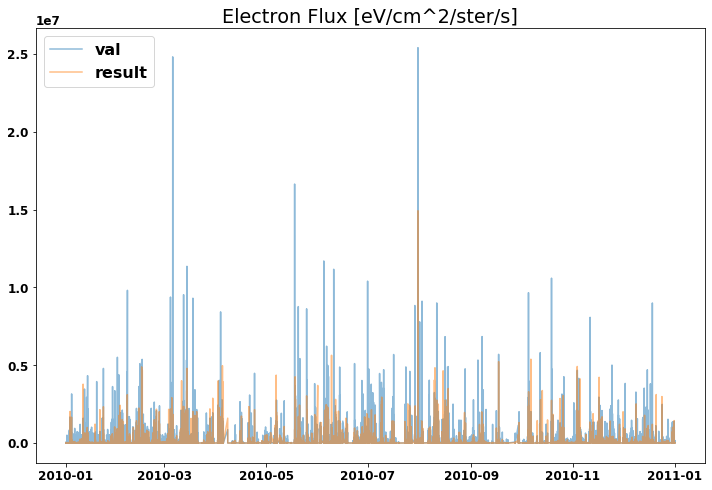

<Figure size 432x288 with 0 Axes>

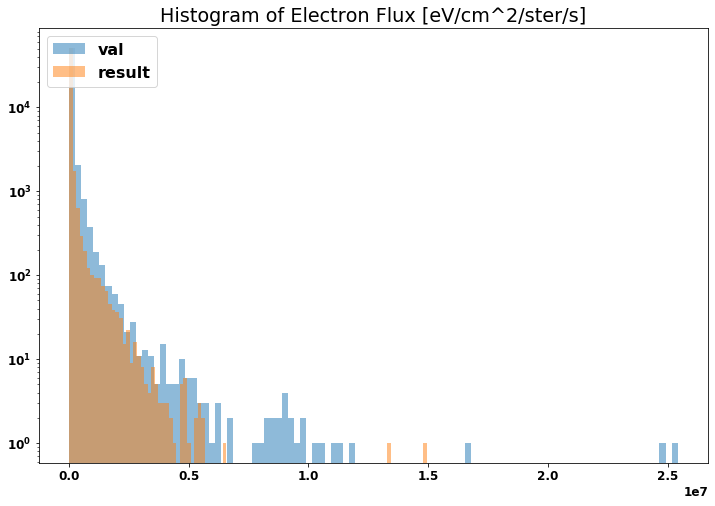

<Figure size 432x288 with 0 Axes>

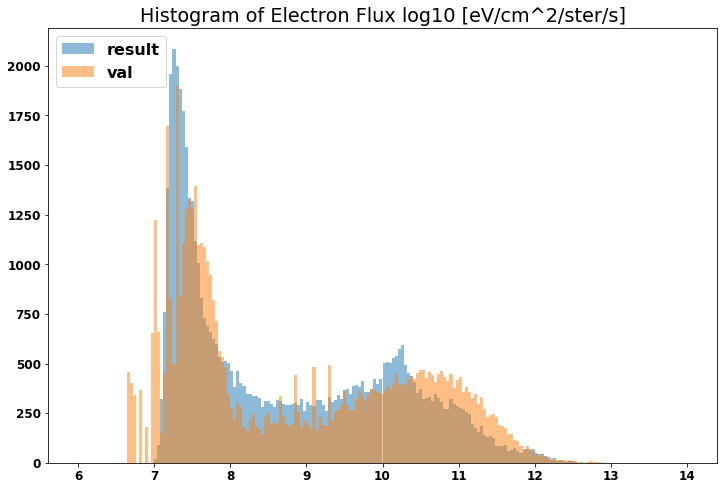

<Figure size 432x288 with 0 Axes>

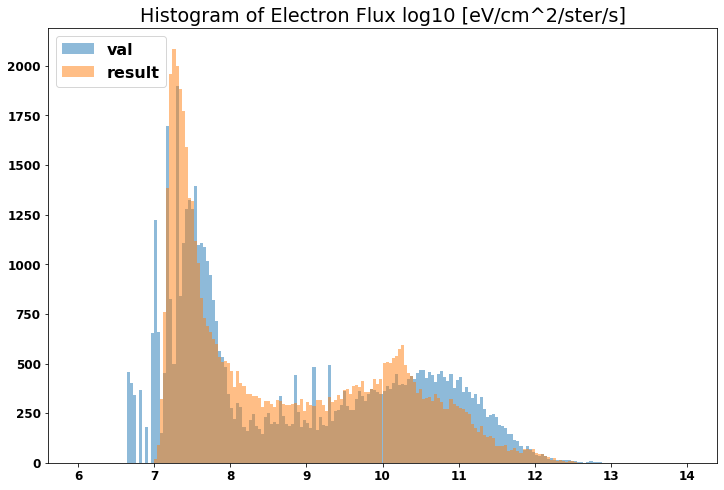

<Figure size 432x288 with 0 Axes>

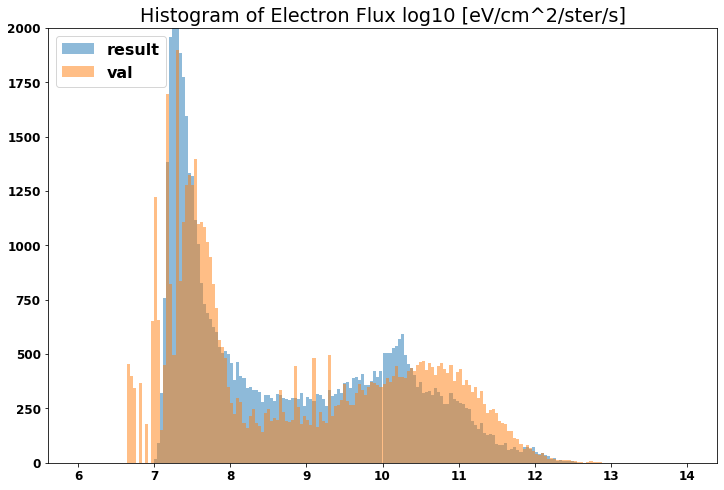

<Figure size 432x288 with 0 Axes>

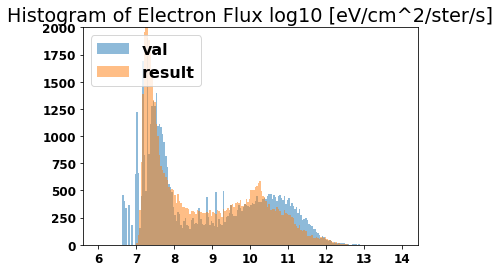

<Figure size 432x288 with 0 Axes>

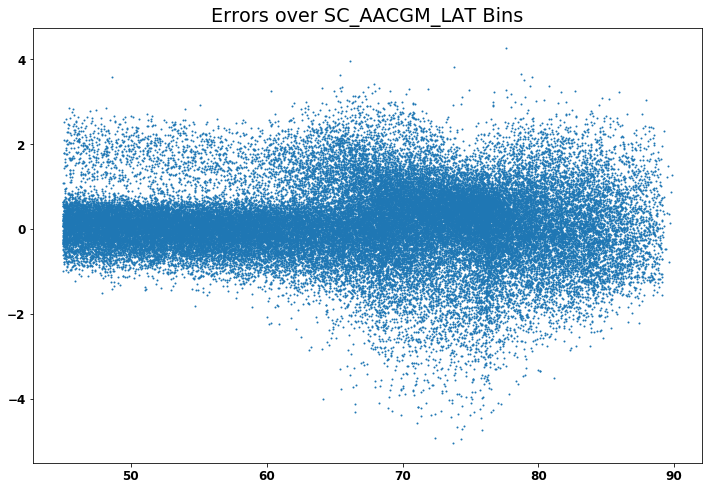

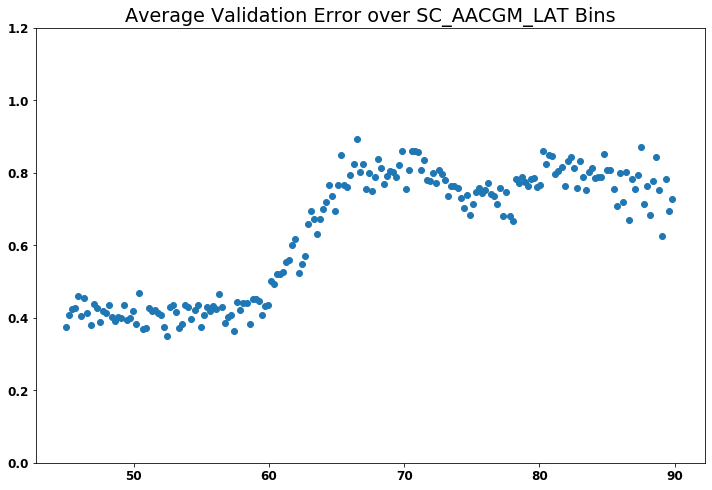

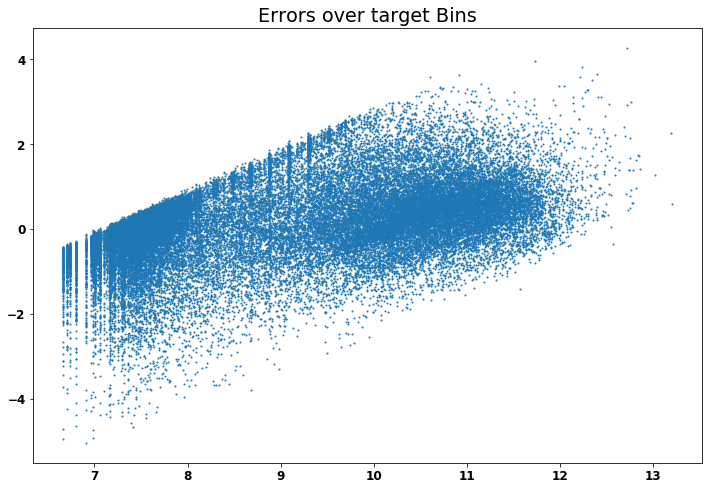

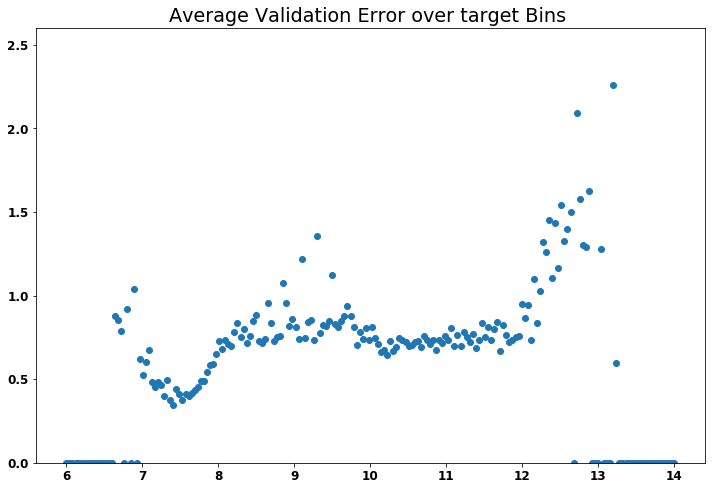

In [18]:
from tensorflow.keras.layers import Input

input1 = Input(shape=(148))
model1 = Dense(256,  activation='relu')(input1)
model1 = model1 = Dropout(0.5)(model1)
model1 = Dense(64, activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(int(256),   activation='relu')(model1)
model1 = Dense(int(1024),  activation='relu')(model1)
model1 = Dense(int(256),  activation='relu')(model1)
model1 = Dense(32, activation='relu')(model1)
model1 = Dense(4, activation='relu')(model1)
model1 = Dense(1, activation='linear' )(model1)


output = model1
model = tensorflow.keras.models.Model(inputs=input1, outputs=output)
#compile model using accuracy to measure model performance
model.compile(loss='mse', optimizer='adam',metrics=['mse'])
model.summary()

history = model.fit(X, 
                   y_train_log, 
                    validation_data=(
                        X_test, 
                        y_val_log,                                    ), sample_weight=sample_weights,
                    batch_size=32768,epochs=2000,verbose=2,
                   callbacks=[tf.keras.callbacks.EarlyStopping(monitor='val_loss',  restore_best_weights=True,
             patience=200)])#


plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.ylim([0,.9])
plt.show()

plt.figure()
# summarize history for loss
plt.plot(history.history['loss'][:])
plt.plot(history.history['val_loss'][:])
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()

results = model.predict(X_test)

df_results = pd.DataFrame(data=results, index = df_val.index)

model_3_dist_tail4 = df_results

plot_model(df_results)

#plot_model_multiple([model_3_dist_tail2, model_3_dist_tail2_2, model_3_dist_tail3_2],['model_3_dist_tail2', 'model_3_dist_tail2_2',' model_3_dist_tail3_2'],y_val_log)

In [20]:
model.save('model_3_dist_tail_50bins')


In [24]:
import matplotlib as matplotlib

font = {'family' : 'normal',
        'weight' : 'bold',
        'size'   : 16}
matplotlib.rc('xtick', labelsize=12) 
matplotlib.rc('ytick', labelsize=12) 
matplotlib.rc('font', **font)

def plot_model50bins(df_results):
    
    plt.figure(figsize=(12,8))
    plt.plot(y_val_log[:],alpha = 0.5)
    plt.plot(df_results[:],alpha = 0.5)
    plt.legend(['val', 'result'], loc='upper left')
    plt.title('Electron Flux log10 [eV/cm^2/ster/s]')

    plt.show()
    plt.savefig('1.png',dpi=200)

    low = min(y_train_log)
    hi = np.max(y_train_log)
    
    plt.figure(figsize=(12,8))
    plt.plot(10**y_val_log[:]*1.6e-6,alpha = 0.5)
    plt.plot(10**df_results[:]*1.6e-6,alpha = 0.5)
    plt.title('Electron Flux [eV/cm^2/ster/s]')
    plt.legend(['val', 'result'], loc='upper left')
    plt.show()
    plt.savefig('2.png',dpi=200)

    plt.figure(figsize=(12,8))
    plt.hist(10**y_val_log.values*1.6e-6,bins=50, log=True,alpha = 0.5)
    plt.hist(10**df_results.values*1.6e-6,bins=50, log=True,alpha = 0.5)
    plt.title('Histogram of Electron Flux [eV/cm^2/ster/s]')

    plt.legend(['val', 'result'], loc='upper left')
    plt.show()
    plt.savefig('3.png',dpi=200)


    plt.figure(figsize=(12,8))
    plt.hist(df_results.values,bins=50,range=(low,hi),alpha = 0.5)
    plt.hist(y_val_log.values,bins=50,range=(low,hi),alpha = 0.5)
    plt.legend(['result','val'], loc='upper left')
    plt.title('Histogram of Electron Flux log10 [eV/cm^2/ster/s]')
    plt.show()
    plt.savefig('4.png',dpi=200)

    plt.figure(figsize=(12,8))
    plt.hist(y_val_log.values,bins=50,range=(low,hi),alpha = 0.5)
    plt.hist(df_results.values,bins=50,range=(low,hi),alpha = 0.5)
    plt.legend(['val', 'result'], loc='upper left')
    plt.title('Histogram of Electron Flux log10 [eV/cm^2/ster/s]')
    plt.show()
    plt.savefig('5.png',dpi=200)

    plt.figure(figsize=(12,8))
    plt.hist(df_results.values,bins=50,range=(low,hi),alpha = 0.5)
    plt.hist(y_val_log.values,bins=50,range=(low,hi),alpha = 0.5)
    plt.legend(['result','val'], loc='upper left')
    plt.title('Histogram of Electron Flux log10 [eV/cm^2/ster/s]')

    plt.ylim([0,2000])
    plt.show()
    plt.savefig('6.png',dpi=200)

    plt.figure()
    plt.hist(y_val_log.values,bins=50,range=(low,hi),alpha = 0.5)
    plt.hist(df_results.values,bins=50,range=(low,hi),alpha = 0.5)
    plt.legend(['val', 'result'], loc='upper left')
    plt.title('Histogram of Electron Flux log10 [eV/cm^2/ster/s]')

    plt.ylim([0,2000])

    plt.show()
    plt.savefig('7.png',dpi=200)


    errors= y_val_log.values-df_results.values[:,0]
    plt.figure(figsize=(12,8));
    plt.scatter(df_val['SC_AACGM_LAT'].values,errors,s=1)
    plt.title('Errors over SC_AACGM_LAT Bins')
    plt.savefig('8.png',dpi=200)


    bin_total = np.zeros((50))
    bin_error_total = np.zeros((50))
    for j in range(0,y_val_log.values.shape[0]):
        i = int((df_val['SC_AACGM_LAT'].values[j]-45)/((90-45)/50))
        if i < 50:
            bin_total[i] = bin_total[i]+1
            bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])

    avg_error_over_hist = bin_error_total/bin_total
    plt.figure(figsize=(12,8))
    plt.scatter(np.linspace(45,90,num=50),avg_error_over_hist)
    plt.title('Average Validation Error over SC_AACGM_LAT Bins')
    plt.ylim([0,1.2])
    plt.show()
    
    errors= y_val_log.values-df_results.values[:,0]
    plt.figure(figsize=(12,8));
    plt.scatter(y_val_log.values,errors,s=1)
    plt.title('Errors over target Bins')

    bin_total = np.zeros((50))
    bin_error_total = np.zeros((50))
    for j in range(0,y_val_log.values.shape[0]):
        i = int((y_val_log[j]-6)/((14-6)/50))
        if i < 50:
            bin_total[i] = bin_total[i]+1
            bin_error_total[i] = bin_error_total[i] + np.abs(errors[j])

    avg_error_over_hist = bin_error_total/(bin_total+.00001)
    plt.figure(figsize=(12,8))
    plt.scatter(np.linspace(6,14,num=50),avg_error_over_hist)
    plt.title('Average Validation Error over target Bins ')    
    plt.ylim([0,2.6])
    plt.show()


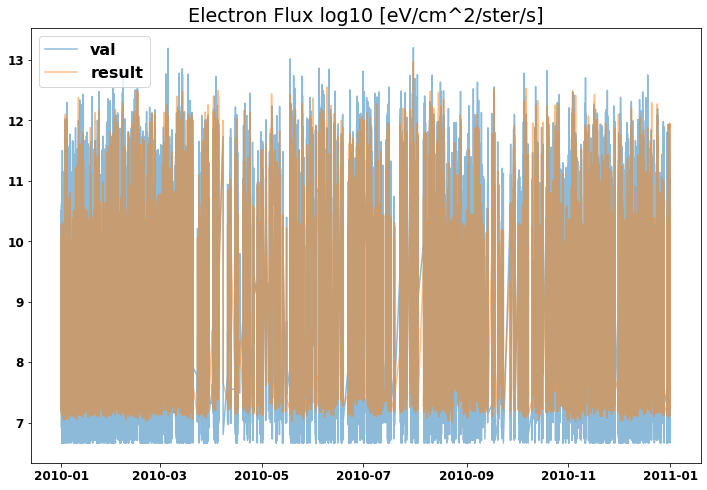

<Figure size 432x288 with 0 Axes>

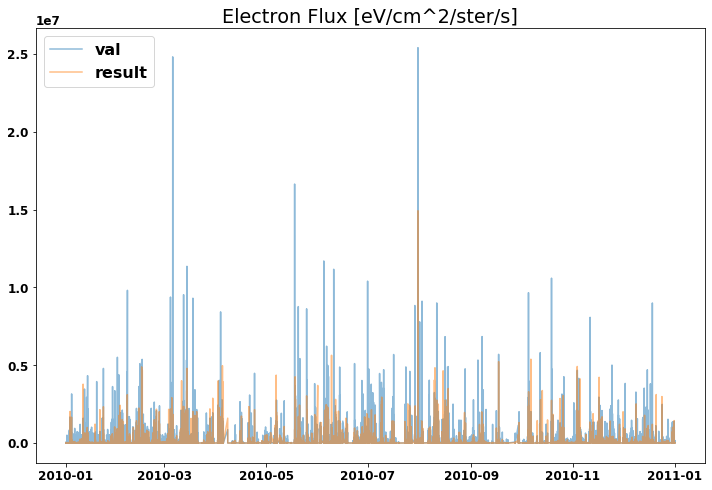

<Figure size 432x288 with 0 Axes>

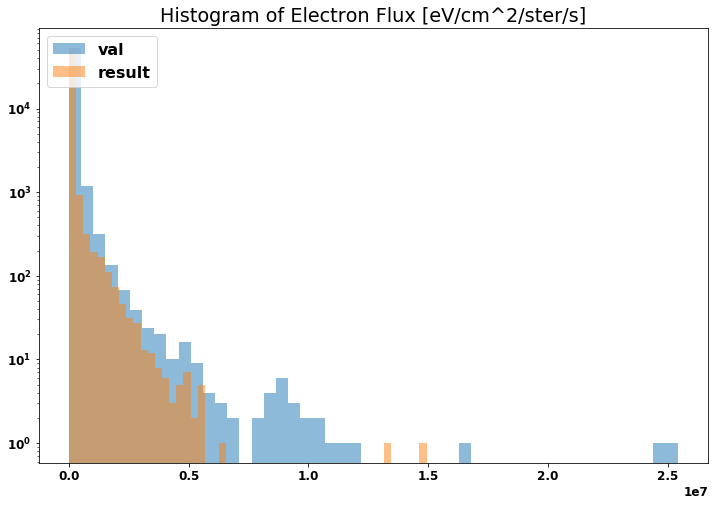

<Figure size 432x288 with 0 Axes>

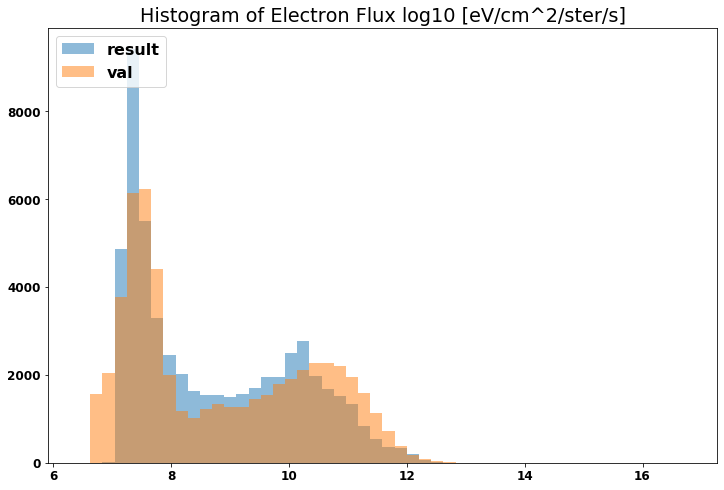

<Figure size 432x288 with 0 Axes>

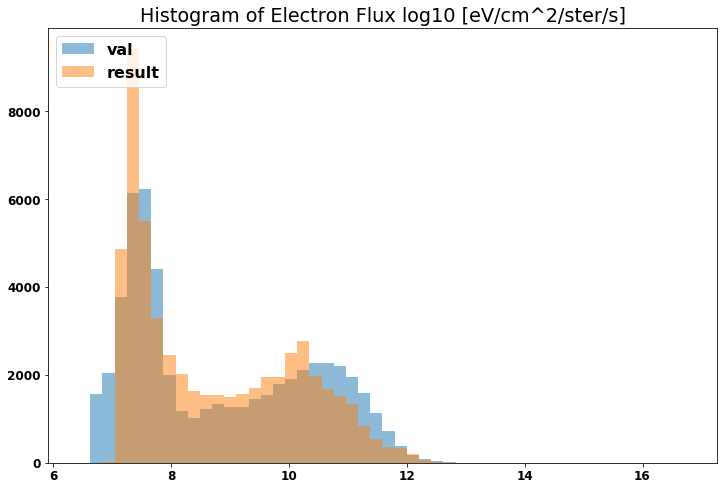

<Figure size 432x288 with 0 Axes>

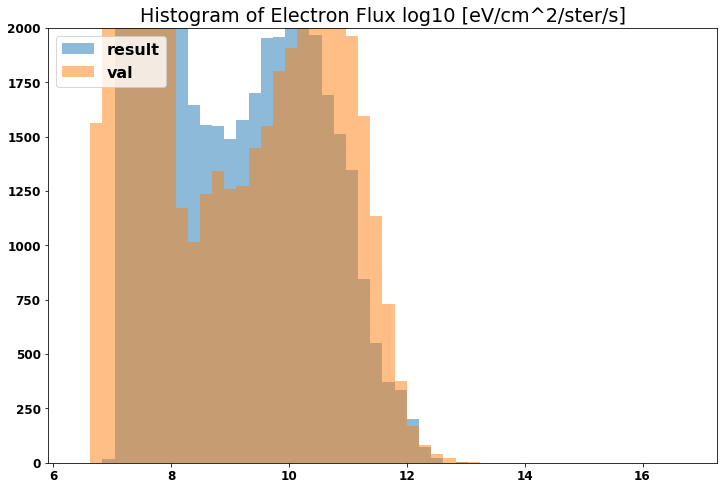

<Figure size 432x288 with 0 Axes>

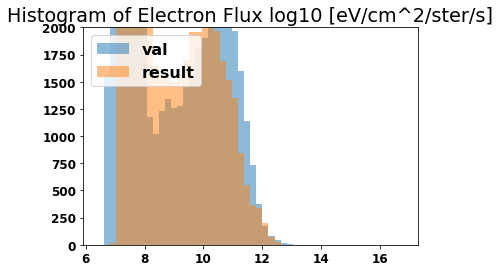

<Figure size 432x288 with 0 Axes>

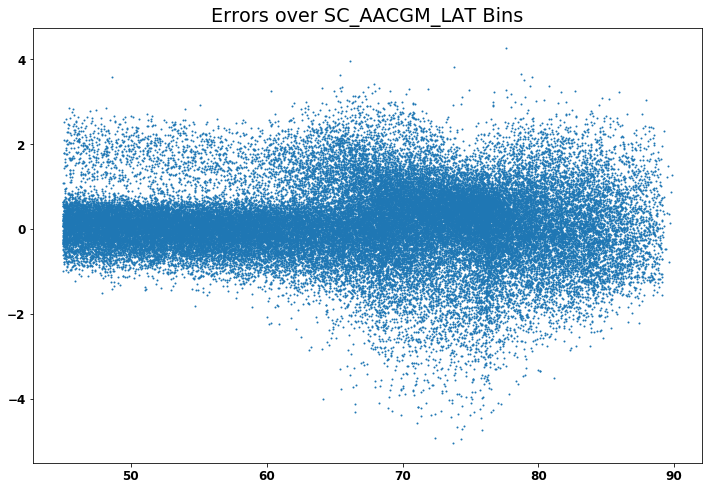

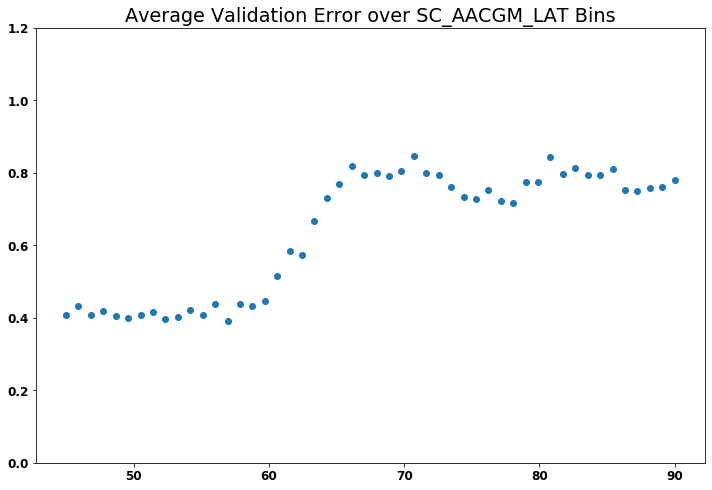

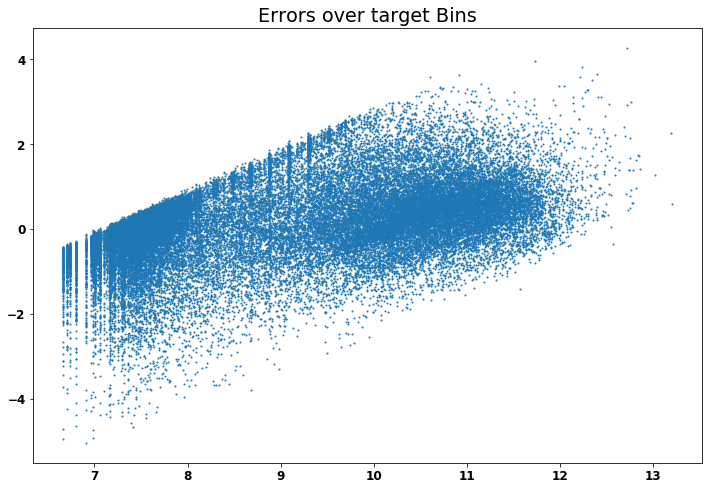

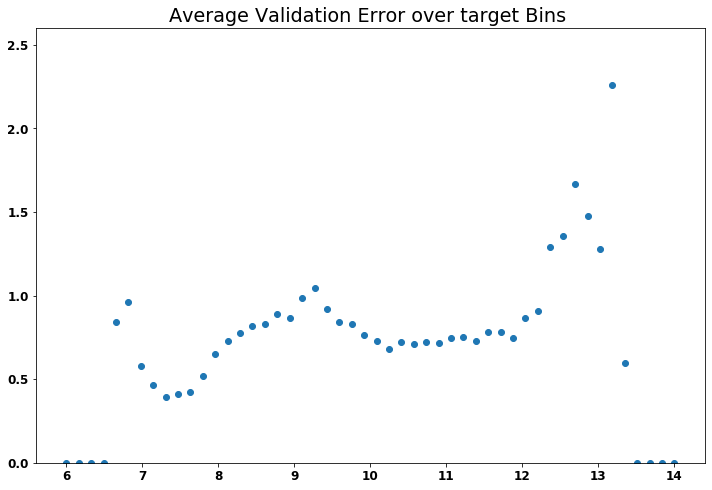

In [27]:
plot_model50bins(df_results)
